In [24]:
from skimage import io, exposure, img_as_float, img_as_uint
from sklearn.preprocessing import StandardScaler
import os
import random
import numpy as np
from tqdm import tqdm
from sklearn.decomposition import PCA
%matplotlib inline

In [37]:
def get_pca_img(img, num_singular_values=1):
    width = img.shape[0]
    height = img.shape[1]
    num_channels = 1
    if len(img.shape) == 2 or img.shape[2] < num_singular_values:
        print("LESS THAN 3 CHANNELS")
        num_singular_values = 1
    pca = PCA(n_components=num_singular_values) # one singular value reconstruction 
    if len(img.shape) > 2: # RGB image
        num_channels = img.shape[2]
    channel_lists = img.reshape(width*height, num_channels) #reshape image with columns for each color channel 
    standardized = StandardScaler().fit_transform(channel_lists)
    transformed = pca.fit_transform(standardized) 
    img_pca = transformed.reshape(width, height, -1) # reshape to proper width/height (is -1 correct?)
    print(img_pca.shape)
    img_pca = exposure.rescale_intensity(img_pca)
    # io.imshow(img)
    
    return img_pca 

In [26]:
def mylistdir(directory):
    """A specialized version of os.listdir() that ignores files that
    start with a leading period."""
    filelist = os.listdir(directory)
    return [x for x in filelist
            if not (x.startswith('.'))]

In [38]:
def process_folders_pca(folders_in, out_folder, prefix, test = False, channel3 = False):
    io.use_plugin('freeimage') # to save the new images as floats (after PCA)
    for idx, f in tqdm(enumerate(folders_in)):
        # Resize and get PCA in 1 dimension of each image 
        image_folder = os.path.join(f, 'images')
        filename = mylistdir(image_folder)[0]
        path = os.path.join(image_folder, filename)
        image_id = filename[:filename.find('.')]
        print('Image ID:', image_id)
        img = io.imread(path)
        img_pca = None
        if channel3:
            img_pca = get_pca_img(img, 3)
        else:
            img_pca = get_pca_img(img)
        io.imsave(os.path.join(out_folder,'images', image_id + '.png'), img_pca)
        
        # Concatenate masks
        if not test:
            mask_folder = os.path.join(f, 'masks')
            mask_files = [os.path.join(mask_folder, mask) for mask in mylistdir(mask_folder) if mask.endswith('.png')]
            
            individual_mask_path = os.path.join(out_folder, 'masks', image_id) #prefix + str(idx)
            print(individual_mask_path)
            if not os.path.exists(individual_mask_path):
                os.makedirs(individual_mask_path)
            mask_out = io.imread(mask_files[0])
#             mask_out_pca = None
#             if channel3:
#                 mask_out_pca = get_pca_img(mask_out, num_singular_values=3) #add 3 for 3 singular vales 
#             else:
            mask_out_pca = get_pca_img(mask_out)
            io.imsave(os.path.join(individual_mask_path, '0.png'), mask_out_pca)
            for idx2 in range(1, len(mask_files)):
                curr_mask = io.imread(mask_files[idx2])
#                 curr_mask_pca = None
#                 if channel3:
#                     curr_mask_pca = get_pca_img(curr_mask, num_singular_values=3)
#                 else:
                curr_mask_pca = get_pca_img(curr_mask)
                io.imsave(os.path.join(individual_mask_path, str(idx2) + '.png'), curr_mask_pca)
                mask_out_pca += curr_mask_pca
        #io.imshow(mask_out)
            print(os.path.join(out_folder, 'masks',  image_id + '.png')) #prefix + str(idx)
            io.imsave(os.path.join(out_folder, 'masks', image_id + '.png'), mask_out_pca) #prefix + str(idx)

In [39]:
train_data_in = 'Data/stage1_train'
test_data_in_1 = 'Data/stage1_test'
test_data_in_2 = 'Data/stage2_test'

train_data_out = 'Data-PCA-3channel/processed_train'
dev_data_out = 'Data-PCA-3channel/processed_dev'
test_data_out_1 = 'Data-PCA-3channel/processed_test1'
test_data_out_2 = 'Data-PCA-3channel/processed_test2'

# train_data_out = 'Data-PCA/processed_train'
# dev_data_out = 'Data-PCA/processed_dev'
# test_data_out_1 = 'Data-PCA/processed_test1'
# test_data_out_2 = 'Data-PCA/processed_test2'

train_folders = mylistdir(train_data_in)[:]
train_folders = [os.path.join(train_data_in, f) for f in train_folders]

test1_folders = mylistdir(test_data_in_1)[:]
test1_folders = [os.path.join(test_data_in_1, f) for f in test1_folders]

test2_folders = mylistdir(test_data_in_2)[:]
test2_folders = [os.path.join(test_data_in_2, f) for f in test2_folders]

random.seed(230)
train_folders.sort()
random.shuffle(train_folders)

# train/dev split 
split = int(0.9 * len(train_folders))
dev_folders = train_folders[split:]
train_folders = train_folders[:split]

In [40]:
# Make directories and process images
for path in (train_data_out, dev_data_out, test_data_out_1, test_data_out_2):
    if not os.path.exists(path):
        os.makedirs(path)
    images = os.path.join(path, 'images')
    if not os.path.exists(images):
        os.makedirs(images)
    masks = os.path.join(path, 'masks')
    if not os.path.exists(masks):
        os.makedirs(masks)

In [41]:
print('Processing train...')
process_folders_pca(train_folders, train_data_out, 'train', channel3 = True) #, channel3 = True

0it [00:00, ?it/s]

Processing train...
Image ID: 7f55678298adb736987d9fb5d1d2daefb08fe5bf4d81b2380bedf9449f79cc38
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/7f55678298adb736987d9fb5d1d2daefb08fe5bf4d81b2380bedf9449f79cc38
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f55678298adb736987d9fb5d1d2daefb08fe5bf4d81b2380bedf9449f79cc38/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f55678298adb736987d9fb5d1d2daefb08fe5bf4d81b2380bedf9449f79cc38/46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

1it [00:00,  1.87it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c42164b223110c09168.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filenam

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/7f55678298adb736987d9fb5d1d2daefb08fe5bf4d81b2380bedf9449f79cc38.png
Image ID: 1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c42164b223110c09168
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c42164b223110c09168/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c42164b223110c09168
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c42164b223110c09168.png
Image ID: bf7691b0a79811fa068b7408cbce636a73f01ef9e971a95da1a2d96df73782b6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/bf7691b0a79811fa068b7408cbce636a73f01ef9e971a95da1a2d96df73782b6
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bf7691b0a79811fa068b7408cbce636a73f01ef9e971a95da1a2d96df73782b6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bf7691b0a79811fa068b7408cbce636a73f01ef9e971a95da1a2d96df73782b6/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

3it [00:01,  1.71it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/57.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/116.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/126.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/136.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/146.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/155.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda

Image ID: 0d2bf916cc8de90d02f4cd4c23ea79b227dbc45d845b4124ffea380c92d34c8c
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/0d2bf916cc8de90d02f4cd4c23ea79b227dbc45d845b4124ffea380c92d34c8c
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/0d2bf916cc8de90d02f4cd4c23ea79b227dbc45d845b4124ffea380c92d34c8c.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

5it [00:07,  1.60s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2ad489c11ed8b77a9d8a2339ac64ffc38e79281c03a2507db4688fd3186c0fe5
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2ad489c11ed8b77a9d8a2339ac64ffc38e79281c03a2507db4688fd3186c0fe5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/2ad489c11ed8b77a9d8a2339ac64ffc38e79281c03a2507db4688fd3186c0fe5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2ad489c11ed8b77a9d8a2339ac64ffc38e79281c03a2507db4688fd3186c0fe5.png
Image ID: 5488e8df5440ee5161fdfae3aeccd2ee396636430065c90e3f1f73870a975991
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5488e8df5440ee5161fdfae3aeccd2ee396636430065c90e3f1f73870a975991
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5488e8df5440ee5161fdfae3aeccd2ee396636430065c90e3f1f73870a975991/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5488e8df5440ee5161fdfae3aeccd2ee396636430065c90e3f1f73870a975991/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/5488e8df5440ee5161fdfae3aeccd2ee396636430065c90e3f1f73870a975991.png
Image ID: c7d546766518703580f63d5d8f11d54971044753f53c0b257d19c2f99d4bfdd0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c7d546766518703580f63d5d8f11d54971044753f53c0b257d19c2f99d4bfdd0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c7d546766518703580f63d5d8f11d54971044753f53c0b257d19c2f99d4bfdd0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c7d546766518703580f63d5d8f11d54971044753f53c0b257d19c2f99d4bfdd0/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

8it [00:10,  1.26s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c7d546766518703580f63d5d8f11d54971044753f53c0b257d19c2f99d4bfdd0.png
Image ID: 62570c4ff1c5ab6d9d383aba9f25e604768520b4266afd40fdf4734a694c8bc3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62570c4ff1c5ab6d9d383aba9f25e604768520b4266afd40fdf4734a694c8bc3/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/62570c4ff1c5ab6d9d383aba9f25e604768520b4266afd40fdf4734a694c8bc3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/62570c4ff1c5ab6d9d383aba9f25e604768520b4266afd40fdf4734a694c8bc3.png
Image ID: 03398329ced0c23b9ac3fac84dd53a87d9ffe4d9d10f1b5fe8df8fac12380776
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/03398329ced0c23b9ac3fac84dd53a87d9ffe4d9d10f1b5fe8df8fac12380776
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/03398329ced0c23b9ac3fac84dd53a87d9ffe4d9d10f1b5fe8df8fac12380776.png
Image ID: 57bd029b19c1b382bef9db3ac14f13ea85e36a6053b92e46caedee95c05847ab
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/57bd029b19c1b382bef9db3ac14f13ea85e36a6053b92e46caedee95c05847ab/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/e

Data-PCA-3channel/processed_train/masks/57bd029b19c1b382bef9db3ac14f13ea85e36a6053b92e46caedee95c05847ab
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/57bd029b19c1b382bef9db3ac14f13ea85e36a6053b92e46caedee95c05847ab.png
Image ID: 9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/139.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/149.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/159.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

12it [00:16,  1.40s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 813f41ef376c3cbcc9d6e2ce6a51c2ee068226d1c1b13404eb238dcfdd447c97
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/813f41ef376c3cbcc9d6e2ce6a51c2ee068226d1c1b13404eb238dcfdd447c97/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/813f41ef376c3cbcc9d6e2ce6a51c2ee068226d1c1b13404eb238dcfdd447c97
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/813f41ef376c3cbcc9d6e2ce6a51c2ee068226d1c1b13404eb238dcfdd447c97.png
Image ID: a3a1b8f9794ef589b71faa9f35fd97ad6761c4488718fbcf766e95e31afa8606
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/a3a1b8f9794ef589b71faa9f35fd97ad6761c4488718fbcf766e95e31afa8606
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a3a1b8f9794ef589b71faa9f35fd97ad6761c4488718fbcf766e95e31afa8606.png
Image ID: f6b16c885c0b2bc0d0eb2bb2eeb0a2753ebafb5a7a91da10e89b0b0478984637
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f6b16c885c0b2bc0d0eb2bb2eeb0a2753ebafb5a7a91da10e89b0b0478984637
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f6b16c885c0b2bc0d0eb2bb2eeb0a2753ebafb5a7a91da10e89b0b0478984637.png
Image ID: a3a65623e079af7988b0c1cf1e54041003c6d730c91ecf200b71c47b93a67ed6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/a3a65623e079af7988b0c1cf1e54041003c6d730c91ecf200b71c47b93a67ed6
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a3a65623e079af7988b0c1cf1e54041003c6d730c91ecf200b71c47b93a67ed6.png
Image ID: 693bc64581275f04fc456da74f031d583733360a1f6032fa38b3fbf592ff4352
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/693bc64581275f04fc456da74f031d583733360a1f6032fa38b3fbf592ff4352
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/693bc64581275f04fc456da74f031d583733360a1f6032fa38b3fbf592ff4352/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/693bc64581275f04fc456da74f031d583733360a1f6032fa38b3fbf592ff4352/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/693bc64581275f04fc456da74f031d583733360a1f6032fa38b3fbf592ff4352.png
Image ID: b2c5d8653c621207e97b699e5c4c05d13df4f02d9db3e594b1f0c22e5b746aae
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/b2c5d8653c621207e97b699e5c4c05d13df4f02d9db3e594b1f0c22e5b746aae.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Data-PCA-3channel/processed_train/masks/b2c5d8653c621207e97b699e5c4c05d13df4f02d9db3e594b1f0c22e5b746aae
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b2c5d8653c62120

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/11a0170f44e3ab4a8d669ae8ea9546d3a32ebfe6486d9066e5648d30b4e1cb69
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/11a0170f44e3ab4a8d669ae8ea9546d3a32ebfe6486d9066e5648d30b4e1cb69.png
Image ID: 1c2f9e121fc207efff79d46390df1a740566b683ff56a96d8cabe830a398dd2e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/1c2f9e121fc207efff79d46390df1a740566b683ff56a96d8cabe830a398dd2e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Data-PCA-3channel/processed_train/masks/1c2f9e121fc207efff79d46390df1a740566b683ff56a96d8cabe830a398dd2e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1c2f9e121fc207efff79d46390df1a740566b683ff56a96d8cabe830a398dd2e.png
Image ID: f9ea1a1159c33f39bbe5f18bb278d961188b40508277eab7c0b4b91219b37b5d
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f9ea1a1159c33f39bbe5f18bb278d961188b40508277eab7c0b4b91219b37b5d
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f9ea1a1159c33f39bbe5f18bb278d961188b40508277eab7c0b4b91219b37b5d/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/f9ea1a1159c33f39bbe5f18bb278d961188b40508277eab7c0b4b91219b37b5d.png
Image ID: 6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56.png
Image ID: ba3997edd3fcb2f823ecdf870d2b607f08bff848f72a5cf72340bae5aca7c5ce
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/ba3997edd3fcb2f823ecdf870d2b607f08bff848f72a5cf72340bae5aca7c5ce
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ba3997edd3fcb2f823ecdf870d2b607f08bff848f72a5cf72340bae5aca7c5ce/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ba3997edd3fcb2f823ecdf870d2b607f08bff848f72a5cf72340bae5aca7c5ce/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

23it [00:23,  1.01s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ba3997edd3fcb2f823ecdf870d2b607f08bff848f72a5cf72340bae5aca7c5ce.png
Image ID: 8175a55b711c948fe383bd3b91b6ca1b9e048a5241e0be13aff31ce2674fbe6d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8175a55b711c948fe383bd3b91b6ca1b9e048a5241e0be13aff31ce2674fbe6d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8175a55b711c948fe383bd3b91b6ca1b9e048a5241e0be13aff31ce2674fbe6d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8175a55b711c948fe383bd3b91b6ca1b9e048a5241e0be13aff31ce2674fbe6d.png
Image ID: dabfee30b46d23569c63fa7253ef10b2407fbe8023035a5030252313cb718097
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/dabfee30b46d23569c63fa7253ef10b2407fbe8023035a5030252313cb718097
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/dabfee30b46d23569c63fa7253ef10b2407fbe8023035a5030252313cb718097.png
Image ID: b8fdc02d915206bb2564e1f7da962f2b9d9d491b11afa00a76622b7932366480
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b8fdc02d915206bb2564e1f7da962f2b9d9d491b11afa00a76622b7932366480
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b8fdc02d915206bb2564e1f7da962f2b9d9d491b11afa00a76622b7932366480.png
Image ID: a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc4

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/130.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d.png
Image ID: 0b0d577159f0d6c266f360f7b8dfde46e16fa665138bf577ec3c6f9c70c0cd1e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/0b0d577159f0d6c266f360f7b8dfde46e16fa665138bf577ec3c6f9c70c0cd1e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

Data-PCA-3channel/processed_train/masks/0b0d577159f0d6c266f360f7b8dfde46e16fa665138bf577ec3c6f9c70c0cd1e
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/0b0d577159f0d6c266f360f7b8dfde46e16fa665138bf577ec3c6f9c70c0cd1e.png
Image ID: 589f86dee5b480a88dd4f77eeaffe2c4d70aefdf879a4096dde1fa4d41055b8f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 320, 3)
Data-PCA-3channel/processed_train/masks/589f86dee5b480a88dd4f77eeaffe2c4d70aefdf879a4096dde1fa4d41055b8f
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/589f86dee5b480a88dd4f77eeaffe2c4d70aefdf879a4096dde1fa4d41055b8f.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

29it [00:31,  1.09s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/111.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/121.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/131.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/141.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/151.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/160.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/170.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/180.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/190.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda

Image ID: b560dba92fbf2af785739efced50d5866c86dc4dada9be3832138bef4c3524d2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b560dba92fbf2af785739efced50d5866c86dc4dada9be3832138bef4c3524d2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/b560dba92fbf2af785739efced50d5866c86dc4dada9be3832138bef4c3524d2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b560dba92fbf2af785739efced50d5866c86dc4dada9be3832

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/9774c82396327929fea05e40ae153cabf0107178b2ae3e40a5709b409793887e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9774c82396327929fea05e40ae153cabf0107178b2ae3e40a5709b409793887e.png
Image ID: 7af09f98ec299ba0658d759eebc4c34e1c98289ea6ce37f233e9f5e4e2fc84f4
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/7af09f98ec299ba0658d759eebc4c34e1c98289ea6ce37f233e9f5e4e2fc84f4
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/7af09f98ec299ba0658d759eebc4c34e1c98289ea6ce37f233e9f5e4e2fc84f4.png
Image ID: d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/111.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/121.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0.png
Image ID: 8e8a7a14749d0b2e48de3d10e2e80063f17b165ad921c8afc0623f08500f3259


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8e8a7a14749d0b2e48de3d10e2e80063f17b165ad921c8afc0623f08500f3259/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8e8a7a14749d0b2e48de3d10e2e80063f17b165ad921c8afc0623f08500f3259
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8e8a7a14749d0b2e48de3d10e2e80063f17b165ad921c8afc0623f08500f3259.png
Image ID: ef6634efb46567d87b811be786b18c4cd0e2cda23d79b65d6afe0d259ef3ade6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/ef6634efb46567d87b811be786b18c4cd0e2cda23d79b65d6afe0d259ef3ade6
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/da8ca06ccbb4e2a8718f7c2939ef6cc3a4088981f660842ad885a8273e740d55
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da8ca06ccbb4e2a8718f7c2939ef6cc3a4088981f660842ad885a8273e740d55/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da8ca06ccbb4e2a8718f7c2939ef6cc3a4088981f660842ad885a8273e740d55/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

37it [00:44,  1.20s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/da8ca06ccbb4e2a

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/93cfd412c7de5210bbd262ec3a602cfea65072e9272e9fce9b5339a5b9436eb7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/93cfd412c7de5210bbd262ec3a602cfea65072e9272e9fce9b5339a5b9436eb7/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/93cfd412c7de5210bbd262ec3a602cfea65072e9272e9fce9b5339a5b9436eb7
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/93cfd412c7de5210bbd262ec3a602cfea65072e9272e9fce9b5339a5b9436eb7.png
Image ID: a0afead3b4fe393f6a6159de040ecb2e66f8a89090abf0d0bf5b8e1d38ae667c
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/a0afead3b4fe393f6a6159de040ecb2e66f8a89090abf0d0bf5b8e1d38ae667c
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/a0afead3b4fe393f6a6159de040ecb2e66f8a89090abf0d0bf5b8e1d38ae667c.png
Image ID: a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/62.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb.png


40it [00:48,  1.22s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ec486143ecfec847c22cd8cbc207d85312bcf38e61c9b9a805e0d12add62da8d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ec486143ecfec847c22cd8cbc207d85312bcf38e61c9b9a805e0d12add62da8d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/ec486143ecfec847c22cd8cbc207d85312bcf38e61c9b9a805e0d12add62da8d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ec486143ecfec847c22cd8cbc207d85312bcf38e61c9b9a805e0d12add62da8d.png
Image ID: a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7.png
Image ID: 1d02c4b5921e916b9ddfb2f741fd6cf8d0e571ad51eb20e021c826b5fb87350e
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/1d02c4b5921e916b9ddfb2f741fd6cf8d0e571ad51eb20e021c826b5fb87350e
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1d02c4b5921e916b9ddfb2f741fd6cf8d0e571ad51eb20e021c826b5fb87350e/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/1d02c4b5921e916b9ddfb2f741fd6cf8d0e571ad51eb20e021c826b5fb87350e.png
Image ID: 98c5ead89cd066637efd5c93a6edc55c85908eb66807471f0d246d5457341f9c
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/98c5ead89cd066637efd5c93a6edc55c85908eb66807471f0d246d5457341f9c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/116.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/126.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180.png


45it [00:55,  1.23s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a815a986800a95de0957116c6585deea8ffb6ee09ad00ccc687306937ac698d0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a815a986800a95de0957116c6585deea8ffb6ee09ad00ccc687306937ac698d0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/a815a986800a95de0957116c6585deea8ffb6ee09ad00ccc687306937ac698d0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a815a986800a95de0957116c6585deea8ffb6ee09ad00ccc687306937ac698d0.png
Image ID: 94a5a37c3b1153d5c5aef2eca53c960b9f21f2ef1

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/94a5a37c3b1153d5c5aef2eca53c960b9f21f2ef1758209d7ec502ec324b03a3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/94a5a37c3b1153d5c5aef2eca53c960b9f21f2ef1758209d7ec502ec324b03a3.png
Image ID: 50a7ea80dd73232a17f98b5c83f62ec89989e892fe25b79b36f99b3872a7d182
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/50a7ea80dd73232a17f98b5c83f62ec89989e892fe25b79b36f99b3872a7d182
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/50a7ea80dd73232a17f98b5c83f62ec89989e892fe25b79b36f99b3872a7d182/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.999999999999968, -19.999999999999968]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
48it [00:57,  1.19s/it]

Data-PCA-3channel/processed_train/masks/50a7ea80dd73232a17f98b5c83f62ec89989e892fe25b79b36f99b3872a7d182.png
Image ID: 05a8f65ebd0b30d3b210f30b4d640c847c2e710d0d135e0aeeaccbe1988e3b6e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/05a8f65ebd0b30d3b210f30b4d640c847c2e710d0d135e0aeeaccbe1988e3b6e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/3b75fc03a1d12b29bd2870eb1f6fdb44174dbd1118dfc11c31f127bd87bd27ef
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3b75fc03a1d12b29bd2870eb1f6fdb44174dbd1118dfc11c31f127bd87bd27ef.png
Image ID: 61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e.png
Image ID: 077f026f4ab0f0bcc0856644d99cbf639e443ec4f067d7b708bc6cecac609424
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/077f026f4ab0f0bcc0856644d99cbf639e443ec4f067d7b708bc6cecac609424/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/077f026f4ab0f0bcc0856644d99cbf639e443ec4f067d7b708bc6cecac609424
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/077f026f4ab0f0bcc0856644d99cbf639e443ec4f067d7b708bc6cecac609424.png
Image ID: c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f.png
Image ID: c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da/52.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

54it [01:03,  1.18s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da.png
Image ID: da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/128.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/138.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

Image ID: 947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050/46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

56it [01:09,  1.23s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050.png
Image ID: 6af82abb29539000be4696884fc822d3cafcb2105906dc7582c92dccad8948c5
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/6af82abb29539000be4696884fc822d3cafcb2105906dc7582c92dccad8948c5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6af82abb29539000be4696884fc822d3cafcb2105906dc7582c92dccad8948c5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6af82abb29539000be4696884fc822d3cafcb2105906dc7582c92dccad8948c5/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

57it [01:09,  1.22s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/6af82abb29539000be4696884fc822d3cafcb2105906dc7582c92dccad8948c5.png
Image ID: 245b995878370ef4ea977568b2b67f93d4ecaa9308761b9d3e148e0803780183
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/245b995878370ef4ea977568b2b67f93d4ecaa9308761b9d3e148e0803780183
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/245b995878370ef4ea977568b2b67f93d4ecaa9308761b9d3e148e0803780183/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/245b995878370ef4ea977568b2b67f93d4ecaa9308761b9d3e148e0803780183/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

58it [01:10,  1.21s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/245b995878370ef4ea977568b2b67f93d4ecaa9308761b9d3e148e0803780183.png
Image ID: 648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868.png
Image ID: f8e74d4006dd68c1dbe68df7be905835e00d8ba4916f3b18884509a15fdc0b55
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f8e74d4006dd68c1dbe68df7be905835e00d8ba4916f3b18884509a15fdc0b55
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f8e74d4006dd68c1dbe68df7be905835e00d8ba4916f3b18884509a15fdc0b55/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f8e74d4006dd68c1dbe68df7be905835e00d8ba4916f3b18884509a15fdc0b55/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

60it [01:11,  1.20s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f8e74d4006dd68c1dbe68df7be905835e00d8ba4916f3b18884509a15fdc0b55.png
Image ID: b7a86f4968071e0f963fa87ef314fdd1b6c73a66355431cc53a37e193ba6be9b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b7a86f4968071e0f963fa87ef314fdd1b6c73a66355431cc53a37e193ba6be9b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/b7a86f4968071e0f963fa87ef314fdd1b6c73a66355431cc53a37e193ba6be9b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b7a86f4968071e0f963fa87ef314fdd1b6c73a66355431cc53a37e193ba6be9b.png
Image ID: 4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/116.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/126.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

62it [01:16,  1.24s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0.png
Image ID: b3a9f4c9035a0df7e033b18c63bfb0f0d87ff5a4d9aa8bdf417159bb733abb80


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b3a9f4c9035a0df7e033b18c63bfb0f0d87ff5a4d9aa8bdf417159bb733abb80/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/b3a9f4c9035a0df7e033b18c63bfb0f0d87ff5a4d9aa8bdf417159bb733abb80
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b3a9f4c9035a0df7e033b18c63bfb0f0d87ff5a4d9aa8bdf417159bb733abb80.png
Image ID: e4fc936ba57a936aaa5941ccc70946ab18fcebcb6e8d85a097c584aff9ca4d88
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/e4fc936ba57a936aaa5941ccc70946ab18fcebcb6e8d85a097c584aff9ca4d88
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/308084bdd358e0bd3dc7f2b409d6f34cc119bce30216f44667fc2be43ff31722
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/308084bdd358e0bd3dc7f2b409d6f34cc119bce30216f44667fc2be43ff31722/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/308084bdd358e0bd3dc7f2b409d6f34cc119bce30216f44667fc2be43ff31722/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/308084bdd358e0bd3dc7f2b409d6f34cc119bce30216f44667fc2be43ff31722.png
Image ID: 0532c64c2fd0c4d3188cc751cdfd566b1cfba3d269358717295bab1504c7c275


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/0532c64c2fd0c4d3188cc751cdfd566b1cfba3d269358717295bab1504c7c275
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/0532c64c2fd0c4d3188cc751cdfd566b1cfba3d269358717295bab1504c7c275.png
Image ID: ce9e1a58b58940039ae841466198b72ea21cc90584039a9294b47f5aef17ddfa
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/ce9e1a58b58940039ae841466198b72ea21cc90584039a9294b47f5aef17ddfa
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/13c8ff1f49886e91c98ce795c93648ad8634c782ff57eb928ce29496b0425057/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(256, 256, 3)
Data-PCA-3channel/processed_train/masks/13c8ff1f49886e91c98ce795c93648ad8634c782ff57eb928ce29496b0425057
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/13c8ff1f49886e91c98ce795c93648ad8634c782ff57eb928ce29496b0425057.png
Image ID: cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/107.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/117.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/127.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

69it [01:24,  1.23s/it]

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e.png
Image ID: c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3.png
Image ID: 1e8408fbb1619e7a0bcdd0bcd21fae57e7cb1f297d4c79787a9d0f5695d77073
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/1e8408fbb1619e7a0bcdd0bcd21fae57e7cb1f297d4c79787a9d0f5695d77073
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1e8408fbb1619e7a0bcdd0bcd21fae57e7cb1f297d4c79787a9d0f5695d77073.png
Image ID: df9a4212ecb67bb4e58eba62f293b91f9d6f1dde73e38fa891c75661d419fc97
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/df9a4212ecb67bb4e58eba62f293b91f9d6f1dde73e38fa891c75661d419fc97
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b2c23ddb04531158da6a0abcaca78fec0ae5c6f64f60166e4f36f4a161efd76f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/b2c23ddb04531158da6a0abcaca78fec0ae5c6f64f60166e4f36f4a161efd76f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b2c23ddb04531158da6a0abcaca78fec0ae5c6f64f60166e4f36f4a161efd76f.png
Image ID: 4327d27591871e9c8d317071a390d1b3dcedad05a9746175b005c41ea0d797b2
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4327d27591871e9c8d317071a390d1b3dcedad05a9746175b005c41ea0d797b2
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4327d27591871e9c8d317071a390d1b3dcedad05a9746175b005c41ea0d797b2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

74it [01:28,  1.19s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/07761fa39f60dc37022dbbe8d8694595fd5b77ceb2af2a2724768c8e524d6770.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filena

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/4327d27591871e9c8d317071a390d1b3dcedad05a9746175b005c41ea0d797b2.png
Image ID: 07761fa39f60dc37022dbbe8d8694595fd5b77ceb2af2a2724768c8e524d6770
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07761fa39f60dc37022dbbe8d8694595fd5b77ceb2af2a2724768c8e524d6770/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/07761fa39f60dc37022dbbe8d8694595fd5b77ceb2af2a2724768c8e524d6770
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/07761fa39f60dc37022dbbe8d8694595fd5b77ceb2af2a2724768c8e524d6770.png
Image ID: a1f50f101bc471e2d6967ebdb8ba81150588609e769f3b960f0801e4da5fdc6f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/a1f50f101bc471e2d6967ebdb8ba81150588609e769f3b960f0801e4da5fdc6f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a1f50f101bc471e2d6967ebdb8ba81150588609e769f3b960f0801e4da5fdc6f.png
Image ID: f43169e3d8b4f71e687945b9e72cbfdfe2e40e68842568e6a30c60d64c1378b6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f43169e3d8b4f71e687945b9e72cbfdfe2e40e68842568e6a30c60d64c1378b6
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f43169e3d8b4f71e687945b9e72cbfdfe2e40e68842568e6a30c60d64c1378b6.png
Image ID: 5b0bde771bc67c505d1b59405cbcad0a2766ec3ee4e35852e959552c1b454233
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/5b0bde771bc67c505d1b59405cbcad0a2766ec3ee4e35852e959552c1b454233
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/5b0bde771bc67c505d1b59405cbcad0a2766ec3ee4e35852e959552c1b454233.png
Image ID: 1740b0a67ca337ea31648b57c81bcfbb841c7bb5cad185199a9f4da596d531b9
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/1740b0a67ca337ea31648b57c81bcfbb841c7bb5cad185199a9f4da596d531b9
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1740b0a67ca337ea31648b57c81bcfbb841c7bb5cad185199a9f4da596d531b9.png
Image ID: 6c85029f850d392791e13f74963391054ff54e508967bbd091ee510e9e58e011
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/6c85029f850d392791e13f74963391054ff54e508967bbd091ee510e9e58e011
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/6c85029f850d392791e13f74963391054ff54e508967bbd091ee510e9e58e011.png
Image ID: c6de542205b891eed5c40e6d8ae3d03a6ca39b26dc445b4dbc64340d4d64dd2d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/c6de542205b891eed5c40e6d8ae3d03a6ca39b26dc445b4dbc64340d4d64dd2d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c6de542205b891eed5c40e6d8ae3d03a6ca39b26dc445b4dbc64340d4d64dd2d.png
Image ID: ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548.png
Image ID: 4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

83it [01:32,  1.11s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1.png
Image ID: 139946af9e2c7ef4f0298e622b831dbef5e5c0cd088eb5bc3382f8df9355443d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/139946af9e2c7ef4f0298e622b831dbef5e5c0cd088eb5bc3382f8df9355443d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/139946af9e2c7ef4f0298e622b831dbef5e5c0cd088eb5bc3382f8df9355443d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/139946af9e2c7ef4f0298e622b831dbef5e5c0cd088eb5bc3382f8df9355443d.png
Image ID: 9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

85it [01:33,  1.10s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a.png
Image ID: 8f6597

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/8f6597cd978c060378177df76e554d0578b97eab471e237dbe0adc0dd0d93d63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f6597cd978c060378177df76e554d0578b97eab471e237dbe0adc0dd0d93d63/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8f6597cd978c060378177df76e554d0578b97eab471e237dbe0adc0dd0d93d63
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8f6597cd978c060378177df76e554d0578b97eab471e237dbe0adc0dd0d93d63.png
Image ID: 9b25b8ffd5f52b6c3d235a42d51d380503d1f80b61ef0f62eeb696f5977c38e6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/9b25b8ffd5f52b6c3d235a42d51d380503d1f80b61ef0f62eeb696f5977c38e6
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9b25b8ffd5f52b6c3d235a42d51d380503d1f80b61ef0f62eeb696f5977c38e6.png
Image ID: 00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e/46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e.png
Image ID: 608ff81c8a0c8b622f6648a9c7f935d85f0c503f515ef2ac3728387be1953ee8
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/608ff81c8a0c8b622f6648a9c7f935d85f0c503f515ef2ac3728387be1953ee8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/608ff81c8a0c8b622f6648a9c7f935d85f0c503f515ef2ac3728387be1953ee8
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/608ff81c8a0c8b622f6648a9c7f935d85f0c503f515ef2ac3728387be1953ee8.png
Image ID: 853a4c67900c411abd04467f7bc7813d3c58a5f565c8b0807e13c6e6dea21344
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/853a4c67900c411abd04467f7bc7813d3c58a5f565c8b0807e13c6e6dea21344
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/853a4c67900c411abd04467f7bc7813d3c58a5f565c8b0807e13c6e6dea21344.png
Image ID: da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8.png
Image ID: 815524d88283ba10ad597b87aa1967671db776df8004a0c4291b67fc2624c22a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/815524d88283ba10ad597b87aa1967671db776df8004a0c4291b67fc2624c22a
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/815524d88283ba10ad597b87aa1967671db776df8004a0c4291b67fc2624c22a/2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/815524d88283ba10ad597b87aa1967671db776df8004a0c4291b67fc2624c22a/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

92it [01:39,  1.09s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/815524d88283ba10ad597b87aa1967671db776df8004a0c4291b67fc2624c22a.png
Image ID: 136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261.png
Image ID: d827a7d80fc67487a3237135e0d43ae01b7bbcb135e1a167601fc974a8348c51
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d827a7d80fc67487a3237135e0d43ae01b7bbcb135e1a167601fc974a8348c51/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/d827a7d80fc67487a3237135e0d43ae01b7bbcb135e1a167601fc974a8348c51
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/40b00d701695d8ea5d59f95ac39e18004040c96d17fbc1a539317c674eca084b
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/40b00d701695d8ea5d59f95ac39e18004040c96d17fbc1a539317c674eca084b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/40b00d701695d8ea5d59f95ac39e18004040c96d17fbc1a539317c674eca084b/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/40b00d701695d8ea5d59f95ac39e18004040c96d17fbc1a539317c674eca084b/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/40b00d701695d8ea5d59f95ac39e18004040c96d17fbc1a539317c674eca084b.png
Image ID: 2bf594e9d06f78b4b79d7ffb395497a0a91126b6b0d710d7a9cee21f5c3bd177
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/2bf594e9d06f78b4b79d7ffb395497a0a91126b6b0d710d7a9cee21f5c3bd177
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2bf594e9d06f78b4b79d7ffb395497a0a91126b6b0d710d7a9

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/130.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/140.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/150.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/161.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/171.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/181.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/191.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/200.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/210.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/221.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/231.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/241.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/251.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932.png
Image ID: be771d6831e3f8f1af4696bc08a582f163735db5baf9906e4729acc6a05e1187
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/be771d6831e3f8f1af4696bc08a582f163735db5baf9906e4729acc6a05e1187
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/be771d6831e3f8f1af4696bc08a582f163735db5baf9906e4729acc6a05e1187.png
Image ID: 55ff2b0ec48b76e10c7ee18add5794005cd551697f96af865c763d50da78dd9c
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/55ff2b0ec48b76e10c7ee18add5794005cd551697f96af865c763d50da78dd9c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/55ff2b0ec48b76e10c7ee18add5794005cd551697f96af865c763d50da78dd9c.png
Image ID: ead9464a50a17f74bf1b6471d94ecce8d887cf518c8fedc6c6048eb948bc4e49
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/ead9464a50a17f74bf1b6471d94ecce8d887cf518c8fedc6c6048eb948bc4e49
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ead9464a50a17f74bf1b6471d94ecce8d887cf518c8fedc6c6048eb948bc4e49.png
Image ID: 6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc.png
Image ID: e5a7b8a9924b26b3abf039255a8a3bb00258f4966f68ff3349560b4350af9367
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/e5a7b8a9924b26b3abf039255a8a3bb00258f4966f68ff3349560b4350af9367
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/e5a7b8a9924b26b3abf039255a8a3bb00258f4966f68ff3349560b4350af9367.png
Image ID: a101a00fea63f0c43abe5323f4f890bec881eb0caa3bc8498991ff5fd207ed91


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a101a00fea63f0c43abe5323f4f890bec881eb0caa3bc8498991ff5fd207ed91/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/a101a00fea63f0c43abe5323f4f890bec881eb0caa3bc8498991ff5fd207ed91
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a101a00fea63f0c43abe5323f4f890bec881eb0caa3bc8498991ff5fd207ed91.png
Image ID: 2b50b1e3fa5c5aa39bc84ebfaea9961b7199c4d2488ae0b48d0b3459807d59d2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/2b50b1e3fa5c5aa39bc84ebfaea9961b7199c4d2488ae0b48d0b3459807d59d2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2b50b1e3fa5c5aa39bc84ebfaea9961b7199c4d2488ae0b48d0b3459807d59d2.png
Image ID: 150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/128.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/138.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/147.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/157.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/167.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/177.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/187.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/196.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

Image ID: 62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461.png
Image ID: af8621ef0db8c26b0bce6385bd5609b584bfd678fcf7a234b8a15e6bb05c15ac
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/af8621ef0db8c26b0bce6385bd5609b584bfd678fcf7a234b8a15e6bb05c15ac/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/af8621ef0db8c26b0bce6385bd5609b584bfd678fcf7a234b8a15e6bb05c15ac
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/af8621ef0db8c26b0bce6385bd5609b584bfd678fcf7a234b8a15e6bb05c15ac.png
Image ID: 93c563

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/93c5638e7e6433b5c9cc87c152bcbe28873d2f9d6a392cca0642520807542a77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Data-PCA-3channel/processed_train/masks/93c5638e7e6433b5c9cc87c152bcbe28873d2f9d6a392cca0642520807542a77
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/93c5638e7e6433b5c9cc87c152bcbe28873d2f9d6a392cca0642520807542a77.png
Image ID: b1e3aeb0c56261c17eb71c747d116057b8da7e8c8a6845bdc01b2b3ee2299229
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b1e3aeb0c56261c17eb71c747d116057b8da7e8c8a6845bdc01b2b3ee2299229
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b1e3aeb0c56261c17eb71c747d116057b8da7e8c8a6845bdc01b2b3ee2299229.png
Image ID: dbbfe0

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/dbbfe08a52688d0ac8de9161cbb17cb201e3991aacab8ab8a77fe0e203a69481
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dbbfe08a52688d0ac8de9161cbb17cb201e3991aacab8ab8a77fe0e203a69481/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dbbfe08a52688d0ac8de9161cbb17cb201e3991aacab8ab8a77fe0e203a69481/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/dbbfe08a52688d0ac8de9161cbb17cb201e3991aacab8ab8a77fe0e203a69481.png
Image ID: 0bf4b144167694b6846d584cf52c458f34f28fcae75328a2a096c8214e01c0d0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/0bf4b144167694b6846d584cf52c458f34f28fcae75328a2a096c8214e01c0d0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0bf4b144167694b6846d584cf52c458f34f28fcae75328a2a096c8214e01c0d0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0bf4b144167694b6846d584cf52c458f34f28fcae75328a2a096c8214e01c0d0/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/0bf4b144167694b6846d584cf52c458f34f28fcae75328a2a096c8214e01c0d0.png
Im

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96/53.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96.png
Image ID: 35ca5f142a7d7a3e4b59f1a767a31f87cb00d66348226bc64094ee3d1e46531c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/35ca5f142a7d7a3e4b59f1a767a31f87cb00d66348226bc64094ee3d1e46531c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/35ca5f142a7d7a3e4b59f1a767a31f87cb00d66348226bc64094ee3d1e46531c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/35ca5f142a7d7a3e4b59f1a767a31f87cb00d66348226bc64094ee3d1e46531c/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

113it [02:09,  1.15s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/35ca5f142a7d7a3e4b59f1a767a31f87cb00d66348226bc64094ee3d1e46531c.png
Image ID: 547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/130.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/140.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/150.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/160.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/170.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/180.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/190.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/200.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/210.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/221.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/230.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/240.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/250.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

114it [02:16,  1.20s/it]

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6.png
Image ID: fd8065bcb1afdbed19e028465d5d00cd2ecadc4558de05c6fa28bea3c817aa22


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/fd8065bcb1afdbed19e028465d5d00cd2ecadc4558de05c6fa28bea3c817aa22
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fd8065bcb1afdbed19e028465d5d00cd2ecadc4558de05c6fa28bea3c817aa22/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fd8065bcb1afdbed19e028465d5d00cd2ecadc4558de05c6fa28bea3c817aa22/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/fd8065bcb1afdbed19e028465d5d00cd2ecadc4558de05c6fa28bea3c817aa22.png
Image ID: 76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/16.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/26.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/53.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/56.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450.png
Image ID: 2e2d29fc44444a85049b162eb359a523dec108ccd5bd75022b25547491abf0c7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/2e2d29fc44444a85049b162eb359a523dec108ccd5bd75022b25547491abf0c7
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

117it [02:28,  1.27s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/2e2d29fc44444a85049b162eb359a523dec108ccd5bd75022b25547491abf0c7.png
Image ID: 0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

118it [02:28,  1.26s/it]

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3.png
Image ID: b61d3f

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/139.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/149.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/159.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/168.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
Data-PCA-3channel/processed_train/masks/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895.png
Image ID: 8b12e18670e4b24d03567d1e17c0c24fadf0ea2c1e763983dd6bb4c44b7376a6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8b12e18670e4b24d03567d1e17c0c24fadf0ea2c1e763983dd6bb4c44b7376a6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8b12e18670e4b24d03567d1e17c0c24fadf0ea2c1e763983dd6bb4c44b7376a6
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8b12e18670e4b24d03567d1e17c0c24fadf0ea2c1e763983dd6bb4c44b7376a6.png
Image ID: 2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25.png
Image ID: 5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/25.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/52.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/55.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/62.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/65.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/76.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e.png
Image ID: fec226e45f49ab81ab71e0eaa1248ba09b56a328338dce93a43f4044eababed5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fec226e45f49ab81ab71e0eaa1248ba09b56a328338dce93a43f4044eababed5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/fec226e45f49ab81ab71e0eaa1248ba09b56a328338dce93a43f4044eababed5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/fec226e45f49ab81ab71e0eaa1248ba09b56a328338dce93a43f4044eababed5.png
Image ID: ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1.png
Image ID: cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/53.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/82.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/92.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/96.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/111.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/115.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/125.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/134.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/143.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/148.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/153.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/157.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/162.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/167.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/172.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/177.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/181.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/186.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/191.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/196.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/201.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/205.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/210.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/215.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/220.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/225.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/230.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/235.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/240.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/245.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
Data-PCA-3channel/processed_train/masks/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490.png
Image ID: 86f9087eb1d0875ffb1a28cca7645b14d6c66f995c7d96aa13969d2f8115d533


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/86f9087eb1d0875ffb1a28cca7645b14d6c66f995c7d96aa13969d2f8115d533
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/86f9087eb1d0875ffb1a28cca7645b14d6c66f995c7d96aa13969d2f8115d533.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

126it [03:04,  1.46s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d2ce593bddf9998ce3b76328c0151d0ba4b644c293aca7f6254e521c448b305f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d2ce593bddf9998ce3b76328c0151d0ba4b644c293aca7f6254e521c448b305f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/d2ce593bddf9998ce3b76328c0151d0ba4b644c293aca7f6254e521c448b305f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d2ce593bddf9998ce3b76328c0151d0ba4b644c293aca7f6254e521c448b305f.png
Image ID: b0e35e06b85da49bfe3ea737711a72b551a6add446e30eabb01aa683a79873c5
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b0e35e06b85da49bfe3ea737711a72b551a6add446e30eabb01aa683a79873c5
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/b0e35e06b85da49bfe3ea737711a72b551a6add446e30eabb01aa683a79873c5.png
Image ID: 3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff.png
Image ID: 8de0b1a2e8f614af29fe5fafeaa5bdf55e6b3e65edf36355f19b707f7649ce2b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/8de0b1a2e8f614af29fe5fafeaa5bdf55e6b3e65edf36355f19b707f7649ce2b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8de0b1a2e8f614af29fe5fafeaa5bdf55e6b3e65edf36355f19b707f7649ce2b.png
Image ID: 2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf/5.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

131it [03:06,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf.png
Image ID: 5b12df18e4ae4df5af06052584cf0e6bef58ee2a220653890636eef88a944e14
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5b12df18e4ae4df5af06052584cf0e6bef58ee2a220653890636eef88a944e14/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/5b12df18e4ae4df5af06052584cf0e6bef58ee2a220653890636eef88a944e14
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/5b12df18e4ae4df5af06052584cf0e6bef58ee2a220653890636eef88a944e14.png
Image ID: 7c318172e976ae5a962c9c7a4e9fe46d7fb985765ddd3a3e2108e893a90b92b2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/7c318172e976ae5a962c9c7a4e9fe46d7fb985765ddd3a3e2108e893a90b92b2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7c318172e976ae5a962c9c7a4e9fe46d7fb985765ddd3a3e2108e893a90b92b2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7c318172e976ae5a962c9c7a4e9fe46d7fb985765ddd3a3e2108e893a90b92b2/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

133it [03:07,  1.41s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/7c318172e976ae5a962c9c7a4e9fe46d7fb985765ddd3a3e2108e893a90b92b2.png
Image ID: f93ec5e683d81005ffc2a84a1c0299b2406ad14b764b824e013f7ca3a13833b5
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f93ec5e683d81005ffc2a84a1c0299b2406ad14b764b824e013f7ca3a13833b5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/f93ec5e683d81005ffc2a84a1c0299b2406ad14b764b824e013f7ca3a13833b5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/942d56861fc83e195e9c559a000bb86627d8682f8dcc2300818458e5b6850dd0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/942d56861fc83e195e9c559a000bb86627d8682f8dcc2300818458e5b6850dd0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/942d56861fc83e195e9c559a000bb86627d8682f8dcc2300818458e5b6850dd0/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/942d56861fc83e195e9c559a000bb86627d8682f8dcc2300818458e5b6850dd0.png
Image ID: 21408476af0506331e8b5d49b385833e5ef1fbb90815fbf9af9d19b4bb145f76
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/21408476af0506331e8b5d49b385833e5ef1fbb90815fbf9af9d19b4bb145f76
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/21408476af0506331e8b5d49b385833e5ef1fbb90815fbf9af9d19b4bb145f76.png
Image ID: f67e72b7fe0b1e3648ea745ffd395c80705c89b0c0c48227991fe6f5815b2a18
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f67e72b7fe0b1e3648ea745ffd395c80705c89b0c0c48227991fe6f5815b2a18
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f67e72b7fe0b1e3648ea745ffd395c80705c89b0c0c48227991fe6f5815b2a18.png
Image ID: dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/139.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05.png
Image ID: 4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/75.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/96.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607.png
Image ID: d2815f2f616d92be35c7e8dcfe592deec88516aef9ffc9b21257f52b7d6d0354
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/d2815f2f616d92be35c7e8dcfe592deec88516aef9ffc9b21257f52b7d6d0354
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d2815f2f616d92be35c7e8dcfe592deec88516aef9ffc9b21257f52b7d6d0354.png
Image ID: 7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04/65.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04.png
Image ID: b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

142it [03:17,  1.39s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313.png
Image ID: 1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b.png
Image ID: b67a6e5da8b1cfa5319d94a7d3f8b706725753346c37a4636bf7382e98b3c5df
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b67a6e5da8b1cfa5319d94a7d3f8b706725753346c37a4636bf7382e98b3c5df/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/b67a6e5da8b1cfa5319d94a7d3f8b706725753346c37a4636bf7382e98b3c5df
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b67a6e5da8b1cfa5319d94a7d3f8b706725753346c37a4636bf7382e98b3c5df.png
Image ID: df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2
(260, 347, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
Data-PCA-3channel/processed_train/masks/df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2.png
Image ID: aa47f0b303b1d525b52452ae3a8553b2d61d719a28aee547e2ef1fc6730a078f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/aa47f0b303b1d525b52452ae3a8553b2d61d719a28aee547e2ef1fc6730a078f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

147it [03:23,  1.38s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7978812d0e2e034ee1f9c141f019705582fcaa290e4a01c6c75a62753285cb23
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/7978812d0e2e034ee1f9c141f019705582fcaa290e4a01c6c75a62753285cb23
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/7978812d0e2e034ee1f9c141f019705582fcaa290e4a01c6c75a62753285cb23.png
Image ID: 28d33efef218392e79e385906deb88055d94b65ad217de78c07e85476f80f45a
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/28d33efef218392e79e385906deb88055d94b65ad217de78c07e85476f80f45a
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/28d33efef218392e79e385906deb88055d94b65ad217de78c07e85476f80f45a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/28d33efef218392e79e385906deb88055d94b65ad217de78c07e85476f80f45a/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/28d33efef218392e79e385906deb88055d94b65ad217de78c07e85476f80f45a.png
Image ID: b82548ab19466b461614e6055aaf49fbc24c03a2d20e65575b680c7c28268807


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/b82548ab19466b461614e6055aaf49fbc24c03a2d20e65575b680c7c28268807
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b82548ab19466b461614e6055aaf49fbc24c03a2d20e65575b680c7c28268807/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b82548ab19466b461614e6055aaf49fbc24c03a2d20e65575b680c7c28268807/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b82548ab19466b461614e6055aaf49fbc24c03a2d20e65575b680c7c28268807.png
Image ID: d0f2a00d3155c243048bc48944aef93fb08e2258d1fa5f9ccadd9140082bc22f
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/d0f2a00d3155c243048bc48944aef93fb08e2258d1fa5f9ccadd9140082bc22f
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d0f2a00d3155c243048bc48944aef93fb08e2258d1fa5f9ccadd9140082bc22f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d0f2a00d3155c243048bc48944aef93fb08e2258d1fa5f9ccadd9140082bc22f/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/d0f2a00d3155c243048bc48944aef93fb08e2258d1fa5f9ccadd9140082bc22f.png
Image ID: e5aeb5b3577abbebe8982b5dd7d22c4257250ad3000661a42f38bf9248d291fd
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e5aeb5b3577abbebe8982b5dd7d22c4257250ad3000661a42f38bf9248d291fd/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/e5aeb5b3577abbebe8982b5dd7d22c4257250ad3000661a42f38bf9248d291fd
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e5aeb5b3577abbebe8982b5dd7d22c4257250ad3000661a42f38bf9248d291fd.png
Image ID: 1d5f4717e179a03675a5aac3fc1c862fb442ddc3e373923016fd6b1430da889b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/1d5f4717e179a03675a5aac3fc1c862fb442ddc3e373923016fd6b1430da889b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1d5f4717e179a03675a5aac3fc1c862fb442ddc3e373923016fd6b1430da889b.png
Image ID: 34c9f4eb2af8b8f46b1d88b74bde16f4614cd08948c2f1d817eb629afc512e7a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/34c9f4eb2af8b8f46b1d88b74bde16f4614cd08948c2f1d817eb629afc512e7a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/34c9f4eb2af8b8f46b1d88b74bde16f4614cd08948c2f1d817eb629afc512e7a.png
Image ID: 75120baa6abcbfe750a4eb223b8c10ae6bc3bebdda7b00d9a78bc2472fa28625
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/75120baa6abcbfe750a4eb223b8c10ae6bc3bebdda7b00d9a78bc2472fa28625
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1e61ecf354cb93a62a9561db87a53985fb54e001444f98112ed0fc623fad793e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/1e61ecf354cb93a62a9561db87a53985fb54e001444f98112ed0fc623fad793e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1e61ecf354cb93a62a9561db87a53985fb54e001444f98112ed0fc623fad793e.png
Image ID: 4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

157it [03:32,  1.35s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a246bcaa64af48ee5ca181cd594c0fc43466e7614406eb8bc01199a16ebc95d0
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/a246bcaa64af48ee5ca181cd594c0fc43466e7614406eb8bc01199a16ebc95d0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a246bcaa64af48ee5ca181cd594c0fc43466e7614406eb8bc01199a16ebc95d0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a246bcaa64af48ee5ca181cd594c0fc43466e7614406eb8bc01199a16ebc95d0/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a246bcaa64af48ee5ca181cd594c0fc43466e7614406eb8bc01199a16ebc95d0.png
Image ID: 2ab91a4408860ae8339689ed9f87aa9359de1bdd4ca5c2eab7fff7724dbd6707
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2ab91a4408860ae8339689ed9f87aa9359de1bdd4ca5c2eab7fff7724dbd6707
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2ab91a4408860ae8339689ed9f87aa9359de1bdd4ca5c2eab7fff7724dbd6707/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2ab91a4408860ae8339689ed9f87aa9359de1bdd4ca5c2eab7fff7724dbd6707/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

159it [03:33,  1.34s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2ab91a4408860ae8339689ed9f87aa9359de1bdd4ca5c2eab7fff7724dbd6707.png
Image ID: c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1040, 1388, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339
LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339/4.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)
LESS THAN 3 CHANNELS
(1040, 1388, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1040, 1388, 1)
Data-PCA-3channel/processed_train/masks/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339.png
Image ID: 4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94/25.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94/56.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94.png
Image ID: dbe5ad

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/dbe5ad05b6f87018159a3228c1d1725892a1bfb9fa9f8fcc2e8bfe70d69d0355.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/dbe5ad05b6f87018159a3228c1d1725892a1bfb9fa9f8fcc2e8bfe70d69d0355
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/dbe5ad05b6f87018159a3228c1d1725892a1bfb9fa9f8fcc2e8bfe70d69d0355.png
Image ID: abc781c8721fe04b877a7e324494eb75aa5bce94950a0e4e4d7d6ffc9e74da62


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/abc781c8721fe04b877a7e324494eb75aa5bce94950a0e4e4d7d6ffc9e74da62/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/abc781c8721fe04b877a7e324494eb75aa5bce94950a0e4e4d7d6ffc9e74da62
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/abc781c8721fe04b877a7e324494eb75aa5bce94950a0e4e4d7d6ffc9e74da62.png
Image ID: 091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/16.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/26.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

Image ID: 2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af.png
Image ID: 3582166ee20755856adf4882a8bfacb616fce4247911605a109c4862de421bcd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/3582166ee20755856adf4882a8bfacb616fce4247911605a109c4862de421bcd
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3582166ee20755856adf4882a8bfacb616fce4247911605a109c4862de421bcd/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3582166ee20755856adf4882a8bfacb616fce4247911605a109c4862de421bcd/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3582166ee20755856adf4882a8bfacb616fce4247911605a109c4862de421bcd.png
Image ID: d7d12a2acc47a94961aeb56fd56e8a0873016af75f5dd10915de9db8af8e4f5e
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/d7d12a2acc47a94961aeb56fd56e8a0873016af75f5dd10915de9db8af8e4f5e
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d7d12a2acc47a94961aeb56fd56e8a0873016af75f5dd10915de9db8af8e4f5e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/d7d12a2acc47a94961aeb56fd56e8a0873016af75f5dd10915de9db8af8e4f5e.png
Image ID: a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629.png
Image ID: 3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51.png
Image ID: bff985591dd5d6303018a6e9a3dcfb336771a414ad4605c24ce1c1155fc86a96
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bff985591dd5d6303018a6e9a3dcfb336771a414ad4605c24ce1c1155fc86a96/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/bff985591dd5d6303018a6e9a3dcfb336771a414ad4605c24ce1c1155fc86a96
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/bff985591dd5d6303018a6e9a3dcfb336771a414ad4605c24ce1c1155fc86a96.png
Image ID: 79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324.png
Image ID: 01d44a26f6680c42ba94c9bc6339228579a95d0e2695b149b7cc0c9592b21baf
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/01d44a26f6680c42ba94c9bc6339228579a95d0e2695b149b7cc0c9592b21baf/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/01d44a26f6680c42ba94c9bc6339228579a95d0e2695b149b7cc0c9592b21baf
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/01d44a26f6680c42ba94c9bc6339228579a95d0e2695b149b7cc0c9592b21baf.png
Image ID: 6bd330234b763b77796d4804de8e224881c0fc8dd02650fa708b2edfd8c7461f
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/6bd330234b763b77796d4804de8e224881c0fc8dd02650fa708b2edfd8c7461f
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6bd330234b763b77796d4804de8e224881c0fc8dd02650fa708b2edfd8c7461f/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/6bd330234b763b77796d4804de8e224881c0fc8dd02650fa708b2edfd8c7461f.png
Image ID: 08151b19806eebd58e5acec7e138dbfbb1761f41a1ab9620466584ecc7d5fada
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/08151b19806eebd58e5acec7e138dbfbb1761f41a1ab9620466584ecc7d5fada
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/08151b19806eebd58e5acec7e138dbfbb1761f41a1ab9620466584ecc7d5fada.png
Image ID: 84eeec681987753029eb83ea5f3ff7e8b5697783cdb2035f2882d40c9a3f1029
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/84eeec681987753029eb83ea5f3ff7e8b5697783cdb2035f2882d40c9a3f1029/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/84eeec681987753029eb83ea5f3ff7e8b5697783cdb2035f2882d40c9a3f1029
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/84eeec681987753029eb83ea5f3ff7e8b5697783cdb2035f2882d40c9a3f1029.png
Image ID: e321cfa987e77c21373a0f8b1236c83d6636306949a82a7f5b07fc0838e7777f
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/e321cfa987e77c21373a0f8b1236c83d6636306949a82a7f5b07fc0838e7777f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

176it [04:08,  1.41s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/d1dbc6ee7c44a7027e935d040e496793186b884a1028d0e26284a206c6f5aff0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e321cfa987e77c21373a0f8b1236c83d6636306949a82a7f5b07fc0838e7777f.png
Image ID: d1dbc6ee7c44a7027e935d040e496793186b884a1028d0e26284a206c6f5aff0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d1dbc6ee7c44a7027e935d040e496793186b884a1028d0e26284a206c6f5aff0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/d1dbc6ee7c44a7027e935d040e496793186b884a1028d0e26284a206c6f5aff0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d1dbc6ee7c44a7027e935d040e496793186b884a1028d0e26284a206c6f5aff0.png
Image ID: 30311520606ec99b6a810ae1a9a753df991777d374212423bb075c408a98ed74
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/30311520606ec99b6a810ae1a9a753df991777d374212423bb075c408a98ed74
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/30311520606ec99b6a810ae1a9a753df991777d374212423bb075c408a98ed74/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/30311520606ec99b6a810ae1a9a753df991777d374212423bb075c408a98ed74/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/30311520606ec99b6a810ae1a9a753df991777d374212423bb075c408a98ed74.png
Image ID: 3934a094e8537841e973342c7f8880606f7a2712b14930340d6f6c2afe178c25
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3934a094e8537841e973342c7f8880606f7a2712b14930340d6f6c2afe178c25
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3934a094e8537841e973342c7f8880606f7a2712b14930340d6f6c2afe178c25/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3934a094e8537841e973342c7f8880606f7a2712b14930340d6f6c2afe178c25/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

179it [04:09,  1.40s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 431b9b0c520a28375b5a0c18d0a5039dd62cbca7c4a0bcc25af3b763d4a81bec
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/431b9b0c520a28375b5a0c18d0a5039dd62cbca7c4a0bcc25af3b763d4a81bec/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/431b9b0c520a28375b5a0c18d0a5039dd62cbca7c4a0bcc25af3b763d4a81bec
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/431b9b0c520a28375b5a0c18d0a5039dd62cbca7c4a0bcc25af3b763d4a81bec.png
Image ID: e216ec5063d3562b793e434c491051bd8867f6c2e571e41137c7c560cc0e6a03
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/e216ec5063d3562b793e434c491051bd8867f6c2e571e41137c7c560cc0e6a03
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e216ec5063d3562b793e434c491051bd8867f6c2e571e41137c7c560cc0e6a03.png
Image ID: 317832f90f02c5e916b2ac0f3bcb8da9928d8e400

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/317832f90f02c5e916b2ac0f3bcb8da9928d8e400b747b2c68e544e56adacf6b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/317832f90f02c5e916b2ac0f3bcb8da9928d8e400b747b2c68e544e56adacf6b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/317832f90f02c5e916b2ac0f3bcb8da9928d8e400b747b2c68e544e56adacf6b/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/317832f90f02c5e916b2ac0f3bcb8da9928d8e400b747b2c68e544e56adacf6b.png
Image ID: 5419302571113e9aa74c7c0a9575333ca539b871a16c86ee92b35170b4ddc52e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5419302571113e9aa74c7c0a9575333ca539b871a16c86ee92b35170b4ddc52e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/5419302571113e9aa74c7c0a9575333ca539b871a16c86ee92b35170b4ddc52e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/5419302571113e9aa74c7c0a9575333ca539b871a16c86ee92b35170b4ddc52e.png
Image ID: b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-49.999999999999915, -47.99999999999991]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
184it [04:14,  1.38s/it]

Data-PCA-3channel/processed_train/masks/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1.png
Image ID: 5c235b945b25b9905b9b0429ce59f1db51d0d0c7d48c2c21ab9f3ca54b0715e6
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5c235b945b25b9905b9b0429ce59f1db51d0d0c7d48c2c21ab9f3ca54b0715e6
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/5c235b945b25b9905b9b0429ce59f1db51d0d0c7d48c2c21ab9f3ca54b0715e6.png
Image ID: b6c9b58de0388891221b8f7a83cbf0b8f8379b51b5c9a127bf43a4fc49f1cc48
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b6c9b58de0388891221b8f7a83cbf0b8f8379b51b5c9a127bf43a4fc49f1cc48
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/b6c9b58de0388891221b8f7a83cbf0b8f8379b51b5c9a127bf43a4fc49f1cc48.png
Image ID: bf4a61bb81589c9a67e3343408befd3e135af5e88b50c17f998f2131d24bc271


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/bf4a61bb81589c9a67e3343408befd3e135af5e88b50c17f998f2131d24bc271
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/bf4a61bb81589c9a67e3343408befd3e135af5e88b50c17f998f2131d24bc271.png
Image ID: 5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974.png
Image ID: ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d19659189951f540f48


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d19659189951f540f48
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d19659189951f540f48/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d19659189951f540f48.png
Image ID: f26f4c2c70c38fe12e00d5a814d5116691f2ca548908126923fd76ddd665ed24
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f26f4c2c70c38fe12e00d5a814d5116691f2ca548908126923fd76ddd665ed24
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f26f4c2c70c38fe12e00d5a814d5116691f2ca548908126923fd76ddd665ed24/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f26f4c2c70c38fe12e00d5a814d5116691f2ca548908126923fd76ddd665ed24/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f26f4c2c70c38fe12e00d5a814d5116691f2ca548908126923fd76ddd665ed24.png
Image ID: a0de55384fada5cbc46bd7a41f6feeef93b67d088497c7316079ccec39c2a834
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a0de55384fada5cbc46bd7a41f6feeef93b67d088497c7316079ccec39c2a834
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a0de55384fada5cbc46bd7a41f6feeef93b67d088497c7316079ccec39c2a834/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a0de55384fada5cbc46bd7a41f6feeef93b67d088497c7316079ccec39c2a834/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/116.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/126.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/136.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/147.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/157.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/167.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/177.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9.png
Image ID: 58c593bcb98386e7fd42a1d34e291db93477624b164e83ab2afa3caa90d1d921
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/58c593bcb98386e7fd42a1d34e291db93477624b164e83ab2afa3caa90d1d921.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

Data-PCA-3channel/processed_train/masks/58c593bcb98386e7fd42a1d34e291db93477624b164e83ab2afa3caa90d1d921
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/58c593bcb98386e7fd42a1d34e291db93477624b164e83ab2afa3caa90d1d921.png
Image ID: 7c0157913223365720209ac83ff2e0b1b2b460173acd615c67646014093a2b97
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/7c0157913223365720209ac83ff2e0b1b2b460173acd615c67646014093a2b97
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/7c0157913223365720209ac83ff2e0b1b2b460173acd615c67646014093a2b97.png
Image ID: 0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed/7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed.png
Image ID: 33a5b0ff232b425796ee6a9dd5b516ff9aad54ca723b4ec490bf5cd9b2e2a731
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/33a5b0ff232b425796ee6a9dd5b516ff9aad54ca723b4ec490bf5cd9b2e2a731
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/33a5b0ff232b425796ee6a9dd5b516ff9aad54ca723b4ec490

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-47.99999999999992, -45.999999999999915]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
197it [04:32,  1.38s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.con

Image ID: cdab367b30db47061df837c1ae9fa875d6057614f797332d37d3513517d6c694
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/cdab367b30db47061df837c1ae9fa875d6057614f797332d37d3513517d6c694
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.99999999999995, -19.99999999999995]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
198it [04:33,  1.38s/it]

Data-PCA-3channel/processed_train/masks/cdab367b30db47061df837c1ae9fa875d6057614f797332d37d3513517d6c694.png
Image ID: 88678981648b184b23b6c04999f29210cbe351f85b61d2bf99e306fd67a2998a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/88678981648b184b23b6c04999f29210cbe351f85b61d2bf99e306fd67a2998a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/88678981648b184b23b6c04999f29210cbe351f85b61d2bf99e306fd67a2998a.png
Image ID: f0c9f135c62572f3669a75b2c735e4477dc77fac85e653426ee2b3bcfbed7aaf
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f0c9f135c62572f3669a75b2c735e4477dc77fac85e653426ee2b3bcfbed7aaf
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f0c9f135c62572f3669a75b2c735e4477dc77fac85e653426ee2b3bcfbed7aaf/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f0c9f135c62572f3669a75b2c735e4477dc77fac85e653426ee2b3bcfbed7aaf/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/f0c9f135c62572f3669a75b2c735e4477dc77fac85e653426ee2b3bcfbed7aaf.png
Image ID: 4c032609d377bd980e01f888e0b298600bf8af0e33c4271a1f3aaf76964dce06
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/4c032609d377bd980e01f888e0b298600bf8af0e33c4271a1f3aaf76964dce06
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/4c032609d377bd980e01f888e0b298600bf8af0e33c4271a1f3aaf76964dce06.png
Image ID: 175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/128.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/137.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/147.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/157.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/167.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/177.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

Data-PCA-3channel/processed_train/masks/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc.png
Image ID: f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/4.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/85.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/104.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/114.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/123.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/127.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/132.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/136.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/141.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/145.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/150.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/154.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/159.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/163.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/168.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/172.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/177.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/181.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/186.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/190.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/195.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
Data-PCA-3channel/processed_train/masks/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81.png
Image ID: 49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/26.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/53.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

204it [04:55,  1.45s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc.png
Image ID: cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c.png
Image ID: d751ccb64fa767a65a966061218438bd1860695d96bbef11fdb2f0d3b8dedba8
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/d751ccb64fa767a65a966061218438bd1860695d96bbef11fdb2f0d3b8dedba8
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d751ccb64fa767a65a966061218438bd1860695d96bbef11fdb2f0d3b8dedba8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d751ccb64fa767a65a966061218438bd1860695d96bbef11fdb2f0d3b8dedba8/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/d751ccb64fa767a65a966061218438bd1860695d96bbef11fdb2f0d3b8dedba8.png
Image ID: 8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-37.9999999999999, -35.9999999999999]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
207it [05:00,  1.45s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_pr

Image ID: 1631352dbafb8a90f11219fffd3bea368a30bc3bad3bbe0e84e19bd720df4945
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/1631352dbafb8a90f11219fffd3bea368a30bc3bad3bbe0e84e19bd720df4945
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1631352dbafb8a90f11219fffd3bea368a30bc3bad3bbe0e84e19bd720df4945/1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1631352dbafb8a90f11219fffd3bea368a30bc3bad3bbe0e84e19bd720df4945/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

208it [05:00,  1.45s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/1631352dbafb8a90f11219fffd3bea368a30bc3bad3bbe0e84e19bd720df4945.png
Image ID: 4d4f254f3b8b4408d661df3735591554b2f6587ce1952928d619b48010d55467


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/4d4f254f3b8b4408d661df3735591554b2f6587ce1952928d619b48010d55467
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d4f254f3b8b4408d661df3735591554b2f6587ce1952928d619b48010d55467/5.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-14.999999999999982, -12.999999999999982]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
209it [05:01,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.co

(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4d4f254f3b8b4408d661df3735591554b2f6587ce1952928d619b48010d55467.png
Image ID: 4948e3dfe0483c2198b9616612071ead5474dffd223071cf0a567aea9aca0b9e
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/4948e3dfe0483c2198b9616612071ead5474dffd223071cf0a567aea9aca0b9e
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNE

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.999999999999943, -19.999999999999932]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
210it [05:02,  1.44s/it]

Data-PCA-3channel/processed_train/masks/4948e3dfe0483c2198b9616612071ead5474dffd223071cf0a567aea9aca0b9e.png
Image ID: 0bda515e370294ed94efd36bd53782288acacb040c171df2ed97fd691fc9d8fe
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/0bda515e370294ed94efd36bd53782288acacb040c171df2ed97fd691fc9d8fe
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0bda515e370294ed94efd36bd53782288acacb040c171df2ed97fd691fc9d8fe/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0bda515e370294ed94efd36bd53782288acacb040c171df2ed97fd691fc9d8fe/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

211it [05:02,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/0bda515e370294ed94efd36bd53782288acacb040c171df2ed97fd691fc9d8fe.png
Image ID: 66612c188d73e931e1863af2c99d2af782c32f65fd97d224abb40bbadb87263f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/66612c188d73e931e1863af2c99d2af782c32f65fd97d224abb40bbadb87263f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/66612c188d73e931e1863af2c99d2af782c32f65fd97d224abb40bbadb87263f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/66612c188d73e931e1863af2c99d2af782c32f65fd97d224abb40bbadb87263f.png
Image ID: 3a3fee427e6ef7dfd0d82681e2bcee2d054f80287aea7dfa3fa4447666f929b9
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3a3fee427e6ef7dfd0d82681e2bcee2d054f80287aea7dfa3fa4447666f929b9
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3a3fee427e6ef7dfd0d82681e2bcee2d054f80287aea7dfa3fa4447666f929b9/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3a3fee427e6ef7dfd0d82681e2bcee2d054f80287aea7dfa3fa4447666f929b9/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3a3fee427e6ef7dfd0d82681e2bcee2d054f80287aea7dfa3fa4447666f929b9.png
Image ID: ed5be4b63e9506ad64660dd92a098ffcc0325195298c13c815a73773f1efc279
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed5be4b63e9506ad64660dd92a098ffcc0325195298c13c815a73773f1efc279/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

Data-PCA-3channel/processed_train/masks/ed5be4b63e9506ad64660dd92a098ffcc0325195298c13c815a73773f1efc279
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed5be4b63e9506ad64660dd92a098ffcc0325195298c13c815a73773f1efc279/25.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

214it [05:04,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/ed5be4b63e9506ad64660dd92a098ffcc0325195298c13c815a73773f1efc279.png
Image ID: b4d902d42c93dea77b541456f8d905f35eeb24fc3a5b0b15b5678d78e0aabe0c
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b4d902d42c93dea77b541456f8d905f35eeb24fc3a5b0b15b5678d78e0aabe0c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/b4d902d42c93dea77b541456f8d905f35eeb24fc3a5b0b15b5678d78e0aabe0c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b4d902d42c93dea77b541456f8d905f35eeb24fc3a5b0b15b5678d78e0aabe0c.png
Image ID: 670ebd9d674be236b9bf0b28650ad3f68e1891b06e16a9021fd069ca7ef32b78
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/670ebd9d674be236b9bf0b28650ad3f68e1891b06e16a9021fd069ca7ef32b78
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/670ebd9d674be236b9bf0b28650ad3f68e1891b06e16a9021fd069ca7ef32b78.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

216it [05:05,  1.41s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 91cc2e0d4d6e2c1ad59a8d63bcbe3e2ea8bc7f8e642e942a0113450181e73379
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/91cc2e0d4d6e2c1ad59a8d63bcbe3e2ea8bc7f8e642e942a0113450181e73379
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/91cc2e0d4d6e2c1ad59a8d63bcbe3e2ea8bc7f8e642e942a0113450181e73379/1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

217it [05:06,  1.41s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/138.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6.png
Image ID: a6515d73077866808ad4cb837ecdac33612527b8a1041e82135e40fce2bb9380
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a6515d73077866808ad4cb837ecdac33612527b8a1041e82135e40fce2bb9380/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/a6515d73077866808ad4cb837ecdac33612527b8a1041e82135e40fce2bb9380
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/a6515d73077866808ad4cb837ecdac33612527b8a1041e82135e40fce2bb9380.png
Image ID: 4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9d06d60ebe34951dca4
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9d06d60ebe34951dca4/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

Data-PCA-3channel/processed_train/masks/4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9d06d60ebe34951dca4
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9d06d60ebe34951dca4/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

220it [05:11,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9d06d60ebe34951dca4.png
Image ID: 20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/56.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/65.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/83.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/92.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/115.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/124.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/133.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/138.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/143.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/148.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/152.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/157.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/166.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/171.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/175.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/180.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/185.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/190.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/195.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/199.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/204.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/209.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/214.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/218.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/222.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/225.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/230.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/234.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/239.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/243.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/248.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/253.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/258.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/263.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/268.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/273.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/277.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/282.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

221it [05:26,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
Data-PCA-3channel/processed_train/masks/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f.png
Image ID: 94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0/25.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0.png
Image ID: 449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0.png
Image ID: 8e507d58f4c27cd2a82bee79fe27b069befd62a46fdaed20970a95a2ba819c7b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/8e507d58f4c27cd2a82bee79fe27b069befd62a46fdaed20970a95a2ba819c7b
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/8e507d58f4c27cd2a82bee79fe27b069befd62a46fdaed20970a95a2ba819c7b.png
Image ID: 6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa.png
Image ID: 777f7c4269279951ae05b56e806745e613297d411d048c0bce8964afd7d71a4b
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/777f7c4269279951ae05b56e806745e613297d411d048c0bce8964afd7d71a4b
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/777f7c4269279951ae05b56e806745e613297d411d048c0bce8964afd7d71a4b.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

226it [05:33,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 13f2bec0a24c70345372febb14c4352877b1b6c1b01896246048e83c345c0914
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/13f2bec0a24c70345372febb14c4352877b1b6c1b01896246048e83c345c0914
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

227it [05:34,  1.47s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/13f2bec0a24c70345372febb14c4352877b1b6c1b01896246048e83c345c0914.png
Image ID: 1a75e9f15481d11084fe66bc2a5afac6dc5bec20ed56a7351a6d65ef0fe8762b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a75e9f15481d11084fe66bc2a5afac6dc5bec20ed56a7351a6d65ef0fe8762b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/1a75e9f15481d11084fe66bc2a5afac6dc5bec20ed56a7351a6d65ef0fe8762b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1a75e9f15481d11084fe66bc2a5afac6dc5bec20ed56a7351a6d65ef0fe8762b.png
Image ID: 80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c.png
Image ID: e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/111.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/121.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/131.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/142.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/152.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/162.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/172.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/182.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/192.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

230it [05:42,  1.49s/it]

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2.png
Image ID: df33b11184427e05c8a450f921586685975fe975f57315e686a0f26fddb93db1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/df33b11184427e05c8a450f921586685975fe975f57315e686a0f26fddb93db1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df33b11184427e05c8a450f921586685975fe975f57315e686a0f26fddb93db1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df33b11184427e05c8a450f921586685975fe975f57315e686a0f26fddb93db1/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

231it [05:43,  1.49s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/df33b11184427e05c8a450f921586685975fe975f57315e686a0f26fddb93db1.png
Image ID: c35e6e3ea39a718e1b7aff66e4cc678efd662f9b5336b74d69c1d6bca7aaf288
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/c35e6e3ea39a718e1b7aff66e4cc678efd662f9b5336b74d69c1d6bca7aaf288
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c35e6e3ea39a718e1b7aff66e4cc678efd662f9b5336b74d69c1d6bca7aaf288/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c35e6e3ea39a718e1b7aff66e4cc678efd662f9b5336b74d69c1d6bca7aaf288/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c35e6e3ea39a718e1b7aff66e4cc678efd662f9b5336b74d69c1d6bca7aaf288.png
Image ID: 2cfa857e63be1b418c91ad5ea1f8d136fd1b80fc856e1d4277274c3dea28011c
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/2cfa857e63be1b418c91ad5ea1f8d136fd1b80fc856e1d4277274c3dea28011c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2cfa857e63be1b418c91ad5ea1f8d136fd1b80fc856e1d4277274c3dea28011c.png
Image ID: 5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053.png
Image ID: b0d6dfcc95e4d087d232378f860fc3ef9f95ea5a4c26d623a0be091f820a793f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b0d6dfcc95e4d087d232378f860fc3ef9f95ea5a4c26d623a0be091f820a793f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/b0d6dfcc95e4d087d232378f860fc3ef9f95ea5a4c26d623a0be091f820a793f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b0d6dfcc95e4d087d232378f860fc3ef9f95ea5a4c26d623a0be091f820a793f.png
Image ID: 1b518c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

236it [05:48,  1.48s/it]

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Image ID: 65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051/2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051/102.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051/103.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

237it [05:49,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051.png
Image ID: 6eefe1f0d9c2d2c2380db3ecd2113a566ace7dfc917687bb5033b4af5b8293aa
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6eefe1f0d9c2d2c2380db3ecd2113a566ace7dfc917687bb5033b4af5b8293aa/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/6eefe1f0d9c2d2c2380db3ecd2113a566ace7dfc917687bb5033b4af5b8293aa
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/5b2ccfb94dedf2ec8797c0404fc324888e35ab903c41bb26f070552033ca8e6c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5b2ccfb94dedf2ec8797c0404fc324888e35ab903c41bb26f070552033ca8e6c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5b2ccfb94dedf2ec8797c0404fc324888e35ab903c41bb26f070552033ca8e6c/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

Image ID: 03b9306f44e9b8951461623dcbd615550cdcf36ea93b203f2c8fa58ed1dffcbe
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/03b9306f44e9b8951461623dcbd615550cdcf36ea93b203f2c8fa58ed1dffcbe
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/03b9306f44e9b8951461623dcbd615550cdcf36ea93b203f2c8fa58ed1dffcbe/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.99999999999997, -19.99999999999994]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
240it [05:51,  1.46s/it]

Data-PCA-3channel/processed_train/masks/03b9306f44e9b8951461623dcbd615550cdcf36ea93b203f2c8fa58ed1dffcbe.png
Image ID: 1e488c42eb1a54a3e8412b1f12cde530f950f238d71078f2ede6a85a02168e1f
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/1e488c42eb1a54a3e8412b1f12cde530f950f238d71078f2ede6a85a02168e1f
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1e488c42eb1a54a3e8412b1f12cde530f950f238d71078f2ede6a85a02168e1f/7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/1e488c42eb1a54a3e8412b1f12cde530f950f238d71078f2ede6a85a02168e1f.png
Image ID: 30f65741053db713b3f328d31d3234b6fedbe31df65c1a8ea29be28146cab789
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/30f65741053db713b3f328d31d3234b6fedbe31df65c1a8ea29be28146cab789/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/30f65741053db713b3f328d31d3234b6fedbe31df65c1a8ea29be28146cab789
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/81e2dd950e6df28a4fe202a40afa98b202981f65a5ca05b389749290eb87c883/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/81e2dd950e6df28a4fe202a40afa98b202981f65a5ca05b389749290eb87c883
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/81e2dd950e6df28a4fe202a40afa98b202981f65a5ca05b389749290eb87c883.png
Image ID: 52a4ac5a875be7a6c886035d54fb63f5f397dc43508c4831898f6b2f8debc7f3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/52a4ac5a875be7a6c886035d54fb63f5f397dc43508c4831898f6b2f8debc7f3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/52a4ac5a875be7a6c886035d54fb63f5f397dc43508c4831898f6b2f8debc7f3.png
Image ID: cab4875269f44a701c5e58190a1d2f6fcb577ea79d842522dcab20ccb39b7ad2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/cab4875269f44a701c5e58190a1d2f6fcb577ea79d842522dcab20ccb39b7ad2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/cab4875269f44a701c5e58190a1d2f6fcb577ea79d842522dcab20ccb39b7ad2.png
Image ID: e5f8ad0f0a43af8ca57e31e16800108abdfb44a7e962a71d246f72d2dbde42bf
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/e5f8ad0f0a43af8ca57e31e16800108abdfb44a7e962a71d246f72d2dbde42bf
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e5f8ad0f0a43af8ca57e31e16800108abdfb44a7e962a71d246f72d2dbde42bf.png
Image ID: ee927e8255096971ddae1bd975cf80c4ad7c847c82d0b5f5dd2ddfe5407007ee
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/ee927e8255096971ddae1bd975cf80c4ad7c847c82d0b5f5dd2ddfe5407007ee
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ee927e8255096971ddae1bd975cf80c4ad7c847c82d0b5f5dd2ddfe5407007ee/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ee927e8255096971ddae1bd975cf80c4ad7c847c82d0b5f5dd2ddfe5407007ee/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/pr

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77/52.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77/75.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

248it [05:55,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 54cb3328e778d87f76062b0550e3bc190f46384acd8efbe58c297265d1906e84
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/54cb3328e778d87f76062b0550e3bc190f46384acd8efbe58c297265d1906e84
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54cb3328e778d87f76062b0550e3bc190f46384acd8efbe58c297265d1906e84/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

249it [05:55,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 87ea72894f6534b28e740cc34cf5c9eb75d0d8902687fce5fcc08a92e9f41386
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/87ea72894f6534b28e740cc34cf5c9eb75d0d8902687fce5fcc08a92e9f41386
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

250it [05:56,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/87ea72894f6534b28e740cc34cf5c9eb75d0d8902687fce5fcc08a92e9f41386.png
Image ID: f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/76.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/132.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/141.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

251it [05:57,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886.png
Image ID: 866a8cba7bfe1ea73e383d6cf492e53752579140c8b833bb56839a55bf79d855
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/866a8cba7bfe1ea73e383d6cf492e53752579140c8b833bb56839a55bf79d855.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

Data-PCA-3channel/processed_train/masks/866a8cba7bfe1ea73e383d6cf492e53752579140c8b833bb56839a55bf79d855
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/866a8cba7bfe1ea73e383d6cf492e53752579140c8b833bb56839a55bf79d855.png
Image ID: 8bef203fce625e4d8c89dca728158be4662dfdfdcd4dc73a6aa39a908c1631bc
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/8bef203fce625e4d8c89dca728158be4662dfdfdcd4dc73a6aa39a908c1631bc
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8bef203fce625e4d8c89dca728158be4662dfdfdcd4dc73a6aa39a908c1631bc.png
Image ID: 20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45.png
Image ID: 6d327ab4f0e3604fa6e9b8041c7e6db86ab809890d886c691f6e59c9168b7fbe
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/6d327ab4f0e3604fa6e9b8041c7e6db86ab809890d886c691f6e59c9168b7fbe
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/6d327ab4f0e3604fa6e9b8041c7e6db86ab809890d886c691f6e59c9168b7fbe.png
Image ID: 4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b942c2265eea75419d62f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 320, 3)
Data-PCA-3channel/processed_train/masks/4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b942c2265eea75419d62f
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b942c2265eea75419d62f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b942c2265eea75419d62f/7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.co

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b942c2265eea75419d62f/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0c6507d493bf79b2ba248c5cca3d14df8b67328b89efa5f4a32f97a06a88c92c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/0c6507d493bf79b2ba248c5cca3d14df8b67328b89efa5f4a32f97a06a88c92c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

Data-PCA-3channel/processed_train/masks/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de.png
Image ID: 3874755f6222e83006fdad4d664ec0d9697c13af4fbe24b2f9a059bb13075186
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3874755f6222e83006fdad4d664ec0d9697c13af4fbe24b2f9a059bb13075186/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/3874755f6222e83006fdad4d664ec0d9697c13af4fbe24b2f9a059bb13075186
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3874755f6222e83006fdad4d664ec0d9697c13af4fbe24b2f9a059bb13075186.png
Image ID: e66a97b2c77f3d66a7d3cebbc6a36c8c6259368a397f7b67647ed80ad53aa776
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/e66a97b2c77f3d66a7d3cebbc6a36c8c6259368a397f7b67647ed80ad53aa776
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e66a97b2c77f3d66a7d3cebbc6a36c8c6259368a397f7b67647ed80ad53aa776.png
Image ID: c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06.png
Image ID: 7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5.png
Im

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/af576e8ec3a8d0b57eb6a311299e9e4fd2047970d3dd9d6f52e54ea6a91109da
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/af576e8ec3a8d0b57eb6a311299e9e4fd2047970d3dd9d6f52e54ea6a91109da.png
Image ID: 1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/57.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/85.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/92.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df.png
Image ID: ce88df7356d9d4a8d5944a93768f4c4b593de2d35616f7448c2b37b9fd60dd1f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/ce88df7356d9d4a8d5944a93768f4c4b593de2d35616f7448c2b37b9fd60dd1f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ce88df7356d9d4a8d5944a93768f4c4b593de2d35616f7448c2b37b9fd60dd1f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ce88df7356d9d4a8d5944a93768f4c4b593de2d35616f7448c2b37b9fd60dd1f/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

265it [06:21,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ce88df7356d9d4a8d5944a93768f4c4b593de2d35616f7448c2b37b9fd60dd1f.png
Image ID: e856511ac1c34d24320eb7c56c05a4a3340d06667b4f5b8e8df615d415c7f650
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e856511ac1c34d24320eb7c56c05a4a3340d06667b4f5b8e8df615d415c7f650/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/e856511ac1c34d24320eb7c56c05a4a3340d06667b4f5b8e8df615d415c7f650
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/7773ac91af61ed041701b7c3b649598e3707cf04c0577f464fd31be687f538fe
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7773ac91af61ed041701b7c3b649598e3707cf04c0577f464fd31be687f538fe/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7773ac91af61ed041701b7c3b649598e3707cf04c0577f464fd31be687f538fe/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

267it [06:22,  1.43s/it]

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/7773ac91af61ed041701b7c3b649598e3707cf04c0577f464fd31be687f538fe.png
Image ID: 76c44d1addac92a65f1331f2d93f4e3b130bd4e538a6e5239c3ac1f4c403608a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/76c44d1addac92a65f1331f2d93f4e3b130bd4e538a6e5239c3ac1f4c403608a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

269it [06:22,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/5cc036b65f7f2d5480e2be111a561f3713ac021683a9a9138dc49492a29ce856.png
Image ID: 97158b2fe38783d88d4e44ba1b7bc6c84f225f8b35fcccc2f9265c65f14e7c8b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/97158b2fe38783d88d4e44ba1b7bc6c84f225f8b35fcccc2f9265c65f14e7c8b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/97158b2fe38783d88d4e44ba1b7bc6c84f225f8b35fcccc2f9265c65f14e7c8b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/97158b2fe38783d88d4e44ba1b7bc6c84f225f8b35fcccc2f9265c65f14e7c8b.png
Image ID: c2a646a819f59a4e816e0ee8ea00ba10d5de9ac20b5a435c41192637790dabee
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c2a646a819f59a4e816e0ee8ea00ba10d5de9ac20b5a435c41192637790dabee
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c2a646a819f59a4e816e0ee8ea00ba10d5de9ac20b5a435c41192637790dabee/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c2a646a819f59a4e816e0ee8ea00ba10d5de9ac20b5a435c41192637790dabee/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/111.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/121.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/131.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/142.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/151.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/162.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/172.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/182.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/193.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/203.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/213.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/224.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/234.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/244.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/254.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/264.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3.png


272it [06:31,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4
(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/57.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/84.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

Image ID: 930f246a8e4ff273a72a6e4b3cf8e8caff94fca4eaf1dbe6f93ba37b8195c0a0
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/930f246a8e4ff273a72a6e4b3cf8e8caff94fca4eaf1dbe6f93ba37b8195c0a0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/930f246a8e4ff273a72a6e4b3cf8e8caff94fca4eaf1dbe6f93ba37b8195c0a0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/930f246a8e4ff273a72a6e4b3cf8e8caff94fca4eaf1dbe6f93ba37b8195c0a0/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/930f246a8e4ff273a72a6e4b3cf8e8caff94fca4eaf1dbe6f93ba37b8195c0a0.png
Image ID: c620631271a56407d6d69fa1a69451ca99c50dcc30e29db04cf6fb7cacbde8cb
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c620631271a56407d6d69fa1a69451ca99c50dcc30e29db04cf6fb7cacbde8cb/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/c620631271a56407d6d69fa1a69451ca99c50dcc30e29db04cf6fb7cacbde8cb
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c620631271a56407d6d69fa1a69451ca99c50dcc30e29db04cf6fb7cacbde8cb.png
Image ID: 8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/130.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/140.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/151.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/160.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/171.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/181.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/191.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/202.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/212.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/222.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/232.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/242.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/253.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

276it [06:51,  1.49s/it]

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842.png
Image ID: d4d88391bc399a3715440d4da9f8b7a973e010dc1edd9551df2e5a538685add5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/d4d88391bc399a3715440d4da9f8b7a973e010dc1edd9551df2e5a538685add5
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/d4d88391bc399a3715440d4da9f8b7a973e010dc1edd9551df2e5a538685add5.png
Image ID: f9ac03b0344ce8c48bc058448541f9211a1e5f4c94fdaf633dd534328d8610ab
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f9ac03b0344ce8c48bc058448541f9211a1e5f4c94fdaf633dd534328d8610ab/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/f9ac03b0344ce8c48bc058448541f9211a1e5f4c94fdaf633dd534328d8610ab
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f9ac03b0344ce8c48bc058448541f9211a1e5f4c94fdaf633dd534328d8610ab.png
Image ID: 3b0709483b1e86449cc355bb797e841117ba178c6ae1ed955384f4da6486aa20
(256, 320, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3b0709483b1e86449cc355bb797e841117ba178c6ae1ed955384f4da6486aa20/7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/3b0709483b1e86449cc355bb797e841117ba178c6ae1ed955384f4da6486aa20
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/3b0709483b1e86449cc355bb797e841117ba178c6ae1ed955384f4da6486aa20.png
Image ID: a6593632dcbbe4c9e9429a9cec573d26fd8c91a47d554d315f25e7c2e0280ee3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/a6593632dcbbe4c9e9429a9cec573d26fd8c91a47d554d315f25e7c2e0280ee3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a6593632dcbbe4c9e9429a9cec573d26fd8c91a47d554d315f25e7c2e0280ee3.png
Image ID: 3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940/1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940.png
Image ID: 54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/57.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

Image ID: 70827e40a7155391984e56703c6df3392fb4a94bbd6c7008da6a6ca3244965d9
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/70827e40a7155391984e56703c6df3392fb4a94bbd6c7008da6a6ca3244965d9
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/70827e40a7155391984e56703c6df3392fb4a94bbd6c7008da6a6ca3244965d9/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/70827e40a7155391984e56703c6df3392fb4a94bbd6c7008da6a6ca3244965d9/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/70827e40a7155391984e56703c6df3392fb4a94bbd6c7008da6a6ca3244965d9.png
Image ID: 58406ed8ef944831c413c3424dc2b07e59aef13eb1ff16acbb3402b38b5de0bd
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/58406ed8ef944831c413c3424dc2b07e59aef13eb1ff16acbb3402b38b5de0bd
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/58406ed8ef944831c413c3424dc2b07e59aef13eb1ff16acbb3402b38b5de0bd.png
Image ID: 876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25.png


285it [07:10,  1.51s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d4d6c683f249d82518431603bf0206d05f2114ac871a99ffade0f5f61cf167e1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d4d6c683f249d82518431603bf0206d05f2114ac871a99ffade0f5f61cf167e1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/d4d6c683f249d82518431603bf0206d05f2114ac871a99ffade0f5f61cf167e1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d4d6c683f249d82518431603bf0206d05f2114ac871a99ffade0f5f61cf167e1.png
Image ID: 442c4eb0185698fe7d148c108a46f74abd399aecda2f4f22981a1671cd95dd7d
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/442c4eb0185698fe7d148c108a46f74abd399aecda2f4f22981a1671cd95dd7d
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/442c4eb0185698fe7d148c108a46f74abd399aecda2f4f22981a1671cd95dd7d.png
Image ID: f534b43bf37ff946a310a0f08315d76c3fb3394681cf523acef7c0682240072a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f534b43bf37ff946a310a0f08315d76c3fb3394681cf523acef7c0682240072a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f534b43bf37ff946a310a0f08315d76c3fb3394681cf523acef7c0682240072a.png
Image ID: 02903040e19ddf92f452907644ad3822918f54af41dd85e5a3fe3e1b6d6f9339


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/02903040e19ddf92f452907644ad3822918f54af41dd85e5a3fe3e1b6d6f9339
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/02903040e19ddf92f452907644ad3822918f54af41dd85e5a3fe3e1b6d6f9339.png
Image ID: a4c729efb5059893a8b62c7abeba171cb516836f8a20468f6b176dfe2f6f84d1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a4c729efb5059893a8b62c7abeba171cb516836f8a20468f6b176dfe2f6f84d1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/a4c729efb5059893a8b62c7abeba171cb516836f8a20468f6b176dfe2f6f84d1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a4c729efb5059893a8b62c7abeba171cb516836f8a20468f6b176dfe2f6f84d1.png
Image ID: be26966900aa0e5b41d5a8ecafe04281b37deb05c5cd027968d7b74143398174
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/be26966900aa0e5b41d5a8ecafe04281b37deb05c5cd027968d7b74143398174
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5ddbfba2519484316e4b7ccabfa605e6e6fd96c3d87ac8cdfd2c134571a15311/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/5ddbfba2519484316e4b7ccabfa605e6e6fd96c3d87ac8cdfd2c134571a15311
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/5ddbfba2519484316e4b7ccabfa605e6e6fd96c3d87ac8cdfd

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/76c4f14e35210f87a29e93c46dbb25c8f5dc5c04d1d3134672708bcdfbc7e959
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/76c4f14e35210f87a29e93c46dbb25c8f5dc5c04d1d3134672708bcdfbc7e959/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

293it [07:14,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/76c4f14e35210f87a29e93c46dbb25c8f5dc5c04d1d3134672708bcdfbc7e959.png
Image ID: cf26c41245febfe67c2a1682cc4ee8752ee40ae3e49610314f45923b8bf5b08a
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/cf26c41245febfe67c2a1682cc4ee8752ee40ae3e49610314f45923b8bf5b08a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cf26c41245febfe67c2a1682cc4ee8752ee40ae3e49610314f45923b8bf5b08a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cf26c41245febfe67c2a1682cc4ee8752ee40ae3e49610314f45923b8bf5b08a/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/cf26c41245febfe67c2a1682cc4ee8752ee40ae3e49610314f45923b8bf5b08a.png
Image ID: 0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/130.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/140.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/150.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/161.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/171.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/181.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/191.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/201.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/211.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/222.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/232.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/242.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/252.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/263.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/273.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/283.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/293.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/304.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/314.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/325.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/334.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/344.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/355.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/365.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1.png
Image ID: 3441821ebea04face181c9e2f4d0d09727c764827ac51b9e7fbadbebabeab225


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/3441821ebea04face181c9e2f4d0d09727c764827ac51b9e7fbadbebabeab225
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3441821ebea04face181c9e2f4d0d09727c764827ac51b9e7fbadbebabeab225/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3441821ebea04face181c9e2f4d0d09727c764827ac51b9e7fbadbebabeab225/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/3441821ebea04face181c9e2f4d0d09727c764827ac51b9e7fbadbebabeab225.png
Image ID: 7b5987a24dd57325e82812371b3f4df7edc528e0526754ba94cf3a1ea4df25d2
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/7b5987a24dd57325e82812371b3f4df7edc528e0526754ba94cf3a1ea4df25d2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7b5987a24dd57325e82812371b3f4df7edc528e0526754ba94cf3a1ea4df25d2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7b5987a24dd57325e82812371b3f4df7edc528e0526754ba94cf3a1ea4df25d2/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/7b5987a24dd57325e82812371b3f4df7edc528e0526754ba94cf3a1ea4df25d2.png
Image ID: 8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/57.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa.png
Image ID: 5ba4facefc949c920d7054813a3e846b000969da2ed860148bdfd18456f59bcc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/5ba4facefc949c920d7054813a3e846b000969da2ed860148bdfd18456f59bcc
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5ba4facefc949c920d7054813a3e846b000969da2ed860148bdfd18456f59bcc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

299it [07:37,  1.53s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/5ba4facefc949c920d7054813a3e846b000969da2ed860148bdfd18456f59bcc.png
Image ID: 10328b822b836e67b547b4144e0b7eb43747c114ce4cacd8b540648892945b00
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10328b822b836e67b547b4144e0b7eb43747c114ce4cacd8b540648892945b00/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/10328b822b836e67b547b4144e0b7eb43747c114ce4cacd8b540648892945b00
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/10328b822b836e67b547b4144e0b7eb43747c114ce4cacd8b5

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/65.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/75.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/82.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/85.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/92.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/95.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

Image ID: 449fe932622db3b49366a260ddd20077219f96fb2dc0f912ad4f60b087876f3b
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/449fe932622db3b49366a260ddd20077219f96fb2dc0f912ad4f60b087876f3b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449fe932622db3b49366a260ddd20077219f96fb2dc0f912ad4f60b087876f3b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449fe932622db3b49366a260ddd20077219f96fb2dc0f912ad4f60b087876f3b/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/449fe932622db3b49366a260ddd20077219f96fb2dc0f912ad4f60b087876f3b.png
Image ID: aa4d989d262c618ac2793579e200cc71b3767f84698ae5f669867f23cdfe2568
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/aa4d989d262c618ac2793579e200cc71b3767f84698ae5f669867f23cdfe2568
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/aa4d989d262c618ac2793579e200cc71b3767f84698ae5f669867f23cdfe2568.png
Image ID: 5afcbfd0dd64392aa1e233b996d0bfb4354ee7119f30ae111c33d0fe4df11590
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5afcbfd0dd64392aa1e233b996d0bfb4354ee7119f30ae111c33d0fe4df11590
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/5afcbfd0dd64392aa1e233b996d0bfb4354ee7119f30ae111c33d0fe4df11590.png
Image ID: d256b32adda37f2301c9e46f34b7f9a36cce273256369ceb5dc2c73c3007e3c4
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/d256b32adda37f2301c9e46f34b7f9a36cce273256369ceb5dc2c73c3007e3c4
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d256b32adda37f2301c9e46f34b7f9a36cce273256369ceb5dc2c73c3007e3c4/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d256b32adda37f2301c9e46f34b7f9a36cce273256369ceb5dc2c73c3007e3c4/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/d256b32adda37f2301c9e46f34b7f9a36cce273256369ceb5dc2c73c3007e3c4.png
Image ID: 5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8.png
Image ID: c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/16.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/75.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/85.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/92.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/95.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/102.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/105.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/111.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

Image ID: a022908f1b7880838dbc0411e50828e64b4f5e0263afdf04295e30bb2ff58005
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/a022908f1b7880838dbc0411e50828e64b4f5e0263afdf04295e30bb2ff58005
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a022908f1b7880838dbc0411e50828e64b4f5e0263afdf04295e30bb2ff58005/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a022908f1b7880838dbc0411e50828e64b4f5e0263afdf04295e30bb2ff58005/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/a022908f1b7880838dbc0411e50828e64b4f5e0263afdf04295e30bb2ff58005.png
Image ID: f6cb37ebf29c225284c8415962f7287abe7007fae8fe3d8a3899b608b832d7d5
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f6cb37ebf29c225284c8415962f7287abe7007fae8fe3d8a3899b608b832d7d5
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/f6cb37ebf29c225284c8415962f7287abe7007fae8fe3d8a3899b608b832d7d5.png
Image ID: dae976f161fe42dc58dee87d4bf2eb9f65736597cab0114138641b2a39a5c42b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/dae976f161fe42dc58dee87d4bf2eb9f65736597cab0114138641b2a39a5c42b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dae976f161fe42dc58dee87d4bf2eb9f65736597cab0114138641b2a39a5c42b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

310it [08:10,  1.58s/it]

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/a4c44fc5f5bf213e2be6091ccaed49d8bf039d78f6fbd9c4d7b7428cfcb2eda4
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a4c44fc5f5bf213e2be6091ccaed49d8bf039d78f6fbd9c4d7b7428cfcb2eda4/12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a4c44fc5f5bf213e2be6091ccaed49d8bf039d78f6fbd9c4d7b7428cfcb2eda4/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

311it [08:11,  1.58s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/a4c44fc5f5bf213e2be6091ccaed49d8bf039d78f6fbd9c4d7b7428cfcb2eda4.png
Image ID: eb96fc6cbf6880bf05c4309857ae33844a4bc2152e228eff31024e5265cf9fc3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/eb96fc6cbf6880bf05c4309857ae33844a4bc2152e228eff31024e5265cf9fc3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/eb96fc6cbf6880bf05c4309857ae33844a4bc2152e228eff31024e5265cf9fc3.png
Image ID: 56d0da5b663ddd49955478c00ca03118c367ff7dd6a646b8c875b0acb207d1c5
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/56d0da5b663ddd49955478c00ca03118c367ff7dd6a646b8c875b0acb207d1c5
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/56d0da5b663ddd49955478c00ca03118c367ff7dd6a646b8c875b0acb207d1c5/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/56d0da5b663ddd49955478c00ca03118c367ff7dd6a646b8c875b0acb207d1c5.png
Image ID: 4d4ebfcae4374165ea6ae7c7e18fd0ba5014c3c860ee2489c59e25ddd45e7a32
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/4d4ebfcae4374165ea6ae7c7e18fd0ba5014c3c860ee2489c59e25ddd45e7a32
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d4ebfcae4374165ea6ae7c7e18fd0ba5014c3c860ee2489c59e25ddd45e7a32/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d4ebfcae4374165ea6ae7c7e18fd0ba5014c3c860ee2489c59e25ddd45e7a32/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

314it [08:13,  1.57s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/4d4ebfcae4374165ea6ae7c7e18fd0ba5014c3c860ee2489c59e25ddd45e7a32.png
Image ID: 72b18a405555ad491721e29454e5cd325055ce81a9e78524b56f2c058a4d2327
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/72b18a405555ad491721e29454e5cd325055ce81a9e78524b56f2c058a4d2327/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/72b18a405555ad491721e29454e5cd325055ce81a9e78524b56f2c058a4d2327
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/72b18a405555ad491721e29454e5cd325055ce81a9e78524b56f2c058a4d2327.png
Image ID: b3bfd873fca7ff9b2e90f507dfdbe165bb8c153399b6ba5829aa59bae677a91d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b3bfd873fca7ff9b2e90f507dfdbe165bb8c153399b6ba5829aa59bae677a91d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b3bfd873fca7ff9b2e90f507dfdbe165bb8c153399b6ba5829aa59bae677a91d.png
Image ID: 708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.co

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

317it [08:15,  1.56s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/e9b8ad127f2163438b6236c74938f43d7b4863aaf39a16367f4af59bfd96597b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614.png
Image ID: e9b8ad127f2163438b6236c74938f43d7b4863aaf39a16367f4af59bfd96597b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e9b8ad127f2163438b6236c74938f43d7b4863aaf39a16367f4af59bfd96597b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/e9b8ad127f2163438b6236c74938f43d7b4863aaf39a16367f4af59bfd96597b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e9b8ad127f2163438b6236c74938f43d7b4863aaf39a16367f4af59bfd96597b.png
Image ID: 74a7785530687a11ecd073e772f90912d9967d02407a192bfab282c35f55ab94
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/74a7785530687a11ecd073e772f90912d9967d02407a192bfab282c35f55ab94
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/74a7785530687a1

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/3a22fe593d9606d4f137461dd6802fd3918f9fbf36f4a65292be69670365e2ca
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3a22fe593d9606d4f137461dd6802fd3918f9fbf36f4a65292be69670365e2ca/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-pa

LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/3a22fe593d9606d4f137461dd6802fd3918f9fbf36f4a65292be69670365e2ca.png
Image ID: 8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
Data-PCA-3channel/processed_train/masks/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a.png
Image ID: 8ecdb93582b2d5270457b36651b62776256ade3aaa2d7432ae65c14f07432d49
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8ecdb93582b2d5270457b36651b62776256ade3aaa2d7432ae65c14f07432d49/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8ecdb93582b2d5270457b36651b62776256ade3aaa2d7432ae65c14f07432d49
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8ecdb93582b2d5270457b36651b62776256ade3aaa2d7432ae65c14f07432d49.png
Image ID: ec031f176dafe0b36547068ce42eab39428ec7995dac1b3ea52d1db79b61fdeb
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/ec031f176dafe0b36547068ce42eab39428ec7995dac1b3ea52d1db79b61fdeb
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ec031f176dafe0b36547068ce42eab39428ec7995dac1b3ea52d1db79b61fdeb.png
Image ID: a7f767ca9770b160f234780e172aeb35a50830ba10dc49c526f4712451abe1d2
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/a7f767ca9770b160f234780e172aeb35a50830ba10dc49c526f4712451abe1d2
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/a7f767ca9770b160f234780e172aeb35a50830ba10dc49c526f4712451abe1d2.png
Image ID: 66236902b874b7e4b3891db63a69f6d56f6edcec6aca7ba3c6871d73e7b4c34f
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/66236902b874b7e4b3891db63a69f6d56f6edcec6aca7ba3c6871d73e7b4c34f
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/66236902b874b7e4b3891db63a69f6d56f6edcec6aca7ba3c6871d73e7b4c34f.png
Image ID: f81ca7ee25e733ff37240c34c8e3044d9937bb0166e315952ebde3f237ecb86f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f81ca7ee25e733ff37240c34c8e3044d9937bb0166e315952ebde3f237ecb86f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f81ca7ee25e733ff37240c34c8e3044d9937bb0166e315952ebde3f237ecb86f.png
Image ID: 3b3f516ebc9a16cff287a5ffd3a1861a345a6d38bedbba74f1c0b0e0eac62afd
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3b3f516ebc9a16cff287a5ffd3a1861a345a6d38bedbba74f1c0b0e0eac62afd
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3b3f516ebc9a16cff287a5ffd3a1861a345a6d38bedbba74f1c0b0e0eac62afd/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3b3f516ebc9a16cff287a5ffd3a1861a345a6d38bedbba74f1c0b0e0eac62afd/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

327it [08:23,  1.54s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3b3f516ebc9a16cff287a5ffd3a1861a345a6d38bedbba74f1c0b0e0eac62afd.png
Image ID: 5953af5080d981b554529971903d8bee9871457a4361b51f04ba04f43793dd8f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/5953af5080d981b554529971903d8bee9871457a4361b51f04ba04f43793dd8f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/14cc1424c59808274e123db51292e9dbb5b037ef3e7c767a8c45c9ac733b91bf
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/14cc1424c59808274e123db51292e9dbb5b037ef3e7c767a8c45c9ac733b91bf.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

329it [08:24,  1.53s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 89be66f88612aae541f5843abcd9c015832b5d6c54a28103b3019f7f38df8a6d
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/89be66f88612aae541f5843abcd9c015832b5d6c54a28103b3019f7f38df8a6d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/89be66f88612aae541f5843abcd9c015832b5d6c54a28103b3019f7f38df8a6d
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/89be66f88612aae541f5843abcd9c015832b5d6c54a28103b3019f7f38df8a6d.png
Image ID: 9d429167633b4d9d7f41544a461975cf8e688a3affa6a8916799202874809f2a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9d429167633b4d9d7f41544a461975cf8e688a3affa6a8916799202874809f2a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/9d429167633b4d9d7f41544a461975cf8e688a3affa6a8916799202874809f2a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9d429167633b4d9d7f41544a461975cf8e688a3affa6a8916799202874809f2a.png
Image ID: d7db360fabfce9828559a21f6bffff589ae868e0dc6101d7c1212de34a25e3cb
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/d7db360fabfce9828559a21f6bffff589ae868e0dc6101d7c1212de34a25e3cb
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d7db360fabfce9828559a21f6bffff589ae868e0dc6101d7c1212de34a25e3cb/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/d7db360fabfce9828559a21f6bffff589ae868e0dc6101d7c1212de34a25e3cb.png
Image ID: 6b0ac2ab04c09dced54058ec504a4947f8ecd5727dfca7e0b3f69de71d0d31c7
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/6b0ac2ab04c09dced54058ec504a4947f8ecd5727dfca7e0b3f69de71d0d31c7
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/6b0ac2ab04c09dced54058ec504a4947f8ecd5727dfca7e0b3f69de71d0d31c7.png
Image ID: 3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/128.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0.png


334it [08:31,  1.53s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4185b9369fc8bdcc7e7c68f2129b9a7442237cd0f836a4b6d13ef64bf0ef572a
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/4185b9369fc8bdcc7e7c68f2129b9a7442237cd0f836a4b6d13ef64bf0ef572a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4185b9369fc8bdcc7e7c68f2129b9a7442237cd0f836a4b6d13ef64bf0ef572a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4185b9369fc8bdcc7e7c68f2129b9a7442237cd0f836a4b6d13ef64bf0ef572a/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

335it [08:32,  1.53s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/4185b9369fc8bdcc7e7c68f2129b9a7442237cd0f836a4b6d13ef64bf0ef572a.png
Image ID: 58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

336it [08:32,  1.53s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5.png
Image ID: 8b77284d6f37ab3fc826139ebadaec3b9d81c552fe525c3547bbbd6c65ac0d83
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8b77284d6f37ab3fc826139ebadaec3b9d81c552fe525c3547bbbd6c65ac0d83/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8b77284d6f37ab3fc826139ebadaec3b9d81c552fe525c3547bbbd6c65ac0d83
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8b77284d6f37ab3fc826139ebadaec3b9d81c552fe525c3547bbbd6c65ac0d83.png
Image ID: eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5/7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5.png
Image ID: 72e8c49dea44787114fd191f9e97e260f961c6e7ae4715bc95cc91db8d91a4e3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/72e8c49dea44787114fd191f9e97e260f961c6e7ae4715bc95cc91db8d91a4e3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/pr

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/3d0ca3498d97edebd28dbc7035eced40baa4af199af09cbb7251792accaa69fe
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3d0ca3498d97edebd28dbc7035eced40baa4af199af09cbb7251792accaa69fe.png
Image ID: f4faa3a409014db1865074c5f66a0255f71ae3faba03265da0b3b91f68e8a8f0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f4faa3a409014db1865074c5f66a0255f71ae3faba03265da0b3b91f68e8a8f0
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4faa3a409014db1865074c5f66a0255f71ae3faba03265da0b3b91f68e8a8f0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4faa3a409014db1865074c5f66a0255f71ae3faba03265da0b3b91f68e8a8f0/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/f4faa3a409014db1865074c5f66a0255f71ae3faba03265da0b3b91f68e8a8f0.png
Image ID: e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/139.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/149.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243.png
Image ID: 6034456567632f4b48dc3dfbb98534b5953c151990f4235df6c912c0a9c08397
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6034456567632f4b48dc3dfbb98534b5953c151990f4235df6c912c0a9c08397/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/6034456567632f4b48dc3dfbb98534b5953c151990f4235df6c912c0a9c08397
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/6034456567632f4b48dc3dfbb98534b5953c151990f4235df6c912c0a9c08397.png
Image ID: 193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/102.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/112.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/123.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/133.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/144.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/154.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066.png
Image ID: 29ea4f6eb4545f43868a9b40a60000426bf8dfd9d062546656a37bd2a2aaf9ec
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/29ea4f6eb4545f43868a9b40a60000426bf8dfd9d062546656a37bd2a2aaf9ec
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/29ea4f6eb4545f43868a9b40a60000426bf8dfd9d062546656a37bd2a2aaf9ec/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/29ea4f6eb4545f43868a9b40a60000426bf8dfd9d062546656a37bd2a2aaf9ec/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/29ea4f6eb4545f43868a9b40a60000426bf8dfd9d062546656a37bd2a2aaf9ec.png
Image ID: 4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464.png
Image ID: ddf1bf458312de2895dd9cc5ce7ec9d334ad54c35edc96ad6001d20b1d8588d8
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ddf1bf458312de2895dd9cc5ce7ec9d334ad54c35edc96ad6001d20b1d8588d8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/ddf1bf458312de2895dd9cc5ce7ec9d334ad54c35edc96ad6001d20b1d8588d8
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/094afe36759e7daffe12188ab5987581d405b06720f1d5acf3f2614f404df380
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/094afe36759e7daffe12188ab5987581d405b06720f1d5acf3f2614f404df380/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/094afe36759e7daffe12188ab5987581d405b06720f1d5acf3f2614f404df380/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

348it [08:52,  1.53s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/adc315bd40d699fd4e4effbcce81cd7162851007f485d754ad3b0472f73a86df
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/adc315bd40d699fd4e4effbcce81cd7162851007f485d754ad3b0472f73a86df.png
Image ID: f113626a04125d97b27f21b45a0ce9a686d73dee7b5dbc0725d49194ba0203bd
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f113626a04125d97b27f21b45a0ce9a686d73dee7b5dbc0725d49194ba0203bd
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f113626a04125d97b27f21b45a0ce9a686d73dee7b5dbc0725d49194ba0203bd/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/f113626a04125d97b27f21b45a0ce9a686d73dee7b5dbc0725d49194ba0203bd.png
Image ID: e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c.png
Image ID: ce37f6dd0615d45e66e41a8f2ed6fbc0bbe3103a290394ad474207507710eacc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ce37f6dd0615d45e66e41a8f2ed6fbc0bbe3103a290394ad474207507710eacc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/ce37f6dd0615d45e66e41a8f2ed6fbc0bbe3103a290394ad474207507710eacc
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ce37f6dd0615d45e66e41a8f2ed6fbc0bbe3103a290394ad474207507710eacc.png
Image ID: 0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2.png
Image ID: c96109cbebcf206f20035cbde414e43872074eee8d839ba214feed9cd36277a1
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c96109cbebcf206f20035cbde414e43872074eee8d839ba214feed9cd36277a1
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c96109cbebcf206f20035cbde414e43872074eee8d839ba214feed9cd36277a1/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/c96109cbebcf206f20035cbde414e43872074eee8d839ba214feed9cd36277a1.png
Image ID: 9f073db4acd7e634fd578af50d4e77218742f63a4d423a99808d6fd7cb0d3cdb
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9f073db4acd7e634fd578af50d4e77218742f63a4d423a99808d6fd7cb0d3cdb/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/9f073db4acd7e634fd578af50d4e77218742f63a4d423a99808d6fd7cb0d3cdb
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9f073db4acd7e634fd578af50d4e77218742f63a4d423a99808d6fd7cb0d3cdb.png
Image ID: a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1.png
Image ID: dec1764c00e8b3c4bf1fc7a2fda341279218ff894186b0c2664128348683c757
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/dec1764c00e8b3c4bf1fc7a2fda341279218ff894186b0c2664128348683c757
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/dec1764c00e8b3c4bf1fc7a2fda341279218ff894186b0c2664128348683c757.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

357it [09:00,  1.51s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-129.9999999999999, -127.9999999999998]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
358it [09:04,  1.52s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e
(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e.png
Image ID: 309ba76b12ecb5ce28b99f3445b2b5dc54c0564c3c0e24c17e4c89a94a5d0535
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/309ba76b12ecb5ce28b99f3445b2b5dc54c0564c3c0e24c17e4c89a94a5d0535
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/309ba76b12ecb5ce28b99f3445b2b5dc54c0564c3c0e24c17e4c89a94a5d0535.png
Image ID: f0a75e0322f11cead4219aa530673fe5eef67580fb6fccc254963c9fc6b58aa1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f0a75e0322f11cead4219aa530673fe5eef67580fb6fccc254963c9fc6b58aa1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f0a75e0322f11cead4219aa530673fe5eef67580fb6fccc254963c9fc6b58aa1.png
Image ID: e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

362it [09:14,  1.53s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0.png
Image ID: a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e.png
Image ID: c6216cdc42f61bc345434986db42e2ef9b9741aee3210b7a808e952e319d2305
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c6216cdc42f61bc345434986db42e2ef9b9741aee3210b7a808e952e319d2305/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/c6216cdc42f61bc345434986db42e2ef9b9741aee3210b7a808e952e319d2305
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4d40de30a3db3bc4f241cb7f48e8497c11e8f20a99bf55788bdce17242029745/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/4d40de30a3db3bc4f241cb7f48e8497c11e8f20a99bf55788bdce17242029745
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/b4de1e3eec159d8af1bd5447696f8996c31709edaf33e26ba9613816705847db
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/b4de1e3eec159d8af1bd5447696f8996c31709edaf33e26ba9613816705847db.png
Image ID: 63d981a107091e1e3059102ce08870744dde173afe324bc2274c17d42f661778
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/63d981a107091e1e3059102ce08870744dde173afe324bc2274c17d42f661778
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/63d981a107091e1e3059102ce08870744dde173afe324bc2274c17d42f661778/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

367it [09:18,  1.52s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/63d981a107091e1e3059102ce08870744dde173afe324bc2274c17d42f661778.png
Image ID: bfe8ef193a68a0a86a5e4ae1ddc27bda3f9ffe170494395be4030ba72737c565
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/bfe8ef193a68a0a86a5e4ae1ddc27bda3f9ffe170494395be4030ba72737c565
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bfe8ef193a68a0a86a5e4ae1ddc27bda3f9ffe170494395be4030ba72737c565/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bfe8ef193a68a0a86a5e4ae1ddc27bda3f9ffe170494395be4030ba72737c565/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/bfe8ef193a68a0a86a5e4ae1ddc27bda3f9ffe170494395be4030ba72737c565.png
Image ID: f20eb4592e7d3cf58d421a9c34832d33adcdcbd0e17b7bf009a013847608da27
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f20eb4592e7d3cf58d421a9c34832d33adcdcbd0e17b7bf009a013847608da27/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/f20eb4592e7d3cf58d421a9c34832d33adcdcbd0e17b7bf009a013847608da27
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(260, 347, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7b38c9173ebe69b4c6ba7e703c0c27f39305d9b2910f46405993d2ea7a963b80/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/7b38c9173ebe69b4c6ba7e703c0c27f39305d9b2910f46405993d2ea7a963b80
LESS THAN 3 CHANNELS
(260, 347, 1)
Data-PCA-3channel/processed_train/masks/7b38c9173ebe69b4c6ba7e703c0c27f39305d9b2910f46405993d2ea7a963b80.png
Image ID: c043d5ac9dd466052e53491d0d513b0684f493d320b820f6dc2e05330ce58ec3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/c043d5ac9dd466052e53491d0d513b0684f493d320b820f6dc2e05330ce58ec3
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c043d5ac9dd466052e53491d0d513b0684f493d320b820f6dc2e05330ce58ec3.png
Image ID: 2e172afb1f43b359f1f0208da9386aefe97c0c1afe202abfe6ec09cdca820990
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2e172afb1f43b359f1f0208da9386aefe97c0c1afe202abfe6ec09cdca820990
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2e172afb1f43b359f1f0208da9386aefe97c0c1afe202abfe6ec09cdca820990/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2e172afb1f43b359f1f0208da9386aefe97c0c1afe202abfe6ec09cdca820990/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2e172afb1f43b359f1f0208da9386aefe97c0c1afe202abfe6ec09cdca820990.png
Image ID: 0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd
(260, 347, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd/95.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS

373it [09:21,  1.51s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570.png
Image ID: 0bf33d3db4282d918ec3da7112d0bf0427d4eafe74b3ee0bb419770eefe8d7d6
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/0bf33d3db4282d918ec3da7112d0bf0427d4eafe74b3ee0bb419770eefe8d7d6
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0bf33d3db4282d918ec3da7112d0bf0427d4eafe74b3ee0bb419770eefe8d7d6/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

375it [09:22,  1.50s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/0bf33d3db4282d918ec3da7112d0bf0427d4eafe74b3ee0bb419770eefe8d7d6.png
Image ID: 57d88f45e479ce3821839b2706d667758c63ac769d76800d815c73d2507c1e42
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/57d88f45e479ce3821839b2706d667758c63ac769d76800d815c73d2507c1e42
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/57d88f45e479ce3821839b2706d667758c63ac769d76800d815c73d2507c1e42/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/57d88f45e479ce3821839b2706d667758c63ac769d76800d815c73d2507c1e42/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

376it [09:23,  1.50s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/57d88f45e479ce3821839b2706d667758c63ac769d76800d815c73d2507c1e42.png
Image ID: 8a65e41c630d85c0004ce1772ff66fbc87aca34cb165f695255b39343fcfc832
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8a65e41c630d85c0004ce1772ff66fbc87aca34cb165f695255b39343fcfc832/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8a65e41c630d85c0004ce1772ff66fbc87aca34cb165f695255b39343fcfc832
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8a65e41c630d85c0004ce1772ff66fbc87aca34cb165f695255b39343fcfc832.png
Image ID: e66f25e175abab08ecb4e5f6859db64a211e0ddffb262d7e727b9d9bd4aad2d2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/e66f25e175abab08ecb4e5f6859db64a211e0ddffb262d7e727b9d9bd4aad2d2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e66f25e175abab08ecb4e5f6859db64a211e0ddffb262d7e727b9d9bd4aad2d2.png
Image ID: 420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f.png
Image ID: ea94ba4b01d1bd5f7768d10e0ac547743791033df545c71fcec442d0cb5cb5e7
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/ea94ba4b01d1bd5f7768d10e0ac547743791033df545c71fcec442d0cb5cb5e7
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ea94ba4b01d1bd5f7768d10e0ac547743791033df545c71fcec442d0cb5cb5e7/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ea94ba4b01d1bd5f7768d10e0ac547743791033df545c71fcec442d0cb5cb5e7/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

380it [09:24,  1.49s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/ea94ba4b01d1bd5f7768d10e0ac547743791033df545c71fcec442d0cb5cb5e7.png
Image ID: 3bfd6bb152310f93daa6f4e1867c10572946e874b3a30c9ba8e0fcdeb590300b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3bfd6bb152310f93daa6f4e1867c10572946e874b3a30c9ba8e0fcdeb590300b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3bfd6bb152310f93daa6f4e1867c10572946e874b3a30c9ba8e0fcdeb590300b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-31.999999999999982, -29.99999999999995]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
381it [09:25,  1.48s/it]

Data-PCA-3channel/processed_train/masks/3bfd6bb152310f93daa6f4e1867c10572946e874b3a30c9ba8e0fcdeb590300b.png
Image ID: 243443ae303cc09cfbea85bfd22b0c4f026342f3dfc3aa1076f27867910d025b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/243443ae303cc09cfbea85bfd22b0c4f026342f3dfc3aa1076f27867910d025b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/243443ae303cc09cfbea85bfd22b0c4f026342f3dfc3aa1076f27867910d025b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/243443ae303cc09cfbea85bfd22b0c4f026342f3dfc3aa1076f27867910d025b/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

382it [09:26,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1ee4a111f0e0bb9b001121b94ff98ca736fad03797b25285fe33a47046b3e4b0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/1ee4a111f0e0bb9b001121b94ff98ca736fad03797b25285fe33a47046b3e4b0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1ee4a111f0e0bb9b001121b94ff98ca736fad03797b25285fe33a47046b3e4b0.png
Image ID: 10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28.png


384it [09:29,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/130.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7.png
Image ID: a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

386it [09:34,  1.49s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d.png
Image ID: a1777737270c5f96c4523dff76e4097756f8f7d4c9d59bac079e31f9510deabd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/a1777737270c5f96c4523dff76e4097756f8f7d4c9d59bac079e31f9510deabd
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a1777737270c5f96c4523dff76e4097756f8f7d4c9d59bac079e31f9510deabd/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/a1777737270c5f96c4523dff76e4097756f8f7d4c9d59bac079e31f9510deabd.png
Image ID: 43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6.png
Image ID: 12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e.png
Image ID: 9ebcfaf2322932d464f15b5662cae4d669b2d785b8299556d73fffcae8365d32
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/9ebcfaf2322932d464f15b5662cae4d669b2d785b8299556d73fffcae8365d32
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9ebcfaf2322932d464f15b5662cae4d669b2d785b8299556d73fffcae8365d32/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/9

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

391it [09:39,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/52a6b8ae4c8e0a8a07a31b8e3f401d8811bf1942969c198e51dfcbd98520aa60.png
Image ID: 33618678c167c5e07be02c49d0c43bcd90493ba5d83110a631409a4d3ccc1e51


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/33618678c167c5e07be02c49d0c43bcd90493ba5d83110a631409a4d3ccc1e51/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/33618678c167c5e07be02c49d0c43bcd90493ba5d83110a631409a4d3ccc1e51
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/33618678c167c5e07be02c49d0c43bcd90493ba5d83110a631409a4d3ccc1e51.png
Image ID: f7eaaf420b5204c4a42577428b7cd897a53ef07b759ccbba3ed30a3548ca5605


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f7eaaf420b5204c4a42577428b7cd897a53ef07b759ccbba3ed30a3548ca5605/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/f7eaaf420b5204c4a42577428b7cd897a53ef07b759ccbba3ed30a3548ca5605
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f7eaaf420b5204c4a42577428b7cd897a53ef07b759ccbba3ed30a3548ca5605.png
Image ID: 3ab9cab6212fabd723a2c5a1949c2ded19980398b56e6080978e796f45cbbc90
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/3ab9cab6212fabd723a2c5a1949c2ded19980398b56e6080978e796f45cbbc90
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/3ab9cab6212fabd723a2c5a1949c2ded19980398b56e608097

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/fc9269fb2e651cd4a32b65ae164f79b0a2ea823e0a83508c85d7985a6bed43cf
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/fc9269fb2e651cd4a32b65ae164f79b0a2ea823e0a83508c85d7985a6bed43cf.png
Image ID: 573a657d5e5fcb9574a758b0ab34b09c79d7ba374ceb71227c3dc88f009a3f6b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/573a657d5e5fcb9574a758b0ab34b09c79d7ba374ceb71227c3dc88f009a3f6b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/0287e7ee5b007c91ae2bd7628d09735e70496bc6127ecb7f3dd043e04ce37426


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0287e7ee5b007c91ae2bd7628d09735e70496bc6127ecb7f3dd043e04ce37426/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0287e7ee5b007c91ae2bd7628d09735e70496bc6127ecb7f3dd043e04ce37426/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

397it [09:43,  1.47s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/0287e7ee5b007c9

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/305a8baaf726d7c9e695bff31d3a6a61445999a4732f0a3e6174dc9dcbe43931/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/305a8baaf726d7c9e695bff31d3a6a61445999a4732f0a3e6174dc9dcbe43931
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/305a8baaf726d7c9e695bff31d3a6a61445999a4732f0a3e6174dc9dcbe43931.png
Image ID: 4a424e0cb845cf6fd4d9fe62875552c7b89a4e0276cf16ebf46babe4656a794e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4a424e0cb845cf6fd4d9fe62875552c7b89a4e0276cf16ebf46babe4656a794e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4a424e0cb845cf6fd4d9fe62875552c7b89a4e0276cf16ebf46babe4656a794e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4a424e0cb845cf6fd4d9fe62875552c7b89a4e0276cf16ebf46babe4656a794e/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/4a424e0cb845cf6fd4d9fe62875552c7b89a4e0276cf16ebf46babe4656a794e.png
Image ID: f35ab34528e3e2d2589d24cbffc0e10024dfc474a68585d0b5feb7b05aa0067f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/f35ab34528e3e2d2589d24cbffc0e10024dfc474a68585d0b5feb7b05aa0067f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f35ab34528e3e2d2589d24cbffc0e10024dfc474a68585d0b5feb7b05aa0067f.png
Image ID: 0acd2c223d300ea55d0546797713851e818e5c697d073b7f4091b96ce0f3d2fe
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/0acd2c223d300ea55d0546797713851e818e5c697d073b7f4091b96ce0f3d2fe
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/0acd2c223d300ea55d0546797713851e818e5c697d073b7f4091b96ce0f3d2fe.png
Image ID: edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

402it [09:45,  1.46s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8.png
Image ID: b6edad733399c83c8eb7a59c0d37b54e10cc0d59894e39ff843884d84f61dee1
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/b6edad733399c83c8eb7a59c0d37b54e10cc0d59894e39ff843884d84f61dee1
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/b6edad733399c83c8eb7a59c0d37b54e10cc0d59894e39ff843884d84f61dee1.png
Image ID: 1c681dfa5cf7e413305d2e90ee47553a46e29cce4f6ed034c8297e511714f867
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/1c681dfa5cf7e413305d2e90ee47553a46e29cce4f6ed034c8297e511714f867
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c681dfa5cf7e413305d2e90ee47553a46e29cce4f6ed034c8297e511714f867/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1c681dfa5cf7e413305d2e90ee47553a46e29cce4f6ed034c8297e511714f867/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423/25.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423/56.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

405it [09:47,  1.45s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423.png
Image ID: d32ea6d318626ca14a967d0c1ad3218aebfe636624a8d1173f5150dde8ff38cf
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d32ea6d318626ca14a967d0c1ad3218aebfe636624a8d1173f5150dde8ff38cf/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/d32ea6d318626ca14a967d0c1ad3218aebfe636624a8d1173f5150dde8ff38cf
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d32ea6d318626ca14a967d0c1ad3218aebfe636624a8d1173f5150dde8ff38cf.png
Image ID: fe80a2cf3c93dafad8c364fdd1646b0ba4db056cdb7bdb81474f957064812bba


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/fe80a2cf3c93dafad8c364fdd1646b0ba4db056cdb7bdb81474f957064812bba
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fe80a2cf3c93dafad8c364fdd1646b0ba4db056cdb7bdb81474f957064812bba/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fe80a2cf3c93dafad8c364fdd1646b0ba4db056cdb7bdb81474f957064812bba/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/fe80a2cf3c93dafad8c364fdd1646b0ba4db056cdb7bdb81474f957064812bba.png
Image ID: 3b957237bc1e09740b58a414282393d3a91dde996b061e7061f4198fb03dab2e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3b957237bc1e09740b58a414282393d3a91dde996b061e7061f4198fb03dab2e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/3b957237bc1e09740b58a414282393d3a91dde996b061e7061f4198fb03dab2e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/c0152b1a260e71f9823d17f4fbb4bf7020d5dce62b4a12b3099c1c8e52a1c43a
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/c0152b1a260e71f9823d17f4fbb4bf7020d5dce62b4a12b3099c1c8e52a1c43a.png
Image ID: 6aa7dd0c88bec4f96cdd497f9c37779733033d9ec6513307461302d36bd32ac7
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6aa7dd0c88bec4f96cdd497f9c37779733033d9ec6513307461302d36bd32ac7/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.co

Data-PCA-3channel/processed_train/masks/6aa7dd0c88bec4f96cdd497f9c37779733033d9ec6513307461302d36bd32ac7
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/6aa7dd0c88bec4f96cdd497f9c37779733033d9ec6513307461302d36bd32ac7.png
Image ID: e5384c905e9879cb6e8ff5250fb03155bc1db035d8dde458eece9078b7de8ff1
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e5384c905e9879cb6e8ff5250fb03155bc1db035d8dde458eece9078b7de8ff1
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/e5384c905e9879cb6e8ff5250fb03155bc1db035d8dde458eece9078b7de8ff1.png
Image ID: bb481eae02085bbae08742f702b9ab7d8b2ff9df2fbefeee9fac51f7c77dd01f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/bb481eae02085bbae08742f702b9ab7d8b2ff9df2fbefeee9fac51f7c77dd01f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/a5fe0b7412dd152c41f7afc34ffdf276d4261b6942fa6d36803648e90f2cfc06
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a5fe0b7412dd152c41f7afc34ffdf276d4261b6942fa6d36803648e90f2cfc06/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

413it [09:54,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/a5fe0b7412dd152c41f7afc34ffdf276d4261b6942fa6d36803648e90f2cfc06.png
Image ID: 23830d0e51245fc0c9e410efa4c17d2a7d83a0104a3777130119ab892de47a4e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/23830d0e51245fc0c9e410efa4c17d2a7d83a0104a3777130119ab892de47a4e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/23830d0e51245fc0c9e410efa4c17d2a7d83a0104a3777130119ab892de47a4e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/23830d0e51245fc0c9e410efa4c17d2a7d83a0104a3777130119ab892de47a4e/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/23830d0e51245fc0c9e410efa4c17d2a7d83a0104a3777130119ab892de47a4e.png
Image ID: 319b6cb8b0d24b38db5e3c6fbb13b062e2766d9af5ff9bccb8f439ac0d870e52
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/319b6cb8b0d24b38db5e3c6fbb13b062e2766d9af5ff9bccb8f439ac0d870e52
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/319b6cb8b0d24b38db5e3c6fbb13b062e2766d9af5ff9bccb8f439ac0d870e52/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/319b6cb8b0d24b38db5e3c6fbb13b062e2766d9af5ff9bccb8f439ac0d870e52/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/319b6cb8b0d24b38db5e3c6fbb13b062e2766d9af5ff9bccb8f439ac0d870e52.png
Image ID: 9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944/62.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/9fb32aba1c2fd53

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/116.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/126.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/136.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/146.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

Image ID: c322c72b9d411e631580fee9312885088b4bb14ed297aa4b246ec943533b3ffb
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c322c72b9d411e631580fee9312885088b4bb14ed297aa4b246ec943533b3ffb/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/c322c72b9d411e631580fee9312885088b4bb14ed297aa4b246ec943533b3ffb
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c322c72b9d411e631580fee9312885088b4bb14ed297aa4b246ec943533b3ffb.png
Image ID: 5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456.png
Image ID: e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

420it [10:03,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8.png
Image ID: ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d/76.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

421it [10:04,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d.png
Image ID: e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

422it [10:05,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83.png
Image ID: 04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e.png
Image ID: df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9.png
Image ID: 356d9903d16074f152fe8f2f0ef555d9959c53264228eae7373cad5cf35d4e85
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/356d9903d16074f152fe8f2f0ef555d9959c53264228eae7373cad5cf35d4e85
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/356d9903d16074f152fe8f2f0ef555d9959c53264228eae7373cad5cf35d4e85/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/356d9903d16074f152fe8f2f0ef555d9959c53264228eae7373cad5cf35d4e85/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

425it [10:08,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/356d9903d16074f152fe8f2f0ef555d9959c53264228eae7373cad5cf35d4e85.png
Image ID: bc115ff727e997a88f7cfe4ce817745731a6c753cb9fab6a36e7e66b415a1d3d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/bc115ff727e997a88f7cfe4ce817745731a6c753cb9fab6a36e7e66b415a1d3d
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.99999999999998, -19.99999999999998]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
426it [10:09,  1.43s/it]

(360, 360, 1)
Data-PCA-3channel/processed_train/masks/bc115ff727e997a88f7cfe4ce817745731a6c753cb9fab6a36e7e66b415a1d3d.png
Image ID: 1609b1b8480ee52652a644403b3f7d5511410a016750aa3b9a4c8ddb3e893e8e
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/1609b1b8480ee52652a644403b3f7d5511410a016750aa3b9a4c8ddb3e893e8e
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/1609b1b8480ee52652a644403b3f7d5511410a016750aa3b9a4c8ddb3e893e8e.png
Image ID: 0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21.png
Image ID: fc345dac2205deb169bd70197f07f053bada80b61ffa69fdfb490758323ead69
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/fc345dac2205deb169bd70197f07f053bada80b61ffa69fdfb490758323ead69
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/fc345dac2205deb169bd70197f07f053bada80b61ffa69fdfb490758323ead69.png
Image ID: f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687/52.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687.png
Image ID: c15c652c08153fb781a5349123ab8f80bb2a8680a41eb8e89e547ae01b7a5441
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/c15c652c08153fb781a5349123ab8f80bb2a8680a41eb8e89e547ae01b7a5441
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/c15c652c08153fb781a5349123ab8f80bb2a8680a41eb8e89e547ae01b7a5441.png
Image ID: 05040e2e959c3f5632558fc9683fec88f0010026c555b499066346f67fdd0e13
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/05040e2e959c3f5632558fc9683fec88f0010026c555b499066346f67fdd0e13
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/05040e2e959c3f5

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/831218e6a1a54b23d4be56c5799854e7eb978811b89215319dc138900bd563e6
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/831218e6a1a54b23d4be56c5799854e7eb978811b89215319dc138900bd563e6.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/831218e6a1a54b23d4be56c5799854e7eb978811b89215319dc138900bd563e6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

433it [10:17,  1.43s/it]

Image ID: b6d50fa22380ae3a7e8c52c5bc44a254e7b2596fd8927980dbe2c160cb5689b5
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b6d50fa22380ae3a7e8c52c5bc44a254e7b2596fd8927980dbe2c160cb5689b5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b6d50fa22380ae3a7e8c52c5bc44a254e7b2596fd8927980dbe2c160cb5689b5.png
Image ID: 353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606/12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606.png
Image ID: 68f833de9f8c631cedd7031b8ed9b908c42cbbc1e14254722728a8b7d596fd4c
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/68f833de9f8c631cedd7031b8ed9b908c42cbbc1e14254722728a8b7d596fd4c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/64eeef16fdc4e26523d27bfa71a1d38d2cb2e4fa116c0d0ea56b1322f806f0b9
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/64eeef16fdc4e26523d27bfa71a1d38d2cb2e4fa116c0d0ea56b1322f806f0b9/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/64eeef16fdc4e26523d27bfa71a1d38d2cb2e4fa116c0d0ea56b1322f806f0b9/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/64eeef16fdc4e26523d27bfa71a1d38d2cb2e4fa116c0d0ea56b1322f806f0b9/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

437it [10:19,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/64eeef16fdc4e26523d27bfa71a1d38d2cb2e4fa116c0d0ea56b1322f806f0b9.png
Image ID: 673baf65ae5c571d6be452eb41e79ef3fc2eb3fd238e621c6b7621763b429989
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/673baf65ae5c571d6be452eb41e79ef3fc2eb3fd238e621c6b7621763b429989/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/673baf65ae5c571d6be452eb41e79ef3fc2eb3fd238e621c6b7621763b429989
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/673baf65ae5c571d6be452eb41e79ef3fc2eb3fd238e621c6b7621763b429989.png
Image ID: 8f27ebc74164eddfe989a98a754dcf5a9c85ef599a1321de24bcf097df1814ca
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/8f27ebc74164eddfe989a98a754dcf5a9c85ef599a1321de24bcf097df1814ca
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/8f27ebc74164eddfe989a98a754dcf5a9c85ef599a1321de24bcf097df1814ca.png
Image ID: 6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/139.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/150.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1.png


440it [10:25,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 40946065f7e4b6038599fbfd419f2a67e7635b6f89db3ed6c0d67c8801521af1
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/40946065f7e4b6038599fbfd419f2a67e7635b6f89db3ed6c0d67c8801521af1
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/40946065f7e4b6038599fbfd419f2a67e7635b6f89db3ed6c0d67c8801521af1.png
Image ID: d910b2b1be8406caecfe31a503d412ffc4e3d488286242ebc7381836121dd4ef
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/d910b2b1be8406caecfe31a503d412ffc4e3d488286242ebc7381836121dd4ef
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d910b2b1be8406c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/ae9f76b5360df3f60f3cdd389652b96e823080bb830dd8c79e7f1e597d51bc1c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ae9f76b5360df3f60f3cdd389652b96e823080bb830dd8c79e7f1e597d51bc1c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ae9f76b5360df3f60f3cdd389652b96e823080bb830dd8c79e7f1e597d51bc1c/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

443it [10:27,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142/5.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142.png
Image ID: fadeb0ab092833f27daaeb3e24223eb090f9536b83f68cde8f49df7c544f711b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/fadeb0ab092833f27daaeb3e24223eb090f9536b83f68cde8f49df7c544f711b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fadeb0ab092833f27daaeb3e24223eb090f9536b83f68cde8f49df7c544f711b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fadeb0ab092833f27daaeb3e24223eb090f9536b83f68cde8f49df7c544f711b/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/fadeb0ab092833f27daaeb3e24223eb090f9536b83f68cde8f49df7c544f711b.png
Image ID: 92e7e86e765e05ce331c07a6d14f0a696eac7ee40058699243900f40b696d7aa
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/92e7e86e765e05ce331c07a6d14f0a696eac7ee40058699243900f40b696d7aa
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/92e7e86e765e05ce331c07a6d14f0a696eac7ee40058699243900f40b696d7aa.png
Image ID: 573e1480b500c395f8d3f1800e1998bf553af0d3d43039333d33cf37d08f64e5
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/573e1480b500c395f8d3f1800e1998bf553af0d3d43039333d33cf37d08f64e5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/573e1480b500c395f8d3f1800e1998bf553af0d3d43039333d33cf37d08f64e5.png
Image ID: 602f267432e7a573e1092f1cf48135c82d0fbc8722bc028b9330ec801a40bb18


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/602f267432e7a573e1092f1cf48135c82d0fbc8722bc028b9330ec801a40bb18
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/602f267432e7a573e1092f1cf48135c82d0fbc8722bc028b9330ec801a40bb18/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/602f267432e7a573e1092f1cf48135c82d0fbc8722bc028b9330ec801a40bb18/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/602f267432e7a573e1092f1cf48135c82d0fbc8722bc028b9330ec801a40bb18.png


448it [10:31,  1.41s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/107.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/117.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/126.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/136.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/145.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

Image ID: 5908488d940e846cc121c768758da9b1bd5b9922417e20c9101a4e254fa98af8
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/5908488d940e846cc121c768758da9b1bd5b9922417e20c9101a4e254fa98af8
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5908488d940e846cc121c768758da9b1bd5b9922417e20c9101a4e254fa98af8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5908488d940e846cc121c768758da9b1bd5b9922417e20c9101a4e254fa98af8/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/5908488d940e846cc121c768758da9b1bd5b9922417e20c9101a4e254fa98af8.png
Image ID: 1f0008060150b5b93084ae2e4dabd160ab80a95ce8071a321b80ec4e33b58aca
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1f0008060150b5b93084ae2e4dabd160ab80a95ce8071a321b80ec4e33b58aca
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/1f0008060150b5b93084ae2e4dabd160ab80a95ce8071a321b80ec4e33b58aca.png
Image ID: f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/4.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
Data-PCA-3channel/processed_train/masks/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3.png
Image ID: dad607a203483439fcbc2acecd0a39fb5e5a94a32a94348f5c802c79cfeb6e7c
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/dad607a203483439fcbc2acecd0a39fb5e5a94a32a94348f5c802c79cfeb6e7c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dad607a203483439fcbc2acecd0a39fb5e5a94a32a94348f5c802c79cfeb6e7c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/dad607a203483439fcbc2acecd0a39fb5e5a94a32a94348f5c802c79cfeb6e7c/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

453it [10:43,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/dad607a203483439fcbc2acecd0a39fb5e5a94a32a94348f5c802c79cfeb6e7c.png
Image ID: 61a15ccbfebb9d2fc54c068472a75d7babfb3f48fea008470e7db807585f9510
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/61a15ccbfebb9d2fc54c068472a75d7babfb3f48fea008470e7db807585f9510
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61a15ccbfebb9d2fc54c068472a75d7babfb3f48fea008470e7db807585f9510/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/61a15ccbfebb9d2fc54c068472a75d7babfb3f48fea008470e7db807585f9510/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

454it [10:44,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/61a15ccbfebb9d2fc54c068472a75d7babfb3f48fea008470e7db807585f9510.png
Image ID: 1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/107.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/117.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/127.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/137.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8.png


455it [10:48,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 953211bcc0192e2298087d30e708dba68def9e0c13a3ff3326a18b0962c63adc
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/953211bcc0192e2298087d30e708dba68def9e0c13a3ff3326a18b0962c63adc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/953211bcc0192e2298087d30e708dba68def9e0c13a3ff3326a18b0962c63adc
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/953211bcc0192e2298087d30e708dba68def9e0c13a3ff3326a18b0962c63adc.png
Image ID: 29dd28df98ee51b4ab1a87f5509538ecc3e4697fc57c40c6165658f61b0d8e3a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/29dd28df98ee51b4ab1a87f5509538ecc3e4697fc57c40c6165658f61b0d8e3a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/29dd28df98ee51b4ab1a87f5509538ecc3e4697fc57c40c6165658f61b0d8e3a/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/29dd28df98ee51b4ab1a87f5509538ecc3e4697fc57c40c6165658f61b0d8e3a.png
Image ID: c53326fe49fc26b7fe602b9d8c0c2da2cb157690b44c2b9351a93f8d9bd8043d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c53326fe49fc26b7fe602b9d8c0c2da2cb157690b44c2b9351a93f8d9bd8043d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c53326fe49fc26b7fe602b9d8c0c2da2cb157690b44c2b9351a93f8d9bd8043d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c53326fe49fc26b7fe602b9d8c0c2da2cb157690b44c2b9351a93f8d9bd8043d/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c53326fe49fc26b7fe602b9d8c0c2da2cb157690b44c2b9351a93f8d9bd8043d/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

458it [10:50,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c53326fe49fc26b

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

459it [10:51,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7f4d7b549d0f1a110191e2aded872943d85892bc30667f19fe9de97a5370b08e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f4d7b549d0f1a110191e2aded872943d85892bc30667f19fe9de97a5370b08e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/7f4d7b549d0f1a110191e2aded872943d85892bc30667f19fe9de97a5370b08e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/7f4d7b549d0f1a110191e2aded872943d85892bc30667f19fe9de97a5370b08e.png
Image ID: 8a26b134fe9343c0c794513dae7787b7ac1debec3bb2a7096ab0b874a31d8175
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/8a26b134fe9343c0c794513dae7787b7ac1debec3bb2a7096ab0b874a31d8175
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/1ec74a26e772966df764e063f1391109a60d803cff9d15680093641ed691bf72
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1ec74a26e772966df764e063f1391109a60d803cff9d15680093641ed691bf72/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1ec74a26e772966df764e063f1391109a60d803cff9d15680093641ed691bf72/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/1ec74a26e772966df764e063f1391109a60d803cff9d15680093641ed691bf72.png
Image ID: f73e37957c74f554be132986f38b6f1d75339f636dfe2b681a0cf3f88d2733af
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/f73e37957c74f554be132986f38b6f1d75339f636dfe2b681a0cf3f88d2733af
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNE

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f73e37957c74f554be132986f38b6f1d75339f636dfe2b681a0cf3f88d2733af/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f73e37957c74f554be132986f38b6f1d75339f636dfe2b681a0cf3f88d2733af/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f73e37957c74f554be132986f38b6f1d75339f636dfe2b681a0cf3f88d2733af.png
Image ID: d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc.png
Image ID: 4193474b2f1c72f735b13633b219d9cabdd43c21d9c2bb4dfc4809f104ba4c06
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/4193474b2f1c72f735b13633b219d9cabdd43c21d9c2bb4dfc4809f104ba4c06
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4193474b2f1c72f735b13633b219d9cabdd43c21d9c2bb4dfc4809f104ba4c06.png
Image ID: c8ca945abc29d262a5525e4c2585541bba33fa77c86a47c94575d8e5b54c83fb
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c8ca945abc29d262a5525e4c2585541bba33fa77c86a47c94575d8e5b54c83fb
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c8ca945abc29d262a5525e4c2585541bba33fa77c86a47c94575d8e5b54c83fb/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/c8ca945abc29d262a5525e4c2585541bba33fa77c86a47c94575d8e5b54c83fb.png
Image ID: 03f583ec5018739f4abb9b3b4a580ac43bd933c4337ad8877aa18b1dfb59fc9a
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/03f583ec5018739f4abb9b3b4a580ac43bd933c4337ad8877aa18b1dfb59fc9a
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/03f583ec5018739f4abb9b3b4a580ac43bd933c4337ad8877aa18b1dfb59fc9a.png
Image ID: 60cb718759bff13f81c4055a7679e81326f78b6a193a2d856546097c949b20ff


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/60cb718759bff13f81c4055a7679e81326f78b6a193a2d856546097c949b20ff/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/60cb718759bff13f81c4055a7679e81326f78b6a193a2d856546097c949b20ff
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e4ae1ceddb279bac30273ca7ac480025ce2e7287328f5272234b5bbca6d13135/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/e4ae1ceddb279bac30273ca7ac480025ce2e7287328f5272234b5bbca6d13135
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e4ae1ceddb279bac30273ca7ac480025ce2e7287328f5272234b5bbca6d13135.png
Image ID: 0b2e702f90aee4fff2bc6e4326308d50cf04701082e718d4f831c8959fbcda93
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/0b2e702f90aee4fff2bc6e4326308d50cf04701082e718d4f831c8959fbcda93
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/0b2e702f90aee4fff2bc6e4326308d50cf04701082e718d4f831c8959fbcda93.png
Image ID: 2227fd9b01d67c2bcdb407d3205214e6dfeff9fd0725828e3b3651959942ff4a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2227fd9b01d67c2bcdb407d3205214e6dfeff9fd0725828e3b3651959942ff4a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2227fd9b01d67c2bcdb407d3205214e6dfeff9fd0725828e3b3651959942ff4a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2227fd9b01d67c2bcdb407d3205214e6dfeff9fd0725828e3b3651959942ff4a/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

471it [10:58,  1.40s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2227fd9b01d67c2bcdb407d3205214e6dfeff9fd0725828e3b3651959942ff4a.png
Image ID: a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c
(520, 696, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/112.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/122.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/132.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/142.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/152.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c.png
Image ID: ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72.png
Image ID: a90401357d50e1376354ae6e5f56a2e4dff3fdb5a4e8d50316673b2b8f1f293b
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/a90401357d50e1376354ae6e5f56a2e4dff3fdb5a4e8d50316673b2b8f1f293b
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

474it [11:04,  1.40s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/a90401357d50e1376354ae6e5f56a2e4dff3fdb5a4e8d50316673b2b8f1f293b.png
Image ID: 0e5edb072788c7b1da8829b02a49ba25668b09f7201cf2b70b111fc3b853d14f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0e5edb072788c7b1da8829b02a49ba25668b09f7201cf2b70b111fc3b853d14f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/0e5edb072788c7b1da8829b02a49ba25668b09f7201cf2b70b111fc3b853d14f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/514ccfc78cb55988a238d3ac9dc83460aa88382c95d56bcc0559962d9fe481ef
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-20.999999999999957, -18.999999999999943]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
476it [11:05,  1.40s/it]

Data-PCA-3channel/processed_train/masks/514ccfc78cb55988a238d3ac9dc83460aa88382c95d56bcc0559962d9fe481ef.png
Image ID: 2255d5aba044256bb92f6b7cbed0fca46d972c7b6b1a59dcbe7f682c5777d074
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/2255d5aba044256bb92f6b7cbed0fca46d972c7b6b1a59dcbe7f682c5777d074
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/2255d5aba044256bb92f6b7cbed0fca46d972c7b6b1a59dcbe7f682c5777d074.png
Image ID: 0d3640c1f1b80f24e94cc9a5f3e1d9e8db7bf6af7d4aba920265f46cadc25e37
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/0d3640c1f1b80f24e94cc9a5f3e1d9e8db7bf6af7d4aba920265f46cadc25e37
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/0d3640c1f1b80f24e94cc9a5f3e1d9e8db7bf6af7d4aba920265f46cadc25e37.png
Image ID: 2349e95ece2857c89db7e4a8be8c88af0b45f3c42

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/2349e95ece2857c89db7e4a8be8c88af0b45f3c4262608120cb3bd6ef51fd241
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2349e95ece2857c89db7e4a8be8c88af0b45f3c4262608120cb3bd6ef51fd241.png
Image ID: 212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/82.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/93.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

480it [11:10,  1.40s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6.png
Image ID: 538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/4.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/18.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/56.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/66.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/84.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/93.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/102.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/107.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/112.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/117.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/121.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/126.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/131.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/135.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/140.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/145.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/149.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/154.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/159.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/164.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/169.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/174.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/179.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/184.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/189.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/194.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

Image ID: b98681c74842c4058bd2f88b06063731c26a90da083b1ef348e0ec734c58752b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b98681c74842c4058bd2f88b06063731c26a90da083b1ef348e0ec734c58752b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/b98681c74842c4058bd2f88b06063731c26a90da083b1ef348e0ec734c58752b.png
Image ID: 24a20f2a529cede5695df2422a3986505b5826bb10b10781d6db2074cf3de7b3
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/24a20f2a529cede5695df2422a3986505b5826bb10b10781d6db2074cf3de7b3
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/24a20f2a529cede5695df2422a3986505b5826bb10b10781d6db2074cf3de7b3/2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/24a20f2a529cede5695df2422a3986505b5826bb10b10781d6db2074cf3de7b3/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/24a20f2a529cede5695df2422a3986505b5826bb10b10781d6db2074cf3de7b3.png
Image ID: 5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51/12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51/16.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51/76.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51.png
Image ID: d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28.png
Image ID: 44ab6a09eedee848b072ea3acd0f4e781f9c43b8d4e3d62598e1024584bf0b01
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/44ab6a09eedee848b072ea3acd0f4e781f9c43b8d4e3d62598e1024584bf0b01
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/44ab6a09eedee848b072ea3acd0f4e781f9c43b8d4e3d62598e1024584bf0b01/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/44ab6a09eedee848b072ea3acd0f4e781f9c43b8d4e3d62598e1024584bf0b01/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/44ab6a09eedee848b072ea3acd0f4e781f9c43b8d4e3d62598e1024584bf0b01.png
Image ID: 7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105.png
Image ID: fa751ff3a6332c95cb5cb1d28563553914295e9e7d35c4b6bd267241e8a0787c
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/fa751ff3a6332c95cb5cb1d28563553914295e9e7d35c4b6bd267241e8a0787c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fa751ff3a6332c95cb5cb1d28563553914295e9e7d35c4b6bd267241e8a0787c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fa751ff3a6332c95cb5cb1d28563553914295e9e7d35c4b6bd267241e8a0787c/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/fa751ff3a6332c95cb5cb1d28563553914295e9e7d35c4b6bd267241e8a0787c.png
Image ID: c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/120.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22.png
Image ID: e4537e7893e631f3ba6ae5b1023e24b233c78249a31c2f5e561f6c4cad88fcf6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e4537e7893e631f3ba6ae5b1023e24b233c78249a31c2f5e561f6c4cad88fcf6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/e4537e7893e631f3ba6ae5b1023e24b233c78249a31c2f5e561f6c4cad88fcf6
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e4537e7893e631f3ba6ae5b1023e24b233c78249a31c2f5e561f6c4cad88fcf6.png
Image ID: 45c3bdef1819ba7029990e159f61543ed25781d13

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/45c3bdef1819ba7029990e159f61543ed25781d13fb4dc5d4de52e803debd7d3
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/45c3bdef1819ba7029990e159f61543ed25781d13fb4dc5d4de52e803debd7d3.png
Image ID: 516a0e20327d6dfcedcf57e3056115e4fb29cdf4cb349003bdfc75c9b7f5c2cf


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/516a0e20327d6dfcedcf57e3056115e4fb29cdf4cb349003bdfc75c9b7f5c2cf
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/516a0e20327d6dfcedcf57e3056115e4fb29cdf4cb349003bdfc75c9b7f5c2cf/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.999999999999964, -19.999999999999925]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
492it [11:33,  1.41s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231

Data-PCA-3channel/processed_train/masks/516a0e20327d6dfcedcf57e3056115e4fb29cdf4cb349003bdfc75c9b7f5c2cf.png
Image ID: 337b6eed0726f07531cd467cd62b6676c31a8c9e716bdbc49433986c022252cf
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/337b6eed0726f07531cd467cd62b6676c31a8c9e716bdbc49433986c022252cf
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/337b6eed0726f07531cd467cd62b6676c31a8c9e716bdbc49433986c022252cf/12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/337b6eed0726f07531cd467cd62b6676c31a8c9e716bdbc49433986c022252cf/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/337b6eed0726f07531cd467cd62b6676c31a8c9e716bdbc49433986c022252cf.png
Image ID: abbfff07379bceb69dba41dad8b0db5eb80cc8baf3d4af87b7ee20b0dac32215
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/abbfff07379bceb69dba41dad8b0db5eb80cc8baf3d4af87b7ee20b0dac32215
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/abbfff07379bceb69dba41dad8b0db5eb80cc8baf3d4af87b7ee20b0dac32215/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/abbfff07379bceb69dba41dad8b0db5eb80cc8baf3d4af87b7ee20b0dac32215/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/abbfff07379bceb69dba41dad8b0db5eb80cc8baf3d4af87b7ee20b0dac32215.png
Image ID: 4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/55.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/62.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/65.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/76.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/83.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/86.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/93.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/103.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/107.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/114.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/117.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/121.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/124.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/128.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/131.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/135.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

Data-PCA-3channel/processed_train/masks/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40.png
Image ID: 8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948.png
Image ID: 57b49733c5a3c268b013553635a826e6a1b10e699bbd19c3b842375fe0adf344
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/57b49733c5a3c268b013553635a826e6a1b10e699bbd19c3b842375fe0adf344
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/57b49733c5a3c268b013553635a826e6a1b10e699bbd19c3b842375fe0adf344.png
Image ID: 20468e8779c43e089dc0ff30f25e6cf3872d5aa6a0fdad6f8aca382da43e8582


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20468e8779c43e089dc0ff30f25e6cf3872d5aa6a0fdad6f8aca382da43e8582/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/20468e8779c43e089dc0ff30f25e6cf3872d5aa6a0fdad6f8aca382da43e8582
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/20468e8779c43e089dc0ff30f25e6cf3872d5aa6a0fdad6f8aca382da43e8582.png
Image ID: aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0
(256, 320, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0.png
Image ID: 623cf6987b3fac8f384c09f40d98c5e739c097aa9a9627054542aa27f7d38db1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/623cf6987b3fac8f384c09f40d98c5e739c097aa9a9627054542aa27f7d38db1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/623cf6987b3fac8f384c09f40d98c5e739c097aa9a9627054542aa27f7d38db1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/623cf6987b3fac8f384c09f40d98c5e739c097aa9a96270545

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/feffce59a1a3eb0a6a05992bb7423c39c7d52865846da36d89e2a72c379e5398
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/feffce59a1a3eb0a6a05992bb7423c39c7d52865846da36d89e2a72c379e5398/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/feffce59a1a3eb0a6a05992bb7423c39c7d52865846da36d89e2a72c379e5398/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

(256, 256, 1)
Data-PCA-3channel/processed_train/masks/feffce59a1a3eb0a6a05992bb7423c39c7d52865846da36d89e2a72c379e5398.png
Image ID: a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710.png
Image ID: 6fb82031f7fc5f4fa6e0bc2ef3421db19036b5c2cdd2725009ab465d66d61d72


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fb82031f7fc5f4fa6e0bc2ef3421db19036b5c2cdd2725009ab465d66d61d72/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/6fb82031f7fc5f4fa6e0bc2ef3421db19036b5c2cdd2725009ab465d66d61d72
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/6fb82031f7fc5f4fa6e0bc2ef3421db19036b5c2cdd2725009ab465d66d61d72.png
Image ID: 4cbd6c37f3a55a538d759d440344c287cac66260d3047a83f429e63e7a0f7f20
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/4cbd6c37f3a55a538d759d440344c287cac66260d3047a83f429e63e7a0f7f20
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4cbd6c37f3a55a538d759d440344c287cac66260d3047a83f429e63e7a0f7f20.png
Image ID: abd8dde78f8d37b68b28da67459371ed65f0a575523e94bc4ecbc88e6fedf0d0
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/abd8dde78f8d37b68b28da67459371ed65f0a575523e94bc4ecbc88e6fedf0d0
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/abd8dde78f8d37b68b28da67459371ed65f0a575523e94bc4ecbc88e6fedf0d0.png
Image ID: 19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a
(260, 347, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
Data-PCA-3channel/processed_train/masks/19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a.png
Image ID: 9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de.png
Image ID: 564fa390d9a9c26f986bf860d9091cbd84244bc1c8e3c9369f2f2e5b5fd99b92
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/564fa390d9a9c26f986bf860d9091cbd84244bc1c8e3c9369f2f2e5b5fd99b92
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/564fa390d9a9c26f986bf860d9091cbd84244bc1c8e3c9369f2f2e5b5fd99b92/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/564fa390d9a9c26f986bf860d9091cbd84244bc1c8e3c9369f2f2e5b5fd99b92/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-P

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/27c30f9011492f234e4587c9a4b53c787037d486f658821196fe354240ac3c47
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/27c30f9011492f234e4587c9a4b53c787037d486f658821196fe354240ac3c47/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/27c30f9011492f234e4587c9a4b53c787037d486f658821196fe354240ac3c47/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/27c30f9011492f234e4587c9a4b53c787037d486f658821196fe354240ac3c47.png
Image ID: 53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/57.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/76.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/86.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/96.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/106.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/115.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

510it [12:10,  1.43s/it]

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc.png
Image ID: c00ae67f72816daee468474026e30705003b2d3501f123579a4f0a6366b66aa1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c00ae67f72816daee468474026e30705003b2d3501f123579a4f0a6366b66aa1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/c00ae67f72816daee468474026e30705003b2d3501f123579a4f0a6366b66aa1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c00ae67f72816da

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1d4a5e729bb96b08370789cad0791f6e52ce0ffe1fcc97a04046420b43c851dd/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/1d4a5e729bb96b08370789cad0791f6e52ce0ffe1fcc97a04046420b43c851dd
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/fa73f24532b3667718ede7ac5c2e24ad7d3cae17b0a42ed17bbb81b15c28f4ae.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fa73f24532b3667718ede7ac5c2e24ad7d3cae17b0a42ed17bbb81b15c28f4ae/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/fa73f24532b3667718ede7ac5c2e24ad7d3cae17b0a42ed17bbb81b15c28f4ae
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/fa73f24532b3667718ede7ac5c2e24ad7d3cae17b0a42ed17bbb81b15c28f4ae.png
Image ID: 07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/109.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/119.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/128.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/138.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/148.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/159.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/168.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/178.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/188.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/198.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/207.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/217.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/227.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/237.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/248.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/258.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/268.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/278.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/289.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/299.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/309.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

(520, 696, 1)
Data-PCA-3channel/processed_train/masks/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5.png
Image ID: 797945873ca2a95f028671714b71eb3f883efe9dae7fcd3fc0ea1521efb73aaa
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/797945873ca2a95f028671714b71eb3f883efe9dae7fcd3fc0ea1521efb73aaa
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.99999999999996, -19.99999999999996]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
515it [12:21,  1.44s/it]

Data-PCA-3channel/processed_train/masks/797945873ca2a95f028671714b71eb3f883efe9dae7fcd3fc0ea1521efb73aaa.png
Image ID: 4b274461c6d001a7a9aeaf5952b40ac4934d1be96b9c176edfd628a8f77e6df2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/4b274461c6d001a7a9aeaf5952b40ac4934d1be96b9c176edfd628a8f77e6df2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/4b274461c6d001a7a9aeaf5952b40ac4934d1be96b9c176edfd628a8f77e6df2.png
Image ID: bb61fc17daf8bdd4e16fdcf50137a8d7762bec486ede9249d92e511fcb693676
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/bb61fc17daf8bdd4e16fdcf50137a8d7762bec486ede9249d92e511fcb693676
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb61fc17daf8bdd4e16fdcf50137a8d7762bec486ede9249d92e511fcb693676/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb61fc17daf8bdd4e16fdcf50137a8d7762bec486ede9249d92e511fcb693676/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/bb61fc17daf8bdd4e16fdcf50137a8d7762bec486ede9249d92e511fcb693676.png
Image ID: 20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_train/masks/20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-30.999999999999954, -28.999999999999954]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
518it [12:24,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.co

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/92f31f591929a30e4309ab75185c96ff4314ce0a7ead2ed2c2171897ad1da0c7/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

Image ID: 92f31f591929a30e4309ab75185c96ff4314ce0a7ead2ed2c2171897ad1da0c7
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/92f31f591929a30e4309ab75185c96ff4314ce0a7ead2ed2c2171897ad1da0c7
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/92f31f591929a30e4309ab75185c96ff4314ce0a7ead2ed2c2171897ad1da0c7.png
Image ID: d3ce382f190ee24729bd2e80684c11bef72bc9c733cdbbc19a17d2c1b2e775f7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d3ce382f190ee24729bd2e80684c11bef72bc9c733cdbbc19a17d2c1b2e775f7/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/d3ce382f190ee24729bd2e80684c11bef72bc9c733cdbbc19a17d2c1b2e775f7
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d3ce382f190ee24729bd2e80684c11bef72bc9c733cdbbc19a17d2c1b2e775f7.png
Image ID: 84e642d75ae6ece8147272418b6fe13d04db8d076fe306c4acedc329fceab564
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/84e642d75ae6ece8147272418b6fe13d04db8d076fe306c4acedc329fceab564
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/84e642d75ae6ece8147272418b6fe13d04db8d076fe306c4acedc329fceab564.png
Image ID: 1b6044e4858a9b7cee9b0028d8e54fbc8fb72e6c4424ab5b9f3859bfc72b33c5
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1b6044e4858a9b7cee9b0028d8e54fbc8fb72e6c4424ab5b9f3859bfc72b33c5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b6044e4858a9b7cee9b0028d8e54fbc8fb72e6c4424ab5b9f3859bfc72b33c5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1b6044e4858a9b7cee9b0028d8e54fbc8fb72e6c4424ab5b9f3859bfc72b33c5/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1b6044e4858a9b7cee9b0028d8e54fbc8fb72e6c4424ab5b9f3859bfc72b33c5.png
Image ID: b0defa611b75645c0283464ee4163917bad382d335b61e8509f065bf371fa15f
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/b0defa611b75645c0283464ee4163917bad382d335b61e8509f065bf371fa15f
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b0defa611b75645c0283464ee4163917bad382d335b61e8509f065bf371fa15f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b0defa611b75645c0283464ee4163917bad382d335b61e8509f065bf371fa15f/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

(360, 360, 1)
Data-PCA-3channel/processed_train/masks/b0defa611b75645c0283464ee4163917bad382d335b61e8509f065bf371fa15f.png
Image ID: b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/111.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/121.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac.png
Image ID: 709e094e39629a9ca21e187f007b331074694e443db40289447c1111f7e267e7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_train/masks/709e094e39629a9ca21e187f007b331074694e443db40289447c1111f7e267e7
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/709e094e39629a9ca21e187f007b331074694e443db40289447c1111f7e267e7/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/709e094e39629a9ca21e187f007b331074694e443db40289447c1111f7e267e7.png
Image ID: 9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e
(260, 347, 3)
Data-PCA-3channel/processed_train/masks/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e/93.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e/124.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

526it [12:33,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
LESS THAN 3 CHANNELS
(260, 347, 1)
Data-PCA-3channel/processed_train/masks/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e.png
Image ID: ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNE

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

527it [12:34,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc.png
Image ID: 98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

528it [12:38,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0.png
Image ID: 16c3d5935ba94b720becc24b7a05741c26149e221e3401924080f41e2f891368


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 256, 3)
Data-PCA-3channel/processed_train/masks/16c3d5935ba94b720becc24b7a05741c26149e221e3401924080f41e2f891368
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/16c3d5935ba94b720becc24b7a05741c26149e221e3401924080f41e2f891368.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/16c3d5935ba94b720becc24b7a05741c26149e221e3401924080f41e2f891368/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

529it [12:38,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a6e81120d1cb9f71f8a25f90a5d56c4b714a642fc496a705e38921fd90a3f69c
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/a6e81120d1cb9f71f8a25f90a5d56c4b714a642fc496a705e38921fd90a3f69c
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/a6e81120d1cb9f71f8a25f90a5d56c4b714a642fc496a705e38921fd90a3f69c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/a6e81120d1cb9f71f8a25f90a5d56c4b714a642fc496a705e38921fd90a3f69c.png
Image ID: f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

531it [12:42,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2c61fdcb36fd1b2944895af6204279e9f6c164ba894198b40c8b7a3c9bf500ea
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/2c61fdcb36fd1b2944895af6204279e9f6c164ba894198b40c8b7a3c9bf500ea
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2c61fdcb36fd1b2944895af6204279e9f6c164ba894198b40c8b7a3c9bf500ea/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

532it [12:42,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/2c61fdcb36fd1b2944895af6204279e9f6c164ba894198b40c8b7a3c9bf500ea.png
Image ID: c9f305be17312bdb9530fb4f1adc6d29730ddbe0e74730cbf031de174bf437b7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/c9f305be17312bdb9530fb4f1adc6d29730ddbe0e74730cbf031de174bf437b7
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/c9f305be17312bdb9530fb4f1adc6d29730ddbe0e74730cbf031de174bf437b7.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

533it [12:43,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: be1916d0e5592c17f971315b5de720ef6894173087399daed94a52ef109c1572
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/be1916d0e5592c17f971315b5de720ef6894173087399daed94a52ef109c1572/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/be1916d0e5592c17f971315b5de720ef6894173087399daed94a52ef109c1572
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/be1916d0e5592c17f971315b5de720ef6894173087399daed94a52ef109c1572.png
Image ID: 220b37f4ca7cab486d2b71cd87a46ee7411a5aa142799d96ed98015ab5ba538a
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/220b37f4ca7cab486d2b71cd87a46ee7411a5aa142799d96ed98015ab5ba538a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Data-PCA-3channel/processed_train/masks/220b37f4ca7cab486d2b71cd87a46ee7411a5aa142799d96ed98015ab5ba538a
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/220b37f4ca7cab486d2b71cd87a46ee7411a5aa142799d96ed98015ab5ba538a.png
Image ID: 1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5/74.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5.png
Image ID: 371a67232f7c871ec11332292c83cd9bb16063b91d58e86f0b76ef8817bc9465
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/371a67232f7c871ec11332292c83cd9bb16063b91d58e86f0b76ef8817bc9465
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/371a67232f7c871ec11332292c83cd9bb16063b91d58e86f0b76ef8817bc9465.png
Image ID: 237802ac5005f9cf782367156c46c383efd9e05088e5768ca883cbbe24abadb1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/237802ac5005f9cf782367156c46c383efd9e05088e5768ca883cbbe24abadb1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/237802ac5005f9cf782367156c46c383efd9e05088e5768ca883cbbe24abadb1.png
Image ID: 1023509cf8d4c155467800f89508690be9513431992f470594281cd37dbd020d
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/1023509cf8d4c155467800f89508690be9513431992f470594281cd37dbd020d
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/1023509cf8d4c155467800f89508690be9513431992f470594281cd37dbd020d.png
Image ID: 1db1cddf28e305c9478519cfac144eee2242183fe59061f1f15487e925e8f5b5
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/1db1cddf28e305c9478519cfac144eee2242183fe59061f1f15487e925e8f5b5/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/1db1cddf28e305c9478519cfac144eee2242183fe59061f1f15487e925e8f5b5
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1db1cddf28e305c9478519cfac144eee2242183fe59061f1f15487e925e8f5b5.png
Image ID: 7ba20aa731cc21af74a8d940254176cbad1bdc44f240b550341c6d9c27509daa
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/7ba20aa731cc21af74a8d940254176cbad1bdc44f240b550341c6d9c27509daa
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/7ba20aa731cc21af74a8d940254176cbad1bdc44f240b550341c6d9c27509daa.png
Image ID: 2d53d7ec0c579fffd6710c956288537d46c719a93c6a04ac0d6550f75a6a6493


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/2d53d7ec0c579fffd6710c956288537d46c719a93c6a04ac0d6550f75a6a6493
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/2d53d7ec0c579fffd6710c956288537d46c719a93c6a04ac0d6550f75a6a6493.png
Image ID: 3ca8181367fc1258a418f7bf5044533c83e02a59c1a96def043295c429c297a8


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/3ca8181367fc1258a418f7bf5044533c83e02a59c1a96def043295c429c297a8
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/3ca8181367fc1258a418f7bf5044533c83e02a59c1a96def043295c429c297a8.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3ca8181367fc1258a418f7bf5044533c83e02a59c1a96def043295c429c297a8/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

543it [12:51,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 40bcdad218ac5f0885fc247d88fcad9f729f55c81c79d241a8f1559b6d8c0574
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/40bcdad218ac5f0885fc247d88fcad9f729f55c81c79d241a8f1559b6d8c0574/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/40bcdad218ac5f0885fc247d88fcad9f729f55c81c79d241a8f1559b6d8c0574
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/40bcdad218ac5f0885fc247d88fcad9f729f55c81c79d241a8f1559b6d8c0574.png
Image ID: 6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/128.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/138.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/148.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/158.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/168.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/178.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/188.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/198.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

545it [12:57,  1.43s/it]

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622.png
Image ID: ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c.png
Image ID: ac782d2cad7f515ce7276926209820e386248e3d619b2df81e22d5e3c160b7cb
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/ac782d2cad7f515ce7276926209820e386248e3d619b2df81e22d5e3c160b7cb
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNE

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/ac782d2cad7f515ce7276926209820e386248e3d619b2df81e22d5e3c160b7cb.png
Image ID: 4e23ecf65040f86420e0201134e538951acdeda84fbb274311f995682044dd64
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/4e23ecf65040f86420e0201134e538951acdeda84fbb274311f995682044dd64
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e23ecf65040f86420e0201134e538951acdeda84fbb274311f995682044dd64/1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e23ecf65040f86420e0201134e538951acdeda84fbb274311f995682044dd64/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

548it [12:59,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4e23ecf65040f86420e0201134e538951acdeda84fbb274311

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9c95eae11da041189e84cda20bdfb75716a6594684de4b6ce12a9aaadbb874c9/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/9c95eae11da041189e84cda20bdfb75716a6594684de4b6ce12a9aaadbb874c9
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9c95eae11da041189e84cda20bdfb75716a6594684de4b6ce12a9aaadbb874c9.png
Image ID: 2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/89.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/99.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d.png


550it [13:04,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9e4f8ec60a0d622a02c0e16eedcc0101f88ddefbcec2383946c4572b57a1e43a
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/9e4f8ec60a0d622a02c0e16eedcc0101f88ddefbcec2383946c4572b57a1e43a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9e4f8ec60a0d622a02c0e16eedcc0101f88ddefbcec2383946c4572b57a1e43a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9e4f8ec60a0d622a02c0e16eedcc0101f88ddefbcec2383946c4572b57a1e43a/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

551it [13:04,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9e4f8ec60a0d622a02c0e16eedcc0101f88ddefbcec2383946c4572b57a1e43a.png
Image ID: 2817299fd3b88670e86a9db5651ba24333c299d1d41e5491aabfcd95aee84174
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2817299fd3b88670e86a9db5651ba24333c299d1d41e5491aabfcd95aee84174/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/2817299fd3b88670e86a9db5651ba24333c299d1d41e5491aabfcd95aee84174
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2817299fd3b88670e86a9db5651ba24333c299d1d41e5491aabfcd95aee84174.png
Image ID: 06350c7cc618be442c15706db7a68e91f313758d224de4608f9b960106d4f9ca
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/06350c7cc618be442c15706db7a68e91f313758d224de4608f9b960106d4f9ca/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/06350c7cc618be442c15706db7a68e91f313758d224de4608f9b960106d4f9ca
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/06350c7cc618be442c15706db7a68e91f313758d224de4608f9b960106d4f9ca.png
Image ID: bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/97.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b.png


554it [13:09,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 45cc00f2ef95da6698bf590663e319d7c0ed4fb99d42dd3cf4060887da74fb81
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/45cc00f2ef95da6698bf590663e319d7c0ed4fb99d42dd3cf4060887da74fb81/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/45cc00f2ef95da6698bf590663e319d7c0ed4fb99d42dd3cf4060887da74fb81
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/45cc00f2ef95da6698bf590663e319d7c0ed4fb99d42dd3cf4060887da74fb81.png
Image ID: fc5452f612a0f972fe55cc677055ede662af6723b5c1615ad539b8a4bd279bdb


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/fc5452f612a0f972fe55cc677055ede662af6723b5c1615ad539b8a4bd279bdb/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/fc5452f612a0f972fe55cc677055ede662af6723b5c1615ad539b8a4bd279bdb
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/29780b28e6a75fac7b96f164a1580666513199794f1b19a5df8587fe0cb59b67/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/29780b28e6a75fac7b96f164a1580666513199794f1b19a5df8587fe0cb59b67
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9a71a416f98971aa14f63ef91242654cc9191a1414ce8bbd38066fe94559aa4f/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/9a71a416f98971aa14f63ef91242654cc9191a1414ce8bbd38066fe94559aa4f
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9a71a416f98971aa14f63ef91242654cc9191a1414ce8bbd38066fe94559aa4f.png
Image ID: a22b7882fa85b9f0fcef659a7b82bfcddf01710f9a7617a9e036e84ac6901841
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/a22b7882fa85b9f0fcef659a7b82bfcddf01710f9a7617a9e036e84ac6901841
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_train/masks/c89ac06daef5c819309f03d6a35792d1a8a66abb8cb3414013ffe71d3dd9fe96
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c89ac06daef5c819309f03d6a35792d1a8a66abb8cb3414013ffe71d3dd9fe96/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/c89ac06daef5c819309f03d6a35792d1a8a66abb8cb3414013ffe71d3dd9fe96/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/c89ac06daef5c819309f03d6a35792d1a8a66abb8cb3414013ffe71d3dd9fe96.png
Image ID: 4e92129f4e8066d6f560d6022cd343a2245939aa49d8b06cddbd9bfc7e7eeb0e
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/4e92129f4e8066d6f560d6022cd343a2245939aa49d8b06cddbd9bfc7e7eeb0e
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e92129f4e8066d6f560d6022cd343a2245939aa49d8b06cddbd9bfc7e7eeb0e/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4e92129f4e8066d6f560d6022cd343a2245939aa49d8b06cddbd9bfc7e7eeb0e/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/4e92129f4e8066d6f560d6022cd343a2245939aa49d8b06cddbd9bfc7e7eeb0e.png
Image ID: 4bf6a5ec42032bb8dbbb10d25fdc5211b2fe1ce44b6e577ef89dbda17697d819
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/4bf6a5ec42032bb8dbbb10d25fdc5211b2fe1ce44b6e577ef89dbda17697d819/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/4bf6a5ec42032bb8dbbb10d25fdc5211b2fe1ce44b6e577ef89dbda17697d819
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/4bf6a5ec42032bb8dbbb10d25fdc5211b2fe1ce44b6e577ef89dbda17697d819.png
Image ID: 9cbc07

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/images/9cbc0700317361236a9fca2eb1f8f79e3a7da17b1970c179cf453921a6136001.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Data-PCA-3channel/processed_train/masks/9cbc0700317361236a9fca2eb1f8f79e3a7da17b1970c179cf453921a6136001
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/9cbc0700317361236a9fca2eb1f8f79e3a7da17b1970c179cf453921a6136001.png
Image ID: fdda64c47361b0d1a146e5b7b48dc6b7de615ea80b31f01227a3b16469589528
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/fdda64c47361b0d1a146e5b7b48dc6b7de615ea80b31f01227a3b16469589528
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8aa1a883f61f0bb5af3d3d60acaaf33af45ef4fbffaac15ae838bc1ce37b6fbf/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/8aa1a883f61f0bb5af3d3d60acaaf33af45ef4fbffaac15ae838bc1ce37b6fbf
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/8aa1a883f61f0bb5af3d3d60acaaf33af45ef4fbffaac15ae838bc1ce37b6fbf.png
Image ID: 5bda829acd824821bc1f3f6573cf065d364653d5322f033a4af943f7a6170566
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/5bda829acd824821bc1f3f6573cf065d364653d5322f033a4af943f7a6170566
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/5bda829acd824821bc1f3f6573cf065d364653d5322f033a4af943f7a6170566.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ff3e512b5fb860e5855d0c05b6cf5a6bcc7792e4be1f0bdab5a00af0e18435c0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ff3e512b5fb860e5855d0c05b6cf5a6bcc7792e4be1f0bdab5a00af0e18435c0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/ff3e512b5fb860e5855d0c05b6cf5a6bcc7792e4be1f0bdab5a00af0e18435c0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/ff3e512b5fb860e5855d0c05b6cf5a6bcc7792e4be1f0bdab5a00af0e18435c0.png
Image ID: 08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/52.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/56.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/66.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/76.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/83.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/93.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/96.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

Image ID: 6fc83b33896f58a4a067d8fdcf51f15d4ae9be05d8c3815d23336f1f2a8c45a1
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/6fc83b33896f58a4a067d8fdcf51f15d4ae9be05d8c3815d23336f1f2a8c45a1
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/6fc83b33896f58a4a067d8fdcf51f15d4ae9be05d8c3815d23336f1f2a8c45a1.png
Image ID: da79a2b105f055ce75404a04bf53bbb51d518d9381af7b4ac714c137f101d920
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/da79a2b105f055ce75404a04bf53bbb51d518d9381af7b4ac714c137f101d920
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da79a2b105f055ce75404a04bf53bbb51d518d9381af7b4ac714c137f101d920/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/da79a2b105f055ce75404a04bf53bbb51d518d9381af7b4ac714c137f101d920/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

570it [13:29,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/da79a2b105f055ce75404a04bf53bbb51d518d9381af7b4ac714c137f101d920.png
Image ID: 751f421d322940d6efe3bd570a66ecda16d08a1b90bc32a6d7ae1af89856fd49
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/751f421d322940d6efe3bd570a66ecda16d08a1b90bc32a6d7ae1af89856fd49/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/751f421d322940d6efe3bd570a66ecda16d08a1b90bc32a6d7ae1af89856fd49
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/9facc652efe19f634639585d692a53dd6c2a8e2f0c9baebdfd85b9b41ec58851
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/9facc652efe19f634639585d692a53dd6c2a8e2f0c9baebdfd85b9b41ec58851/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/9facc652efe19f634639585d692a53dd6c2a8e2f0c9baebdfd85b9b41ec58851.png
Image ID: 295ac4ecf2ee0211c065cf5dbb93b1eb8e61347153447209cd110e9c3e355e81
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/295ac4ecf2ee0211c065cf5dbb93b1eb8e61347153447209cd110e9c3e355e81
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/295ac4ecf2ee0211c065cf5dbb93b1eb8e61347153447209cd110e9c3e355e81.png
Image ID: ebc18868864ad075548cc1784f4f9a237bb98335f9645ee727dac8332a3e3716


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 320, 3)
Data-PCA-3channel/processed_train/masks/ebc18868864ad075548cc1784f4f9a237bb98335f9645ee727dac8332a3e3716
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/ebc18868864ad075548cc1784f4f9a237bb98335f9645ee727dac8332a3e3716.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ebc18868864ad075548cc1784f4f9a237bb98335f9645ee727dac8332a3e3716/12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

Image ID: cfabf7379c5591d40aa4a20c86b4197c6a25ab55887a9fca4f06c2dfc0f0e973
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/cfabf7379c5591d40aa4a20c86b4197c6a25ab55887a9fca4f06c2dfc0f0e973
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/cfabf7379c5591d40aa4a20c86b4197c6a25ab55887a9fca4f06c2dfc0f0e973/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/cfabf7379c5591d40aa4a20c86b4197c6a25ab55887a9fca4f06c2dfc0f0e973.png
Image ID: 4ff152d76db095f75c664dd48e41e8c9953fd0e784535883916383165e28a08e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/4ff152d76db095f75c664dd48e41e8c9953fd0e784535883916383165e28a08e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/4ff152d76db095f75c664dd48e41e8c9953fd0e784535883916383165e28a08e.png
Image ID: 37ed50eea5a1e0bade3e6753793b6caeb061cd4c2f365658c257f69cab1f6288
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/37ed50eea5a1e0bade3e6753793b6caeb061cd4c2f365658c257f69cab1f6288
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/37ed50eea5a1e0bade3e6753793b6caeb061cd4c2f365658c257f69cab1f6288/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/37ed50eea5a1e0bade3e6753793b6caeb061cd4c2f365658c257f69cab1f6288.png
Image ID: 1b2bf5933b0fb82918d278983bee66e9532b53807c3638efd9af66d20a2bae88
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/1b2bf5933b0fb82918d278983bee66e9532b53807c3638efd9af66d20a2bae88
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/1b2bf5933b0fb82918d278983bee66e9532b53807c3638efd9af66d20a2bae88.png
Image ID: b1eb0123fe2d8c825694b193efb7b923d95effac9558ee4eaf3116374c2c94fe
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/b1eb0123fe2d8c825694b193efb7b923d95effac9558ee4eaf3116374c2c94fe
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/b1eb0123fe2d8c825694b193efb7b923d95effac9558ee4eaf3116374c2c94fe.png
Image ID: 2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/21.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/35.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/42.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/56.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/

Data-PCA-3channel/processed_train/masks/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812.png
Image ID: 3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/53.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

Image ID: 2dd9d8c797fc695665326fc8fd0eb5cd292139fa478ccb5acb7fb352f7030063
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/2dd9d8c797fc695665326fc8fd0eb5cd292139fa478ccb5acb7fb352f7030063
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/2dd9d8c797fc695665326fc8fd0eb5cd292139fa478ccb5acb7fb352f7030063.png
Image ID: 449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

583it [13:57,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 615985773f1469fbc00915b3e82d1d4942051c09ddea2667e37ad361ed2e9d59
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/615985773f1469fbc00915b3e82d1d4942051c09ddea2667e37ad361ed2e9d59
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/615985773f1469fbc00915b3e82d1d4942051c09ddea2667e37ad361ed2e9d59/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-34.99999999999997, -32.99999999999994]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
584it [13:58,  1.44s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.cond

Image ID: f487cc82271cf84b4414552aa8b0a9d82d902451ebe8e8bc639d4121c1672ff7
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/f487cc82271cf84b4414552aa8b0a9d82d902451ebe8e8bc639d4121c1672ff7
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f487cc82271cf84b4414552aa8b0a9d82d902451ebe8e8bc639d4121c1672ff7/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/f487cc82271cf84b4414552aa8b0a9d82d902451ebe8e8bc639d4121c1672ff7/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

585it [13:58,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/f487cc82271cf84b4414552aa8b0a9d82d902451ebe8e8bc639d4121c1672ff7.png
Image ID: b3b1626f8ad156acb2963d1faa6a368f9378a266c3b90d9321087fdc5b3032b4
(360, 360, 3)
Data-PCA-3channel/processed_train/masks/b3b1626f8ad156acb2963d1faa6a368f9378a266c3b90d9321087fdc5b3032b4
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/b3b1626f8ad156acb2963d1faa6a368f9378a266c3b90d9321087fdc5b3032b4.png
Image ID: bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d.png
Image ID: 483b89aa683542f1c63e62f5f71ae8ae1f959caf1c379cd61230a71cd1036732


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/483b89aa683542f1c63e62f5f71ae8ae1f959caf1c379cd61230a71cd1036732/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/483b89aa683542f1c63e62f5f71ae8ae1f959caf1c379cd61230a71cd1036732
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/483b89aa683542f1c63e62f5f71ae8ae1f959caf1c379cd61230a71cd1036732.png
Image ID: 610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96
(256, 320, 3)
Data-PCA-3channel/processed_train/masks/610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96/15.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96/46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_train/masks/610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96.png
Image ID: 785555c0cbb49dad835635217085287a8cc61c27d26f0e106b70c1dfd05784dc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/785555c0cbb49dad835635217085287a8cc61c27d26f0e106b70c1dfd05784dc/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/785555c0cbb49dad835635217085287a8cc61c27d26f0e106b70c1dfd05784dc
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/785555c0cbb49dad835635217085287a8cc61c27d26f0e106b70c1dfd05784dc.png
Image ID: c169a7782a69ea2f38f64d2739de189e88adbcfd4a829721def8c89ecabe8b71


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/c169a7782a69ea2f38f64d2739de189e88adbcfd4a829721def8c89ecabe8b71
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/c169a7782a69ea2f38f64d2739de189e88adbcfd4a829721def8c89ecabe8b71.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.99999999999995, -19.99999999999995]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
591it [14:06,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845.png
Image ID: e2d22d3d283915df8350d039278e314a23e6e8f2b41bdfc16df849e22dd13b36
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e2d22d3d283915df8350d039278e314a23e6e8f2b41bdfc16df849e22dd13b36
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e2d22d3d283915df8350d039278e314a23e6e8f2b41bdfc16df849e22dd13b36/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e2d22d3d283915df8350d039278e314a23e6e8f2b41bdfc16df849e22dd13b36/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e2d22d3d283915df8350d039278e314a23e6e8f2b41bdfc16df849e22dd13b36.png
Image ID: 8d9b4205ddb10fa49a2973b4f3a2dc6923407ae015081e1a52c4b4c2fe8faa53
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/8d9b4205ddb10fa49a2973b4f3a2dc6923407ae015081e1a52c4b4c2fe8faa53
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/8d9b4205ddb10fa49a2973b4f3a2dc6923407ae015081e1a52c4b4c2fe8faa53/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

594it [14:09,  1.43s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_train/masks/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c.png
Image ID: d7ec8003735996458b56ccb8ae34d080eb2a6adabef931323239632515b4b220


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d7ec8003735996458b56ccb8ae34d080eb2a6adabef931323239632515b4b220/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

Data-PCA-3channel/processed_train/masks/d7ec8003735996458b56ccb8ae34d080eb2a6adabef931323239632515b4b220
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d7ec8003735996458b56ccb8ae34d080eb2a6adabef931323239632515b4b220.png
Image ID: e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203/65.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203.png
Image ID: 6bd18a218d25247dc456aed124c066a6397fb93086e860e4d04014bfa9c9555d
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/6bd18a218d25247dc456aed124c066a6397fb93086e860e4d04014bfa9c9555d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6bd18a218d25247dc456aed124c066a6397fb93086e860e4d04014bfa9c9555d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/6bd18a218d25247dc456aed124c066a6397fb93086e860e4d04014bfa9c9555d/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/6bd18a218d25247dc456aed124c066a6397fb93086e860e4d04014bfa9c9555d.png
Image ID: ff3407842ada5bc18be79ae453e5bdaa1b68afc842fc22fa618ac6e6599d0bb3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/ff3407842ada5bc18be79ae453e5bdaa1b68afc842fc22fa618ac6e6599d0bb3
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ff3407842ada5bc18be79ae453e5bdaa1b68afc842fc22fa618ac6e6599d0bb3/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/ff3407842ada5bc18be79ae453e5bdaa1b68afc842fc22fa618ac6e6599d0bb3/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-18.999999999999975, -16.99999999999997]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
599it [14:18,  1.43s/it]

Data-PCA-3channel/processed_train/masks/ff3407842ada5bc18be79ae453e5bdaa1b68afc842fc22fa618ac6e6599d0bb3.png
Image ID: 7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/ch

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.c

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/

Data-PCA-3channel/processed_train/masks/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317.png
Image ID: 0ddd8deaf1696db68b00c600601c6a74a0502caaf274222c8367bdc31458ae7e
(256, 256, 3)
Data-PCA-3channel/processed_train/masks/0ddd8deaf1696db68b00c600601c6a74a0502caaf274222c8367bdc31458ae7e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/0ddd8deaf1696db68b00c600601c6a74a0502caaf274222c8367bdc31458ae7e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-31.999999999999982, -29.999999999999932]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
601it [14:23,  1.44s/it]

Data-PCA-3channel/processed_train/masks/0ddd8deaf1696db68b00c600601c6a74a0502caaf274222c8367bdc31458ae7e.png
Image ID: d7fc0d0a7339211f2433829c6553b762e2b9ef82cfe218d58ecae6643fa8e9c7
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_train/masks/d7fc0d0a7339211f2433829c6553b762e2b9ef82cfe218d58ecae6643fa8e9c7
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_train/masks/d7fc0d0a7339211f2433829c6553b762e2b9ef82cfe218d58ecae6643fa8e9c7.png
Image ID: d8607b21411c9c8ab532faaeba15f8818a92025897950f94ee4da4f74f53660a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_train/masks/d8607b21411c9c8ab532faaeba15f8818a92025897950f94ee4da4f74f53660a
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_train/masks/d8607b21411c9c8ab532faaeba15f8818a92025897950f94ee4da4f74f53660a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_train/masks/d8607b21411c9c8ab532faaeba15f8818a92025897950f94ee4da4f74f53660a.png


In [42]:
print('Processing dev...')
process_folders_pca(dev_folders, dev_data_out, 'dev', channel3 = True) #, channel3 = True

0it [00:00, ?it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Processing dev...
Image ID: 9bf9f3dcadeb152a9a26b23e2fb199dcf9b2b17660b1646326f5b10cbf51eaee
(256, 256, 3)
Data-PCA-3channel/processed_dev/masks/9bf9f3dcadeb152a9a26b23e2fb199dcf9b2b17660b1646326f5b10cbf51eaee
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/9bf9f3dcadeb152a9a26b23e2fb199dcf9b2b17660b1646326f5b10cbf51eaee/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/9bf9f3dcadeb152a9a26b23e2fb199dcf9b2b17660b1646326f5b10cbf51eaee/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

1it [00:00,  1.46it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/9bf9f3dcadeb152a9a26b23e2fb199dcf9b2b17660b1646326f5b10cbf51eaee.png
Image ID: 33d0a9b24c25852ce35274b4b1777484ccd21f44dbe35491cc926e5948c1ce3e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/33d0a9b24c25852ce35274b4b1777484ccd21f44dbe35491cc926e5948c1ce3e/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/33d0a9b24c25852ce35274b4b1777484ccd21f44dbe35491cc926e5948c1ce3e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/33d0a9b24c25852ce35274b4b1777484ccd21f44dbe35491cc926e5948c1ce3e.png
Image ID: 12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/62.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/82.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/93.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/103.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/113.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-123.99999999999994, -121.9999999999999]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
3it [00:05,  1.87s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda

Image ID: bf566e75d5cb0196de4139573f8bbbda0fa38d5048edf7267fe8793dcc094a66
(256, 256, 3)
Data-PCA-3channel/processed_dev/masks/bf566e75d5cb0196de4139573f8bbbda0fa38d5048edf7267fe8793dcc094a66
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LES

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/bf566e75d5cb0196de4139573f8bbbda0fa38d5048edf7267fe8793dcc094a66/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/bf566e75d5cb0196de4139573f8bbbda0fa38d5048edf7267fe8793dcc094a66/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/bf566e75d5cb0196de4139573f8bbbda0fa38d5048edf7267fe8793dcc094a66.png
Image ID: f6863b83d75e5927b30e2e326405b588293283c25aaef2251b30c343296b9cb1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/f6863b83d75e5927b30e2e326405b588293283c25aaef2251b30c343296b9cb1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/f6863b83d75e5927b30e2e326405b588293283c25aaef2251b30c343296b9cb1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/f6863b83d75e5927b30e2e326405b588293283c25aaef2251b30c343296b9cb1/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

5it [00:07,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/f6863b83d75e5927b30e2e326405b588293283c25aaef2251b30c343296b9cb1.png
Image ID: 54fe2d3416951cbc48f8718624c86a7ae58b6022a7fa75591b13f625cf53658b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/54fe2d3416951cbc48f8718624c86a7ae58b6022a7fa75591b13f625cf53658b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/54fe2d3416951cbc48f8718624c86a7ae58b6022a7fa75591b13f625cf53658b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/proc

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_dev/masks/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.999999999999957, -19.999999999999957]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
7it [00:08,  1.22s/it]

Data-PCA-3channel/processed_dev/masks/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c.png
Image ID: 3a508d2dc03db46e7f97a2a30eabb62ab2886f3cedfea303de8f6a42e50d20eb
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/images/3a508d2dc03db46e7f97a2a30eabb62ab2886f3cedfea303de8f6a42e50d20eb.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.co

Data-PCA-3channel/processed_dev/masks/3a508d2dc03db46e7f97a2a30eabb62ab2886f3cedfea303de8f6a42e50d20eb
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/3a508d2dc03db46e7f97a2a30eabb62ab2886f3cedfea303de8f6a42e50d20eb.png
Image ID: 15039b3acccc4257a1a442646a89b6e596b5eb4531637

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/15039b3acccc4257a1a442646a89b6e596b5eb4531637e6d8fa1c43203722c99
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/15039b3acccc4257a1a442646a89b6e596b5eb4531637e6d8fa1c43203722c99/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/15039b3acccc4257a1a442646a89b6e596b5eb4531637e6d8fa1c43203722c99/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/15039b3acccc4257a1a442646a89b6e596b5eb4531637e6d8fa1c43203722c99.png
Image ID: d1ba6089cae2f90cb7275ece10ca393c25f60ea17e5c9c3cea2399d31fd41869
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/d1ba6089cae2f90cb7275ece10ca393c25f60ea17e5c9c3cea2399d31fd41869/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/d1ba6089cae2f90cb7275ece10ca393c25f60ea17e5c9c3cea2399d31fd41869
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/d1ba6089cae2f90cb7275ece10ca393c25f60ea17e5c9c3cea2399d31fd41869.png
Image ID: 45f059cf21

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/45f059cf21d85ecfce0eb93260516f1e2443d210e9a52f9ae2271d604aa3fcc5
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/45f059cf21d85ecfce0eb93260516f1e2443d210e9a52f9ae2271d604aa3fcc5.png
Image ID: cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/67.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/77.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd.png
Image ID: 2a2032c4ed78f3fc64de7e5efd0bec26a81680b07404eaa54a1744b7ab3f8365
(360, 360, 3)
Data-PCA-3channel/processed_dev/masks/2a2032c4ed78f3fc64de7e5efd0bec26a81680b07404eaa54a1744b7ab3f8365
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/2a2032c4ed78f3fc64de7e5efd0bec26a81680b07404eaa54a1744b7ab3f8365/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-21.999999999999957, -19.999999999999954]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
13it [00:12,  1.08it/s]

Data-PCA-3channel/processed_dev/masks/2a2032c4ed78f3fc64de7e5efd0bec26a81680b07404eaa54a1744b7ab3f8365.png
Image ID: 1bd0f2b3000b7c7723f25335fabfcdddcdf4595dd7de1b142d52bb7a186885f0
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/1bd0f2b3000b7c7723f25335fabfcdddcdf4595dd7de1b142d52bb7a186885f0
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/1bd0f2b3000b7c7723f25335fabfcdddcdf4595dd7de1b142d52bb7a186885f0.png
Image ID: 4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/e

Image ID: a6001531274f9ad16e0ced40380f9667b9149558dea7053f7a7db18f5cd028c0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a6001531274f9ad16e0ced40380f9667b9149558dea7053f7a7db18f5cd028c0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/a6001531274f9ad16e0ced40380f9667b9149558dea7053f7a7db18f5cd028c0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/a6001531274f9ad16e0ced40380f9667b9149558dea7053f7a7db18f5cd028c0.png
Image ID: 358e47eaa1e9222252793fe0fb8c77028d4e0d4360b95a07c9fe6df6a2066556
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/358e47eaa1e9222252793fe0fb8c77028d4e0d4360b95a07c9fe6df6a2066556
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/358e47eaa1e9222252793fe0fb8c77028d4e0d4360b95a07c9fe6df6a2066556/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/358e47eaa1e9222252793fe0fb8c77028d4e0d4360b95a07c9fe6df6a2066556/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/358e47eaa1e9222252793fe0fb8c77028d4e0d4360b95a07c9fe6df6a2066556.png
Image ID: 8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1.png
Image ID: 6ab24e7e1f6c9fdd371c5edae1bbb20abeeb976811f8ab2375880b4483860f4d
(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/6ab24e7e1f6c9fdd371c5edae1bbb20abeeb976811f8ab2375880b4483860f4d
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/6ab24e7e1f6c9fdd371c5edae1bbb20abeeb976811f8ab2375880b4483860f4d.png
Image ID: 619429303c1af7540916509fe7900cf483eba4391b06aac87ff7f66ca1ab6483
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/619429303c1af7540916509fe7900cf483eba4391b06aac87ff7f66ca1ab6483
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/619429303c1af754091

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/00071198d059ba7f5914a526d124d28e6d010c92466da21d4a04cd5413362552
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/7ac468eb217b7058d22c1711285d21949b4121bf3fa3217e3e51453666ebecff/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/7ac468eb217b7058d22c1711285d21949b4121bf3fa3217e3e51453666ebecff
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/7ac468eb217b7058d22c1711285d21949b4121bf3fa3217e3e51453666ebecff.png
Image ID: aa83f5b4fca02ae43a6b9456ab42707b0beabc6e7c5c4e66c0d2572fb80f3615
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/aa83f5b4fca02ae43a6b9456ab42707b0beabc6e7c5c4e66c0d2572fb80f3615
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/aa83f5b4fca02ae43a6b9456ab42707b0beabc6e7c5c4e66c0d2572fb80f3615.png
Image ID: ac8169a0debed11560f3f0e246c05ea82d03c66346f1576cc8268554cb3f549f
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/ac8169a0debed11560f3f0e246c05ea82d03c66346f1576cc8268554cb3f549f
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/ac8169a0debed11560f3f0e246c05ea82d03c66346f1576cc8268554cb3f549f.png
Image ID: a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/14.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/53.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/63.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/83.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/88.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/93.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/98.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/103.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/113.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/118.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/122.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/127.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/132.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/137.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/142.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/147.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/152.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/157.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/162.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/167.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/172.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/177.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/182.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/187.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/192.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/197.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/202.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/207.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/212.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/217.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/222.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/227.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/231.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/236.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/241.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/246.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/251.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/256.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.co

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/260.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.co

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/264.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.co

(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/268.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/272.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/277.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/282.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.co

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/286.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/291.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/296.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/301.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/306.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/311.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/316.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/321.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/326.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/331.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/336.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/341.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/346.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/351.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/360.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/365.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/370.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
LESS THAN 3 CHANNELS
(603, 1272, 1)
Data-PCA-3channel/processed_dev/masks/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288.png


25it [00:40,  1.62s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/images/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-119.99999999999991, -117.99999999999991]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
26it [00:44,  1.72s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.con

Image ID: 2c840a94d216f5ef4e499b53ae885e9b022cbf639e004ec788436093837823b2
(360, 360, 3)
Data-PCA-3channel/processed_dev/masks/2c840a94d216f5ef4e499b53ae885e9b022cbf639e004ec788436093837823b2
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/2c840a94d216f5ef4e499b53ae885e9b022cbf639e004ec788436093837823b2.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

27it [00:45,  1.69s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9cdac2870cfe65b6cb61bd151020068a3b427118a27343767b07ea39483fee32
(256, 256, 3)
Data-PCA-3channel/processed_dev/masks/9cdac2870cfe65b6cb61bd151020068a3b427118a27343767b07ea39483fee32
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LES

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/9cdac2870cfe65b6cb61bd151020068a3b427118a27343767b07ea39483fee32/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/9cdac2870cfe65b6cb61bd151020068a3b427118a27343767b07ea39483fee32/32.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/9cdac2870cfe65b6cb61bd151020068a3b427118a27343767b07ea39483fee32.png
Image ID: afa272dc01825d4b929b3bfc79a10f68dd3c163c450d858b964d1ce0bc93e131


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/afa272dc01825d4b929b3bfc79a10f68dd3c163c450d858b964d1ce0bc93e131
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/afa272dc01825d4b929b3bfc79a10f68dd3c163c450d858b964d1ce0bc93e131/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/afa272dc01825d4b929b3bfc79a10f68dd3c163c450d858b964d1ce0bc93e131/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris

(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/afa272dc01825d4b929b3bfc79a10f68dd3c163c450d858b964d1ce0bc93e131.png
Image ID: 5c6eb9a47852754d4e45eceb9a696c64c7cfe304afc5ea491cdfef11d55c17f3
(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/5c6eb9a47852754d4e45eceb9a696c64c7cfe304afc5ea491cdfef11d55c17f3
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5c6eb9a47852754d4e45eceb9a696c64c7cfe304afc5ea491cdfef11d55c17f3/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5c6eb9a47852754d4e45eceb9a696c64c7cfe304afc5ea491cdfef11d55c17f3/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-59.99999999999996, -57.99999999999996]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
30it [00:48,  1.63s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda

Image ID: 55f98f43c152aa0dc8bea513f8ba558cc57494b81ae4ee816977816e79629c50
(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/55f98f43c152aa0dc8bea513f8ba558cc57494b81ae4ee816977816e79629c50
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/55f98f43c152aa0dc8bea513f8ba558cc57494b81ae4ee816977816e79629c50/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

31it [00:49,  1.59s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/55f98f43c152aa0dc8bea513f8ba558cc57494b81ae4ee816977816e79629c50.png
Image ID: 718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771/43.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771.png
Image ID: c1afe66cd139f996fd984f5f2622903730ec2f1192d90608154f07f7ef6cdb4b
(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/c1afe66cd139f996fd984f5f2622903730ec2f1192d90608154f07f7ef6cdb4b
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

33it [00:50,  1.52s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/c1afe66cd139f996fd984f5f2622903730ec2f1192d90608154f07f7ef6cdb4b.png
Image ID: bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/images/bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2.png
Image ID: 77ceeb87f560775ac150b8b9b09684ed3e806d0af6f26cce8f10c5fc280f5df2
(256, 256, 3)
Data-PCA-3channel/processed_dev/masks/77ceeb87f560775ac150b8b9b09684ed3e806d0af6f26cce8f10c5fc280f5df2
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
L

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/77ceeb87f560775ac150b8b9b09684ed3e806d0af6f26cce8f10c5fc280f5df2/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

35it [00:52,  1.49s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1a75de9e11303142864efed27e69ea1960dbd82ca910de221a777ed2caf35a6b
(360, 360, 3)
Data-PCA-3channel/processed_dev/masks/1a75de9e11303142864efed27e69ea1960dbd82ca910de221a777ed2caf35a6b
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/1a75de9e11303142864efed27e69ea1960dbd82ca910de221a777ed2caf35a6b.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

36it [00:53,  1.48s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 072ff14c1d3245bf49ad6f1d4c71cdb18f1cb78a8e06fd2f53767e28f727cb81
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/072ff14c1d3245bf49ad6f1d4c71cdb18f1cb78a8e06fd2f53767e28f727cb81/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/072ff14c1d3245bf49ad6f1d4c71cdb18f1cb78a8e06fd2f53767e28f727cb81
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/072ff14c1d3245bf49ad6f1d4c71cdb18f1cb78a8e06fd2f53767e28f727cb81.png
Image ID: 0e21d7b3eea8cdbbed60d51d72f4f8c1974c5d76a8a3893a7d5835c85284132e
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/0e21d7b3eea8cdbbed60d51d72f4f8c1974c5d76a8a3893a7d5835c85284132e
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/0e21d7b3eea8cdbbed60d51d72f4f8c1974c5d76a8a3893a7d5835c85284132e/1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-28.99999999999998, -26.99999999999998]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
38it [00:54,  1.42s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda

Image ID: 7d40ea6ead1bec903f26d9046d291aedcb12a584b4d3b337ea252b34c7d86072
(360, 360, 3)
Data-PCA-3channel/processed_dev/masks/7d40ea6ead1bec903f26d9046d291aedcb12a584b4d3b337ea252b34c7d86072
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-20.999999999999968, -18.999999999999968]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
39it [00:54,  1.41s/it]

Data-PCA-3channel/processed_dev/masks/7d40ea6ead1bec903f26d9046d291aedcb12a584b4d3b337ea252b34c7d86072.png
Image ID: 6bc8cda54f5b66a2a27d962ac219f8075bf7cc43b87ba0c9e776404370429e80
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/6bc8cda54f5b66a2a27d962ac219f8075bf7cc43b87ba0c9e776404370429e80
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/6bc8cda54f5b66a2a27d962ac219f8075bf7cc43b87ba0c9e776404370429e80.png
Image ID: af6b6173c59450bc76b2cc461cf233921fbfdb6feb8dd6da03a0d44193221fd0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/af6b6173c59450bc76b2cc461cf233921fbfdb6feb8dd6da03a0d44193221fd0/12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/af6b6173c59450bc76b2cc461cf233921fbfdb6feb8dd6da03a0d44193221fd0
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/af6b6173c59450bc76b2cc461cf233921fbfdb6feb8dd6da03a0d44193221fd0/13.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

41it [00:56,  1.37s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/af6b6173c59450bc76b2cc461cf233921fbfdb6feb8dd6da03a0d44193221fd0.png
Image ID: e1bcb583985325d0ef5f3ef52957d0371c96d4af767b13e48102bca9d5351a9b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/images/e1bcb583985325d0ef5f3ef52957d0371c96d4af767b13e48102bca9d5351a9b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231

Data-PCA-3channel/processed_dev/masks/e1bcb583985325d0ef5f3ef52957d0371c96d4af767b13e48102bca9d5351a9b
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/e1bcb583985325d0ef5f3ef52957d0371c96d4af767b13e48102bca9d5351a9b.png
Image ID: 97126a9791f0c1176e4563ad679a301dac27c59011f579e808bbd6e9f4cd1034
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/97126a9791f0c1176e4563ad679a301dac27c59011f579e808bbd6e9f4cd1034
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/97126a9791f0c1176e4563ad679a301dac27c59011f579e808bbd6e9f4cd1034.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/97126a9791f0c1176e4563ad679a301dac27c59011f579e808bbd6e9f4cd1034/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

43it [00:57,  1.34s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: db45946a4412a2137674ec075b6892ccd682b77826aba618210569bbc65cf2b0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/db45946a4412a2137674ec075b6892ccd682b77826aba618210569bbc65cf2b0/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/db45946a4412a2137674ec075b6892ccd682b77826aba618210569bbc65cf2b0
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/db45946a4412a2137674ec075b6892ccd682b77826aba618210569bbc65cf2b0.png
Image ID: b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/29.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/69.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/79.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-89.99999999999989, -87.99999999999989]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
45it [01:01,  1.37s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_p

Image ID: 2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d
(256, 256, 3)
Data-PCA-3channel/processed_dev/masks/2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LES

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d.png
Image ID: 4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/24.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/52.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/59.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/66.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/73.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/80.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/94.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/101.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/108.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/115.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/122.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/129.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

Image ID: 76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/images/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/50.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/60.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/70.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/100.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1.png


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-110.99999999999994, -108.99999999999991]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
48it [01:19,  1.66s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.con

Image ID: 7798ca1ddb3133563e290c36228bc8f8f3c9f224e096f442ef0653856662d121
(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/7798ca1ddb3133563e290c36228bc8f8f3c9f224e096f442ef0653856662d121
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/7798ca1ddb3133563e290c36228bc8f8f3c9f224e096f442ef0653856662d121/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/7798ca1ddb3133563e290c36228bc8f8f3c9f224e096f442ef0653856662d121/8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/7798ca1ddb3133563e290c36228bc8f8f3c9f224e096f442ef0653856662d121.png
Image ID: 08ae2741df2f5ac815c0f272a8c53

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/08ae2741df2f5ac815c0f272a8c532b5167ee853be9b939b9b8b7fa93560868a/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

Data-PCA-3channel/processed_dev/masks/08ae2741df2f5ac815c0f272a8c532b5167ee853be9b939b9b8b7fa93560868a
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/08ae2741df2f5ac815c0f272a8c532b5167ee853be9b939b9b8b7fa93560868a.png
Image ID: 4829177d0b36abdd92c4ef0c7834cbc49f95232076bdd7e828f1f7cbb5ed80ec
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/4829177d0b36abdd92c4ef0c7834cbc49f95232076bdd7e828f1f7cbb5ed80ec
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/4829177d0b36abdd92c4ef0c7834cbc49f95232076bdd7e828f1f7cbb5ed80ec.png
Image ID: 88d5a03f8ecd459f076a06e0d5035149193bfdd727c30905de19054dcb9018ae
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/88d5a03f8ecd459f076a06e0d5035149193bfdd727c30905de19054dcb9018ae
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/88d5a03f8ecd459f076a06e0d5035149193bfdd727c30905de19054dcb9018ae/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/88d5a03f8ecd459f076a06e0d5035149193bfdd727c30905de19054dcb9018ae/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/88d5a03f8ecd459f076a06e0d5035149193bfdd727c30905de19054dcb9018ae.png
Image ID: 003cee89357d9fe13516167fd67b609a164651b21934585648c740d2c3d86dc1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/003cee89357d9fe13516167fd67b609a164651b21934585648c740d2c3d86dc1
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/003cee89357d9fe13516167fd67b609a164651b21934585648c740d2c3d86dc1/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

53it [01:22,  1.55s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: eeb142344e9de3250ab748f93940bf06be70d5078337680998468a134a101698
(256, 256, 3)
Data-PCA-3channel/processed_dev/masks/eeb142344e9de3250ab748f93940bf06be70d5078337680998468a134a101698
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LES

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/eeb142344e9de3250ab748f93940bf06be70d5078337680998468a134a101698/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/eeb142344e9de3250ab748f93940bf06be70d5078337680998468a134a101698/36.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/eeb142344e9de3250ab748f93940bf06be70d5078337680998468a134a101698.png
Image ID: 5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(1024, 1024, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs23

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/23.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/40.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/44.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/54.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/57.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/68.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)
LESS THAN 3 CHANNELS
(1024, 1024, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/75.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(1024, 1024, 1)
Data-PCA-3channel/processed_dev/masks/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d.png
Image ID: c0c4a829c8d33d16a02f5dc0411597329f4b4d726ed6a22b5530cf6c8e106c4e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/c0c4a829c8d33d16a02f5dc0411597329f4b4d726ed6a22b5530cf6c8e106c4e
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/c0c4a829c8d33d16a02f5dc0411597329f4b4d726ed6a22b5530cf6c8e106c4e.png
Image ID: f4b7c24baf69b8752c49d0eb5db4b7b5e1524945d48e54925bff401d5658045d
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

57it [01:33,  1.65s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Data-PCA-3channel/processed_dev/masks/f4b7c24baf69b8752c49d0eb5db4b7b5e1524945d48e54925bff401d5658045d
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/f4b7c24baf69b8752c49d0eb5db4b7b5e1524945d48e54925bff401d5658045d.png
Image ID: a08166d91d2cca263d2dd52764dc25c9c582b7a5ece2b802749fa4be33187c49
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a08166d91d2cca263d2dd52764dc25c9c582b7a5ece2b802749fa4be33187c49/7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a08166d91d2cca263d2dd52764dc25c9c582b7a5ece2b802749fa4be33187c49/17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

Data-PCA-3channel/processed_dev/masks/a08166d91d2cca263d2dd52764dc25c9c582b7a5ece2b802749fa4be33187c49
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/a08166d91d2cca263d2dd52764dc25c9c582b7a5ece2b802749fa4be33187c49.png
Image ID: b909aa8f6f

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/b909aa8f6f4bec37c3fb6ff5a85d166162d07983506fcc57be742b0f9dbafbf7
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/b909aa8f6f4bec37c3fb6ff5a85d166162d07983506fcc57be742b0f9dbafbf7.png
Image ID: f7e5dcfc9c93183c668c5a4ab028d5faad54fb54298711f2caae0508aa978300


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(256, 320, 3)
Data-PCA-3channel/processed_dev/masks/f7e5dcfc9c93183c668c5a4ab028d5faad54fb54298711f2caae0508aa978300
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

60it [01:34,  1.58s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
LESS THAN 3 CHANNELS
(256, 320, 1)
Data-PCA-3channel/processed_dev/masks/f7e5dcfc9c93183c668c5a4ab028d5faad54fb54298711f2caae0508aa978300.png
Image ID: bbce7ebc40323a0eff6574d0c3842f50f907f55fbfb46c777f0ed9a49e98ff9b
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/bbce7ebc40323a0eff6574d0c3842f50f907f55fbfb46c777f0ed9a49e98ff9b
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/bbce7ebc40323a0eff6574d0c3842f50f907f55fbfb46c777f0ed9a49e98ff9b/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/bbce7ebc40323a0eff6574d0c3842f50f907f55fbfb46c777f0ed9a49e98ff9b.png
Image ID: 0a7d30b252359a10fd298b638b90cb9ada3acced4e0c0e5a3692013f432ee4e9
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/0a7d30b252359a10fd298b638b90cb9ada3acced4e0c0e5a3692013f432ee4e9
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chri

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/31.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.con

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/41.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/51.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/61.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/82.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/92.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/103.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/113.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs

LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/124.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/134.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chr

(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
LESS THAN 3 CHANNELS
(520, 696, 1)
Data-PCA-3channel/processed_dev/masks/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731.png
Image ID: 06c779330d6d3447be21df2b9f05d1088f5b3b50dc48724fc130b1fd2896a68c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)
Data-PCA-3channel/processed_dev/masks/06c779330d6d3447be21df2b9f05d1088f5b3b50dc48724fc130b1fd2896a68c
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/06c779330d6d3447be21df2b9f05d1088f5b3b50dc48724fc130b1fd2896a68c/22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
LESS THAN 3 CHANNELS
(360, 360, 1)
Data-PCA-3channel/processed_dev/masks/06c779330d6d3447be21df2b9f05d1088f5b3b50dc48724fc130b1fd2896a68c.png
Image ID: d1b173875e2261f55014bd27bd7174b9ae1c769338c1b31b5d737e9e60175993
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

Data-PCA-3channel/processed_dev/masks/d1b173875e2261f55014bd27bd7174b9ae1c769338c1b31b5d737e9e60175993
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
Data-PCA-3channel/processed_dev/masks/d1b173875e2261f55014bd27bd7174b9ae1c769338c1b31b5d737e9e60175993.png
Image ID: 724b6b7044522f6d5ea35b55f8fa71d0a45a28687be2b7cac3149943ab816eec


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Data-PCA-3channel/processed_dev/masks/724b6b7044522f6d5ea35b55f8fa71d0a45a28687be2b7cac3149943ab816eec
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/724b6b7044522f6d5ea35b55f8fa71d0a45a28687be2b7cac3149943ab816eec/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/724b6b7044522f6d5ea35b55f8fa71d0a45a28687be2b7cac3149943ab816eec/10.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

66it [01:44,  1.58s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
LESS THAN 3 CHANNELS
(512, 640, 1)
Data-PCA-3channel/processed_dev/masks/724b6b7044522f6d5ea35b55f8fa71d0a45a28687be2b7cac3149943ab816eec.png
Image ID: 3bf7873f11823f4b64422f49c8248dd95c0d01f9ae9075ae3d233bbb21a3d875


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)
Data-PCA-3channel/processed_dev/masks/3bf7873f11823f4b64422f49c8248dd95c0d01f9ae9075ae3d233bbb21a3d875
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THA

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/3bf7873f11823f4b64422f49c8248dd95c0d01f9ae9075ae3d233bbb21a3d875/0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.c

(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS THAN 3 CHANNELS
(256, 256, 1)
LESS T

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_dev/masks/3bf7873f11823f4b64422f49c8248dd95c0d01f9ae9075ae3d233bbb21a3d875/33.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs2

67it [01:44,  1.57s/it]


In [ ]:
print('Processing test1...')
process_folders_pca(test1_folders, test_data_out_1, 'test', test = True, channel3 = True) #, channel3 = True

0it [00:00, ?it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Processing test1...
Image ID: 38f5cfb55fc8b048e82a5c895b25fefae7a70c71ab9990c535d1030637bf6a1f
(256, 256, 3)


1it [00:00,  2.77it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e17b7aedd251a016c01ef9158e6e4aa940d9f1b35942d86028dc1222192a9258
(256, 256, 3)


2it [00:00,  2.64it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0ed3555a4bd48046d3b63d8baf03a5aa97e523aa483aaa07459e7afa39fb96c6
(256, 256, 3)


3it [00:01,  2.58it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0f1f896d9ae5a04752d3239c690402c022db4d72c0d2c087d73380896f72c466
(512, 680, 3)


4it [00:01,  2.44it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d6eb7ce7723e2f6dc13b90b41a29ded27dbd815bad633fdf582447c686018896
(520, 348, 3)


5it [00:02,  2.12it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c8e79ff4ac55f4b772057de28e539727b7f4f2a3de73bf7a082a0ace86d609eb
(524, 348, 3)


6it [00:02,  2.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9f17aea854db13015d19b34cb2022cfdeda44133323fcd6bb3545f7b9404d8ab
(512, 680, 3)


7it [00:03,  2.11it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b83d1d77935b6cfd44105b54600ffc4b6bd82de57dec65571bcb117fa8398ba3
(524, 348, 3)


8it [00:03,  2.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7f4cbe0b36b5d09466476a7d4e01f4f976c67872d549f4ff47b3e1e3a2b403af
(256, 256, 3)


9it [00:03,  2.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 697a05c6fe4a07c601d46da80885645ad574ea19b47ee795ccff216c9f1f1808
(256, 256, 3)


10it [00:04,  2.50it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: da6c593410340b19bb212b9f6d274f95b08c0fc8f2570cd66bc5ed42c560acab
(512, 680, 3)


11it [00:04,  2.48it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
12it [00:04,  2.59it/s]/home/chris/.conda/envs/

Image ID: 4be73d68f433869188fe5e7f09c7f681ed51003da6aa5d19ce368726d8e271ee
(256, 256, 3)
Image ID: 7bdb668e6127b7eafc837a883f0648002bd063c736f55a4f673e787250a3fb04


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
13it [00:06,  2.07it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 505bc0a3928d8aef5ce441c5a611fdd32e1e8eccdc15cc3a52b88030acb50f81
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
14it [00:07,  1.83it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8922a6ac8fd0258ec27738ca101867169b20d90a60fc84f93df77acd5bf7c80b
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
15it [00:09,  1.65it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: df40099c6306ca1f47fcc8a62e2fa39486d4e223177afdc51b2ad189691802d8
(260, 347, 3)


16it [00:09,  1.68it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 259b35151d4a7a5ffdd7ab7f171b142db8cfe40beeee67277fac6adca4d042c4
(512, 680, 3)


17it [00:10,  1.68it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1cdbfee1951356e7b0a215073828695fe1ead5f8b1add119b6645d2fdc8d844e
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
18it [00:10,  1.65it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: fac507fa4d1649e8b24c195d990f1fc3ca3633d917839e1751a9d412a14ab5e3
(256, 256, 3)


19it [00:11,  1.68it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 44afae184c89e6ba55985b4d341acc1ae1e8b6ef96312064e0e6e630e022b078
(512, 680, 3)


20it [00:11,  1.70it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0114f484a16c152baa2d82fdd43740880a762c93f436c8988ac461c5c9dbe7d5
(256, 256, 3)


21it [00:12,  1.73it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5cee644e5ffbef1ba021c7f389b33bafd3b1841f04d3edd7922d5084c2c4e0c7
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
22it [00:13,  1.63it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 1d9eacb3161f1e2b45550389ecf7c535c7199c6b44b1c6a46303f7b965e508f1
(524, 348, 3)


23it [00:13,  1.66it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bdc789019cee8ddfae20d5f769299993b4b330b2d38d1218646cf89e77fbbd4d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
24it [00:15,  1.50it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 550450e4bff4036fd671decdc5d42fec23578198d6a2fd79179c4368b9d6da18
(520, 348, 3)


25it [00:16,  1.50it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 17b9bf4356db24967c4677b8376ac38f826de73a88b93a8d73a8b452e399cdff
(512, 680, 3)


26it [00:17,  1.49it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ab298b962a63e4be9582513aaa84a5e270adba5fd2b16a50e59540524f63c3b8
(256, 256, 3)


27it [00:17,  1.52it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8b59819fbc92eefe45b1db95c0cc3a467ddcfc755684c7f2ba2f6ccb9ad740ab
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
28it [00:19,  1.41it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 648c8ffa496e1716017906d0bf135debfc93386ae86aa3d4adbda9a505985fd9
(256, 256, 3)


29it [00:20,  1.42it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0a849e0eb15faa8a6d7329c3dd66aabe9a294cccb52ed30a90c8ca99092ae732
(256, 256, 3)


30it [00:20,  1.46it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 295682d9eb5acb5c1976a460c085734bfaf38482b0a3f02591c2bfdcd4128549
(256, 256, 3)


31it [00:21,  1.48it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 52b267e20519174e3ce1e1994b5d677804b16bc670aa5f6ffb6344a0fdf63fde
(260, 347, 3)


32it [00:21,  1.50it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test1/images/51c70bb8a299943b27f8b354571272692d8f2705036a1a9562156c76da5f025b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filena

Image ID: 51c70bb8a299943b27f8b354571272692d8f2705036a1a9562156c76da5f025b
(256, 256, 3)


33it [00:21,  1.51it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d616d323a9eeb9da1b66f8d5df671d63c092c9919cb2c0b223e29c63257c944d
(519, 162, 3)


34it [00:22,  1.54it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a4816cc1fb76cb3c5e481186833fc0ae9cf426a1406a2607e974e65e9cddba4f
(519, 253, 3)


35it [00:22,  1.54it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 78a981bd27ba0c65a9169548665a17bda9f49050d0d3893a6567d1eb92cd003d
(520, 348, 3)


36it [00:23,  1.53it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 472b1c5ff988dadc209faea92499bc07f305208dbda29d16262b3d543ac91c71
(512, 680, 3)


37it [00:23,  1.55it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 336d3e4105766f8ad328a7ee9571e743f376f8cbcf6a969ca7e353fe3235c523
(519, 253, 3)


38it [00:24,  1.55it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: eea70a7948d25a9a791dbcb39228af4ea4049fe5ebdee9c04884be8cca3da835
(519, 253, 3)


39it [00:25,  1.55it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1879f4f4f05e2bada0ffeb46c128b8df7a79b14c84f38c3e216a69653495153b
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
40it [00:26,  1.50it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 43a71aeb641faa18742cb826772a8566c6c947d7050f9ab15459de6cc2b3b6af
(260, 347, 3)


41it [00:27,  1.51it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9ab2d381f90b485a68b82bc07f94397a0373e3215ad20935a958738e55f3cfc2
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
42it [00:28,  1.46it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ade080c6618cbbb0a25680cf847f312b5e19b22bfe1cafec0436987ebe5b1e7e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
43it [00:30,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: ca20076870e8fb604e61802605a9ac45419c82dd3e23404c56c4869f9502a5ef
(519, 161, 3)


44it [00:31,  1.41it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test1/images/0e132f71c8b4875c3c2dd7a22997468a3e842b46aa9bd47cf7b0e8b7d63f0925.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filena

Image ID: 0e132f71c8b4875c3c2dd7a22997468a3e842b46aa9bd47cf7b0e8b7d63f0925
(256, 256, 3)


45it [00:31,  1.42it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4727d94c6a57ed484270fdd8bbc6e3d5f2f15d5476794a4e37a40f2309a091e2
(256, 256, 3)


46it [00:32,  1.43it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 519dc0d672d1c295fc69b629af8721ccb1a1f136d1976685a68487e62547ffe0
(256, 256, 3)


47it [00:32,  1.45it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3c4c675825f7509877bc10497f498c9a2e3433bf922bd870914a2eb21a54fd26
(524, 348, 3)


48it [00:32,  1.46it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 191b2b2205f2f5cc9da04702c5d422bc249faf8bca1107af792da63cccfba829
(256, 256, 3)


49it [00:33,  1.48it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f5effed21f671bbf4551ecebb7fe95f3be1cf09c16a60afe64d2f0b95be9d1eb
(512, 680, 3)


50it [00:33,  1.47it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 432f367a4c5b5674de2e2977744d10289a064e5704b21af6607b4975be47c580
(520, 348, 3)


51it [00:34,  1.47it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0999dab07b11bc85fb8464fc36c947fbd8b5d6ec49817361cb780659ca805eac
(519, 253, 3)


52it [00:35,  1.47it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 53df5150ee56253fe5bc91a9230d377bb21f1300f443ba45a758bcb01a15c0e4
(256, 256, 3)


53it [00:35,  1.48it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f0d0ab13ff53adc3c4d57e95a5f83d80b06f2cbc0bf002b52cf7b496612e0ce4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
54it [00:37,  1.43it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 31f1fbe85b8899258ea5bcf5f93f7ac8238660c386aeab40649c715bd2e38a0a
(256, 256, 3)


55it [00:38,  1.44it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1962d0c5faf3e85cda80e0578e0cb7aca50826d781620e5c1c4cc586bc69f81a
(519, 162, 3)


56it [00:38,  1.45it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1747f62148a919c8feb6d607faeebdf504b5e2ad42b6b1710b1189c37ebcdb2c
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
57it [00:40,  1.41it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea7e460241a23535a406
(256, 256, 3)


58it [00:40,  1.43it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 699f2992cd71e2e28cf45f81347ff22e76b37541ce88087742884cd0e9aadc68
(260, 347, 3)


59it [00:40,  1.44it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test1/images/d8d4bf68a76e4e4c5f21de7ac613451f7115a04db686151e78b8ec0b6a22022b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filena

Image ID: d8d4bf68a76e4e4c5f21de7ac613451f7115a04db686151e78b8ec0b6a22022b
(256, 256, 3)


60it [00:41,  1.45it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a984e7fb886aa02e29d112766d3ce26a4f78eac540ce7bbdbd42af2761928f6d
(519, 161, 3)


61it [00:41,  1.46it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1ef68e93964c2d9230100c1347c328f6385a7bc027879dc3d4c055e6fe80cb3c
(256, 256, 3)


62it [00:42,  1.47it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4f949bd8d914bbfa06f40d6a0e2b5b75c38bf53dbcbafc48c97f105bee4f8fac
(390, 239, 3)


63it [00:42,  1.48it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fe9adb627a6f45747c5a8223b671774791ededf9364f6544be487c540107fa4f
(256, 256, 3)


64it [00:42,  1.49it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: dab46d798d29aff2e99c23f47ed3064f5cafb1644629b015c95a2dd2ee593bb4
(256, 256, 3)


65it [00:43,  1.50it/s]


In [ ]:
print('Processing test2...')
process_folders_pca(test2_folders, test_data_out_2, 'test', test = True, channel3 = True) #, channel3 = True

0it [00:00, ?it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Processing test2...
Image ID: 9f7fcd08b66b1faa00452a3b7074ca83ff10c90271957fe1ba3fa021666fa5ed
(360, 360, 3)


1it [00:00,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 679d6bb695ef16930c98a4ab7c11fac74e7836fa3ea49ee0cb7a0c43e08542bd
(256, 256, 3)


2it [00:01,  1.77it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 01ca6877c2c98369b40946563a4d90372fb86b3699dc0ccf860d74935339efa7
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
3it [00:01,  1.64it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/p

Image ID: 0f82b626abda7fcfba0893bab7d2946a2b5ebfda29d2c14f79f495d89c51a730
(256, 256, 3)


4it [00:02,  1.84it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 80a5d5b851304b761e7b035efda85de43ee9ce8d4593f93510c7940dc99dc219
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
5it [00:04,  1.20it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 33aa6d2c4b00e39d81c7f179fdbbb6fa42388ed5af35ce8561ef514f8c5f801e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/33aa6d2c4b00e39d81c7f179fdbbb6fa42388ed5af35ce8561ef514f8c5f801e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
6it [00:06,  1.02s/it]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home

Image ID: 2165b913d7fc6b6055fc2f4842a705a9c9563a30ffb5337b0fba67f08642e1f0
(256, 256, 3)


7it [00:06,  1.09it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a0236fc69b86b718f27e18dc7df2bdad1a92be58b3432de7ccc928ce0085fd70
(256, 256, 3)


8it [00:06,  1.18it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8599fb1260bdc54b303c6d249b8fb76bc6e784fe3294abfc3e06ef23190d51e0
(256, 256, 3)


9it [00:07,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0989a02a09e9f93b0ff01b76ea2e2b6bdcad0f5c33fae70f492f13eeb2422306
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0989a02a09e9f93b0ff01b76ea2e2b6bdcad0f5c33fae70f492f13eeb2422306.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
10it [00:08,  1.13it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/hom

Image ID: 228b5febfa9eb2d187bc77b72889c436191b4d0a126c08865a0e04a9cdf30f1f
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
11it [00:09,  1.17it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 0fa06bf6c9683e5e463944578632f195d93968a0470de2be5a531b167e0094ff
(256, 256, 3)


12it [00:09,  1.23it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0401b552f739d51b556e9f2f85cdd52191f957d8b453ea3d2e61b32ef1624490


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0401b552f739d51b556e9f2f85cdd52191f957d8b453ea3d2e61b32ef1624490.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
13it [00:10,  1.29it/s]

(512, 640, 3)
Image ID: fe2f4d33f45b77d045540e97957591b407cc19bc1e79c9ae2c9ca45388cd1fed
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
14it [00:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 410269e2d5bf0c165f7703cce78ace0233ec4ab54f31ef38da2458afe9d96ecd
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
15it [00:11,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 9000dea896a65605a8b44903bc68c1e3efda49fd789b08f3b8631a8d812744c2
(256, 256, 3)


16it [00:12,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 11cb351f5a05f071ae3376532913de1d418cf7fbed9db4684f9350b356dce2e5
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
17it [00:13,  1.23it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3fceda40ce7dfc8129ab60f3e439de452f5e95f1004e98c7d9f8a53b89c1cfa4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
18it [00:15,  1.15it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 251c5e8d9e369ead90872eb281de73e70ce4888ee860bce13bf60fddb7f50bf4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
19it [00:16,  1.18it/s]

(574, 574, 3)
Image ID: e97f5030245c10c789eea85e6ef22a2e276469a0c6b3071b622be52f5e8aec17
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
20it [00:16,  1.22it/s]/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 6b1ab509e413c3831d2f198ee68aa626e662148200267ce9b98de05900ae8feb


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
21it [00:16,  1.26it/s]

(574, 574, 3)
Image ID: 7f3095493a18e903c220504e2a33893211ec46ddab07e9c16c8a401a1cbaee77


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
22it [00:17,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f8b7784c82db3c77d15b45a8108ce6f4ac859f27d4a672732fe66034e435f71d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
23it [00:18,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 325618b171765f9d5efa47424668480376de869cd91e95b84403a4e7f9dad2df
(256, 256, 3)


24it [00:18,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4f6b8ba63c0f51654242b78818e0ce6228e46317cb93ead2b0e4e8f162d59d0b
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
25it [00:20,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: be474523dea0a622f5db68173f149ee7c1498dc46f3a376a470a8a26311eb672


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
26it [00:20,  1.27it/s]

(574, 574, 3)
Image ID: d16ab353f7cf1a0f322a1527d3c02f8738d5a4b4b5c53899bf7fe62c9e8fc988


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
27it [00:22,  1.20it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d7d610a41847083b425b2b6add2199784e765d32c420a98c5fa5169ed6b6e301
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
28it [00:24,  1.15it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 8dbf971f9f33aed6e1444961511d42ad539a0dcd6611b2f14bc2ef6701c96175
(256, 256, 3)


29it [00:24,  1.17it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1eba322b4f19cbb7ec2127962517fd9e8450f215eb156005f6884a27d910542c
(256, 256, 3)


30it [00:25,  1.20it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cb75c8b14e703fdb6ba51f20f5a2a3d722aed02300ef7ecdbe19def3594e0ce9
(256, 256, 3)


31it [00:25,  1.22it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d0471866fa36a8fc2a75e3f7c0b996d85982a709362b37db7550da7875830d11.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filena

Image ID: d0471866fa36a8fc2a75e3f7c0b996d85982a709362b37db7550da7875830d11
(256, 256, 3)


32it [00:25,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7efbf659a800d59668f54f275380f25e09aa6c4ed1570fe6e389e68463616ebd
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
33it [00:27,  1.18it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: eaa59ef6239e55e13087245d877871b7c83e7f09dcdd04ec8852394caa933a4d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
34it [00:29,  1.14it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fe98e8841da36e4ee2c5540e5a568d1f20a55a0565af5f55587555886b0f5fd8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
35it [00:31,  1.09it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 1f352b3371521a22ac2bb84cdb940ff5d9c081a22f5be18291724ebe3058a2fe
(256, 256, 3)


36it [00:32,  1.12it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c7d82628c61b687fc47e62d0ddead76a7c34e73f5e0feba4ea7f5af9744ac729.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filena

Image ID: c7d82628c61b687fc47e62d0ddead76a7c34e73f5e0feba4ea7f5af9744ac729
(256, 256, 3)


37it [00:32,  1.13it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8e84e704ee6861f19f317238d50e96169f87432c94538f7a6cb6ab58ca57d2bc
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
38it [00:33,  1.12it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: a582ca882032f1cb2fbbab13d95a0bbfa0c85bf2d0d32a855d783c8abad6240d
(256, 256, 3)


39it [00:34,  1.14it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 01c28d5dcec55c074aa2b2936840639adc368d22e776ce19711354c6059773a5
(256, 256, 3)


40it [00:34,  1.16it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7fdc1f8bddaec9d8024a5c2491f911859d50a6f2b3366a65f3e50e7ae844c43c
(256, 256, 3)


41it [00:34,  1.17it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c7d21679c48075d96cf5a68f7638257c5a586dafa0e5aa1680be5d7d45d8d325
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
42it [00:36,  1.17it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 5191d4d6c1bd7b526a6d59f856f79b936c32392a074dd742cc00e7b226f8cece
(256, 256, 3)


43it [00:36,  1.18it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c933c7781c78f76cbdb312fa5dc41140cbe521280402f07dd4bcc7869d6b1e71
(520, 694, 3)


44it [00:38,  1.16it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
45it [00:38,  1.18it/s]/home/chris/.conda/envs/

Image ID: c0e1a856a3d73a1a5906ef8294feb22b42c9c344efa9b7d200d9f8de18f10985
(256, 320, 3)
Image ID: 2b27854de8fa57c7bd3357d56e67734b71f86a6613963da14921f9d212708de3
(256, 256, 3)


46it [00:38,  1.20it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9ec97ecaf58a5df647fc236ba468c1c63401fd55594c1f068c36f735303c0241
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
47it [00:39,  1.18it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 90b7f92c499bcd5e46ff210aedd034661d4ad8406b592799a3f46f2659ead2b1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/90b7f92c499bcd5e46ff210aedd034661d4ad8406b592799a3f46f2659ead2b1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
48it [00:40,  1.20it/s]

(574, 574, 3)
Image ID: 5694ac60bf95b3a8e655ff8ad43e84f8bb8170c23e41f3ff945d6852c686973d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5694ac60bf95b3a8e655ff8ad43e84f8bb8170c23e41f3ff945d6852c686973d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: 119dd6a147cbeae2d3200e6716dbfa1a2105495bb9c2984a98e51daff95c1c9b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
50it [00:40,  1.22it/s]

(574, 574, 3)
Image ID: f9f27d4797e4d6eeca25d42b09c8ba8063394a7512eb954ad7b1ed884f58219d
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
51it [00:41,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: b20d331e2f6b4ea4239399f212f0a6260d426ab0f2a6587f832729bdcee57ce7
(256, 256, 3)


52it [00:41,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 525bcc87a9127fde630c486872cd4fa57d53ed4713a010e2d84263f17e987a9a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/525bcc87a9127fde630c486872cd4fa57d53ed4713a010e2d84263f17e987a9a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
53it [00:41,  1.27it/s]

(574, 574, 3)
Image ID: f573ca2c6c77d6f3eabff4dbf7dc71249b6074a308333be1ba175faaee59b69c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
54it [00:43,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 9606f792c3fa9ac249daf824d65a98bc9eabea52d74e3dea997f8149086c82dc
(520, 694, 3)


55it [00:44,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 22b2b35af9ff17b39e0e462f8ac3fac375fe3a0a52f281e35c33c0c95920936f
(256, 256, 3)


56it [00:44,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c2b00ede2d2e1bb8726ba8a6e3e36094a5f4b9240f7f85ed75ac6e2e6ceaf264
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
57it [00:46,  1.22it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: dc17055ee45696a5632b45e90c172a961457cd87fdd5fdfe63fb7d839afcc6c2
(414, 278, 3)


58it [00:47,  1.23it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 09e90f6b89285654d6ea0b75acabe574a06f3d2be5a54053bd76d330931eec66
(256, 256, 3)


59it [00:47,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 44b558999e715387e4da9ba0db319cf254cdfc3ca496f23bf1ac2d09f2cb8a83
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
60it [00:47,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: fa35e04551705189a4fbeed752a353291a4af42e95e44d075eb162036e7e696d
(304, 560, 3)


61it [00:48,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 45134296c18e03abe9322b8848b80b7400d846f76d9e314401b4185d57826f33
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
62it [00:49,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b82d97d09fe559074e5bfc1e3a8e512828964143eac66a53927023983f85977c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
63it [00:51,  1.23it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: d0885635f0c2fa897ee2d3dae96b49aba36bdafd8c6f2106753e5eb95269fd11
(256, 256, 3)


64it [00:51,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9fa54b74b1cd41e82cf08bd2eca78f0670d76edda48ba1a1371036e0bae729a3
(256, 256, 3)


65it [00:52,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 51a6d3bf97c16e9fcad08422c9bedcd6398bf31916e7974917ac06a7509b9182
(256, 256, 3)


66it [00:52,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e1b5075b350a3df6f167d1eb64fa0e1b67f2a88f14e9f07cdf04d500a5fd33ac
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
67it [00:52,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ade6c59ffdd81719a8a38b986540cc946e6a5e4174da4352c1c66fa04346371d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ade6c59ffdd81719a8a38b986540cc946e6a5e4174da4352c1c66fa04346371d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
68it [00:53,  1.28it/s]

(574, 574, 3)
Image ID: 330b9666c7962207e4e9d054fe6c135f59aab62395d61b748774939d32cf300d
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
69it [00:53,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 77575f5076310f749a9e972fc539261a36b958d932a84611c6d2b55059f6136e
(256, 256, 3)


70it [00:54,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c0f783fa65068bd7da9577a6afa422b24d7cfe9679a042c839f229737e34a7af
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
71it [00:54,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8434e4a1207d21217d5364ac7d6e3486aea59af8fe42e7bbac4b1878a029f581


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
72it [00:55,  1.31it/s]

(574, 574, 3)
Image ID: 9148611ff3d7dd2effe913b11a16658cbba662141425eb9c1b5dc950eacbb4e1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


73it [00:55,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0b17d278d67c7fb216890fa09f64240862d6a8d419aa3d207ec49e706fabda3c
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
74it [00:56,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c9efe082e986c99c679a15fd4bbc2bc64fb84296d0821240d950f57ef2998ba0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
75it [00:58,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 65b2029f0e9e7b0c6272e2ba0a9dda8453daa5e557013e4a77a42e88aee54348
(304, 560, 3)


76it [00:58,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e57f3ac9b493b72f310e35a0a0ff9f06f0cfd23f408054128eb7f03ab7167161
(256, 256, 3)


77it [00:59,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e8951ba6901cf907c8e1ff8c03cb8a6f912e3206cb2afd812c51f07a5f6303ef
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
78it [01:00,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 2b5d37925f8f62ac1367afda06c129b283207e08deaeb8bd44f18872a9a6b673
(256, 256, 3)


79it [01:01,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ae259989aa693d811b8730eeff0313ee64aea7576e43bc61cec8ca4e8a284e23
(256, 256, 3)


80it [01:01,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 62afc75a6cb6fbb8dd82e0137e34e9ed0b2f75890f880ba95a8841d77a87b407
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
81it [01:02,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 90f36dc8cfa5713622fdf111e832f31e97ca3c13f0fb6ed0c8d25d6c3af77edc
(256, 256, 3)


82it [01:02,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5d5c64709fb1981281506ddac8b12e0da503f08013ec3e9dd54374d782bfaff2
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
83it [01:04,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 97172c2c72a298da0a3bcc7c64efee7fc8179cc350027eb885f1a26ea7f2ced4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
84it [01:06,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 163b13a74bac3081db4163d2cfe24509bc0d870968c694b881656c700e2b95fa
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
85it [01:06,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: bddefe044d8cb272f3285254fc9468617bfc08a347f22a8e5d02eddd162ab1f8
(256, 256, 3)


86it [01:07,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1a00b157d1851ac97b680e8988ff64cf0f95a351852593d5ddd42b768de52f49
(256, 256, 3)


87it [01:07,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 706fbb106e62b3abb7652d02ffd61700c33609505b9612c156043234007a8443
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
88it [01:09,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: be8fbdc9f3a309defe3435a82f732c82c43a47034068e74af675ff2e5891a194
(256, 256, 3)


89it [01:09,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 08ea9d06a9dea7048cc12d581745a22d8fe3d3a2959230dbecb136c238744307
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
90it [01:11,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 14eb1afbd8482bced9b2423064101026a481138b816155f32b416e1c2df53265
(256, 256, 3)


91it [01:12,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f2d2a162052ba77f81118e8aa3ae03bfe07eac3ff5c9fd66ade270e3b8739df7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filena

Image ID: f2d2a162052ba77f81118e8aa3ae03bfe07eac3ff5c9fd66ade270e3b8739df7
(256, 256, 3)


92it [01:12,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9e1ee7116eeee245b924c74905497ccd98ff4c83a823140fa76aba3d889c1c93
(256, 256, 3)


93it [01:12,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9b1e30363c19260989507f25975ac2015fceeecc2de969931f64b1336b666b3c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/9b1e30363c19260989507f25975ac2015fceeecc2de969931f64b1336b666b3c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
94it [01:13,  1.29it/s]

(574, 574, 3)
Image ID: 853ecf833cbf616ff52f8dde867568caae111a463fe8c527afa67f2364fc15d8
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
95it [01:13,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 4ebce35e2a0996b5f39fd4202d7ba5dff826769814ddf1e3f470b59c13389d8d
(304, 560, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
96it [01:13,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 1b00a44b64236e14b1ef3c717857dc5f181bd47b24a9dc0401f1822fe0f24839
(256, 256, 3)


97it [01:14,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0801c13e30c0e1c6918699ba8b28fb5381513de55902de7c9df2455a35482a66
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
98it [01:16,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: de7406fae65bb58e2cdeda0056bcc2a28f763fd50090d688fde6e68ad726e19b
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
99it [01:17,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/

Image ID: 1a3829007422f2ec05c7d243915f5b8ef6dd7a5d75e5005b10df1f44f8737593
(256, 256, 3)


100it [01:18,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b3226472a3857b84946e5c79f70f5046e05ab49db365143d478300fd8b976aff
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
101it [01:20,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ec3de8f70e56a0273588184bf430fc8894be8c0b86bc36c542ba9b0e762a14f5
(414, 278, 3)


102it [01:20,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 69c76077fb6ee4307f1e7f41c0ee8cd4687b9983c72fa423fdc2258282b1d8f5
(414, 278, 3)


103it [01:21,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 342762172691b619bf5da84a37f0bd35303a0253ea6a43c5e7f4b714b5ad6235
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/342762172691b619bf5da84a37f0bd35303a0253ea6a43c5e7f4b714b5ad6235.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
104it [01:23,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 15c4a9080fa02900e17b43542cad68941ae3d3c03aa17bf98bcf6f9ce10c0528
(414, 278, 3)


105it [01:23,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 568cc0ad9367d00ef887c78adffaa7749dfec908631e57dda874b9562c2dd39d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
106it [01:25,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: b1a06ddee0a6aca96c590ef83c8b2a820961c484faf71bb1c10b4aaad0914834
(414, 278, 3)


107it [01:25,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 89a18b06c6b3f89f4f6ad32be91cb0b2b83475cbc572e376562bdb635c767a47
(256, 256, 3)


108it [01:26,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7c055ce40072bae2242ef39251bfd2110996e122cdbdcac28fc6689b57ccea87
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
109it [01:28,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 892c085fac67b6fb93f99186d73391c7292954953f3399880f3126bae7b83fdb
(414, 278, 3)


110it [01:28,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fd2ecc4d69378f10d401992f83dd7a256701fefd45878fd15af2e4abece75559
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
111it [01:30,  1.23it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d0dde42403d671ebeaf52dac813d22045fadab66521be6b12b464ba90f12f164
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
112it [01:31,  1.22it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 14ff49df48363b4f950a49c08313d933273fe9058dbda881d9579a1700e16dc8
(256, 320, 3)
Image ID: 04c7531bd6e7db41341892f85f26163885bace79ea4501c8388e044d7da8e35f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
114it [01:32,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


(256, 320, 3)
Image ID: e67209824250c5d48e425ed812ace8506f72da34c030bb95ea01b81b22fe8907
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
115it [01:32,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2d155421c90614c10602eb8087dff388601c2344e4f142b3af74817f228be07c
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
116it [01:33,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fdbdd162d5c1454d1f74a4581158aa2ccf6a7e65a5860fbc9f54276eeb1ecf36
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
117it [01:35,  1.23it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 3ba9f7f4303120a4659f796830928addf530f9b03916e0dbd65c51f8133c65a1
(256, 256, 3)


118it [01:35,  1.23it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8084382784f5df43496bb0a9c7ddf0d7593abb25acf406a04e045083d182c553


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/8084382784f5df43496bb0a9c7ddf0d7593abb25acf406a04e045083d182c553.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
119it [01:36,  1.24it/s]

(574, 574, 3)
Image ID: 5d64fc0174dc8636c9c066bad6679e67fe3feb36070582c7bf5ceb690d671edb
(304, 560, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
120it [01:36,  1.24it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 5ce0743ebca94e43c1832e53fb26aca8bb3b11ba0f43d4b22a103324f2dc5d4f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5ce0743ebca94e43c1832e53fb26aca8bb3b11ba0f43d4b22a103324f2dc5d4f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
121it [01:36,  1.25it/s]

(574, 574, 3)
Image ID: aeb792238ba1f7fb84858c7bd9489ccd4d5d28d9b55384f38caec1eb7a610a36
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
122it [01:37,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9a70c0c3db57159ace9ef7648edc4bf62aa5dc09a29f0b7f132215c6af9fc9d7
(256, 256, 3)


123it [01:37,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 39484b1667d8ad9fb62b01c72f548efb0cf387ec9d0f57d9424e988402bfbf02
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
124it [01:38,  1.25it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 02856f4cf826392d1db965d97d10e51d5c74b411dfb2f96d3bc31029506b57f7
(256, 256, 3)


125it [01:39,  1.26it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8d0eb0655d4475eaa733906c5c22dabd1876486797b579e5cb3b767d2b92ecdf
(256, 256, 3)


126it [01:39,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 80e5e452d6fe0858a17eb98fe5118fde7c63fc07c59e0bfb12dfb3069e00151d
(256, 256, 3)


127it [01:39,  1.27it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 50db7a83843f2724c44c1a1938a83d04fc1288a409d67668aa8a8daa81b028ae
(414, 278, 3)


128it [01:40,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/cc1a0d984901658a3c4ac8653b8e0013ee02fc8becccebff401151012b8f7a7f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: cc1a0d984901658a3c4ac8653b8e0013ee02fc8becccebff401151012b8f7a7f
(256, 256, 3)


129it [01:40,  1.28it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6d73bea8402a6e851c674233d6d251fa114348f344aea3a9367ec68ea877d62c
(256, 256, 3)


130it [01:40,  1.29it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e1f41e990920fd28a876a39449e9365b08507d8659f8371a7e008feb39f6ae99
(256, 256, 3)


131it [01:41,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cb6dc68a6be250cdc96a93aa4c16b7f8e25c972f509b0092642ccdc5e980446d
(256, 256, 3)


132it [01:41,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 765024744d48da557a36f8cb2e74cc9fdbeb04302da061840d0162b7378751f4
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
133it [01:41,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2056702937d55459d141c48b83a0cc50705dc13c94b38574939f48839e147b44
(256, 256, 3)


134it [01:42,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 91c0157f5cbf1614a656624c440a6cfbc526e4dfb731b09b6d2095379427471c
(256, 256, 3)


135it [01:42,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
136it [01:42,  1.33it/s]/home/chris/.conda/env

Image ID: 8a1cabd715b721bd30b29923d7f3443211e26bc783c5263ac67d778602f72657
(256, 320, 3)
Image ID: c8c776fd3bfa5c933b4671513681a9adf3af5d52b2074b75769938c80985b868
(414, 278, 3)


137it [01:43,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ec54bb85006c1a4ebfcc87aa0d369c6ce1bf85ef898c613b490c9dcce379e096
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
138it [01:45,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 1157d8b16c01ee66afcbb9567c949c0675ee0a9ea338ece4275f12b760b52f94
(256, 256, 3)


139it [01:45,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/373122a138c21298d1c3b0adf5d16b669dcf9c865d95ace05add2934bc9c9a22.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 373122a138c21298d1c3b0adf5d16b669dcf9c865d95ace05add2934bc9c9a22
(256, 256, 3)


140it [01:46,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7bdd3ca674c4c9932539c1ccaf2d7826d33542927ef5dd59477ad9aeb9cc9afd
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7bdd3ca674c4c9932539c1ccaf2d7826d33542927ef5dd59477ad9aeb9cc9afd.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
141it [01:48,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 0dbbf00f39aabed55ab76f464001cb2104644b2f7110dc524fd93e6b14900f79
(256, 256, 3)


142it [01:48,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f7f8276acd9c0b9ef4c4fbb02c8773219b0c6677114b881c395eff7aec749698
(256, 256, 3)


143it [01:49,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9bcdf1e7e00d8b8423be2608b3b989d5c94e69a09fb708622afae242d5d08dda
(256, 256, 3)


144it [01:49,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bb086ece18e1f3ebfff2234ed29fb4d06d051be9377ce0bddb38a238798bf3e7
(304, 560, 3)


145it [01:50,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5b7cb150ad87603304e4d8f89ddc953b5135e4b6dd3cedb0f67a4d6d4ab99345


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5b7cb150ad87603304e4d8f89ddc953b5135e4b6dd3cedb0f67a4d6d4ab99345.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
146it [01:50,  1.32it/s]

(574, 574, 3)
Image ID: 7de601fd01adf8779374fa9082421c4bc5e5b940fbc120f509660238cd4f8cc5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
147it [01:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 07f3ff55106097b853e2b637d961794bcd27d1c5423e539305ef3b9f0a119088
(256, 256, 3)


148it [01:51,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/18461e087014a77e648fe96532a4d0b537535103112ecc0c5bec832c3243040d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 18461e087014a77e648fe96532a4d0b537535103112ecc0c5bec832c3243040d
(256, 256, 3)


149it [01:51,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 58d2e6d1c4a67ad2aa7652756bfd7bc971cc951803e630aeeaff237d256df249
(414, 278, 3)


150it [01:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 25674d257bb438bdece878aa89e5cf3cd702e6e6fef1f2d00a4b1bdf5c5d893d
(256, 256, 3)


151it [01:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cf724655f556c0d17ebf0ceca567ac9e62ddf7148838f5c712354189a9a38f6c
(256, 256, 3)


152it [01:52,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ee9a871729614a575fdd557bdb2c1a6bc95a2ec43cf4d7f7238d46131675a8d1
(256, 256, 3)


153it [01:52,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 68c96dd222645106b0e47d9abaaaf7baba31854dc7b4857cc70247ababe7e3c7
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
154it [01:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 21b5035bc93aeb7b47d71cb9407a4a0261dad1c1dc2fef99823e72741c74606a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
155it [01:53,  1.36it/s]

(574, 574, 3)
Image ID: 885258a57100fec45a461a90fcdbb24421c6e28406f87f9869ab0df1cd91d754
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
156it [01:54,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c6e656c7886b251bbcf5624e2b7949c00664920b83f9cd26ec8cc0db3449876d
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
157it [01:56,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: d186c0dc0b94728da6c6db076a8658641b44f99f69b8c382560ba439181d3ab1
(256, 320, 3)


158it [01:56,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c6848c200a8c2313f9d49aff31b0d59a88a3e7004dfdd5801fa725849da0af1f
(256, 256, 3)


159it [01:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5dbc9f00a649245e749f1ce4aa4664e7e1f9d7d242931ece4ac98f7efb7ca5a4
(205, 694, 3)


160it [01:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b83b234449c48e60edf424927a89e3e8c68585ca71f081ffc42ec5247677a0cc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b83b234449c48e60edf424927a89e3e8c68585ca71f081ffc42ec5247677a0cc.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
161it [01:58,  1.36it/s]

(574, 574, 3)
Image ID: 385d422c9099e9da2377678f08f46cf879177d85924c402c398b9a6e3062e0e7
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
162it [01:58,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c94af282c22763e04eeec81e218e23d6d7802bbbb46848b0f110fa3cb5f344fb
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
163it [02:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 81df92198d7f4c043648a29f89b89f20d5af827f5d16829b31af96e3e75b4bd4
(256, 256, 3)


164it [02:00,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5d70fe4cb350770f13cba77a3045fe3dbc5ddfe151f89749c305e762067ec938
(256, 256, 3)


165it [02:01,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
166it [02:01,  1.37it/s]/home/chris/.conda/env

Image ID: fdee330bfce2c945e54b88b97da54de37dd4774e90ca6ec4033dd4e76d18a757
(256, 320, 3)
Image ID: 9491979ae6f6da4f437b04a0667af04c36ce952f0561e75ff91316a5fbedb10a
(414, 278, 3)


167it [02:01,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4e0ce362d06d71b3b6d7c8796ff6193fb25d128398c71c467dbca35b8bc0b598
(256, 256, 3)


168it [02:02,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3bd2489927ec546454679e26ab1f3e74c8826232f795d484af7db3e559a78daf
(256, 256, 3)


169it [02:02,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2873987398c64d9856b8969ece75b34f4c258de70a20da503db140b408432f92
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
170it [02:03,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 27a809967af81bdb49c4474f534d9c91dbfdd568fd9d719f79877e52bd978afb
(304, 560, 3)


171it [02:03,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
172it [02:03,  1.39it/s]/home/chris/.conda/env

Image ID: f4104ca698e8dc3f69060a84029eecd03cd98dd1bb4e6b12a28b029b412b74b8
(256, 320, 3)
Image ID: f8b83bbb07b06ff8cd433253f9342a5f62388323813a33b5b718fe0a14fd0c82
(256, 256, 3)


173it [02:04,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0425ca5e8f6654f292364f64811a4eeb92bb50ca4c70ab8161ba21730fad7e36
(256, 256, 3)


174it [02:04,  1.40it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b615c5b5a72a30225b6772c7258c67e40f47be3873b80950671004888950773a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
175it [02:06,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2da8d61e521c8e0c10008047e6045a000811b5efc66c7076038c841ae45137f4
(256, 256, 3)


176it [02:06,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e90773e64b055d3ea09210c5f9803dba7126a717dc0baece319d2c9505e363c5
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
177it [02:08,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9b03511ba5dbeaba579a12621ec7a953e8eb5283c4c531a71bd09a5fdf55fd1c
(256, 256, 3)


178it [02:09,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1417b2a46465107fb5e43f8276ac8c5c89f2bca6813b89114587494c45617cdc
(256, 256, 3)


179it [02:09,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0fd475a8c838f3d3c0f115538f7a14d5297778e2a0bff29c440d53901852db39


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0fd475a8c838f3d3c0f115538f7a14d5297778e2a0bff29c440d53901852db39.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
180it [02:09,  1.39it/s]

(574, 574, 3)
Image ID: 59062eacbf265af92719fea96f85a8487804db18f47b834b552759b317d472ce


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
181it [02:11,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7ca39e0f7ebf108d88d41c379addeee16a7e6f4451b0ddbdc439cd668c9ab3b8
(520, 694, 3)


182it [02:12,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8bdd1f1780babc75bcd96b18e8a55decd5a4e0d82168972a7e80a5a3d6f106c9
(256, 256, 3)


183it [02:12,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/8b553220241243430bcc38eaa530897f411cb0a805f50ab000decb66dc50619a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 8b553220241243430bcc38eaa530897f411cb0a805f50ab000decb66dc50619a
(256, 256, 3)


184it [02:13,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 07bc26e119d1943b4db465aeeb846ec0903802da3e13874b34697ded1f70cce6
(256, 256, 3)


185it [02:13,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3e191f9f959450efac603025e3c86dc9b9730c6cb6fa1e32aef1c35a8a19d644.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 3e191f9f959450efac603025e3c86dc9b9730c6cb6fa1e32aef1c35a8a19d644
(360, 360, 3)


186it [02:14,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: daec087f5f0763b528f25f81930ef2c3a460aee4302ac98217d2d5bbcfe260a3
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
187it [02:15,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 6ccba569255f05adc77b348c7deb77c04c23872df9ebd3d46838ec462f02ba35
(256, 256, 3)


188it [02:16,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 99921ce9c285d350ad07cd2cf4861c053c69f760031c53e88287ac1805fbe6a9
(414, 278, 3)


189it [02:16,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
190it [02:16,  1.39it/s]/home/chris/.conda/env

Image ID: 80d378a507343e202f7697f6005700dcf622cc51893cf2e334c7190820d8495a
(256, 320, 3)
Image ID: a03a8b38411cc62d0c6575dc33e2f98642e8a67880ca05799b4fabc76fabd1fe
(256, 320, 3)


191it [02:16,  1.40it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0efaff15b1c4b35d61b0c5159cd32f05265dfa265c9cc8a280fdb78c1c8fba7b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0efaff15b1c4b35d61b0c5159cd32f05265dfa265c9cc8a280fdb78c1c8fba7b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
192it [02:18,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 1ff9820d0bbe0b1cf59b9cddf637d137e356ef727cac32fa826fd9603af92356
(256, 256, 3)


193it [02:18,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5e03f7e5cc8d1c64c3787276a2ce7d4d623cc4044e216148026f023420835a75
(414, 278, 3)


194it [02:19,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b87950af5f2f2c39b33f985b1b98df21ea0cdbade98df6346f0f8959dfdc60da
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
195it [02:21,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 12a52c90c203781050936e6f47c8676a9db814fda0f47933e24a3380a475c6a5
(256, 256, 3)


196it [02:21,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8fc350e4645d56e939e63384515e31e07a14d3d973059a614ed5bac4cd72364c
(414, 278, 3)


197it [02:21,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3f84bd222a7ee034d0803e2c720fe8e7e5086101f98c69ffbc5fdbfc90b90f58


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3f84bd222a7ee034d0803e2c720fe8e7e5086101f98c69ffbc5fdbfc90b90f58.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
198it [02:22,  1.39it/s]

(574, 574, 3)
Image ID: 45b246208503b77fb46529df3c54596e4ef02d2f6275fd19566e7d7f2769f68e
(256, 320, 3)
Image ID: 70d2ef0901c213b2a6d88eeaadee6f528702176d60510f0d80215f22e5226c29


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(304, 560, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
200it [02:22,  1.40it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 027ddfacb347aba6d7ca1a38991111c3cd71331d9b4b8b8dd66732dd4fd42d72
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
201it [02:24,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 83a1d7bfee2b89d07565e228d95b24e99934ce1d3ad642b922136fa4800059e3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
202it [02:26,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 03975f1fb6d6780c2d90f69aa94d754e75232c6feeb20f32ad3d438b72f1be2e
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
203it [02:27,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6def3235fffa1ef2439767c7bcf82fe9f8757956fdd8714f7126f65d2ada24bf


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6def3235fffa1ef2439767c7bcf82fe9f8757956fdd8714f7126f65d2ada24bf.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
204it [02:27,  1.38it/s]

(574, 574, 3)
Image ID: 47f073557a7f47f445779c639a4a6ff04615c3eed36fc8f9b6da0e55299f35b2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
205it [02:28,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 1694aa605aaa8ef4529310a0c422fc1804fc9c791620099a884cc516a9c3af8d
(256, 256, 3)


206it [02:28,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bbd3e33a0d986860bb0a9840d3e485db5c567a8e94e2113ecfe4958f4facc1c9
(304, 560, 3)


207it [02:29,  1.39it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4bfc3a365c95f8ccabd8cbb3126f3c9da77ef639708824e8c093c77c8bc4ce5e
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
208it [02:31,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e6b23ef8e790f52c9e018ec60c537a8e959af4c4a0c7e4c8f9d7e39b96574cd2
(256, 256, 3)


209it [02:31,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 218e2a90aa3d948fee7bb4300e052bb680a24b0fa0c1c5d2cd799d1dc7502acd
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
210it [02:32,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9700dc41d24c4991e26859649b8a2e0134692334d1c26d962ce51ffd13b33cad
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
211it [02:33,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 97e77d19fcffdc0f1432ac778923893a7a108c1cd03c6e120d509517308ea465
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
212it [02:35,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 0741ae39ddf376261a2361d14ad474f3771d60d73dc1c82d488e62ffa44abc8f
(256, 256, 3)


213it [02:35,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 23d5887339759baab135fc252655a609d98bdd6d981e0f17c9fa4594d39fbecf
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
214it [02:37,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: df6ceee24694f61510f32b43ceebf2e6e7e8306f3543f48a28b64c48c3988376
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
215it [02:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 04a27d1c538475fd8588b10898c334bd0c22b895b8042287751dd1d5754d7db0
(256, 256, 3)


216it [02:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b50b73fdf820ae969a22ed2674b87f7f88d6570218527358a203e360224b4e98
(256, 256, 3)


217it [02:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 649f64903bc836a5b0e740b7d92fdba9e509a90c0e88251c11281c2728d96a75


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/649f64903bc836a5b0e740b7d92fdba9e509a90c0e88251c11281c2728d96a75.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
218it [02:40,  1.36it/s]

(574, 574, 3)
Image ID: 71260eb68ba996a8d81f7e5770043a5fc7c46219893619f2e9f6fc16f36d738e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/71260eb68ba996a8d81f7e5770043a5fc7c46219893619f2e9f6fc16f36d738e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: 1fb9d0f56017403afaf5ab84ad798f2ce0777681f2a754a3285be4d93b08d7c2
(256, 256, 3)


220it [02:40,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7a763ddad81bda2157af1c3ea10986dde2dc15afed7d016dbb2e5e3a299953be
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
221it [02:42,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 55d34eebcb437f5370232ed6a0c69c4fce5c1ba26ed7c53c86fda3daf019a2b7
(256, 256, 3)


222it [02:43,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
223it [02:43,  1.36it/s]/home/chris/.conda/env

Image ID: 8ac1bb51234d469a09daab42b8cf7526431bdefb71a6673815816324921bfdf6
(256, 320, 3)
Image ID: 3834d3d5aeb91497fc8cfc6f1fa7bcb12f201175ae0b361d77a8ca6f5d50a301
(256, 256, 3)


224it [02:43,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 826d3421c938de4764af6737fce6a4f9d91af4ca4b7731b0630679726759f13d
(256, 320, 3)


225it [02:44,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c1d6c1e086e1a20cc307ec5e3360bd90862dcbece5434316528ed6c00892fac9
(256, 256, 3)


226it [02:44,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 76870b315d86be73d85246b06553a0e5913325f257b7f9a810f84b8c03e44f16
(256, 320, 3)


227it [02:44,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ede6cf0530f70057c57fb25c23cd6f4d0e63de17c1bc05cf095bb6306d5dedad
(256, 256, 3)


228it [02:45,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ba0a338be62257f198d09ec507de16299008ee8ff9bdddbf36f67a5e63f563c9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
229it [02:47,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1c1d41c2662ab4a18fa9e8864adb875cb3fbdcd16cd32e617e87ac35992530ac
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
230it [02:49,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 77ef066a8dfd7962d0f0a9914923f0e342777908ada9f0cdad2fb319f264434f
(256, 256, 3)


231it [02:49,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d6935f915f2e21510790e3999aae1104867c27992a472dfef0802bb7c65a1b59
(256, 256, 3)


232it [02:49,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1a065fce169338fb5e02ff37c4480c7f88864aa8a03ffa671d3e5c266596ebcc
(256, 256, 3)


233it [02:50,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f5160cbc40373a4d777a6878c326abca570ba572ac31bfb8ce0fea7b65f94c07


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
234it [02:50,  1.37it/s]

(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 81915d2f261b5ec79513e73bbfc611cb20d1a79ead87410151f44b4d6b34ea41
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
235it [02:52,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f3a512375cbe51d56efeb8a644923cf884eb23c06810f0218407c74225d83eab
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
236it [02:55,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 185517852d2460c1517937141e527a5402db8e0a59cde611ce5b8be3bf0bc053
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
237it [02:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e7ad49b5b797931341eb5e7c09017e0adda0e2519cc2358d6a8ab45ecf3f5345
(256, 256, 3)


238it [02:56,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 50664b1805096e83717f86b4713c4d8f77b2a32bedaee607bbebc26de42e5504
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
239it [02:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a9b14190086348a29984abe2647147168a9a80648c0d510fa003455b97dce2cc
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a9b14190086348a29984abe2647147168a9a80648c0d510fa003455b97dce2cc.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
240it [03:00,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 26b9ca857c7e59f33db5be7efbff79b07daf99ea8385890dcc57cd99f4fef4b0
(256, 256, 3)


241it [03:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6cb05517ade7f93ccd0deee8338c540419054570826b15f6bc4437a4c9e7a049.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 6cb05517ade7f93ccd0deee8338c540419054570826b15f6bc4437a4c9e7a049
(256, 256, 3)


242it [03:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9422ea9f919f385a346474d3262fbd77ab7ede5e0cc2325d481ab5cc0c884c52


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
243it [03:01,  1.34it/s]

(574, 574, 3)
Image ID: 5401abf46b253f6e7af3f23f08e64d760d4d6680a49c38d2c7344870d28f4206
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
244it [03:01,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 77db01ad529c78132343cbd0ba0f84d0808250d39c3564b4c14a2ad9062ebd07


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
245it [03:01,  1.35it/s]

(574, 574, 3)
Image ID: 981b9c0b820f0747491c293cc25b979ea9c577e68ea9fe60598b6dcf8ea45867


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
246it [03:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 3f91429dff354b9876bb38c32510c6093e284b722f51d5d064d68a4b83757d66
(256, 320, 3)
Image ID: a1c7ea8f14256bb4d164d5bd71d5ba8290dd2a8be67d66b8043940d3d3a048c6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
248it [03:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9ff57b27056d13c205bb3150c3dc7ce95cb5a8b6dd2d2dd95eeaf04f29d34991
(256, 256, 3)


249it [03:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3358213ef5db72742e56ff469f85fe10593ed47ff19b17f3e89917b08c5c4c46
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3358213ef5db72742e56ff469f85fe10593ed47ff19b17f3e89917b08c5c4c46.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
250it [03:07,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 8d90ae71733735e9b6f56f142931cdb017bf314462e2851f0c6ba089fdbf933e
(256, 256, 3)


251it [03:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d9a15332d3b7146e09685f9d89a3562b1aff6df79a81f05c4436fd74d52a3a62
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
252it [03:10,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bc2ab1a8e67ea8449409338fc400e3a6908351e365ae1fd521bc4a8471776a8a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
253it [03:12,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: b5a4577e3ccf893460dd66a499c36be768d51781aab23cff73f0a7ce4da8f159
(256, 256, 3)


254it [03:12,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 612dc9857cdd9aae35b82841749ee5495ba0d2aa58f26bb76ff0b0e02da11796
(360, 360, 3)


255it [03:13,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 0c05a71fc7981ba2c0c6b5dde6d8b3eea6ed084c929eb5445b302886bc9eb57c
(256, 320, 3)
Image ID: 91aa3cc0ce9da51d3d248090ddc9ab57a97c7d8b03e43c1ff4d49565d8eb7a88
(256, 256, 3)


257it [03:13,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3711df3693162a1594d8b93a6224583aa672c9d0c62c3c5d0046180b8a00c92c
(304, 560, 3)


258it [03:14,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/dc69a0266c228a45c0d5a7cd3d3bafcb7ac8ab268e051a136bf1181111e12f75.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: dc69a0266c228a45c0d5a7cd3d3bafcb7ac8ab268e051a136bf1181111e12f75
(256, 256, 3)


259it [03:14,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 163bf0021b42ac85b8d52495fdc7d2d24d1b4fab94170566ad78b8edb39f70ba
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
260it [03:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a70c2b3803ba78765e89ece9c3507d7a51e2fa7a1a409ea2133c942b13ce161a
(256, 256, 3)


261it [03:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c22c3be7e8a0eec506719f590d4b9477658036233a7a5edd1c264ce98c77a9e8
(256, 256, 3)


262it [03:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 262e29525be36732d89a219bbf9d1891b4e404ac5f55915b320248d4cc4a661b
(256, 256, 3)


263it [03:17,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f3c1a080e4c2fc1e66bb48583eee3702dd808c50881cae4168b423e43e7ab350
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
264it [03:19,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: d039276d56fc9c15bfda6d886a60f052aba1a58959205025ab527750fa3ec3c0
(256, 256, 3)


265it [03:19,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b3dfba6474f40f09e366e403e2bdccd6b6213c6dbe153c03d77efa155f23a395
(256, 256, 3)


266it [03:20,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9e77517e53c1a25b3828e3863b27bb1e14a7ed6e84c3762c40eaf2a3e532d502


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/9e77517e53c1a25b3828e3863b27bb1e14a7ed6e84c3762c40eaf2a3e532d502.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
267it [03:20,  1.33it/s]

(512, 640, 3)
Image ID: ecfdce55d24696047af0ea54fdaf7ec0e30add084efca9d6c946cb2078c219f1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


268it [03:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4b340cab60678b7de99b7ae9d74626c4ad4820e189bd6a64f218818ba97a6859.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 4b340cab60678b7de99b7ae9d74626c4ad4820e189bd6a64f218818ba97a6859
(256, 256, 3)


269it [03:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bbea36ca3408dd4fb6be9b87212d9f3df948d66a7b539885677a15be1bff8f0d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
270it [03:22,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: af2498be4527363b8d5389197dc2478df79b05fa89993889b18adec471abc410
(256, 256, 3)


271it [03:23,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 265819e55845b9f797ad9791e69f0313592b1730a98952f7ea88cfc4ae4cc6fe
(256, 256, 3)


272it [03:23,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5778a3dc18bde68af3318b08e3b7dd521931185b87aac218d390fd92f12f8237
(414, 278, 3)


273it [03:23,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8cea64cc7c5279fe52b7e9469e408ef3d58f7885b4eed0c20e42b5fea2bdbe25
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
274it [03:24,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 53485f5664dc853bfd5d648fe2ba86b8686f8559083d806f038c1234e0a7ea98
(256, 256, 3)


275it [03:24,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3a289e5cf8598e9cf58c3556f45c760faab06975596b61656f39a52a799d626e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3a289e5cf8598e9cf58c3556f45c760faab06975596b61656f39a52a799d626e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
276it [03:24,  1.35it/s]

(574, 574, 3)
Image ID: ca49bf3d51043644f6ede73cbecfd7f9f3b919bfc43f14bcf02818ee5c37382d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
277it [03:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 68717e395e763c1e00f3aa5f6358ac1bb4c71b42fa30d40aeedba17da04aa238
(256, 320, 3)


278it [03:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 827fcdb675b8ab08c5dfc8dd90115a23ae96224738bbb25ab81bfc8424163326
(256, 256, 3)


279it [03:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6c7bfc868f271c2cc5ef8faebce0cb3f59a413ddbda3290f434db889acb35150
(304, 560, 3)


280it [03:26,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f5811cb152e22db896fd70b91c25f0c1acaa267833ec9f7f888843c132482a28
(256, 256, 3)


281it [03:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: dc2c73ae5d8655abd4b4ccb5d7318e1d36657026abcf7dba036dbb08e4909d6f
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
282it [03:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: f3f030fe022720604b8e55f4c5070bf19831703f39dc211ce521dfd514f0b7ce
(256, 256, 3)


283it [03:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 213b53a4e4628c9a72c239c7e87938c0b186ecf2af1f6449dc536f8f75d54891
(256, 256, 3)


284it [03:29,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d3d45a9458f4e36711a0695c1f13a15806ab1fd953fea6e3a2964b58d75eab2a
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
285it [03:30,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1840c47b98fcd3ef14227e9cc9bd15f24e0745ef0d5d45a0362ae2d630684068
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
286it [03:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b6625a85a555e874368228371a8eb0db1a77b9a02ebe7d9d0864c76f46e406ee
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
287it [03:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: bdb801facd78cf4bab0bbbebb1b7b89a680ea7ea9aefc75af27975451be7c55a
(256, 256, 3)


288it [03:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 789c507fc531b5dfc130004db55ddea423477a5110fd575c82bb27c7954acb8b
(256, 256, 3)


289it [03:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3a15235107f69b6aade7f721fb8fefe879501cc13bbb46b6e785e039e299bd48
(304, 560, 3)


290it [03:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2d48f71b506d553bc1a8c90c689599055104bb20690178954deb1f9d08ff4ffd
(256, 256, 3)


291it [03:35,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3c22209bc0a8eef985f9d02400ec65815d2a068ba3e9caf61ba748668a4c8466
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
292it [03:35,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e1b82da05ed8778ac0313ac2bf37d239f3225392c724d00c33c3a5a394726e5c
(256, 256, 3)


293it [03:36,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1d7cae191e761ce4debe0b69319f3088c309b9e1bd8aaec8a816db4bf6af7ce3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
294it [03:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 61203ad23a4922eea896c71e302c94f3bb268181eae4993b2591e8bfddbe6438
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
295it [03:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 6c65cccd67a9eea1b437f911b300833db96bbccdfe685052c00fb335e75bb0d0
(256, 256, 3)


296it [03:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3e3f2465c131fe899f57ded685b4938cb564114a0300101cccf0db676ca17667
(256, 256, 3)


297it [03:40,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
298it [03:40,  1.35it/s]/home/chris/.conda/env

Image ID: 59976c22f60f691d9daaa812e7c3ed8e7482dad89dbf6f20758828a141caa77e
(256, 320, 3)
Image ID: 1702b8a3d67643ef67ce41f485bbfa35985492745cd2b9486c7faec27e93ec93
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
299it [03:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7ae0515bb7a2892426e9ac559fdd83d3c0b3af1cb8601d0760a4103554c515e2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7ae0515bb7a2892426e9ac559fdd83d3c0b3af1cb8601d0760a4103554c515e2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
300it [03:44,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 2f007a027732854f2282dd1e8ddc8fcb18835728129030a686b241298f90b7ee
(256, 256, 3)


301it [03:44,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6e69022edb97bb29e82b3da51d203826da11808c48788cadd2e51d8406fe9756
(414, 278, 3)


302it [03:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a419497cc3aaba03bcd41535f96fbeb7a8af34c4e2eda3f2d20e6e80f7d9aa34


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a419497cc3aaba03bcd41535f96fbeb7a8af34c4e2eda3f2d20e6e80f7d9aa34.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
303it [03:45,  1.34it/s]

(574, 574, 3)
Image ID: 5b9e3920b8b112b54e46f3f0326cda2f43f5d1f0a3ddd1c3bbd5f21917f90bd8


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
304it [03:47,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 00da4fe5346bbb36ccf178964a22fdf7e33888989624176a6af3b4a7cfd7da63
(256, 256, 3)


305it [03:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e76d53d5f3abe64d2415d6513a14aa8cf790b08f2077a7552e702454f21a00bc
(256, 256, 3)


306it [03:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8f9e7727d91254e8de951c13e8742d9ea5492e2f8caa3e13a2c7b7306a7c8a83
(256, 256, 3)


307it [03:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0c14d74f31b6bbeea94e9937320c5c42602377ae3605f8a044f13b8b716dae6b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
308it [03:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ac6fbb12e2f76e219c09c6990300bf408cebcbb36e7a0fbd19d28f76d8dce512
(256, 320, 3)
Image ID: 742906109b91ac87f5269ecfda454049ac7d18b32c68ee24eda52bdc0cee1a30
(256, 256, 3)


310it [03:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 19de4f77d40a55a79192dde0f7b1209632955d57b757f4508a4e2ed83e30eecc
(256, 256, 3)


311it [03:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8e5da1c20a3fbd4ef5e4f126b929b2fdcb3bf65672c447d21085e859e5973d32
(256, 256, 3)


312it [03:51,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ad8746650a38fce6ff3e6062a9c04c547166f480cd0379851f31c2ef8fd47569
(256, 256, 3)


313it [03:52,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0fd3ed3fcef2451fa5b087beacebd6d29213464bd5db16d7c9c06be55e704a85
(256, 256, 3)


314it [03:52,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f4bdbae59e8af8a485c93067e702036968c41ccf22b5a8163cf0e0e2a5d35e77
(256, 256, 3)


315it [03:52,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/899157acf8b8ed9bf6e227e3b3a1f2212a9772b62b42a502d0415326dd86dd82.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 899157acf8b8ed9bf6e227e3b3a1f2212a9772b62b42a502d0415326dd86dd82
(304, 560, 3)


316it [03:53,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 73c7328af25c089ab15bf7a5f99938fb8081f34f18cbeadb3042ccaa6f1cb6d3
(256, 256, 3)


317it [03:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 54cc66619be335601a0718ba37e8abf5126470530a758570560cfa3f5513c765
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
318it [03:55,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a42ad35ea311311d004d3323d77fc1054aed28103396b9b8db815ed0eddb974c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
319it [03:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1eaedd8f794a59d12f7853934989b657c6c4aad89dc20b9f7989644805d46a92
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
320it [03:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a6f339fa5fd2407519fe0170bed295bca475ef8b55e53a181b058cef38f730fc
(256, 320, 3)
Image ID: 545025f2f36c1fa26e8bec38a117560800e557689653e931c13d3141b4018d56


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


322it [03:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1e40c4da2c4af0f19b1e89246adf05e709a00495bb60f2d714237a7acd0e939b
(256, 256, 3)


323it [03:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0878b9a2dd97d85c2b987a8d318457272991ef7dfa829ef4400a1029ca116e77
(304, 560, 3)


324it [04:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fd11b29f504e0abe7fe5684f69aa9cdc8a4c20458c603d685faabecdc8b46f98
(256, 256, 3)


325it [04:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b2e01a63750eb3c46f8a8181c7a6fa7b2e6861bcffd8b1f60a9e0c4d8f6076b4
(360, 360, 3)


326it [04:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 62fa04548a4ac1f478242a2abb1a2f6bfed8f3b1cf01a809c3227c5ed77c57ed
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
327it [04:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5969fbc7518f1b1de201177204e3f98d80df2b1efc5d50b99496707ee53b8eb5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5969fbc7518f1b1de201177204e3f98d80df2b1efc5d50b99496707ee53b8eb5.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
328it [04:03,  1.35it/s]

(574, 574, 3)
Image ID: 29de4e690d84cb1e7b6e25aadeaa5def712810e888b2a2f171fcfc55ea0b2ec1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
329it [04:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2f06306d65e4ae439fabe1f0faac7fab538ee6a1cf2b44e53b71d3db75832144
(256, 256, 3)


330it [04:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e08f8b79816a33df69e80e98cf90056897a87db58a61f722dc5d5ec13652db1f
(256, 256, 3)


331it [04:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5f97126176b7b86de2b3013c9184cc6103754c85ee106174799db4cc26979ee6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5f97126176b7b86de2b3013c9184cc6103754c85ee106174799db4cc26979ee6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
332it [04:06,  1.34it/s]

(574, 574, 3)
Image ID: 9456aabaae58810e92689276431dc37696e23ed5e67024ce416e1c37b1b827b6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
333it [04:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: dd925a58fe032435072c3ada7f8dd18abd3cd2c0377da66a780aec1324894513
(256, 256, 3)


334it [04:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b0be222382b2d1178d5b4daf1995a351da1b2cb9abacf90ab06adb481e0993d4
(414, 278, 3)


335it [04:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9aabf8306b5654b0d9237a81ae56e3202ca36e6288f512f343445e4d268b0674
(256, 256, 3)


336it [04:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4aceb5c926838609cc85f9d12b4c682f97dc6f8bfc7fe3296efc836a905539b3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4aceb5c926838609cc85f9d12b4c682f97dc6f8bfc7fe3296efc836a905539b3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
337it [04:08,  1.35it/s]

(574, 574, 3)
Image ID: 816409cdd3c27c295fa8754efc9f9b59d9adfefd30e8ab575ed5d0aef409b818


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
338it [04:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e40fb2e18142f0e7ae7f970fee866f89e1b7b414161515d330f1d950846fecd4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
339it [04:11,  1.35it/s]

(574, 574, 3)
Image ID: 149ea0b4fc55883e6a7b6bed2bea9af79224066ff13a9ac23e0dbabed7676c36


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
340it [04:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8284a5e2653b12b2a3c3192afcc2ce7056a0eee791dd6483a4cbba92053b987a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/8284a5e2653b12b2a3c3192afcc2ce7056a0eee791dd6483a4cbba92053b987a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
341it [04:13,  1.35it/s]

(574, 574, 3)
Image ID: 504695f4e24e11df8ee87638c8ee10512667ca264ec6030b6419d22be156a6ed
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
342it [04:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 27d338cd46ebe6112400f67cb4dca464c582fad2f0d2b73544bd4018f205c528
(256, 256, 3)


343it [04:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d18866b3569590198e8c8efd0e65761920bfbe3b2582b343e58f50e0bc1907d2
(256, 256, 3)


344it [04:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: aefb2b9e189340821de0d5b9a0e603308e1015e314ab279be26130ddbbbf1ba2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/aefb2b9e189340821de0d5b9a0e603308e1015e314ab279be26130ddbbbf1ba2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
345it [04:14,  1.35it/s]

(574, 574, 3)
Image ID: 379560e35eecf608aaa67248da0f919cd9daecf39ae7f4c867a2476a225182bf


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
346it [04:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0b5a9f648788285a03ea595646ccdaabe07b74014a4e5c2e76625c2953e531a3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
347it [04:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9c20603e1ce4b6852629cabf0a68bbb8ab267f810dacc97852c3b3ed1e954ff9
(256, 256, 3)


348it [04:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 31b4963eb6c3a2b10e57012fcfaf50a507637695eb999d85a01ba2a66d24b8f9
(256, 256, 3)


349it [04:19,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/aeebaaf2138a309924494b07db73fe161208ae8bee691722057b393b51bbf87b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: aeebaaf2138a309924494b07db73fe161208ae8bee691722057b393b51bbf87b
(256, 256, 3)


350it [04:19,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3e902ea544f3571d98e7f5cd697be4892b5f4f04eb9dbab9e9af6c107ac73fff
(256, 256, 3)


351it [04:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 569824a02b3d9a4d4e0be78c6af387f54c72db03a1032e5ef75aea5f2bb2a278
(256, 256, 3)


352it [04:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5596e4a3b91d0b4105b2d18079b035cd63245ad29e3ca27c910ffc37a2d55de6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 5596e4a3b91d0b4105b2d18079b035cd63245ad29e3ca27c910ffc37a2d55de6
(256, 256, 3)


353it [04:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 856b2a1e235e32daf503243b4bb09f42f979f2fc5addbd8ccd6effda34e81b23
(304, 560, 3)


354it [04:21,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a19992da597903cd0cf79d17565742972a1322058c57dffa188a958520e9dd48
(256, 256, 3)


355it [04:21,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0b2f4d4fa83fe59d3e15c35352a5b865ba5c451a4d043ac95af6afba41a53d81
(414, 278, 3)


356it [04:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ad4102dd597115965a70734e095f8d3b942aba174ec7a6bb3cd3c5b7921d6899
(414, 278, 3)


357it [04:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 34f0bd12133031c7e98c03e4e57679f0928334075cc8713306a0ae818def903a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
358it [04:24,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 08827cf8e293ff3d644763aa6b6b7e745d3129c74dcc5bdb385a2ae34a4f7b87
(256, 256, 3)


359it [04:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e3e8ecc13bc9e196f34c9d8cbdec73fdca87f501349d9f4978dbe5fa108a9eb9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e3e8ecc13bc9e196f34c9d8cbdec73fdca87f501349d9f4978dbe5fa108a9eb9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
360it [04:25,  1.36it/s]

(574, 574, 3)
Image ID: ebafefeaa895d4edb492af2ec428772eb49624ba0b4b696658e18b50c2488bc8
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
361it [04:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 21fbbdc0543c741fbaf1bf1413fb48902f79aab19421e273deb5db12d715443f
(256, 256, 3)


362it [04:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5e6d5cf7ab4fa2f9279210f9faf36ac8877fccdc2607cebd1e9987be095cc84c
(256, 256, 3)


363it [04:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e7fe532c66b0a2f49ed09a7a8aa5bf4662185c6b2b4654c1f70edbe4c316ff34
(256, 256, 3)


364it [04:26,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
365it [04:26,  1.37it/s]/home/chris/.conda/env

Image ID: 5d0cbd240272ee88a41715cbfa7b4febfff79f60773f9652c14af41aaed6a7cf
(256, 320, 3)
Image ID: b8f4c3d2cdc49a93bb64d0f756b1c3285c27d9460d4b28fea9887c551d610583


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


366it [04:27,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 49ebee0b9238237212b60d69368ff206688a7f28ba4ac5c5a0da2ac9e9dea841
(256, 256, 3)


367it [04:27,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: aee87cc1f15df7512c1fa778a89f4892e75bdba9e0462d5e811b42556bfef780
(256, 320, 3)


368it [04:28,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7474a0f86c371089863163b3c203f1ba4ea6272bcb2f6927ddd4556a08ca6377
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
369it [04:28,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 023f820ae1d32ac5a70835107cdf51a1d7aab475dedc1b1cd8c33649cf8249d6
(414, 278, 3)


370it [04:29,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9a3fd0b0b434bcfec9da809624e4fbdaa012a5525dd52935aa2855de8d5488da
(206, 694, 3)


371it [04:29,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 94cfaa0b7ef4ce42b9b9726d94718ce231dba4bdb32f7c5abb79d9a99ad70581
(256, 256, 3)


372it [04:30,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8f99af17055fda8957cb6c02996f78f83521836e3f922b47f7ad5b4797db8819
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
373it [04:31,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 48d8d922b9d1d0432b48ce79166e6ce66cf7da9ddcaffd37081291150c624b99
(414, 278, 3)


374it [04:31,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f94d0bb208576e2cd46b63e7ba191fdeed4a7b46522c53d09e35d0c7bd8cb461


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
375it [04:31,  1.38it/s]

(574, 574, 3)
Image ID: b62261c87ad09a659ff20e4723052bf0918de1f1e0ec03355ededfddc16547d5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


376it [04:32,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 580fb557444d914797839fadecc9d6d60aa7c2eb98e854bafa014b3a13d27ddd
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
377it [04:34,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 4f8c3e23b48d47cb5090cd97a1b9aeec8953fe0202dc155b0627a7c644581ac8
(256, 256, 3)


378it [04:34,  1.38it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: de9935ae5adb8179df41c21e71567098c21b1db09b459c83ffd93a251f4fa52b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
379it [04:36,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f69c716e72261c5535099eec435c4e01b6bc5586827ab9669381072ec337dac9
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
380it [04:37,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0ec1e0387baf20d0c858d84fcfcdffd255b87db4d3c59953c5dcbed995e14c07


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0ec1e0387baf20d0c858d84fcfcdffd255b87db4d3c59953c5dcbed995e14c07.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
381it [04:37,  1.37it/s]

(574, 574, 3)
Image ID: 48e02a1b75be3284702847b9907cd66ced3fa7875f4e4760f7081b3771fa3e56
(304, 560, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
382it [04:38,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 5e2d75eb14f2cfc85b5575dc8a29c9881e5cded14b8cf00326658c3d4abab5a6
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
383it [04:39,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 11e4ef8dadd4651e08fc1add5accccfb78f18c84c0846c5c889a89d20f668a7f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
384it [04:42,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 82af1a0b10ee96e373bbd8c8ba5473c5e8c0ad6ce0242d53ca5919fbc0a4ed36
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
385it [04:44,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 98925627c09fe7758695fb031ed323998658934044f4418a6134edf6c7f54147
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
386it [04:45,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 11b82d1afa33cdd43ec542bd8ff20384c2a993cfaf1ccb258780522ee81f57cc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
387it [04:45,  1.35it/s]

(574, 574, 3)
Image ID: 3e9bf3a0e65c85b899eb1812903ac9ce339520ddcde319aa5f812cd91313d337


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
388it [04:46,  1.35it/s]

(574, 574, 3)
Image ID: 26f24b3515f897ec3608c6674518581d60306b3b86867340f445bc1e379c9590


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
389it [04:46,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0f65b01a510741050f6e305eb947b45a94419bdd2bddb37f06fe5a1bebe16702
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0f65b01a510741050f6e305eb947b45a94419bdd2bddb37f06fe5a1bebe16702.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
390it [04:47,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 3992ae0e50c7f537bc57466a04f8f91084bc18e9daafb566ad5e4fa72caa0537
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3992ae0e50c7f537bc57466a04f8f91084bc18e9daafb566ad5e4fa72caa0537.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
391it [04:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: d97f9aa5d051e34b44e73cd6a29f048bf97427e8873e338232c4be1086dd64cf
(256, 256, 3)


392it [04:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a2c12dec525c5e619783dad0637cd7355542c50a168af23ca326922c48ec1922
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
393it [04:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 61f8bf495955a564eb80c0a33ec48a625b85b3d14cb0665b573241ca80b98dac
(304, 560, 3)


394it [04:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/1b1c76f9bfb888eadc955463023c1407ca37acc3556fc70517b03a35dbfc52e8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 1b1c76f9bfb888eadc955463023c1407ca37acc3556fc70517b03a35dbfc52e8
(256, 256, 3)


395it [04:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 822e09a6a2af9a021bf83c7a7412c17e9040ed102b646b89628ea8ab5b2e2449
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
396it [04:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 74092b7d723e51fb0f67b4d55242d64f345c84d0edae1d43d10ea1b3dfc773f8
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
397it [04:52,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a0b4f17775c7eff7b11fb3d0e0cd01b989e6191c29717b287069bef820366a1a
(304, 560, 3)


398it [04:52,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e40196bc514419e8474157bdab146c1ab1492bf33f0411b8f9fd0a39065c6cb1
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
399it [04:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d9294a6c804d08f9fd91b8bcc61631a6c38effe079cd9c518792f5f603fe8cb0
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
400it [04:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e5c12144bd0cccb707608c593e8a919cbc29c7986c73626ca6433d4e4e295661
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
401it [04:57,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cb1287d40529d4c89e1d3cf748f52d5e4ee98cd5b2d31237645f1e6e7b05dcec
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
402it [04:58,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9d62654bcc6746d948f1c4ba889304696dd7d55ac118746afbdb00234458c8d9
(256, 256, 3)


403it [04:58,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5afc89b334052d7edf70f0ba008bf3182c3164e8471ce71d70462acd7b05456d
(256, 256, 3)


404it [04:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d38e91bf088d08e267be5a4cdad7216b5fca00ea443e5cd9f03c0bf61a77e1e2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: d38e91bf088d08e267be5a4cdad7216b5fca00ea443e5cd9f03c0bf61a77e1e2
(256, 256, 3)


405it [04:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b85f7b5e98572fd988b4105578280764ff8252f61808996b28a5121c5e6e97d6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
406it [05:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9c6fb86f4244af2da313978dad4922a5003de8a9b8135df37293f5c4211a9825
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
407it [05:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7a8ad2bfbb85bd26df484f59583bf506306dcc62cb440b807a90863ad6f88696
(256, 256, 3)


408it [05:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bb157415d3a6c809a31d2da60787c0186579b734002eaaf76d0581e62d7b5593
(414, 278, 3)


409it [05:03,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a6c0509da04da50ba53972b8e3b95a0078807ff1feb4bbf04cdbf4e9ba0d11c5
(304, 560, 3)


410it [05:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 67bd39d59403ea3881267f26182a2ddc8667cbc35157b70d884d329c8b17c41d
(256, 256, 3)


411it [05:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5fab079fddc4d7668ace52ecef8b921d18d32fdf6f951a24b5b3fe18de5ebc5e
(256, 256, 3)


412it [05:05,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ed5914fda0238e4cbbe448acaf74d486a58a8e13a668b5437f692d593a99c0eb
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
413it [05:05,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 223fcf1a3652bb711ab3b4f3d160938022df2a31dd39b46e2a5c592e333dd21c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
414it [05:06,  1.35it/s]

(574, 574, 3)
Image ID: 8aa050b5751fdaa5c145f6846dd03eb7a0202f506b34605c9d39d4f19fa5840f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
415it [05:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: bf110449274b52786c70d2da8ab12efb6e2d6242f9c50009bc75740e291fc30e
(256, 256, 3)


416it [05:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 149f9359754cdaf21da700b8a31ca335f306be67654256fb479dfaf7448bf8d6
(414, 278, 3)


417it [05:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 27aa6f3897053a9477c3947fb014ade4d32a45062485427bc58e278c608e996c
(256, 256, 3)


418it [05:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 107e00f2ad180c41352e5124a1ebbdc0f51e6c82fd07b2892721e96d0c24262a
(256, 256, 3)


419it [05:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d701cbf6ccf5b20724ad0912eed20165183b3a655bf968059bf0996a48badb98
(414, 278, 3)


420it [05:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2fa8719a414b802474497eb5b3261f2e3903a75ec21534ffca674e1555072519
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
421it [05:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 126a811669dc9c13a5780064fceb7e8790be6903817cac8cf4980bed8402db71
(256, 256, 3)


422it [05:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/1d18b61cfafb4d94772f27c78e6aa3a2993710820c2343ad04e70fa3aa922e78.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 1d18b61cfafb4d94772f27c78e6aa3a2993710820c2343ad04e70fa3aa922e78
(256, 256, 3)


423it [05:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5de226ec630899a5c6e16da0691baeb96622a013191eb2c007fb0c433c241f12
(360, 360, 3)


424it [05:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b49c3e8ca8805f3416d453414024b2cb878637b820a11dcd027d3938d91ed975
(414, 278, 3)


425it [05:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/20de8f6da99735811168580ae6bd87f54bedf838cc2275d386aae9ad5eb098bd.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 20de8f6da99735811168580ae6bd87f54bedf838cc2275d386aae9ad5eb098bd
(256, 256, 3)


426it [05:14,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 767e136a2f1d1c63ffb4943de6784be03fe198b2df1c1cd7d44357ce5b8e53ca
(256, 256, 3)


427it [05:14,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 193571d93e9ce6986f3a541366fd700a0a770adf13962c8be279a17b24fd1b48
(304, 560, 3)


428it [05:15,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
429it [05:15,  1.36it/s]/home/chris/.conda/env

Image ID: e85088d00c22ff75722a86d8ce73ce1ae4f17b9b826c4d2160e1e49d848c1635
(256, 320, 3)
Image ID: dbedd685f6c1a8a12b4ea20025f256a1cd8229426c988e5ff2a6e1568bd18bfd
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
430it [05:16,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: daa383ecffe6a5bfc53a8e18a2d9420aa46a1513bd5717f63144ba6b1edd4b51
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
431it [05:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 45ab35f6951ccedf48f346ae7a9bc117a7479a46636b4da0b14b78fad2e625fc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
432it [05:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 5b1c7434258c05b8e72845aa3aa8d3d8d95c6f2b3242461692d4e6966a927609
(256, 256, 3)


433it [05:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cd228b427ba11adfc96149e3136189df8f140af9fc3a2df6b5ffcecc2357ec55
(414, 278, 3)


434it [05:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 60cd0ebe304d35ba213f75dc429260643609a7fcaa68d365003deefd0b9ceae0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
435it [05:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a7dfd7fcbc97c5e3e8c7d6885c23f299986d018db438b2f71ac2892a44173b1d
(256, 256, 3)


436it [05:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 43e02f592b3416fa74e606bde87b998b8c480bb2a73e0864ccc4860da2107c2a
(256, 256, 3)


437it [05:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
438it [05:23,  1.35it/s]/home/chris/.conda/env

Image ID: 0d179d0cc0754bdb02b16f54708cd7e012a602151b02c4abc5c6f5da160e0c65
(256, 320, 3)
Image ID: e1ecc463730a8d37cc7bc75d12ce760f11125226cbe5065a0ad3d22e1cca24c2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


439it [05:24,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 295a8eec93bdf054ee82764b9e4f07b935ce1bea8c16db4c46d63d0d31b78f4a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
440it [05:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: fdd370a664bcbff938b3ff394ffb3c431a4beaa3a0123e170f91356a73b84725
(256, 256, 3)


441it [05:26,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b73afb23bfb3cad33e8ed16c63184cbf1843b4bc92196b23e0a5b6335a024229
(256, 256, 3)


442it [05:26,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6f68f57cb9d194ffa36341b91363dfde58a7db90644231d84b90a6953cdc107b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 6f68f57cb9d194ffa36341b91363dfde58a7db90644231d84b90a6953cdc107b
(256, 256, 3)


443it [05:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c4691f264ca8ae1850e2f60e9e06bffa94223673e342bd3f09841b92d9805dda
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
444it [05:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: b73790fc8716fca1c8d1a173f903fbf39bae878704fd5da86823b7fd9c96b98d
(256, 256, 3)


445it [05:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3d0e1f1504c84d1dd8d70bf6e62d04216c6a836486471fd01a93c32556ea32ac


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
446it [05:28,  1.36it/s]

(574, 574, 3)
Image ID: f1b9cce277778e1d3465a898bcf3411b624176a07021d7e316af149659ce05f1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
447it [05:30,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: afb1720a9eff5f5f2100cd4f2461545d3a6619803f148fc94f4d8f37d3319677
(256, 256, 3)


448it [05:30,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cbce341887726e1876190b8d50fe12225abd7d0178cc25ae8952d055b74b60a5
(414, 278, 3)


449it [05:30,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 69b30a4294bf81062d29d6d76db20510f51aa4df9cf0da97456d69d552fbc547
(414, 278, 3)


450it [05:31,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a15801d1dc15d7849ea6165aa1a3391a788b455ca22c40a99632b3657fd3f790


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a15801d1dc15d7849ea6165aa1a3391a788b455ca22c40a99632b3657fd3f790.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
451it [05:31,  1.36it/s]

(574, 574, 3)
Image ID: 1670c8803cd15e7449b2193122ced1f0bec20fb5fa41c52919e0b5e3c3b97e4a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
452it [05:32,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 72f0de26e14158a6bb886306735b0154b003f9c8510638aa7810fd4d23a0fbb2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
453it [05:34,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6dd1dd0e5c49f42f160abdf4a5d329d3995daf669253a053c52bf23f51dce89a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
454it [05:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 1051e4eef2724101ab5f2cfb38f5fee8d7a98aceff5529bfef7c2a35b71a4d5c
(256, 256, 3)


455it [05:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c9aa5f44b7eea30b42314f104f497605e4c19aadfac13e79a9af9c83b34ff419
(256, 256, 3)


456it [05:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7e4f90cf20f11d8994230287a6a5c4fa28355ee86f3fa1912f363830afad062c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
457it [05:37,  1.35it/s]

(574, 574, 3)
Image ID: 8cbf2e176fb1f62d751fe89861887bf15587ee82a0954e540012ee9af2c69924


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/8cbf2e176fb1f62d751fe89861887bf15587ee82a0954e540012ee9af2c69924.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(574, 574, 3)
Image ID: 27ce1dbbd04c5206d0b47cc59f7abecf1108a7f62d6e3d6cec318db8162f624d
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
459it [05:37,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: fb11432e1637804c44c66fa7a02c28886ebcfc4ae2bb9c139fd8cfea20890840
(256, 256, 3)


460it [05:38,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b9a567661def7aec8c3c12d765570b60934356f3228226c6e71f1953761893ab.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: b9a567661def7aec8c3c12d765570b60934356f3228226c6e71f1953761893ab
(304, 560, 3)


461it [05:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c9d5969a94b4b6028223b1cbdb0ae6e8112cc2b7b6de5a1ae18a5f0c54f82bc3
(304, 560, 3)


462it [05:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d45bb0aa92dc3ef82990ceb31e81b03d1624b1be537381c4af43ccb3b290b3b2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
463it [05:41,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: dd2470cf5597ac0ce20c20237f255d62a19bb93e6854e95f1bbfadb3129cfe5e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
464it [05:42,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 54377763127a5ab8f21228729853796275718dcf33e63bdb4df59deaf1c301f3
(256, 320, 3)
Image ID: 960891464d6bf7c6c98db829250ecba31e45048ad5a76ea25db507e081220075
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/960891464d6bf7c6c98db829250ecba31e45048ad5a76ea25db507e081220075.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: 4333e44588775db7d16441903624e6e65440cbf97005c666c5753bd6323e014e
(256, 256, 3)


467it [05:43,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 43db90aa201fdd722138d1b4ebd4ef45c060c9ab349556344054e496a0216b46
(256, 256, 3)


468it [05:43,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b45aa69520b8bba2bb3e07666625b293a3d17133a75c00c5102ca0b06d3c290e
(348, 376, 3)


469it [05:43,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b57ae10da2fe82b83874d51f18d9a76f2e374759c754734a5dddf812a50a1317
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
470it [05:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2d0fde2e3deb6214dc21448ba9c6f029a7f4b15a6e62d6b045d8ddcb13e18364
(256, 256, 3)


471it [05:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1d98735f3f98dc680a45a352c4c2e9aad36112604d847c27c4a58a88807808ba
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
472it [05:47,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e1e83fad4dbf396e2b631d9948b34d2d03b11fb605892a8644e8948275981bc8
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
473it [05:47,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 38d143081559a93551ed3b1525042a78094f3c7c004b6fe504ef48118f05d867
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
474it [05:49,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 52efa6e6a8b488b87b1af2c6425c0c4f4890b24fe0f4db9966781e59e61c9e23
(256, 256, 3)


475it [05:49,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3afbb19787ad9881de4612d7f5ea2142abc3489b68754d06d2ea7eb95cb11974
(304, 560, 3)


476it [05:50,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9a4056ef543fe8208483d05cd71ee4153a62b8ef47ffe41c5cb6e455b03fba5c
(414, 278, 3)


477it [05:50,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c90115cb97b97e7d531a7e87c9b9337744528c39de3166476c041289f39969f5
(256, 256, 3)


478it [05:50,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8f60d9f150febacd354f4fee336a6d076c791e2a0b00975627ee6bb507d742f2
(256, 256, 3)


479it [05:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d9dfb8651b1005ff676806b99c55741898c60fa2dbad3cd38ab808b530f694f2
(520, 694, 3)


480it [05:51,  1.37it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 59573485db8eb9de9806b0d910b19a34f31fcce4ea15cd82bafc7721a3ef8838
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
481it [05:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint16 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 646f5e00a2db3add97fb80a83ef3c07edd1b17b1b0d47c2bd650cdcab9f322c0
LESS THAN 3 CHANNELS
(1024, 1360, 1)


482it [05:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ee35daba0f106e6d8fd2eb42e34a25fdeef3afb8b67a942f7728204905205193
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
483it [05:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 04022ee855ec1e9b93532bf00e709e10305e3084ca9b452368f9c1547d76cb7e
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/04022ee855ec1e9b93532bf00e709e10305e3084ca9b452368f9c1547d76cb7e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
484it [05:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: fb9b0b2daa50af5e0eb219c08f1f2b8926efbb4827706311435b6c3d2aff8a20
(256, 320, 3)
Image ID: 9f22596be03048e877e642bfdea4e90499c42a03ae5ef73fac3cc385f3ceeb39
(256, 256, 3)


486it [05:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e0946fa9d9828d41ef95aad92c052bc09f41a986b7120bbc289b14bcef8c1b91.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: e0946fa9d9828d41ef95aad92c052bc09f41a986b7120bbc289b14bcef8c1b91
(256, 256, 3)


487it [05:58,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 15f9aa4b4804bdec300d0dbc67bbc85a1ee3998d35d4974858128ed1a8081596


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/15f9aa4b4804bdec300d0dbc67bbc85a1ee3998d35d4974858128ed1a8081596.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
488it [05:58,  1.36it/s]

(574, 574, 3)
Image ID: 72a194f77c3ca945c45c1c9ec036027f6b725748b6a6607245317bad6412b471


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
489it [05:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d279a8b901c1987074897fb4be74c058f0732081229ee9a683918ebf7b7b91ec


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d279a8b901c1987074897fb4be74c058f0732081229ee9a683918ebf7b7b91ec.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
490it [05:59,  1.36it/s]

(574, 574, 3)
Image ID: 7251454c255ed6dcd5cf4f3f4890d1a7dd40059e214363a4f5b00162807fe6fe
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
491it [05:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2d0abcbae068e185622fe7b1f7a4b2b00748061eead881cc53c361befac4213d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
492it [06:01,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c2e068fc908f154e2012610fd379112eec39639ea1d0a434e503777039fade4f
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
493it [06:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9f3575b37de49f0f8d278e61c35f7f004c18a2372a27970866cd6c1b78a8a2ea
(256, 256, 3)


494it [06:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4716505b5e5a718d5669f2be196c4fa463711a5ba23e7be30499facda1256d43
(360, 360, 3)


495it [06:04,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5d74d34ba1091a07f3749a217180779ca86b791c71f2bfc58b564bc75c0c71c2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
496it [06:04,  1.36it/s]

(574, 574, 3)
Image ID: 6f152c1c13a1fd513fbe3fa87cc046c95348fd7c39614ff495c2f758b81ece5a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
497it [06:06,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f06c76a3bd75f8dc3dfbcf97429e56b18a9bc9d3742e37f908be5b300dff1866


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
498it [06:06,  1.36it/s]

(574, 574, 3)
Image ID: 21f6f73a03f6fe2c992b3bdfe009475b13c70875d4d764544f2a4a91a225773f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/21f6f73a03f6fe2c992b3bdfe009475b13c70875d4d764544f2a4a91a225773f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(512, 640, 3)
Image ID: 6b20c267d8d46e700b172cf8f070d0d6e474224fe4028b0cd8b519136339336c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
500it [06:08,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 99a5afb9c54d1436b8dd9dc535934f4d85354720dc4fa7e34598ee4b78ae5c9a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
501it [06:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ef9363f8d0354c37efcd33ce7b189961da36d6108b4a04c04a9b9ce3d95ea820
(256, 256, 3)


502it [06:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7f1377ba86c59405c8b02f8cb933e8f965ae5a29d51885929bf5ca0599c46cde
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7f1377ba86c59405c8b02f8cb933e8f965ae5a29d51885929bf5ca0599c46cde.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
503it [06:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 3a2f1e81140dd884200a328c46beca92d3409968b8f6acb6e5a40aa774807b08
(414, 278, 3)


504it [06:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 611dd733bdcc4e030c96f553dac01ac2805369b0808cac99ec4b02ca57100637
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/611dd733bdcc4e030c96f553dac01ac2805369b0808cac99ec4b02ca57100637.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
505it [06:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 4acb5d3104939f317afcec22feea5768bd008d38a99319f51ad3d89ec0eaf887
(256, 256, 3)


506it [06:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 450c5fae4d08e6a593dd6f79c8bee5a0ac7fea7f89a49caab3717003b203fd8b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
507it [06:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0dcc42b186bac32afde0154906a3184a5317921a45e69177a2f0b4c6f292346a
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
508it [06:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7a55dda592f6b592a9224b881098ee2ad9ab23d478e7cc09b0b03ca05cde31ea
(256, 256, 3)


509it [06:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/99a0cec3b79f54b35d5be53cd058b3bef9526e24e657b50710e8ab945651c461.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 99a0cec3b79f54b35d5be53cd058b3bef9526e24e657b50710e8ab945651c461
(256, 256, 3)


510it [06:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bde5b1e70eb50076666c4f0fb1a17daab770a8f11bf5838561dab12d5b36a844
(414, 278, 3)


511it [06:19,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6c1bf9d44a59807d58193234d98eeaabb7deeb6293b0562663bf2786a45a589a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
512it [06:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 75fa92cfab70079cd51a54b31c59fe33152274b3c5018c7dfd3f48e87a15ffad
(256, 256, 3)


513it [06:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e2bcba9d083fa5bf5003c20b2029f9923a1c39a34c6a922f25dca057eb0c548c
(256, 256, 3)


514it [06:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
515it [06:22,  1.35it/s]/home/chris/.conda/env

Image ID: 16b73858cc19211efbe8d3950800b33d66f9e430e4558826eec60004b19eb2fe
(256, 320, 3)
Image ID: 1fcc6f194721434dd5345f5d448a63ef799af797ff4150798e1218fdf3cccd83
(256, 256, 3)


516it [06:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3972f3d313a6f5152801f958f26409fc6c6003646087abe1713139d2ab2adc88
(256, 256, 3)


517it [06:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
518it [06:22,  1.35it/s]/home/chris/.conda/env

Image ID: 88c541f7da8cc591203875a66649790679854607997356454e35fd2ac79c1e8b
(256, 320, 3)
Image ID: 33dd8249fdaed8a91e2a5cd4603511c7f449c1da7b18c0da5ac9592222ae6149
(414, 278, 3)


519it [06:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f56a30d1358697ca9d2f2e91f12e9b76ae93f7cfb9247735bbe00c809fe0be8c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f56a30d1358697ca9d2f2e91f12e9b76ae93f7cfb9247735bbe00c809fe0be8c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
520it [06:23,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

(574, 574, 3)
Image ID: 7bd7e3b0342aa838e034915769b58178445177c84ef9abb8ebb5388ff8d2e12e
(256, 320, 3)
Image ID: 7aee0ace0d4591fc0ee77e85d9d9258c3764df2890a278808b804ab20a4d7058


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7aee0ace0d4591fc0ee77e85d9d9258c3764df2890a278808b804ab20a4d7058.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
522it [06:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: d684d3901768485930908902905e2b2a737a003624f7723af360697cf3dd1715
(520, 694, 3)


523it [06:27,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ceacc3cd639e7fdd9e092e1172b75b3d06e98e32e853d5003794c2dbbe9d7ac8
(414, 278, 3)


524it [06:27,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 20443adb2ecc2c77f0bbba66b53ca73a4ccf418a76266900bc9a103ef7d2ede1
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/20443adb2ecc2c77f0bbba66b53ca73a4ccf418a76266900bc9a103ef7d2ede1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
525it [06:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: c43e356beedae15fec60ae3f8b06ea8e9036081951deb7e44f481b15b3acfc37
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
526it [06:29,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7188b9a7b509168e923c7a621a1f730f53014dc254dde18dfd3de4d2dc41b7d6
(256, 320, 3)
Image ID: 89dcf8b765b65c32c22df9898bc237cab1e253a1e6ec0c8c2b902cc47a5ed549
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
528it [06:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: fa19815dd4d3b8749f1ada5b22d14449ed5882f88ecf2bcbf806c9940cb1ac7e
(256, 256, 3)


529it [06:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 27c752f17a53a935e7f0b2bb83ab11527f1ea75d196645c7f00cf234780d870e
(256, 256, 3)


530it [06:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1ba53e465b8a0f97bb1ebaf2c4e3d76768698904b260a2d0e3d7739c9d5dd2cd
(256, 256, 3)


531it [06:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ee42d82a5a243a6c8a1db2dfa98b14a19d172c53614790f0b2bf9970d9a98f8b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
532it [06:35,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fb5adda589173e51944174c68d39b5dadddac553967cb8bf6ebeb5c0adcf4251
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
533it [06:36,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 75064311bbc1c85e7048970a329ebb66910e62ef1b19d68d340d5c1b57bebaa1
(256, 256, 3)


534it [06:37,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9c1ad3fcb45d89072864a18608a0778468e7580b2b8207ae1cf5d096d380368a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
535it [06:38,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: db81b3fb021bac52ba3d95335653a1eb9d5f64eef22d6f8f8e006eb815d5c2dc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/db81b3fb021bac52ba3d95335653a1eb9d5f64eef22d6f8f8e006eb815d5c2dc.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
536it [06:39,  1.34it/s]

(574, 574, 3)
Image ID: 27ba3f8a9772e526555b4bfa66f6fd648b802ebeae4bbe369b85d24c29f7641e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
537it [06:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: f4481ef80f04df79f9be65a4423e81d0dd1ba799a2a33702bcdf326d481ac812
(414, 278, 3)


538it [06:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 26c1d69c426023b9051721d68bd079ef627443c764b6faf91d790a133d595c4a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
539it [06:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 0019c086029dd3be01f72131edb74e21ee995574e6d5c136ea868630b0d73523
(256, 320, 3)
Image ID: 3bfd55331101cd209d97c33ce39807819163f65015fe2d0ad00d07db83fe84fc
(256, 256, 3)


541it [06:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6f28825a6f47ca1b0a1897bdbd6b7901af2d7a7a36547c819e99baba4c8c6f49
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6f28825a6f47ca1b0a1897bdbd6b7901af2d7a7a36547c819e99baba4c8c6f49.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
542it [06:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 19e3d3295d6e15ea80c4cda1a8e7ced1e38acad2a8edc34a466c47040671292f
(414, 278, 3)


543it [06:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 92ba176464409e1ef24008f6610f3cebae53a6883bbbdbeb2ea7831567fece0c
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
544it [06:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7d4fcf332d4e37235ee63b340cea057526861c1c59e3e0c80460e5cd348e2d62
(256, 256, 3)


545it [06:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0f0536b658a471141ffbd901fb579e01ae6bd9c85cf80dbef605783036f091bc
(256, 256, 3)


546it [06:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 97272215212d8e2234ad97d983d4cb1a8016a31ddda6a3c12b597a029c050984
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
547it [06:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a05b6c235c71061f8de68ebf0ff76ef95beba6aeb2276c5bd66f34c07cc142c5
(256, 256, 3)


548it [06:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/8ff1a54840bd0eedd0da17dadd9c315a9e616feb33fef9d987221bebc12476bd.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 8ff1a54840bd0eedd0da17dadd9c315a9e616feb33fef9d987221bebc12476bd
(256, 256, 3)


549it [06:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8b16868488a51f67080faa78e577799afdb7b05732d7278b951223554a40d7e4
(256, 256, 3)


550it [06:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5291467da30405251983e31eee7a1cc5fb5efe79df465da3f025bba71c182c1c
(256, 256, 3)


551it [06:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 73526bb1e898003e62f950f90f1b1392267195ba94ff3f7e0a31a9b039be8168
(256, 256, 3)


552it [06:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 356e14deb0c3941cca51f2eb5b92353fc855e5b4b08cbdc5d6b28808f48b6622
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
553it [06:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7c73f63f0177ac5a00653fcd16d5d194876b237e38013401cecdddcb1f395587
(256, 256, 3)


554it [06:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9118840235aefc0f362f9407c8705c00fa1d7e9d2ec688f04e967bd4a81a4c2e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
555it [06:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: df3f0ab1f5ffbbe50556debf2b622c4178bbb1f7aa844d0be16544eb70948592


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/df3f0ab1f5ffbbe50556debf2b622c4178bbb1f7aa844d0be16544eb70948592.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
556it [06:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

(574, 574, 3)
Image ID: 14b727c9b98ac6a139a3c2abae2814595f011ec4997610faa49bf59cd35972fd
(256, 320, 3)
Image ID: 4fb008417d5ea159c205cac18760ea2bd1e0ce93008969da74a5b8108faf707d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


558it [06:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5248991ea46ed6122cc2b9154720dd27814676c35a49cfd2bc5b8589534efb6d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
559it [06:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4ff0c001197ff04b8bc902cb0023d43b8a0ffd4685f7328d9092476aec95f36b
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
560it [06:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a557acd0c164a06e5b51ce7247b091f42611b75c23e3fd73ef7bbe0f12875e25
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
561it [06:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ff6bd41cbb8c7666eb6c3c375b97c69d7d09ba121fe1c1e9b85b70c33b3c14d5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
562it [06:58,  1.34it/s]

(574, 574, 3)
Image ID: 6dfaabce62b59fe3d5c6372a9adc6eb9ade8840cb1c928851f49d4485004b203


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


563it [06:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 887b266a47875cb38a853dad4a9132d417fdd3e2fcff70b860d83ff646b39ff9
(414, 278, 3)


564it [06:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c16fd5e4a08ca43464402e51193baa5fdeab2094b80462d3ed9026cc106d60a7
(256, 256, 3)


565it [06:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6ce3fcf59360eece32fbacebd458f243309758a5143df7d87ec302d02e792c73
(256, 256, 3)


566it [06:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d4ebeb43283fb436f5e4f1cc3d586645f0567100989dcad62e090e0c2f5c6ce7
(256, 256, 3)


567it [07:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 899d0a9f8969d22f1bd68dc2f2ba6659a91a82b0715f6dd6e2e595327dda2d39
(256, 256, 3)


568it [07:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 754893e0818d8292fae48fe2cf8f70bef003992813f620c22b920ac03853f021
(256, 256, 3)


569it [07:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 106ae85344016da9e556d0cafbf6f389095e875d3ee5fcee2eda7ed01917c968
(256, 256, 3)


570it [07:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ef7fe0e385fe9ced4a3386da03f6006f9ca476a31acacf3a30d444a59ad764c2
(256, 256, 3)


571it [07:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
572it [07:01,  1.36it/s]/home/chris/.conda/env

Image ID: de01feba2e3d0b704cdb074a7d0f85f54c1ccd0bd387374a058928b4515e6e81
(256, 320, 3)
Image ID: 58a316ec3fa15b55f2e71ac77d301cad61e0c38b27d8d87e5e02a46aca2840e1
(256, 256, 3)


573it [07:02,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2ed84f63ef4cda2912991335444836beae6c438c98b52eacf0f7a72bc1d51836
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2ed84f63ef4cda2912991335444836beae6c438c98b52eacf0f7a72bc1d51836.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
574it [07:03,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 8ee56251d4b366af7b40a52a95fa65a49b0102967f60eeaf73a63f52bd142e74
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
575it [07:05,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ff8e3a989a4ea67b1ed8fd8d7091bb1089869cdda06e49c3300e837bde24a7f0
(304, 560, 3)


576it [07:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7b43c62cb20693cf50b87bedff90d7210b2a2d68f6cfa288e4f7fb56df8554fd
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
577it [07:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7e315ae81476392380ecd5fdb184b4de502d6c10c4999ece2208db9e94d93745
(414, 278, 3)


578it [07:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ed0389ad908e74f839d654001de263af2c6c36368e85742a7f185bf7d2c0ebeb
(256, 256, 3)


579it [07:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b4a6f3e7515e8b263eed2ab05d1bc0bd67999211d2cd1ebe81dfc32473dc513b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
580it [07:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c694e821cd9dbf1a8ee32417a625a2a06f438e828ad965d95ac070db55090fcc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c694e821cd9dbf1a8ee32417a625a2a06f438e828ad965d95ac070db55090fcc.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
581it [07:11,  1.35it/s]

(574, 574, 3)
Image ID: 60f81a7a679ac9063ef92c67d2efc4ccdd2873fa431c3c143e63114bf8cde26a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
582it [07:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 24a9ebe71a48fdc9126bce7d0d5a3db30018f3a7caef73eb6f471274cd82a81d
(304, 560, 3)


583it [07:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3e4ec774d6a8ce8f292230efdb90d8c80f9b9c2be7fafd32ce4e6a9c758e41f0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
584it [07:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a39799279ff63c07a832fdcd5ccf4cfd3f339ba22bae49dbf8b49d3a57af49af
(256, 320, 3)
Image ID: ea4944e349bdc563753f9fdd6c3adf41fe858f7e3d4b38ac69a4ce63ae1fb4c9
(256, 256, 3)


586it [07:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8f0bbcea14fad63c6a956d8ac558de855d5edcaa038f93f6308d892d4b952a6e
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
587it [07:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 472f9cf1d4492b311790abc27de449d56a74616f7b82d0b613a39e390cf60b90
(414, 278, 3)


588it [07:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2ad096cf3239478755b5397330cc68805e9860f54d210fb70107f67bd68a6ea7
(520, 694, 3)


589it [07:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cd08ee022dd5aff8cf90e0d613d102425be2fe14441ba0ec10c322c04bbce026
(256, 256, 3)


590it [07:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 05c04b89e609fbff821fec17364db2eed1fe2bef6523c68323d8466c6934e7a2
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
591it [07:17,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c95fa028f3b7d4fe31e7ba95d49c368703ee3a640f501c2f21d6befd33d3e276
(304, 560, 3)


592it [07:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 310e5930fa91fc97fa37e1032724aac004fe7337c545bb9f910a60067d298cfe
(256, 256, 3)


593it [07:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a332606fd5bfc159c2688b752b6a64664645fc0b018efb495f2173ed7a0e7c18
(256, 256, 3)


594it [07:19,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
595it [07:19,  1.35it/s]/home/chris/.conda/env

Image ID: 3219ba6a33fb8e76a9b2f20ccf24bf2549c9a8f4ee346765768521c76833d58b
(256, 320, 3)
Image ID: 12bc4b1109d5528b7002b461f9171eca935851375c9ebe7c0a69faae65c1760e
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
596it [07:19,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7a3966a2056cbfaf29f535d498bb6529fd019db932240ad003dce0fc448bff87


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7a3966a2056cbfaf29f535d498bb6529fd019db932240ad003dce0fc448bff87.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
597it [07:20,  1.36it/s]

(574, 574, 3)
Image ID: 29024f82e64c0f0574d00c69ac90158533d8ac29dc81fb8ac49679569d9f879b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
598it [07:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 54b644a287003ffd94a13b30b88c35807ff5e5bef13fb739cb8ac30b9d15eb90
(256, 320, 3)


599it [07:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4966ce391e5d5c89788b048f33515b88b8ef200bd04a6b3bcbd6a6cb3569262c
(414, 278, 3)


600it [07:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
601it [07:22,  1.36it/s]/home/chris/.conda/env

Image ID: c472a7c4b06821e7c82aaa1205578a03126be62eb3b30516aeb2c120a7f4d006
(256, 320, 3)
Image ID: 7ecfc5b17ed68fcfb80fcefbcc0c612775d3122aee55610235717e09ca291d6b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
602it [07:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 96dd4f177aeda33d64b032a2ed6aeb4fb23632dafbfe220c5508de9a5bb66c78
(256, 320, 3)


603it [07:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a0565e375581cfbef9ae10cddb8609de7efa758e7e76e36866ec7e6842b9c747
(304, 560, 3)


604it [07:26,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 65b9abc2ffa3c032a3682911cee038358f02a3bbcf48370a70f6fae9cb0c3ac5
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
605it [07:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a115c22dab5b02d91232345e4ed45820b59f818e63d16631ba615647ea9d39a1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a115c22dab5b02d91232345e4ed45820b59f818e63d16631ba615647ea9d39a1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
606it [07:28,  1.35it/s]

(574, 574, 3)
Image ID: 00e67980783eaae30d41f6479beb9c04eb91de4608537673898039094800ddb0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
607it [07:30,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 197dbda2b0c71db095db6cea4a0ca425432a663f997dfb3d26f3b63955df3ba6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
608it [07:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 363364a8134a49042a912aefade677bf8f9efab66dd9bda9bf8d1dd1e2ac51ca
(256, 256, 3)


609it [07:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9920125f2abc6ff0d64ab7ea83d85593bb251d3cac6dc944ebe8aebeb0bd2bd8
(256, 256, 3)


610it [07:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1ad631da943b0936249023a33fe4fb55d59d58523c54cf5abff8f4154ee38ee0
(304, 560, 3)


611it [07:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5167324c328ab6bda48f02b204d548c91202e5b2e3007eb32c28277a885cbbe2
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
612it [07:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9538c945a41b477b58221f972f634c0d23ab0353257d57433b2ad8d7154041dd
(256, 256, 3)


613it [07:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 715c8f6e6a25a14b34b73768f2e1f41202a281cba9f58abcc71947ff976369ef
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
614it [07:36,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: bce06c5f21df9ce348532bf8fe19ae3b0dd37aff3fe279e064a5a9d8e00a48b8
(256, 256, 3)


615it [07:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b907d5297e9b536bd97ba5e60060e36e17cf5164bca8896aa986a81f86079e79
(256, 256, 3)


616it [07:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d688a2bc1a58967525c653036c9b1e64026b0384d78ded1c7fe44087cb72f0ec
(256, 256, 3)


617it [07:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: aeb14ba8b9a659ac7bf1107f1bd33620cb1eab24187683b4e965066b04fa4c55
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
618it [07:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e4ee832f382208df2dece4b4a5dd8a45576ce1e792734f38b0bd12e2e1a4dda9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
619it [07:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a36e181cf0055394072adba65a5851ee09160b3f83eef078299d7e63645de4c7
(414, 278, 3)


620it [07:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/521f61eac4c483489912c4e233ee47ec3b4d255e29ffbbb58c92c19ab7235073.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 521f61eac4c483489912c4e233ee47ec3b4d255e29ffbbb58c92c19ab7235073
(256, 256, 3)


621it [07:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4a576c9b05604d32772a4537a46a9ad970cb1c92e4686662c0185b466147f580
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
622it [07:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a00d266b6e4e8fb6d42d0c514ea05a80cc29033a48716b4ed13310e9a7619513
(256, 256, 3)


623it [07:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cc09c15d0ce98f040b76ab2829d988c5e246f7d81334d629dbaba6a3074a98e7
(256, 256, 3)


624it [07:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 04387d228734fd5993d61199704cbd741762b10e31856eabe92552c8790ca7e0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/04387d228734fd5993d61199704cbd741762b10e31856eabe92552c8790ca7e0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
625it [07:43,  1.35it/s]

(574, 574, 3)
Image ID: e5d0fee7b49a212832118a5f55b1135e998a866a0542bbf4c2181eadd770fc30


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e5d0fee7b49a212832118a5f55b1135e998a866a0542bbf4c2181eadd770fc30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
626it [07:45,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 064ed8e551fb85b99dbb8f4ec7a7926bebc1347348629376b4747e5f9e103570
(256, 256, 3)


627it [07:45,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0abd8062f3723d56aedcd3471c66de7dcd71043a59bb43a0500b0b6e0a676e06.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 0abd8062f3723d56aedcd3471c66de7dcd71043a59bb43a0500b0b6e0a676e06
(256, 256, 3)


628it [07:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3c3357628915c96b3d10d36341dda0a897aeccaebcab702a5f55981679ccf5bb
(256, 256, 3)


629it [07:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1c69629d540046c19795f48d6ecc7150ea213c810b92a62506bdad498cd39f41
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
630it [07:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: c5dc5a10b015aa412d816304e5975e01261d99cda3e9909e7a970860737af02e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c5dc5a10b015aa412d816304e5975e01261d99cda3e9909e7a970860737af02e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
631it [07:

Image ID: c8f8c2fe0a765376ce5631170c82e78a81cf708dfe88b727775247385b290382
(256, 256, 3)


632it [07:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 45ca116ea79114d8ac1255f0a66532289fce2898e4ebfa8efd67657105cafcf2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
633it [07:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 8acd360160e29ad122e62c666992a40b3368675d08663656628750f00bbbae0c
(256, 320, 3)


634it [07:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f4a41ddc9b2373c2d6cad2d58b76fd9a023f1d1dfb235a35e63d73abadae50bf
(256, 256, 3)


635it [07:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5652f7c64a0c07eb62c0ed790c635496a66876eee9250df63232fc20c7825d2a
(414, 278, 3)


636it [07:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c794c0638726711c35daa5c396b22b9bdc650b031bd182c9472b4d2f91e289c9
(414, 278, 3)


637it [07:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/30e8a606acef5eb91f2ae7d33177af2da67b3469d490aedd6bbe4a88c50c2755.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 30e8a606acef5eb91f2ae7d33177af2da67b3469d490aedd6bbe4a88c50c2755
(256, 256, 3)


638it [07:51,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ba40b34667affe18f5136255204147ff7920268edd238838fd5ce9339387e3c5
(256, 256, 3)


639it [07:51,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
640it [07:51,  1.36it/s]/home/chris/.conda/env

Image ID: 85ec95e87228d5e09e617f7263c45d8ca880db43f26d30e449cfd71ef2b2a502
(256, 320, 3)
Image ID: 05444e83098d35190b96d86670cb77ab3ce46b9a4386e612f0bfb80c3dbdbd2d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
641it [07:53,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a01eff13fa647b8aab23e75e6cdaacc8f2e673d66d6a7d7abd4161aa7c06f46b
(256, 256, 3)


642it [07:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 41e9e24f59c43cd9e5e18cb6d7de16932218e74772989aba09a8f15f817d2db5
(256, 320, 3)


643it [07:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 50f7066ea51fb5782b81bf48fe4e6925b099354ba478a9040157940ad7247fc4
(256, 256, 3)


644it [07:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 579cce0ed9e541d292ae6211b0378635f6358b912177dcfe25bd61fbf112a3f1
(256, 256, 3)


645it [07:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7b9c0a511554796ef3a8c3186e43aca1fb5f683e13f93e5278fb2a9f4ccfdb40
(256, 256, 3)


646it [07:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 592c9ca8c1a93cfdd0ee563f30f6613c5db30c72c636eaac2db1f5301845f287
(256, 256, 3)


647it [07:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 558134b0c256e4efecdb0ff4483bf1fada24fc2410aacb6e00213f3db7814843
(256, 256, 3)


648it [07:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 382cee9585b4614cfaf691cda4721982f56f0741c2089f2fe87419d181e7f122
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
649it [07:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 93a9f72e15f22ed1d192f3c39085e1b7ac241fb48cd48c7a2f5228e856d558e5
(256, 256, 3)


650it [07:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 097224ce9b9295744e76c55616d3122fc1790bd40e31f247d7825e9ef90e98a3
(1040, 1388, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
651it [08:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 360127a8ca6a4f080454a0d64e0017b0672ce16f9560455652ffa7e6ece8d443
(256, 256, 3)


652it [08:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ba6434b97aaf107a0d6507647d466411db69983ac3932e359fa974bbe0500e5c
(256, 256, 3)


653it [08:02,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 72781a4e2470e38f7d70d32ba2a93408d9a8b0b21c40734a54813daf6bfddeac
(256, 256, 3)


654it [08:02,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 384a6fc2cb8ddfb866f4340f567850c3b1d74ffcb4002206154038e649fc72a4
(256, 256, 3)


655it [08:02,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e9241d27a865122df5bc24bb9c23e46b82d129b32338b479c018877faefc85eb
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
656it [08:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 19cb7811ce0193a2ca7cec70687918ead923b8ad26493f2c94e44e79a1468190
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/19cb7811ce0193a2ca7cec70687918ead923b8ad26493f2c94e44e79a1468190.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
657it [08:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: aba4f2ac5c083fe6e35d709cf914b80e6f943cab47af946f6f5fec9b60a7a8dd
(256, 320, 3)


658it [08:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 48ca26e40e7854106c0bdf47d2d341b230cda74248c6a42582a660c557a23b0c
(256, 256, 3)


659it [08:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b15f16a0b1111e3bf378d28774df091c57be4485af768704040e8bec0d936ce1
(256, 256, 3)


660it [08:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fee623d0c937c25da543383a223df2795312f76564336db91f05bae01eb641ef
(360, 360, 3)


661it [08:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1bb368804936b09f70b602288828331f3885941e1e7e87b7364898f8125aadc0
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
662it [08:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c75b8e3215fcf0fd781574df4ac0581bb8ebf30e24ff440910e6b0bf03359364


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c75b8e3215fcf0fd781574df4ac0581bb8ebf30e24ff440910e6b0bf03359364.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
663it [08:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

(574, 574, 3)
Image ID: 4bbf235ec8c0a339626a749274affa9bb2a9e51ee8d4725a2044bc1a2342e710
(256, 320, 3)
Image ID: 287369353e973f3fde6a058e9b293ec52de084bc4cd336f9acd77c65cf5d24a7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
665it [08:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 235de1b3718248a3dff6484899787a95615a049ce87be79566b7842d7429c408
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
666it [08:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 667cbda17dd622012d8e58de70906eabdf19fc908bc100f7f09a678899b39c0a
(256, 256, 3)


667it [08:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
668it [08:14,  1.35it/s]/home/chris/.conda/env

Image ID: 63bc2a0c564882b414349b3485208e50b47aa56f8f0e9cc1fe1e0fe8cf60d1f6
(256, 320, 3)
Image ID: d69da362d25593447d676a0b78765b06f434667ef58cba5e4076721d82ca477e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
669it [08:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 3)
Image ID: 41d5a5e7db5aceb37a3a821772f45ce04734a82d544113c8f4edd0adb054754d
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
670it [08:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 56bafc25bab7259f932f2500b1194b6d9f0efd5ea4c3ceb48ad3a0a035ebfbfc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
671it [08:15,  1.35it/s]

(512, 640, 3)
Image ID: 3fefacf321facecc0c5e8306f0731761ea258ddd5e0f187a6b9c6890b53ec081


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
672it [08:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 83dcacb23e97dbc52172eabfbdb054f6c4d2d7b6cd78ecb198c8bfae1af4305f
(256, 256, 3)


673it [08:17,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 56873a84c07bf7cb515ce1f7bddd1d7564abdb7861a07fff655ea393ab7a5273
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
674it [08:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 178368bc9e0aa9682616c1fb8c0d138e82d1dc73e9a6a2f925faaf7aec34bc95
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
675it [08:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f9ca7abf4fdaf6082b40fe3be2a01a8d5367a5fe711a5d302397619051c5fa2b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
676it [08:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e4c0080394ec1b4722a1783f6fba02fd2058e776758d354c89760081e08b4de6
(414, 278, 3)


677it [08:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d9689a4eeab124439b1ce2835602cef69a8ca3640360c1387de07679092476ed


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d9689a4eeab124439b1ce2835602cef69a8ca3640360c1387de07679092476ed.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
678it [08:23,  1.35it/s]

(574, 574, 3)
Image ID: 106423fb28a54151657c5f6f355c86c8f205bad6f5ff8a93a0c790bc1e711c2e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
679it [08:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 465d7de10403f5ce302205757f68858337397c8800078ddf60925ccb807d377b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
680it [08:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8028df7f81f44d984aee3f02a85617b9038560261395c047dc23031bcfe4e69e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
681it [08:30,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e9d1bc92a423481eed09153537972e1364ae75791b4ac0f244c7e6203ed47f0d
(256, 256, 3)


682it [08:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
683it [08:30,  1.34it/s]/home/chris/.conda/env

Image ID: 1f0eb72a4fa969830d8de21102cf49380ad6c4a1d6705b8474377e555b736e74
(256, 320, 3)
Image ID: bb14e40779d60b3f089a6040c84104615e6cbf85e52850168ebd22519cc2facb
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/bb14e40779d60b3f089a6040c84104615e6cbf85e52850168ebd22519cc2facb.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
684it [08:32,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: dbd9dce0aed27ec69f7a47c8b715ad52e1dad472d82f9bf050470007dc1af94e
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
685it [08:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8de3b2f0b4c3d40e1d8244bacc8810dbb54312524797e4ff647c402dc96eecec
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
686it [08:35,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 2b0a24b0b61f554351970c6cce683d9e6b10143e35261cc155b77a9449f1b4e8
(256, 256, 3)


687it [08:35,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d910c3a02d3bd63d8326443876b86fa4c080b1de70608b21aa8c3faa167877b4
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
688it [08:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9d11da4eb1a34957c359d8b3516117e427a92b21ed4c98349e98ca5d191979b3
(256, 256, 3)


689it [08:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 551215f700e680249ffa42b200ca156fef5786e13ebf80fbf4c698a33a7ab02e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
690it [08:36,  1.33it/s]

(574, 574, 3)
Image ID: fe79efc09c442a1df17f7ea319d43f197f27a5477fdc165cb86d20caac65e662


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
691it [08:39,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 04e77a7bc9fdffd666f890b810a44fc58d1dd448149f073d28dc779f62cc026f
(256, 256, 3)


692it [08:39,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 45091539dbff7fe73abdf62720ce494383cc749934d41bfd9534846ef3154a3a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
693it [08:41,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: d2afe57af506794c63beda9025e5e5e4dc59fc4721bcfd1220c22790bb9fedb3
(256, 320, 3)
Image ID: 56c1f2cc5387788956fc30d5116b17bb5e65abb0e70efde2f483e91c2ae493f7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


695it [08:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fc95f46ecb966a59b2086020d45fc645f2ec2562edfe481825ce4a44bfbf28fd
(256, 256, 3)


696it [08:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
697it [08:42,  1.33it/s]/home/chris/.conda/env

Image ID: 990ce3042342802a19b1724deb11b9ee070ad50c949ad87bb521c7f00f732eea
(256, 320, 3)
Image ID: 470b523874fe77830b460cac4fdf323955c6151a70f3756077510ca919c9e22c
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
698it [08:43,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: f9da8312544a4a431b72cd71ce240ec2f060e0be9642e66c5ede1b865b0c00f4
(256, 320, 3)
Image ID: 42ead28d5f590ad995757d1b30544e8275ffef8728f4d6336c2c100b55187fc4
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/42ead28d5f590ad995757d1b30544e8275ffef8728f4d6336c2c100b55187fc4.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
700it [08:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: aaec52c4e6048445d6f248449d1054656cadd727cf9d5ad45e0d1af769fba2c1
(256, 256, 3)


701it [08:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 126423a74d505a5e773cbfb72605d68ba2bbc9cfe965e6ecf32be3ad89c0eff3
(304, 560, 3)


702it [08:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
703it [08:45,  1.34it/s]/home/chris/.conda/env

Image ID: 358b9f6bb6bd8d6f9c5426559d6c3b65a9ade3e784d45487d247d6b8fefbc0dc
(256, 320, 3)
Image ID: cab1048d120984536932df523f8b06eb33d3b5f4704b8a99e79962d740fb25a7
(256, 256, 3)


704it [08:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: dfa7b7f1d4da24fa16e3c1dfbf6135fdf529f1ec21850dfae1b560e00ae29b66
(256, 256, 3)


705it [08:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 66a526fa56094d090cfb66ad3acd3cd1c81fba385fba9468d84252320dc0e1b5
(304, 560, 3)


706it [08:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0aaeea97957e52a19a4b43876a898bc51ce6d117e330aa7920cba92bc7bace79
(304, 560, 3)


707it [08:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d0fd99ec2c7d1ea32cb9d1e87ea4d2806f6663e09ea3390b82d3ebb6969209fc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d0fd99ec2c7d1ea32cb9d1e87ea4d2806f6663e09ea3390b82d3ebb6969209fc.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
708it [08:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 2ac1e92c749e54b5bad111be1220d0ea07dd176a48c51fac4c212f2b7aeec8af
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
709it [08:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ce53469ce470b0fb6fd8f0cb5aef605561edab269bb21fc691d6e5ecc9ad4a3a
(256, 256, 3)


710it [08:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5c7d488bcfa1b74a5bbba0ec212a57d7cf28214cc277a28338527b79bd821153
(256, 256, 3)


711it [08:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5c97f0b4e3e9e9abb689c505be448122a064a3a9af46de2e9f3da069610d1e27
(256, 256, 3)


712it [08:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9ca78582ea536253dee08002a6e70f397fac022ffa55618a9fde6eb7ba2490dd
(256, 256, 3)


713it [08:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: aa211b7a292be173b155248ddb78b837e150c549f34441fba1935149ade9c5be


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
714it [08:51,  1.34it/s]

(574, 574, 3)
Image ID: 2d54df197f700c91ec6879a545bf094d4782f8441261a1aef67bfe7fc34f9841


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


715it [08:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e267cb91e4c0b9f230dc8bf67df127ae742b359b93b0e4fcb106b63f23f3f351
(256, 256, 3)


716it [08:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: eec54961b9dfa793f142e530d2389daef5724699f5eac65f398ef2206e7672aa
(304, 560, 3)


717it [08:53,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 22de14644baca21940f6528b8be6a84e141c16f470d4f394ec24784924b522d7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
718it [08:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d51b7ea97a56718cc694171d0d16aaf22f7db8e0e07e59ac4f541deb91d56fb8


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d51b7ea97a56718cc694171d0d16aaf22f7db8e0e07e59ac4f541deb91d56fb8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
719it [08:56,  1.34it/s]

(574, 574, 3)
Image ID: ecfe3a321320e08f55774286286fd20a73ef834297723b0539e4ced54bc42730
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
720it [08:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 740fe000be4cdab8cd7bd881a4a5985f3e22973cf0bf22b0ddd8e920252a6ee7
(256, 256, 3)


721it [08:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c6fc48dfb7d48aa71c703fc509f7bceb5a80248521d2d647e8ff7fc12b88c915
(256, 256, 3)


722it [08:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7c9a818804bb63181c7fd88bb8d2b6d9785066e73d50a250abccaa31bdc3685a
(256, 256, 3)


723it [08:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 35ebb75b918a3ec5975d159bbb1e80cc9692736e7ed2a93999c6f648d7eb3ea0
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
724it [08:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: afe92686d4cca441911391e7373fa4396cf56a51b8fba3144c49dcf736712656
(256, 256, 3)


725it [08:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 76b3c205e6858efc2d9a913a9e7aed9194d92b34770d0506b961f6fd433af153
(256, 256, 3)


726it [08:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d9b3a983e937e70a9257c032a05f87a1f5b8a4300d597cb093c14b192b5a5819
(414, 278, 3)


727it [09:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 93301268a78c72da7e294403b4c1835b20635d726dac633460b287f30a450caa
(304, 560, 3)


728it [09:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c670e03f4b6e3dddbd15b78f7ed7c79c53dc215575daa1c35a2b2902ea56a98e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
729it [09:02,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9c242d0a636fed03d43b376f05260e7d91435f2d637edd3031646eb702f0b52f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
730it [09:04,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a53c0335a658b1e6fd683a36b2d44d4068dd0e8aca0091e278ad65dab8cee959
(256, 256, 3)


731it [09:04,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f8ea9320da06c050431bc818db1d1d4c87ed26f11b59f663ef8dd937e76ec2c7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
732it [09:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c4d2af08a0fd84a959202dec6d8e98b3b6443c528293655b981bbd9a903a9bf4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
733it [09:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d8bda2593127465da64c0572e1be433d7f618de56a4672ab6eb15a31792a1385
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
734it [09:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 12c6c93c400decb6fb9d6e4a38cc7e54133cab2da7d3cdc0cadb8230609e8050
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
735it [09:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: b06f8a43e7944ed847c92af69c5571a1a3e4c4992eeee3e05895996fe60c5761
(414, 278, 3)


736it [09:12,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a91d7e69cdad2947f1c72a22b3d8c65c67ab773f1b2ae7142ccd80126d82705a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: a91d7e69cdad2947f1c72a22b3d8c65c67ab773f1b2ae7142ccd80126d82705a
(304, 560, 3)


737it [09:13,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 09ecdeff9ce879e5c4ab1ed0cf7fa8f41dd8ea0352148effeb6171240f4140ee


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/09ecdeff9ce879e5c4ab1ed0cf7fa8f41dd8ea0352148effeb6171240f4140ee.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
738it [09:13,  1.33it/s]

(574, 574, 3)
Image ID: 3e17cf9afa9de40568081516c9d1559db925db3f85bb7e1a507d8cfcd66cfce2
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
739it [09:14,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 482733682824f9e21469340cbdfaa600d7cc9c551a5adf8908229fd1a5fc4421
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
740it [09:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c10c1730e6b7c0568c6ccdfe419a52ec04378eb4057478d226fd010134aabc4e
(256, 320, 3)
Image ID: 634f19fda181885cdda143dd24fa878a3ad063c9c8d7e9be4e6a1b6b4de7c9f2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


742it [09:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
743it [09:16,  1.33it/s]/home/chris/.conda/env

Image ID: a8321208363ad4fb73148c1872c697bb2dffcee790dff41942faeaebd6d0f7a5
(256, 320, 3)
Image ID: 0db9a7f318c3fab55e90a7b11e43f0545a592b6cd69e7d670511eab29a125d14


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
744it [09:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 3)
Image ID: 1d4ec0f5ae4e314287dc3626f0e62ea632eaa4c8f1e2e9c9444de49d072dee4d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
745it [09:17,  1.34it/s]

(574, 574, 3)
Image ID: 6967e09c9fdb573ee21cd5aa4b46c1b0346342cd3dfaad1b71288e3e8c65a113


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


746it [09:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 22b0658a2f8d4b3d67c545a77c33f5448e17be1939d2db3df5536269a2054696
(256, 256, 3)


747it [09:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 38d617f5db826bdca57dbad877b994a57a9ff48fd15221f9f33450a8d6d0bb94
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
748it [09:20,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 380e946d38b4713384ebbe3bac45e2b0e9af58058cb807b37a4696b3465ca964
(304, 560, 3)


749it [09:20,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8096f4a669bffbbc70a912ee775b97d3a9d6cf1b9119ca3a53157a8e3f404d9d
(256, 256, 3)


750it [09:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 35b3e21ff89c7b5a3546c11d5596dd06312549b628140c950bf3c3de5c7e5b36
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
751it [09:23,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3da8c19a18d969ee2eb543de86ec9ea1f5ed5362917b7ca900aa59b00d6d8940
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
752it [09:24,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2d0fffaf739a8b3ee60ea9b231148fc0c03390a0d8a4fc81abba414ae27678d3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
753it [09:26,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 1a37ca145dc2061956954c5afc711e93e85b7561f1d9e4dfab2b123e5c895b5d
(256, 256, 3)


754it [09:26,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
755it [09:26,  1.33it/s]/home/chris/.conda/env

Image ID: cc051eba2755c9ad920146ed8570e0b8f1e06f49c01ce9350561f3cec3f908ed
(256, 320, 3)
Image ID: 9c7ebccedebb7e33a8ab8cef3c031d7845deb7c86064f81710691c7e64611b81
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
756it [09:28,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: eeb409b8b8d9ecd09b54da04c3b49293703a9f666096578e5adc6ab3827672ec
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
757it [09:29,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cb36e7adb6a8532c1a9197f4b4a1c61786e4a46ef6f88df0e8ce964e873931b4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
758it [09:32,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 37f8eb0568e57a55e7af8f52962843bcf48b25a721dac3639895a22138de4aac
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/37f8eb0568e57a55e7af8f52962843bcf48b25a721dac3639895a22138de4aac.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
759it [09:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: fa601d1c11cb2308b1afd3d74a46b0547522a8ec3ccf16813878e0c29ce6d3cf
(256, 256, 3)


760it [09:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3d2476a38cc62b7524205ca00b0a24bd3f24970e5fc78a8290ee35e07b902f03
(256, 256, 3)


761it [09:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c98f0310df07c47180185ae7dd63280c887b58a4f4bfac7d8e5b86052b409b57
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
762it [09:37,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 665ab41808fe99b0afbc49bc43855d5544a87390926578dfeb6095ae39519f26
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
763it [09:37,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a01ec66aef5e9179ca1017b4b4521537d09ae45e0c436b57fc388600fb2af5f5
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
764it [09:38,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ce4836bc2b8f24258d937895afbdab2ed52f502ea2317050c7e5eccc7ef246f8
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
765it [09:38,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 479958ca1a22ca9247c6ee601e0d3cd43b3639049a710a30676e41ed46b5e031
(256, 256, 3)


766it [09:39,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bdc53e999d457e997205b9dac9c1aec881b68d760622cba42e461fda812c78ea
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
767it [09:41,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c1d7aea48615bf796ca48aab0ae34358ba7a26cd4cc8f694eac16b0b9825d89e
(256, 320, 3)
Image ID: acccd74ad0a2fb179b0d62096d7bff42c0a73c3e3ac373eac296bc9c3ee1cf63
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
769it [09:42,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 43fd8a1178c630a9d1ea8e213d6baa440f37e8948859fc0ce08c8a14c59efc35
(256, 256, 3)


770it [09:42,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 46d06de7897594a176c254467ada71fec9da7926bfae938a8ad84c3075b2f5aa


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
771it [09:42,  1.32it/s]

(574, 574, 3)
Image ID: e06effa06e5de8481b0380fbbe479a0463a22480d945b89e6dd03f1028788fa9
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
772it [09:43,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ee6a068fe30f6455c6c3783b780504f285c7bb588862298a942cc6f971117f96
(256, 256, 3)


773it [09:43,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/10e6276dc07da2aa9b8536034185dcfe8dcb36081227ffb65e53bbbf285a3da0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 10e6276dc07da2aa9b8536034185dcfe8dcb36081227ffb65e53bbbf285a3da0
(256, 256, 3)


774it [09:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e476039d612f9e94797ad3fa8f8ee90c040c7609a83c53c974818ddc38bd7e47
(994, 556, 3)


775it [09:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
776it [09:44,  1.33it/s]/home/chris/.conda/env

Image ID: adac3fd791912bc696d777fe19602ed7f4093a60d56d9a22847a91abb10e57ab
(256, 320, 3)
Image ID: 95ca81464e2187b0fad6becc7d69131cb171628cbd56c7a8bd03b3ead4641c1a
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
777it [09:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e519382bf2f2e9bcd64082a580ef841a7d3d8d1ce918c8bc3e531596f1d9b1fd
(256, 320, 3)


778it [09:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
779it [09:45,  1.33it/s]/home/chris/.conda/env

Image ID: 91b356b01f1a45e32cff3f5ad644dfd3ebaed2df35dc7dd7633a5d857e600797
(256, 320, 3)
Image ID: a6dfd34c94d29464e15f68ddf6f75f4f2136b137d31d795c0c4a55e6e4bc0e19
(256, 256, 3)


780it [09:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b51e41a3fbd57e2be8d4d7f606a45331fd05eed423e7d49c19047ada3956f561
(256, 256, 3)


781it [09:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f3a943f3feb272cccb2c973fad5661365ed330f4df899225f5fb69d2735612fc
(256, 256, 3)


782it [09:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 96f513d93888a4fc9f9f9efb97f19da02db6c44d6a568d252d80504b8e8b1fe7
(304, 560, 3)


783it [09:47,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 16063943d1d3352f49cb8b350f891449aae4a741bc6ea44c4c4ba5222d9ae193
(304, 560, 3)


784it [09:47,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5060c9457fd946f0428a0d766cfc6b4c5dd675e0481774c1a3781a2234999f9f
(256, 256, 3)


785it [09:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0543691b2760ae9dc963cfb8d335de4b23f2b9402abe6a56e676267042ead205
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
786it [09:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c5937663aa1176a2b71a4405db9641b24d91db61763494b4db4d570cd216957d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
787it [09:51,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1a17f38cffebdaa6d78fa900d5d6f7cc73ea8ec8bdd1f4fe46e7194ba817828b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
788it [09:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 82c2b799391d4ff11f9710aec17a85ecdb7343e7aea84ac787ad5dc5a2dccd76
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
789it [09:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ce6c418ee1a5a0930f76216a9e113c068e210a65fb35ffc71cebd95502b1936c
(256, 256, 3)


790it [09:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8a8e850a72fae13dd650b5347d95e07ea556c9146a0a3c9469534bddf984407e
(256, 320, 3)


791it [09:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
792it [09:54,  1.33it/s]/home/chris/.conda/env

Image ID: ae2a95ec43b31a0bc89c472779aeee1f7b683f747aa19caa3efd79b473df2f2e
(256, 320, 3)
Image ID: 7d5ea560632f0e50f78245283caed6e20cc9054bb41773928cc7b052c94ea210


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7d5ea560632f0e50f78245283caed6e20cc9054bb41773928cc7b052c94ea210.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
793it [09:

(574, 574, 3)
Image ID: ad757ea8736550b01a87b365c0342ba9949e9d147bfdacffb51bee5dc304d92d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ad757ea8736550b01a87b365c0342ba9949e9d147bfdacffb51bee5dc304d92d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
794it [09:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 9aba385bcda9d0dfa8c67b6917c48a8df5206da2668f79aaa6ff3627bc8f8fcb
(256, 256, 3)


795it [09:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 86ce436e85421ef29642441e5b360f7fdcf06dbbf40fea388beff731155c0ce2
(256, 256, 3)


796it [09:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fa9479a7fcbc4915f250de4a20f5fb9cc372f99f2ea8907a4a952efe9df1cdad
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
797it [09:59,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 69f341f6f6bb27e0dd746f526292a1a59c82b982da07a4b8932e321114523bc0
(256, 256, 3)


798it [09:59,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 81b744d28ff39290bc30e2dab4341a37d8a0e9f55cf236996cf5ea33bdaaef26
(256, 256, 3)


799it [09:59,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5502705a05cae249efa5bfc374329dc583a4dfb9c839f08112a89ee6b3d03e64


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5502705a05cae249efa5bfc374329dc583a4dfb9c839f08112a89ee6b3d03e64.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
800it [10:00,  1.33it/s]

(574, 574, 3)
Image ID: 32930796c34ec8b18e361339a17f8870293fa208b6460ce513b3f1b00113f16e
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
801it [10:00,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 52e14ac2bb116bbccafff6a8b734d41256a4cb0bccc300336f7fb6b1b804dd6f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
802it [10:02,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f920dc5b27c57acc4bd451baa709c414898e50e326314de21a0fe7c62a8b3921
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
803it [10:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: dbc45ad95268a264d1fd1e59878bfc8f20ed255ec6c44a583b094cd8a58583b5
(256, 256, 3)


804it [10:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
805it [10:05,  1.33it/s]/home/chris/.conda/env

Image ID: 17e1b2324ba299fbddf2643520d2a5e860a44f4af19f09797fb20eb684e1c47e
(256, 320, 3)
Image ID: dd5c25a6d7691af9ccd4020fb4bf32d9eff34f94886f90a1aa11ed32c2f788bc
(256, 320, 3)


806it [10:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2696f9b6345a9545c7ecc2ac9c6c79cc4cb87a1634b83d7c6904476ec0e521b8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
807it [10:07,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: eabf8d3e9e3faa1f6db30389f145f0915fb4392f4cc84de8d26687f480f82696
(256, 256, 3)


808it [10:07,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3627a1bb675e154731531cbc78ec12e021192a03800b1f440041dc4c45d196b0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
809it [10:09,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 78d5416e8df6636cdc592c55f9d4634b3a0a3c47e69fc51b239e3db6192c096b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/78d5416e8df6636cdc592c55f9d4634b3a0a3c47e69fc51b239e3db6192c096b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
810it [10:09,  1.33it/s]

(574, 574, 3)
Image ID: 6fa49cf61960b1b91a72dc4da6c78137f0a56b301adb287e75bd8e5e61d00109
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
811it [10:10,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: fc40ddb37a7c3b9dd58f78ff59533792adf746387f82914477d00a0661276342
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
812it [10:12,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b2b9b85cf0e5dd9f6803e26e71c7681db346d82c83950141ee1e1ed7f256246d
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
813it [10:12,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 279af72556377a88b73b4921edb0c5b2c2ae16c2d858757ebc02c1562e0781b2
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
814it [10:13,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 1fdfda4dcf47c3aecc823d15077b5fb129a8c2451ceb46e3ad5223b9c105f0f8
(256, 256, 3)


815it [10:13,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6e31b6799e8d98915ff9a1d8b772d8956821ef02f367934b15c45f57d5ffd08b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
816it [10:15,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 6f4a97442f9f1291f7121defb3efecc2d33806818162ac1dd8356a2ec94ebeff
(414, 278, 3)


817it [10:15,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ea7a01ae0368b9b7d6d38c469aea7a4896d9db54d2a02e9a085e4dea23b40284
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
818it [10:17,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e7b52fe97bf1694d38aed039baf0518e9c7b034b751fdefb2bcc031dda40dc68
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
819it [10:18,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 1ca32a62a76c8009847c48386a682356f333deda00ba2e3261439eb87e6df733
(304, 560, 3)


820it [10:19,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0e0344d43dcd8cdcb312c050780d84a854d34a880e656b88b4e08ef66e22db57
(256, 256, 3)


821it [10:19,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
822it [10:20,  1.33it/s]/home/chris/.conda/env

Image ID: 2e0f1c047c4674fcd361edc271ff7cf66f7712fe91435b88f7848a8b5f06da83
(256, 320, 3)
Image ID: 8284a14a70f7743e39c9e626696504439b4630bcd9a24a5bf570ce8a675d0823


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)


823it [10:20,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bbfc8cf721550f41dd8bfe9c451d88889b74f7426e58a7800972ef8357323e93
(256, 256, 3)


824it [10:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c2e5a041172ebe9ac4c881b6acfed5ee1b74ac7d1f56a1d4215e8c6b2e6aa369
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
825it [10:22,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 244c1996067279a19d884b4bca66f559e2da769bbeafa73160311cd8287fb123
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
826it [10:22,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 970a6a7c4a4e0a67f23378bfac45b6a98537fe8dc7ee569c5d92f4463534862a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/970a6a7c4a4e0a67f23378bfac45b6a98537fe8dc7ee569c5d92f4463534862a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
827it [10:24,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 58ed3013e2e776f7b52ad20f79ea1c4a88d7f67805b0356aca982ddf71cda65a
(256, 256, 3)


828it [10:25,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 06079c1cb77545ce8967f80147dab15084e983213995bd26bd74ab34ebe22517
(256, 256, 3)


829it [10:25,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 90d561d27b214b8b24d9d0123aeb02ee78b362864f9f47d8b9646d2ae643c7f3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
830it [10:27,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 0707814a32680c0dce2b5f3530fe83e3d17b8ecac7e5c99c2d4e8b0baa3ea156
(304, 560, 3)


831it [10:28,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6d805b88e10c6c46b4c60b59e9aaf6f4f6881beee6409661c0dd0a0b3512308c
(256, 256, 3)


832it [10:28,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 31a7c016279e33968da7cca86e34e8aad03f52476f84b96b04d46da4bd7c5646
(256, 256, 3)


833it [10:28,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 527e77e9d4e097bfae072c4dea49e4700172066474c2f47fe2dc47a766a0e671
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
834it [10:29,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: fd4df12b775dd8eece392ec47cd7565c1b52b7d622bff3560e9782bac6e9a2b3
(414, 278, 3)


835it [10:30,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 421a360cad406c179d1de83a5d0da1ef7e57dde1b502815884aec7f9cdf97c03
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
836it [10:31,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c2f79bd23fe718679f75aa1ca0c7b9e509357d073e9dfe3ccb1028963183b123
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
837it [10:33,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 584743ba9eef97e43573fd5ce78f46c3c497815873e7f3041f64c8e136b9af16
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
838it [10:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 6b5ba56c32bc7d1b197f0de1d54f9d8db5e31ecc22abcf3d3544de32c31ef493
(256, 256, 3)


839it [10:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4934b0830ebb1e1443d0c3f87c97c038da69a737c4c520875172f1a8bd94bd62
(256, 320, 3)


840it [10:35,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cde685c8bb63ce559aadbab0e9a981bfde624626b56752927d3d5299e2c630ef
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
841it [10:37,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 04ec15d40847c786dfcfec3a55906b7a54d262a1e23d68d258f0b66cda46d25d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
842it [10:39,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 8cfec9eb848a3c27f4dd4329a35ca31edb9a7e8a8e1af3435d0f8dd5b73110c9
(256, 256, 3)


843it [10:39,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d565b03be7d28d4b0fdca0ed9ab79479ec58eb14404241ffaa0fd7cbace83ac6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
844it [10:40,  1.32it/s]

(574, 574, 3)
Image ID: 47d58e7ca2c8f9c92cf3c3eb5078d2428257b299aeb10c50d5f0cc9fc51755bd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
845it [10:40,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c99648034eb174f950679710917438d7cf571f1c96986e5d0e2cf3e1b1dc6347
(304, 560, 3)


846it [10:41,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7ccfb86d7f36ec3c868a86a3d921be9ac439030b8fc2deee7bffda04c41848a1
(256, 256, 3)


847it [10:41,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
848it [10:41,  1.32it/s]/home/chris/.conda/env

Image ID: faa5e6c3397f97d07763f5071e15ed8b8eb4699f3430a5d668a8dca5c03e79a1
(256, 320, 3)
Image ID: a5c33517d780bba8c720e59793dfbfa19a3a032c59ca7ae54a6ae5211a9b4d4c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
849it [10:42,  1.32it/s]

(574, 574, 3)
Image ID: 913f4acf1cac4af64945c39e40c4478a942216498203e523ad40052d57208110


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


850it [10:42,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
851it [10:43,  1.32it/s]/home/chris/.conda/env

Image ID: 54e6a53122767ee9a0db553efc04ddfefab6a244c3f29b249a34071032a3b0fb
(256, 320, 3)
Image ID: 42cc73a8157f3e40b0423edc5eb02f82dbbcba2ef9b3873f4ac8fba76804f9ba
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
852it [10:43,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 7b961044158e0b7737530e0ebc0f9af32253d0210b69525b4fca64894d049736
(256, 256, 3)


853it [10:44,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e1dedfc527eb4b9e0f85e3d9da0ec1f7343b9dfb7651df110958738ed831224b
(256, 256, 3)


854it [10:44,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0f13d4764e2d679eafbd82fd9d6da7a40496f4b7b930bafec85ba271096a0b6f
(256, 256, 3)


855it [10:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 592bb48465f42d9b0be8ce1439e3bf7fb50cac5f4b155f30da4e51012bc62564
(256, 256, 3)


856it [10:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1403d75f675461a028e9dc14807f403888cabc26f6ca11e7d8678417c1142595
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
857it [10:47,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fdbc93d21ee6545e8d48a6545a348c464df0378e9ee1e5e572714adcc5e05892


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/fdbc93d21ee6545e8d48a6545a348c464df0378e9ee1e5e572714adcc5e05892.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
858it [10:47,  1.32it/s]

(574, 574, 3)
Image ID: 4043107abcfdc80152ca0fa271ba3ffbe2d3d63efa0cc052f5f618ba92bfee0e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
859it [10:49,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6536ac891b63a71d0584828dd9c6d36b35639c5296c3c20c86c548fa72592c39
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
860it [10:51,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 466649576a7ca523bc01e97e9d6ea6f417955bc3cebdc7116c59ee471fc3803c
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
861it [10:53,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 902528fc53b023c370d6042895151b9e23aae90b22b87c394669ef681f918b84
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
862it [10:55,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a4ecaac44fdb672bc18a21fcfa481640045ed6121bcef2a0aba1c22a523b6138
(256, 256, 3)


863it [10:55,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f0847e0c0480e28f8e8e2cca80b7baa350b9f2394c8587b73679f9ab0aa7215d
(414, 278, 3)


864it [10:55,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a4ac579dff043203238fbddbded54dc6bb0f7d9979fd111788d435bb521eb3a4
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
865it [10:56,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 42c3571618fa01ec6dfa4c6ff27442350f7c7eedf47d99c7ae26f72c3af68904


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/42c3571618fa01ec6dfa4c6ff27442350f7c7eedf47d99c7ae26f72c3af68904.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
866it [10:56,  1.32it/s]

(574, 574, 3)
Image ID: 751666d131478c34f4801381ee9bb57c665abc6e95d34a7380cdb8d6c0441f6e
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
867it [10:57,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 4d5641a258739bdfc3f1934b823157fe26f9b3dabb62e6373cb9f97d1e896262


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
868it [10:57,  1.32it/s]

(574, 574, 3)
Image ID: c067199d4bd032d24dd8f9f392a711f179b5586684f1d568752aed304895963d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


869it [10:58,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 81239ba706d40b11b86a88a85e593970f723785488eb9f96b1406d90321cb490
(256, 256, 3)


870it [10:58,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4e04a3853a181c4461b390f74180a9509c5b73d50d0ad712c00a1cd48ffe8674
(256, 256, 3)


871it [10:59,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b88a06a104aebf8b89e4c12093e90823e907c106c46ecf14af75449a7b8708ea
(256, 256, 3)


872it [10:59,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 354914970585d2a355102074de8c6df3b3e17cd0f54969cddb1e7d2af0c26d7c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
873it [11:01,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0abb58cc7ac43623febe10542a2c0d5230652cb092bf63ff4dc69adb5de0cd3d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
874it [11:02,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 364fb54d8bcbf2d67da60c3c1f6bade82c6a72f76010e6cd27309ccf7fa8f3be
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
875it [11:03,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 21d8506de9643e2aac0089cb6c087d1c7a4af8149afc31b00326077bec6b373e
(414, 278, 3)


876it [11:04,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 81caff8fb73c7c9c37330ffdc87878965420526a53a9a7112b3f557442c1b9d3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
877it [11:06,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: f079e1f50c6f5963ec8ee8a9f30932bad99fdd671d036d0b43ac3a62c77d6cd5
(256, 256, 3)


878it [11:06,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8a4d9472f8396ae0e412627cd02aba185c9a29da31c486919b9c8cc1b3523b02
(256, 256, 3)


879it [11:07,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a6412a026197af212a76a5be47fb1f21c998384e79665904aa4d553f8de66252
(304, 560, 3)


880it [11:07,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
881it [11:07,  1.32it/s]/home/chris/.conda/env

Image ID: 0d3b7476b61190df36fa766d01ec5541e0a36505d9f63719c044dd0fe6e09484
(256, 320, 3)
Image ID: 1f39f641a895becba2fe7bd8e0cd5a94983f81a7b010c5c225a0d06ee0d2ceb7
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
882it [11:07,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 4e6c89839897062fc08aac52856ff0059eec0bce262687a2d3326381d683796e
(256, 256, 3)


883it [11:08,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 49825707c6defe8e13be206de16623a97ceba1786fa321dba17ed08f68969c8d
(304, 560, 3)


884it [11:08,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5dcbcb20928ada50267bc676a431c662811d46edd91fd76720e434296d32f70d
(256, 256, 3)


885it [11:09,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
886it [11:09,  1.32it/s]/home/chris/.conda/env

Image ID: 2fbcf6e0d65eece04a72daae3ea5f688ff04ef8c716ad49bd2b5fbf381b86163
(256, 320, 3)
Image ID: 817e03b5744dc163e2f7d3b14234e6c20d375aa6c5e9c4158d009627dc57f65f
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
887it [11:11,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 885b8db1db6234af3fbab346323724e5fe87a614bb9354c2d820b8510fbf6258
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
888it [11:14,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: ddcde1eb8dda03ac839fa3fec2d77f244e7881481796407a961fc6ab4319657f
(414, 278, 3)


889it [11:14,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 650380488410f57d56b01baff0d6b3cb64bedf6ff42dd078a9d261cc11ebe492
(414, 278, 3)


890it [11:14,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: de1ab8c5b2e1f2f1824328e903f24f397a32bf497ed60715bc7e54fa67267ee5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
891it [11:15,  1.32it/s]

(574, 574, 3)
Image ID: a479b10e9b12970b86bd7f9aef6b1224bd0fc49d39b598bd0c2a67aebff74cec


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


892it [11:15,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 128b946a651c70fd1f613225274a51f5564430e706e90fad63a3edba2f44a2dd
(256, 256, 3)


893it [11:16,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b37faefbb58c05504f72e36d3288a4c4835e4e27adfe25d7f6c535e1e7b41dc7
(256, 256, 3)


894it [11:16,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0eb4feb7ab8c3c6c129dd0abda6a7fec8c477d933484b4581a20dca249d1b12d
(256, 320, 3)


895it [11:16,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7ee54a6df94a40b6d478ec99bdc1d36cfbed5b73facc6cdbd28ef083681fcfc2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
896it [11:17,  1.32it/s]

(574, 574, 3)
Image ID: 74e742549e148699175d7e798459761d953bac172d05e30bb69683866d4f949b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
897it [11:18,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 09e97aafec988669bf63b1fcad257015f4289fb0781a2968cfe44a2690c3e3d1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
898it [11:20,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 644a74003d318b27ac7037148537e28414370f318ddab11538cc2545acbf1f89
(256, 256, 3)


899it [11:21,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6a2bea4e18da46c08d727272c940f6cc81e06bfabe50b4995dc7b94bdaac89a6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
900it [11:23,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: d76f19c686fee315ed5fcf90ea51a34da50c2a1d6eee124bcac3815ca4c15df8
(256, 320, 3)


901it [11:23,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e212e96221d9daab70e87be76f3639daabdb1b696a21f3a656d24a54f2d2ea66


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e212e96221d9daab70e87be76f3639daabdb1b696a21f3a656d24a54f2d2ea66.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
902it [11:24,  1.32it/s]

(574, 574, 3)
Image ID: bc18aef2ea3f17fe78f44e61476c626e0ee5623c191f43b194a38b41a80ab337
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
903it [11:24,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 3c9215e760cfd70ee251275e397bb11342dc1f4b941f78ddc28e6cb468d322db
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
904it [11:26,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 687979f3bf28cae5fb09667872b0afb9d10d84512fcaafb1742a2449514323aa
(256, 256, 3)


905it [11:27,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
906it [11:27,  1.32it/s]/home/chris/.conda/env

Image ID: 1c4e26959e8326d80104ca7c1f9f21924646aceee86242d6daba338a59154e33
(256, 320, 3)
Image ID: 75f20f3852c2e853f5cad43ae54167db574bcc1f82ba0cc8bcf3a8eb889f7c5b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
907it [11:28,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 38eaf5c62a54544c9b07881c96f5057acdffa57e8f718e7fca6f4955f9e06690
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
908it [11:30,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: cfc2ce5cf4f1ea16c1c55cb383828954e69f7b663233955baadcbade5991442c
(414, 278, 3)


909it [11:31,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3a5614e3496c6027cf9e14c811e87de6a85181262e631d819c6b88f2d65bda13
(256, 256, 3)


910it [11:31,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: db20c87a5d8c3d5086a611eb887c85700e16387248cee1271a5c582ffe2d8174
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
911it [11:32,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 669bc0d82fe9ffb4d352188623dd4aeb3eceebf11baa0a11d540c8115f972c9f
(256, 320, 3)
Image ID: e49456708b24eec37b5ff46b7f3ee10db88eb9e2869ef446cc4733608fcff95d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
913it [11:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e198c6ce8dab82a87b0d6e573fe84b7f50a072d619dafa887ca1679cd053fd33
(256, 256, 3)


914it [11:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b06ce1d4a240bcc1a7ef66b549af56019eeda8cb8808ddd6d98632b75506d908
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
915it [11:35,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d8f62cb1c6aa858fdac702fdaaf7a5ccf58e0bf19745b3d79182cf8b92e8bfa6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
916it [11:37,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 439913d0deb39e4491e4e6d56e3de51c6f4cd5909f978fc04f9a306908c0f1cc
(256, 256, 3)


917it [11:38,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cae6a300a13d08dd1e740f517b350e91bddde76b99022acf57ce7173d40691a9
(414, 278, 3)


918it [11:38,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e4dac25c770c0efd0f414693d54b0d1570339e7f04d8a1cee1182e62ddc4af28.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: e4dac25c770c0efd0f414693d54b0d1570339e7f04d8a1cee1182e62ddc4af28
(256, 256, 3)


919it [11:38,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c5af5ffd6d410f3f3d6f93b03f7f28bd0e09420bdf809a2630050ad4c0be1e06
(256, 256, 3)


920it [11:39,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: aceacc6d6420ceddb8f2a269c5722f403318de0315cd292463be121b3beb871f
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
921it [11:40,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 449bbc0d5af722762c1249002bbf7cfdbfde5eaba9eae480f5b7298b58d5574e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/449bbc0d5af722762c1249002bbf7cfdbfde5eaba9eae480f5b7298b58d5574e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
922it [11:40,  1.32it/s]

(574, 574, 3)
Image ID: 20754e20bd09af566526e851dab212a238d8eee75697e799e90185bf8c83e7f3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
923it [11:41,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 43db44933d2ad50da53974bf974d2a76c8651c69f525919617ca982c754323f6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
924it [11:43,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: dba7760d53683494ad32abc85157a31df86c708ccf9027b2161a846a6e3e9c52
(256, 256, 3)


925it [11:43,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 024975b4dc2a415288664ea7fdf5d9582f8d19d0f8b4953d87444dfabfc11e19
(520, 694, 3)


926it [11:44,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3f8b2474c88fca4b7004bf0148019d2d45c99238614a6740a84de06a776ed381.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filen

Image ID: 3f8b2474c88fca4b7004bf0148019d2d45c99238614a6740a84de06a776ed381
(256, 256, 3)


927it [11:44,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4532bbfb550c076b58db78f78f1464eec681f736a7238ed97e93a2440b9f19c0
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
928it [11:45,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: a2b747abf976129c7edcf97c14b7e5c9ab3b63ba6cd6ba497981ae0a0075fc61
(256, 256, 3)


929it [11:45,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6d7b793eef57df2d7f4aa138054a5df8eda109ac7f44fdf43b43c059887ac979
(256, 256, 3)


930it [11:45,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4c6669f35af2a6e34e3db658d67079c20b9ddfaa5062d728c95ae810b5a5bb79
(256, 256, 3)


931it [11:46,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 233b524a557f67fcab024d06f00a71a07c1a3290ca82fbc943513a07db8d8010
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
932it [11:46,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e58151384fe3b6fa369d4d2dda27054bcecc318495c9fd15ba635f7c74d2f31c
(414, 278, 3)


933it [11:47,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: dd4e2c8da0601ca9457c119cbcb459136a516ff58c63708876ca9d2e87921a74
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
934it [11:49,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c69f657493249d28753978fa6442714a841b9e07f5b5c4476326582695a8960b
(256, 256, 3)


935it [11:49,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8cc9c8929ac11f162c057ed7fc0e74c5d033f0cb6a03084bcbb8b907e6fc4239
(304, 560, 3)


936it [11:50,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 321dbe473c342ea44af13505757f129d06c5116fd12d35024549b399a049b6aa
(256, 256, 3)


937it [11:50,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 76f56b4f0d8602ed8159781947743b6e9e506f81e5fc2e6041fdff5322fab50e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
938it [11:52,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9cf38325f40acbedee96a7cd43637819765225a7df214348b5038abefc6e1fa7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/9cf38325f40acbedee96a7cd43637819765225a7df214348b5038abefc6e1fa7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
939it [11:53,  1.32it/s]

(574, 574, 3)
Image ID: 94adb067e874ca3c93d8f38686ba0d2c6e1288ab4b49698811cc7b205d0b1ddd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
940it [11:53,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0dc3651561ce29ac8a62b021bd72212a27266b3a4ab2d5c77568db7ca6d19110


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0dc3651561ce29ac8a62b021bd72212a27266b3a4ab2d5c77568db7ca6d19110.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
941it [11:54,  1.32it/s]

(574, 574, 3)
Image ID: 740426bdf2e9fcbb391374486d4bc36dff74eebdd15b1666f03d3423e8990d34
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
942it [11:54,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 3419d1e6b4bde9179a5184ad0180eccd3c96b2e21ad56af1915fa68ff47ea746
(256, 256, 3)


943it [11:55,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 451f9c64d6b03519825aa1c5add5a03f0b0488f9d2d2b0fc415a026fd49f0301
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
944it [11:55,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 394bf36382978f7557f912e61147667361d5e1594dbdc9041bae49976c44a940
(414, 278, 3)


945it [11:56,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 99c2036ecae6d09ad5300d452eadd15ffb97337f623012d0624fd4d7076a64a3
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
946it [11:57,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e30df7b8740769db68a65bad0c994f3d756f498677498f80d07f4423b0e488f1
(256, 256, 3)


947it [11:58,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8e8d29305b4e1ced6f5039057d4bfe7d1caa0c1de3c665f40c8238d5a32b7066
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
948it [11:58,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ec89be9dec747ec05001b31cd5a76efc9eeafa871f2b52783185336573d9d1f6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
949it [12:00,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 9298c52eee4e6b1cadca50028936490a02feaf5f97452aa2dbfbb2612fdf4a71
(256, 256, 3)


950it [12:00,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
951it [12:00,  1.32it/s]/home/chris/.conda/env

Image ID: a4c845af54a6abc44a71494f0b7445ed2e0d0497523eb9cef5f0cffd36b73557
(256, 320, 3)
Image ID: e481bb423ade7931557129e3695deb2de37e53dd004fb5ef6dfdf357e0e986ad
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
952it [12:02,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 12e69341b2766e458f640241ce890418b1a21c0b3b48b5436c447a777e6f4cce
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
953it [12:03,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8d4f480d1f78dfbbd5ba0cea23ee4245fd4809e32f405d47d0a631763da98440
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
954it [12:05,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 0b9bfbcb828c3ca0040ed262cb820bed1e3272b708beaed3b745be24e46cec47
(256, 256, 3)


955it [12:06,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 15fccd340c834068448def0b1e9e164fc286feae06486c40da76a999caf04724
(414, 278, 3)


956it [12:06,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 26468444a3b8c1e6d180ad6bf11938e49241e8be7c4a9c5e5aa65d4840c86ce7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
957it [12:08,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 8bf8167860b7068ca9ef0696a206703fc697b064021b759ce15a2f172494e2dc
(256, 256, 3)


958it [12:09,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: af04bfee62b59bb1af5a37917b0043dcd5f78dd85f158cdf8513f059a32e44ac
(256, 256, 3)


959it [12:09,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
960it [12:09,  1.32it/s]/home/chris/.conda/env

Image ID: 034ac7e5aca2a7c455a1ca65942948da016fe04f03ba4357eebce8ab458eb5d3
(256, 320, 3)
Image ID: 4f1636f5da967ad807e5c75c9fcdfe206321d2b5ca33ed4cdf37312a59b480d7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
961it [12:12,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d855103ef4e8aa8e836eae11bcc28d664aa45ea8414537ddd48a4197dd8be398
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
962it [12:13,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 8f35bd66c83858de00a3e7f19c696dfa9f2131e2bf9d6bbac87d2843d9a4aa6d
(256, 256, 3)


963it [12:14,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c2e1a82db069dc316a1337c3134265869df9f0edcc67435865b73c46ab5b9fd6
(256, 320, 3)


964it [12:14,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5999f35b7826bbae3b2d418af4e87adc4aa328cee533d5b663c130bf75f7136e
(256, 256, 3)


965it [12:15,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: abb7053c019971f25c8b37a82258057d4562b1c1085f5a21007b54603484ef60
(256, 256, 3)


966it [12:15,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 00ac87390253a22f6eb67c5771a73050e06200d1aa682fcf1b1e3783b2944166
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
967it [12:17,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e73a3f2bdd3089ed8d2752e23fa0342c30a1e8377d2540693c6ae8abb394b5a7
(256, 256, 3)


968it [12:17,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 16cb16a84295cbe4d7ec1cbc5d98821ecbaea9fd5556e4a7ed437855894b8a82
(256, 256, 3)


969it [12:17,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0235dfa9a08143de5ace6c1910d66c4e9b6ac7013be32c613fda94423574128a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
970it [12:20,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 4030f47801c082c920b4927cbe2330b24313084def4d1c119cf749873d85b619
(256, 256, 3)


971it [12:20,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a81d18aed24531d9303f4631aabf7c50fc2dd95a450f98c41158f3cedd591013
(256, 256, 3)


972it [12:20,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 46522080261a679ac651e1171b5b794509a62a1e89d36d43d98b1cd497e532d0
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
973it [12:21,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7664fb268e0d29362cac1c68b9bb2bca9f2eb4f06dd92cdd19fcb32d04732e12
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
974it [12:22,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: cde6008b42033a0da81d2f608281b61566557cec81d2bea0c081b8df6ed3cf3e
(256, 256, 3)


975it [12:23,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4e065e04003539aa4fa1fe112b10f2652d9d2c7369f35e377edb4f84b1669dc6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
976it [12:25,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 53096494bd15047a190acdae92f2322d1341c6f0da65b37d44aad873406a6f93
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
977it [12:25,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 554c6db944fddd06ef2dd58d9f3932495dcb358e37544ebee7c3277485ac0d6a
(256, 320, 3)
Image ID: 0720a2234eb1f01cbd2c9e48fcebee2b2080ef359e54d76c9c1f0964a665efd5
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
979it [12:26,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b15f8cf1e6692468c92d60501e711a6746ca5697fef5dc33caa6090cf04d4cb2
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
980it [12:27,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 1163d29769a637b28ca3522ae1bfb6d90aa2bcddc961232fce8cf141b835c051
(256, 256, 3)


981it [12:27,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5b6cbea6a82d84204a944871e231e7ed816c0eeb53927f7acda4c15c8e220607
(256, 256, 3)


982it [12:27,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 831eea797343d1d7d5fdecfaf40de1156e010b37d1eba67e0f5dc05d427ddfd3
(256, 256, 3)


983it [12:28,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 3cbc24ab4462a4270575cf77bc1d19b9801e63492340f5d0a1b74da6d3d6bc02
(1040, 1388, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
984it [12:32,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: 91db4152dbdc670954f32cb162866c15b370656a88e4210a6e0c6191ad777f6a
(256, 256, 3)


985it [12:32,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c1f29fc0ffe6753ef3e8b81fdbe89337101e1d51f4155a7697121a2022682080
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
986it [12:34,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: c7fabd67abacd9e825637d22ea79223304d6969f94283b9409f4fd146f60f7bc
(256, 256, 3)


987it [12:35,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9201e6bd6f67b4714d5493432441db64393b698689af6fc90ff54a0315aab429
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/9201e6bd6f67b4714d5493432441db64393b698689af6fc90ff54a0315aab429.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
988it [12:36,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/ho

Image ID: 6c94ebd5d698f084ba04c99c006273db6c2e3a6a26c5d693071f3a195c1f2ec2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
989it [12:37,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: e4774e75cc7f088dfc9f6cf2f7edafcee8978de0bf9aa0a5d90338331d0bccc2
(304, 560, 3)


990it [12:38,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 39bf2457318de97ce154b83748a16a600ace954c77904f17be4a50264a6a7980
(256, 256, 3)


991it [12:38,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ac11e5ab0b36c9654e19f17de0d1554537f99631300a18c988ee6171c7abd8df
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
992it [12:40,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: d9f1f3759afaa823d6c3aab37de43cee26f677ca89f958a13f10b9265abd3f85
(414, 278, 3)


993it [12:41,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 25ae6da0f1ced38fc87aff6fad90f9980062fa4d18161904364f5b95a20422a4
(256, 256, 3)


994it [12:41,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1e231e4fb8bfe82843247a6f6b469e2045ce01f2d86f7c867c726f6ca35400b0
(256, 256, 3)


995it [12:41,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 20f6d3fee9fe4fe4af4e2f96c6e8bbc876c91f5def1705ae1bd23472c03b0dad
(256, 256, 3)


996it [12:42,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bd24d80814a0b35180bd9366dbd845d56118eefb5312332a2a4452e70f0c34c3
(256, 256, 3)


997it [12:42,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e21703c631deecbf6dc5b66b7e612d190b198882a8191c13acefb20658cd0aed


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
998it [12:43,  1.31it/s]

(520, 696, 3)
Image ID: 4a088ed013258dc21138af5fdd46cf5932a6e22ef409bc83f036fff7f2e9a5dd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
999it [12:45,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib

Image ID: dec1bc8f99c0f35c62e317cb03629c108e542a4e48f4b8262df23f3b59eec082
(256, 256, 3)


1000it [12:45,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bb01c064e161e80fd1551dcec65c40c4e5852719d29399e148110076abdbfa48
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/bb01c064e161e80fd1551dcec65c40c4e5852719d29399e148110076abdbfa48.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1001it [12:47,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 58760f6bfe73ec1cf266e492cfa0e1519e5de5e3ef304089462160fa2793d410
(256, 256, 3)


1002it [12:48,  1.30it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0cb75510c19e7a6bd2f651a690733462482f663a5e4912cf86e2d8326dc30ef9
(256, 256, 3)


1003it [12:48,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/75988c46254989c4116e8e2804d862902e2523d13ca435b8592400e560277e85.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 75988c46254989c4116e8e2804d862902e2523d13ca435b8592400e560277e85
(256, 256, 3)


1004it [12:48,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 365e01365dca8c85fbf6ce31904238f7bfb15aa28062e88f92c751f5b693f2de
(304, 560, 3)


1005it [12:49,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 913b493c8a502c07ad11c8b73f76082ed84d59e47546ff07c63cfa64d0dd1396
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1006it [12:49,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 735548a4989bdcf4d897fc0659168a98393fbd530e68c48b5854f6ebf5ead171
(360, 360, 3)


1007it [12:50,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8163466977a478105c35d0ce0cf4ffe5e46dced77f91287c6a3b77a67c52f316
(256, 256, 3)


1008it [12:50,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5d62c087996808a2fef9f70399b9c59a143701060e03fdda8872b36e0ac1893a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5d62c087996808a2fef9f70399b9c59a143701060e03fdda8872b36e0ac1893a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1009it [12:51,  1.31it/s]

(574, 574, 3)
Image ID: 8d21e2e81c2f1442041c28383ab0cf09d0592fae98c26a18d437a802f219dfcf


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/8d21e2e81c2f1442041c28383ab0cf09d0592fae98c26a18d437a802f219dfcf.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(574, 574, 3)
Image ID: 6933b625160b80324da9a30657e7f72f4304b1d24c006bb7e1d03d20d60a1b85
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1011it [12:52,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a23bd67c0951c42d19342cdd6658b152952d265d32d8634c31a0cce1ed76af75
(256, 256, 3)


1012it [12:52,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ded31057c2977ef383ff8a377e650759fbe3576c932667dc6526736a2ab09850
(256, 256, 3)


1013it [12:52,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fd450e91e5104ee3d3e9dbcb7118ddf0dcb061e1aefc091d201369c13d00a24f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/fd450e91e5104ee3d3e9dbcb7118ddf0dcb061e1aefc091d201369c13d00a24f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1014it [12:53,  1.31it/s]

(574, 574, 3)
Image ID: 56f18b5fa2acb19ee19482808ce9532ed3429fde292f2adbc00f30effcc7d1e0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1015it [12:53,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 33699cdb53b042970ab148f1fe30acc5d5b9fb38c6d05096b1c3508cb695cd12
(256, 256, 3)


1016it [12:53,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4a981fd760c9761a2a2ca0cf9ff399411c839d4616b3fa7d4c135971102a35ce
(360, 360, 3)


1017it [12:54,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4502f3aa3e955dd3732058af637357aba37a16f26875c33b586955d15ae90df8
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1018it [12:55,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 53ff127e46c7d3e8de46967da1275825b968bea0363d2c234b7f6d342eb4d8ac
(256, 256, 3)


1019it [12:55,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 21ced90582a341e18ec24fe3bfaf083ac15837529289537bab378bba320424fb
(256, 320, 3)


1020it [12:55,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6ca31150f2f0d33b531637b53a0c96da49ceb80d38cf7fe5173186c14089357c
(256, 256, 3)


1021it [12:56,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 26e22faf80da1750e509d3e01dc62315482e7a2632db416b0979fc941eb8d169
(256, 256, 3)


1022it [12:56,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1a98ec5e2a2c8f9d700f96222e9af575c0abb792c1830266548ee11c95418b9f
(256, 256, 3)


1023it [12:56,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 16e3c3bf8fe81f5a8e8b9877b1ef8a7885bc976ede56fa16a1cd4946f948e88f
(256, 256, 3)


1024it [12:57,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 50b052204fafb7934906d4de867984c2891640e971a07197cad56541805936cc
(304, 560, 3)


1025it [12:57,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 39b6ed3e0dd50ea6e113e4f95b656c9bdc6d3866579f648a16a853aeb5af1a61
(448, 411, 3)


1026it [12:57,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 62e220353cf36af578120d2a754d9235cce773af9a5df97ba7d1ccc598d6cad5
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1027it [12:59,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ed4521132b7a48ebe9287d302d3561b2964c6f76e46d2d74a8b3f6bfcdc7770f
(256, 320, 3)
Image ID: c7482d07e7abdfd98c34f5fd16f36368b034d5a6bd241074f849f843dffc8a33
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1029it [13:00,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 421e9aa74bfc910e5082b814e063ac75d4af8c6571f4f444798d9e656a72b31e
(256, 320, 3)


1030it [13:01,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7fb20581282dec19727c4d6743fa0361c438806e078491f9b2a7a4bc30bccf33
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1031it [13:02,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d0d065b9da84ae46c56a6c9487111795d9d3edc0ebffab737ca128732f027734
(256, 256, 3)


1032it [13:03,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1ab230aafc8e99cc0fa7c39fa1fc23a6aa3af642bc165d73a96c4f3f1cae5824
(256, 256, 3)


1033it [13:03,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4c8967a527780195f7af9beb9258d3550a0de6ee8c27816dd6567cadad008b1b
(256, 256, 3)


1034it [13:03,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3ac85f6d92e3422acbe0486659d3e6757217daed5f7b3a1c1e83c2bb2f4e47b8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 3ac85f6d92e3422acbe0486659d3e6757217daed5f7b3a1c1e83c2bb2f4e47b8
(256, 256, 3)


1035it [13:04,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3d46e779a5f2790af6abd7fff71b4781c44f5a8cac767d2bc61340637ec87757
(256, 256, 3)


1036it [13:04,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c98c694bdeacc3d3a1e02823bb0af24b7b763b7755ea3541a2f2a2754cdacc9a
(414, 278, 3)


1037it [13:04,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e253161e9d74e15f28a4057ad710431924d16b209df84961ccc1c3ae6c9a2e6e
(256, 256, 3)


1038it [13:05,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c96d234cbdec8cbd1bc0490cdbffc641e13099bb060a32ce61e95aed08b1da38
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c96d234cbdec8cbd1bc0490cdbffc641e13099bb060a32ce61e95aed08b1da38.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1039it [13:07,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 00e36f2470960e84cfc9f0d30c1f76abd7b35e4516380bf74985cbe641086806
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1040it [13:09,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 19699898bd07e3d27804bc52fea46d67a8d4c63ec75b5693910482855285fa90
(256, 256, 3)


1041it [13:09,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9626d9993cf0bf329204f31d749baadc52e53a12723602797f868c1a5e1ec274
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1042it [13:11,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 945acdd974311215fdb1374cdf142f41591015198f86c6c0a79a44603c7fda11
(256, 256, 3)


1043it [13:11,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6507e84d7f19293ae8f81024a37319f3c2030a0601f9478b5162dc59e09ef5b8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1044it [13:12,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f6b4f83301ea52e5bcca2652bf191299aec57ed3344478b5903cd8b1fed27bbb
(256, 320, 3)
Image ID: ce72b47009e94222e50cdac04669b83f8b2e5388e1f3dc458d99d934687ef178
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1046it [13:14,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a7730613067b597f6ae18202274fd08e855aef10998ba07b91062d6cf333d3c9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1047it [13:16,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a2f7a891bbc0e502da5857575d61b14f7bd9ed166567dd7c42462688b406c658
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a2f7a891bbc0e502da5857575d61b14f7bd9ed166567dd7c42462688b406c658.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1048it [13:18,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 99f81f3624cd64fcecb0d755be75fbe93e82d0ee7c2f58de41fcb4bdf8dc1f04
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1049it [13:20,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c24ae3d5407b462763d86329d9946d84bd096d46fd038c875a06f96ea2f216f0
(256, 256, 3)


1050it [13:20,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 600bd27540ad028183317d107b185d7caae7c5ff515fd51ea1fefef8fe504e48
(256, 256, 3)


1051it [13:20,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c880ad8cdcafae6b288cd23582571e88946fa9b7cd00b8deaa6012d090682439
(256, 256, 3)


1052it [13:21,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a32bd46bf9e849de722df128f35d12590bec79f6d5f26d72e2db7d731183ba34
(256, 256, 3)


1053it [13:21,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8ec9eb21df93346fc1c6f72751c727cb78d17d351003df8e0812afccbaa95aaf
(304, 560, 3)


1054it [13:22,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 265145e9dd1e3fbabea66304fe460cc9427930d2a703e242e78331d28b50a80d
(304, 560, 3)


1055it [13:22,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 89fd0b4dcb88b843cfe92353abc87aeb47d38404613e2c794b546f6ed3e2da12
(256, 256, 3)


1056it [13:23,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 033f2668a63e33bbe1637fdb0d1a03ef00c345f0b2bd661e321b70981032ff5d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1057it [13:23,  1.32it/s]

(574, 574, 3)
Image ID: 3f2a069bb6d0c41f76300c52a5f55e4770515f822bd1bd07d6233dc2dfcf49bc
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1058it [13:23,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: dd58e56930c29ad238a73471303c1644c592e086d0d3a24fc7f56164b5e24b02
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1059it [13:24,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c04740dd110a99a108aad60b5fd47c480b335ee7791ef9aa53c947ca5f7053b7
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1060it [13:25,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c3caa8c50a4ef70fc35e00a29f21324713e2f3e33fb63d6c6f42695794ee336a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1061it [13:27,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a0e58296ae4ee45e6656fab69f4e9a2d36fa092c3b915bc57b8326445cabf27f
(256, 256, 3)


1062it [13:27,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f441acc300012258ef812d2bd4dec6773c7b292bbeead5a8e26e0f48fd994e88
(256, 256, 3)


1063it [13:27,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a0a3d1b549a1026626a24081d4e0c11ef4ccdf5d006064343a3ce1ae94d6497b
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1064it [13:28,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3194b5cea0c3bced549ff39b7e1cf8f32d1731e781f454bdb4f403fdd416370c
(360, 360, 3)


1065it [13:29,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e94e718dfcd212e4af16f095fced0c37273adfeca56748937786e1c355099e5f
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1066it [13:30,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 2ee5dbc788adf5fe978f67dff21c8efb9dbf78dbdac69a188e192c56bce07fd0
(414, 278, 3)


1067it [13:31,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/13869acced4d9f3e8965a209e3f048608b9e03096b3725c30080f7e91150491e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 13869acced4d9f3e8965a209e3f048608b9e03096b3725c30080f7e91150491e
(256, 256, 3)


1068it [13:31,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9ea095a18d568d0fcb6786890ad13641badb5a4683553959b1b304a3f870c941
(256, 256, 3)


1069it [13:32,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b290c95439e4378c8f59314e131c6b77224ab16f2521018fcc86a31ae9c6cd61
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1070it [13:33,  1.31it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8313dab144d6cdba670db1ac439ca0721c20b6e7635ea3ad84132f62b077daec
(256, 256, 3)


1071it [13:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3507939b7d99b3327620e10ac712d9f99750b80efb71f9a29c2100cde2d2a4a3
(414, 278, 3)


1072it [13:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b2de57d593e7421437a5e8d0dea19c552bcd22b919d8b3cb4351fe76dd8840c4
(256, 256, 3)


1073it [13:34,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7960eb0388eb1a83e92a83bd3672ed8699491e3e99b8dc61af3c1a9636ed2803
(256, 256, 3)


1074it [13:35,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: beee9cf93c88f1c4f892460101b6d64931ec64c2a72d91aad8c8c1306115bbbc
(256, 320, 3)


1075it [13:35,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1076it [13:35,  1.32it/s]/home/chris/.conda/e

Image ID: af9d1de2340e64173aeb8a90b064d6b7da0e195a4092f37b859e3fb085ffd40e
(256, 320, 3)
Image ID: 572fe655c8d8091ab4abbcdc47aa9c6989ed4becee377a43cea689903a1364be
(256, 256, 3)


1077it [13:36,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d3d79bbfaeb8828e01df87f0fb8acb153d66b62315e5ff979d7a959f0af58c6b
(256, 256, 3)


1078it [13:36,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 798875f1d41795897d67f29575d26654647a9c17ff65666da206f149a0453530
(304, 560, 3)


1079it [13:36,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9c541eb36bb79debd8edf14ea2615a6f17cd6908a62c7125f272c8544deacf07
(256, 256, 3)


1080it [13:37,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 25e6dc7091752cc39464a19196f8d07becc7a04f7820dd4aa569ff7bd4cc450a
(414, 278, 3)


1081it [13:37,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 30bb020e2520ebb21f107d541aa269dd86af1eca08ee2a45196a87dd4c490d7e
(256, 256, 3)


1082it [13:38,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0884b81a561016c6f084316b63d9e46f5a73f281d20ec4b78decd1c04e19ba2c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1083it [13:39,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 219c6c29615c816476a71ed82c7e50fdcca4727020e0e52c019c6d252d6569d0
(256, 320, 3)
Image ID: bfc8b324126f729518fbdb7ba671dfce124eccffc996f07d7dd5e05b2f07fb9e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/bfc8b324126f729518fbdb7ba671dfce124eccffc996f07d7dd5e05b2f07fb9e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1085it [13:40,  1.32it/s]

(574, 574, 3)
Image ID: 0a5782755a4fda908f523031e1f5aceac302f39aebaea43cc980bd2021445923
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1086it [13:40,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c9985e8c65107dd90049bceb753e759e1c8c951086a3544e09425097d46499ac
(256, 256, 3)


1087it [13:41,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/31e5fb8458150fb0e10c263abe56b7f43639ce7428dd45943537c502fc398938.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 31e5fb8458150fb0e10c263abe56b7f43639ce7428dd45943537c502fc398938
(256, 256, 3)


1088it [13:41,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c0520ce23aa3190d7f0cb1c352d6c12b33f6404b1f0c2bf3bbc16ac96d8d5782.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: c0520ce23aa3190d7f0cb1c352d6c12b33f6404b1f0c2bf3bbc16ac96d8d5782
(256, 256, 3)


1089it [13:42,  1.32it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1090it [13:42,  1.33it/s]/home/chris/.conda/e

Image ID: ed7fe4d266acc1d97f88d569446bc4ba7b3e2786334ec11288f73a0bd90c2efa
(256, 320, 3)
Image ID: cf68b85a9954e83bd1c195d1c0223dc5a326918170de9451a2bcd5846cff2930
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1091it [13:43,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 116aef52cd2522ff83b3e72eed5f26d92c9e11d981f9df96644cf3cd5f4b63ed
(304, 560, 3)


1092it [13:43,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 563e3683f922c9ba7e2257aa7f0c44e54a3d1285f1713bae97512948a8d6114e
(256, 256, 3)


1093it [13:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 08fc86ad273fd33a1cdbeae53ba8da06af1a4ec2a93a1add9caed87b3f138698
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1094it [13:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d045850c9667f10ed2d274de7d1250fae50576cf787ec1bbb8d0680bb976dfe6
(256, 256, 3)


1095it [13:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e2a7a9820da74a5f98f660929f527944354621f08785f8275a63a7f4e623c0f8
(256, 256, 3)


1096it [13:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8489eee6a63473e99199a27e382668c8a46affd0ab7589c710a9a2c17e5d7791
(360, 360, 3)


1097it [13:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1d931b0b1a9977c29d4a20c2a12a8d45118c1d80dd1157d23caf39fe4f84510b
(414, 278, 3)


1098it [13:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a65023622e55326292906ae94eda9c78234c0e4ef01be059251ee8af779637e3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1099it [13:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a0187a63cb09f652b30009d4d4c7dfb74aec80bd9944741b29e7fdbf3c8359c2
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1100it [13:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f87e3ce60c112ce476f2889241195f507da956345e1593512068477aa5a77715
(256, 256, 3)


1101it [13:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e0480625325c11f096d540a8cda158397095e0efa287fe7b0658477566ee48c8
(256, 256, 3)


1102it [13:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4d46c7d1413499808118aa81fbf580319e1934b7c93794eca9dfe7987199df17


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4d46c7d1413499808118aa81fbf580319e1934b7c93794eca9dfe7987199df17.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1103it [13:50,  1.33it/s]

(574, 574, 3)
Image ID: b4d6c2d85825e8ee6075f0f7811e5b5ffe8526ef25d267ccfc4af31155d398f4
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1104it [13:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f01b920381e6563e2910c1e6d5d4fd5fa34906b7464cb64a5e4c36f19ba54f96
(256, 256, 3)


1105it [13:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7c18a20573eb2f526e87709c67167d658ceda9ecfcf8b364ca5c0350cbcb4998
(256, 256, 3)


1106it [13:51,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b90bef8c45c5bbd3d8e5feb02542072e4ce9ccb36169955ce0b984093516b73d
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1107it [13:51,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3b042d69d9030b25c968c28fe1df99d3bd3ed0df2c41c3fbb8d00642e5eac5d1
(256, 256, 3)


1108it [13:52,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7cdbf49ca4011e75b9e97208b93feeff9479b348b380970a525d8c3ed99df16a
(256, 256, 3)


1109it [13:52,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1215a44407df8896a5b59e6e0c1cbd81dd16b963e45af88379d71f71c4bf2a76
(256, 256, 3)


1110it [13:52,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1111it [13:53,  1.33it/s]

Image ID: 95994a75d6e0c56fc5c013cd684a75c538212c8e2705beebff377c19d8041db4
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4fc66b3c502c84c00a41c572caea6a2cfdc09d7b7c6f52ebd6df1e4ef192e75f
(414, 278, 3)


1112it [13:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0a8dfb6763ec049b57454e6b5605f872cdf41cd13951fb2a2f31a6e3c8667712
(256, 256, 3)


1113it [13:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8a0513c1c0abda1d99fd9ecbb7e4ea4a4d330d5c6ffde4037508f88d4294deda
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1114it [13:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ce7239e2fb5014632fa662f025a886ed4c41f5abadb4cc6885e0ad3e01a60918
(256, 256, 3)


1115it [13:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 09d5c0a305af734e600a4ef547580c713cede403c6ae79424c12e57739417bf9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1116it [13:56,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2542a5402678b37129d9e55b541d716503d05018e988dcd859cafcc5a1a8eecf


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2542a5402678b37129d9e55b541d716503d05018e988dcd859cafcc5a1a8eecf.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1117it [13:56,  1.33it/s]

(574, 574, 3)
Image ID: 12f8bc752376bb8f08e345fb18ef397717cadc8786a5c26a2faec3021d4b1971


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1118it [13:58,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: be0f683dae76a2aacef660ee64d3302061284a29fac082c38c6cfa619c0c21e2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/be0f683dae76a2aacef660ee64d3302061284a29fac082c38c6cfa619c0c21e2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1119it [14:01,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 988075e9b32879250545dbe5680b8711fc095fd01d6acd8a67aa2a713ea82178
(256, 256, 3)


1120it [14:01,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d1feb771bf39f19c1ea54973b883c4ed82963a2bb17d2aabf40f5f97483820b2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: d1feb771bf39f19c1ea54973b883c4ed82963a2bb17d2aabf40f5f97483820b2
(256, 256, 3)


1121it [14:01,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 79faf41b0a2bdc8903960acb72649a474ee3472741d685ba64f271bf5117d0a6
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1122it [14:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7c966ac45cf7e36aa77d5b931491a44b67bc48e8d788c89d335db622db591e7d
(256, 256, 3)


1123it [14:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c05f78a3c5375919ee0b0969095e634359c9fe67822565de25b77840ffa6a4f6
(414, 278, 3)


1124it [14:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 13ada12068b9d35f2a74ee5a9744b6091fa17eb737e72a48488b3b8e5c8afe97
(256, 256, 3)


1125it [14:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1126it [14:04,  1.33it/s]/home/chris/.conda/e

Image ID: 59cbe2d78e448da8ec5d187a64f399b748a85c7dddeaeb00edf4165716153b53
(256, 320, 3)
Image ID: ff4571dd5d496ab22d4388881688e1b6d0bf97ec00bf349458fdc3bb68abbdb2
(256, 256, 3)


1127it [14:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 49841d20f7f1a58e95ce8f7bc6e9ec76d66948e4ff4e375c6f281ff005d4ff31
(304, 560, 3)


1128it [14:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 495276ce6ffd4a839f6b6c6bb7410fe32af826f9a79c5553ddfb2677b210c456
(256, 256, 3)


1129it [14:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c934afdb8b48e705a84a98445ffe4498fc120eedea47e956b63e95a9a0c9f737


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1130it [14:05,  1.34it/s]

(574, 574, 3)
Image ID: 4259949dedc89adef12988aee4d43069307161b35ec5f996ff965251b7fe7265


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1131it [14:07,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ac8c7e91aa6b7df49f40bd472cd789e8453b65d4af557a29969ff4f9b5faa8d9
(256, 256, 3)


1132it [14:08,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7fbecd630985c453129cf9e54187d539e9f5549997af38835f5ebfd23bd4892d
(256, 256, 3)


1133it [14:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: dd1290fbbe2559a804011f4c5bcd1469baaec8b346e3b5d719bfea52ad667392
(256, 256, 3)


1134it [14:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ccfa36f77374a94ec319d73fc8973705b0b129c4788d9cf2cb81089858c9c289
(256, 256, 3)


1135it [14:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 858aeff15e895e38ba52b40e14ab9da27ed1236d02fa57c0e51271aa1c7ad42b
(360, 360, 3)


1136it [14:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d2cb2ae62954bf9949a9f2c5dd8c2218915ee4cd88465dce3f10fe8f4f3eae50
(256, 256, 3)


1137it [14:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f06c37296d4255a51d5f85a2a4f09e68f45a35303ed0145cd630b36fef00f08b
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1138it [14:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3622c71831c43007c82cac63a47069734706c99a581773bd5f3d7fb6f01380f2
(256, 256, 3)


1139it [14:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c7ec1b66694579e875e115ab58524b7a482bd2658c74763c67f4c220afd3fd38
(256, 256, 3)


1140it [14:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1141it [14:11,  1.34it/s]/home/chris/.conda/e

Image ID: 5875e1fe1ea7fa852d5af7a14bbaa47aa52eaa5fde84b6a17f78fd33e9672015
(256, 320, 3)
Image ID: 804a9fd51a33b145114d7655b65d54a36ba33b358daf0455293bb4d40df0272a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1142it [14:13,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f77e0a7408802b56ad0d44915a882003dc048a8c04baf531b8280f8c3d804e07
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1143it [14:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 58c96b9ada76d9964b0b6687e254e7c597ec1f733264686bc755338327d6c2cd
(304, 560, 3)


1144it [14:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 38f45b96aa3603a4851e18a835dcab2c76846f5dd5c0af32a00805e8dfb95f7b
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1145it [14:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2e8c6fe395c0fa5fae8ffa1765e2a208e8a32792df03c90e8597e29d7f1096d7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2e8c6fe395c0fa5fae8ffa1765e2a208e8a32792df03c90e8597e29d7f1096d7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1146it [14:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 3666b417a2e6ab22201d7fcb285baa330e4c72f92a785379af1acb7e48ffe843
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1147it [14:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b83f80d29c0821e81204ab12adafcd40a8483e1e5283745d79d9de56249ac0be
(256, 256, 3)


1148it [14:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 114121cd0f068963664c45307e672e837bb3490da4b6ea876b3cd119af70c9ff
(256, 256, 3)


1149it [14:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b5d585ce67095b353a8596274af0cf18cb95d9e03a4b4881c29b09f81576c0a5
(256, 256, 3)


1150it [14:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 51cba4ac04a99ff754fac640431a33712cc14621765e8b06eb4a6721dbf3775a
(256, 256, 3)


1151it [14:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2a6f1f79e28bb73a0064343645e720db679118a45673a0f563756334c8d6478c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2a6f1f79e28bb73a0064343645e720db679118a45673a0f563756334c8d6478c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1152it [14:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 39405b9177d8f702703ad9140807c6e60434f04b205cd5384cf514f8aed6f7c6
(256, 256, 3)


1153it [14:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 723c0609d33e7408cad17fea7f5a0f17310c94188b6cc5c910a981502c08e396
(256, 256, 3)


1154it [14:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e5f199dff0f4482f05650bbd0221815ca3f5986ee19596ae7d074c18b3616b84


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1155it [14:22,  1.34it/s]

(574, 574, 3)
Image ID: 3e7d8c2b13b25a5b86de726b6e2012df27f5023f66d3b53b634bf11e084a4402
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1156it [14:23,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e4c21e27fb48759598bb94860cac28dba703a837ab4bc025fdfb14513f1779d1
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1157it [14:24,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 2134a73456bf3e87ed79d35b4bd9672e2215d3d2893a44de9d6be0ab5e6b25f8
(304, 560, 3)


1158it [14:25,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 86a1214137cbd14a418ee24a9a2707cb40635514f6646ed8295d5853ff4653a0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/86a1214137cbd14a418ee24a9a2707cb40635514f6646ed8295d5853ff4653a0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1159it [14:25,  1.34it/s]

(574, 574, 3)
Image ID: 5536755950d7295ccd56bd23dd3442c008bff8e8ea7e1e58bb440bea15a453c3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1160it [14:27,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: aa18534abfb09f1fd036d4d5d7ae3fbc8e55141e85fcd91190bb580b9c3b50fc
(256, 256, 3)


1161it [14:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b5de7304dabacb5d36ff92a82580f49d84004fa06b45814874deecd6abe05337
(304, 560, 3)


1162it [14:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: df672aa6247409b8018dfb40c6bc3435529c81e60b1f13a395d38d195721fe4b
(304, 560, 3)


1163it [14:29,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f0d5769283462da45f61d546325fdd1d4034daaf1dff59c4a2312cb846821bec
(304, 560, 3)


1164it [14:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5b0e4c3f6792dadf204342b959c2c40ecb1588e7f9792a04dda9d8c5601239bd
(256, 256, 3)


1165it [14:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 510473b60d56ce04043e726d5e06160422e7586183ff9b0b6ebe70ee5c8347dd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/510473b60d56ce04043e726d5e06160422e7586183ff9b0b6ebe70ee5c8347dd.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1166it [14:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

(512, 640, 3)
Image ID: 01e7cc3424aee5065c9c7232df5a39b1f11c15ab0ccac0282c422905f93507d3
(256, 320, 3)
Image ID: 17a1176bcfda9280d347f3fd1a7ff708a7ebcf08bf979fdfad88f4025e647e5c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/17a1176bcfda9280d347f3fd1a7ff708a7ebcf08bf979fdfad88f4025e647e5c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1168it [14:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: b7f5e3817a99a6ec9f7cbcf318ed5778209cbd7184b9975271877edb454f576d
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1169it [14:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4f376c77d0d5747de288cbefebc490d2fdd2f2183163ebe4033ff92f5ec6a76c
(256, 256, 3)


1170it [14:34,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 77e24bcd94d5625c4ec103b8ca43e266a82e7baf114c8d9d42de390ff1639993
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1171it [14:35,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3bf7d8048ef6de6f12098c9bfee60d41c67a06fcc9cd22f663e9e9d73f76c5a8
(256, 320, 3)
Image ID: fd21e389750fd86f6127208b89b12b6f25c6abc44dd782bd4a263d833f25f96d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1173it [14:37,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 645b599a8933519a22037a231a0a11ce013d9a53c1d23b722549ceec2120800b
(360, 360, 3)


1174it [14:37,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1832e035c8b3e1824ac19d9ecddf33266806fc4649f9f20669991e4f3d9292c8
(256, 256, 3)


1175it [14:38,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 01d8ee57bc3c6eaecdcec132d21045cddcb9e70baeef754b929523f0d89d69ab
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1176it [14:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0859d9815854d50700c78ed49410776b69df4df48b826d696b84d2dce5a804d2
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1177it [14:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: dbda359b0b6990f0627d2ae3549030d87e3238816765e5683b499b40e28f9957
(256, 256, 3)


1178it [14:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/39b323a55d0213a53ef4ff930825a3d6cc71a9325b13dbeeb281376f0e511353.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 39b323a55d0213a53ef4ff930825a3d6cc71a9325b13dbeeb281376f0e511353
(256, 256, 3)


1179it [14:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1d4551fbdafe830c99b41896c7917a9d8b4ce4adc592e8ab340f7dfd7025dd64
(256, 256, 3)


1180it [14:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: dbd5dce02033e8a08b3cca0194b793dd5ce2d06e38327b35c225b2c2a505d707
(256, 256, 3)


1181it [14:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d2b563d849df93c611d70b88d3f3b3a2ea60074b0da872ba614a8ba29118f243
(256, 256, 3)


1182it [14:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 458d8c48e0d5ce2ba6019852a11e3aa834005d1b7153ad86c58a647b001adcdd
(256, 256, 3)


1183it [14:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3cdad5d1f55ed07d60aa213454f887d6ecc396745e426394b14d8a022df5d8e9
(360, 360, 3)


1184it [14:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 410e8adfdfe305bc088a131d954e4b2f38e6db70a7037dd11f14fa41ca0f0cb4
(256, 256, 3)


1185it [14:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1186it [14:43,  1.34it/s]/home/chris/.conda/e

Image ID: a236bdb20d8232642f64a09e41625c170bd825c4f92d766792499925a5ef9d58
(256, 320, 3)
Image ID: 2a3032c1cc244e6ca3fa82d3585883050e161bb304eb7a1fbd8116012c4beab1
(256, 256, 3)


1187it [14:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9a81eff390c3ee20e2764da2c297471aea895802de303eaea498f798f3c98e4c
(256, 256, 3)


1188it [14:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9aa12685592e266c3ac3a355911ab684396a2a6d55d7453a9b8c416d64c3251b
(256, 256, 3)


1189it [14:44,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 34d910b9b98a31c534d8458e8bc99b9901c696f276a2a6cdfeeb6cabcb54af75
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1190it [14:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 2bcca8cb1c6e03d5209ee48d27aa9fa7b22323eaaaa423c8c92757e30f0cf562
(256, 256, 3)


1191it [14:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0dbca5e3b3f2b78427bfbc3b4233b451fa8af900ea59c78fd30eb3ca1e933d7e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1192it [14:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c9c04595325856464e597c9602c90855c83d98e8295e24d5b3ae55546be17870
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1193it [14:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d39363013b115ca69f159188156073e5b88ed72cc0bc5aea0a55635b14721559
(256, 256, 3)


1194it [14:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 766b55da400e63348165c09a6611fa95b8f0290281ff65e735fa729bb66404bb
(256, 256, 3)


1195it [14:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1196it [14:48,  1.35it/s]/home/chris/.conda/e

Image ID: 58ab87e7fe93297b478ee2401ee91271e80f4e452dd32455a99b83b90ecb407b
(256, 320, 3)
Image ID: 6ff760c8067371a998d285f6c2dea121cfe7fdc4d5d1bbe59a7f6263d23508e3
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1197it [14:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7a73af437abf7889f1cfb38a18161ec19bd2ee214220f9bb631d7a38f9f68ec4
(256, 256, 3)


1198it [14:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1199it [14:50,  1.35it/s]/home/chris/.conda/e

Image ID: cdfc7aa2efc0dd13a0ac86c6a3dcbc3d12cda592e2ce0e26dc2166a7cd091228
(256, 320, 3)
Image ID: 6e07d98b2105b914fb6ae7dd0e1764ade0178213ea31655f64bdf6778b95a7da
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6e07d98b2105b914fb6ae7dd0e1764ade0178213ea31655f64bdf6778b95a7da.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1200it [14:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 2b3859805dfb2f15560ea9cc341b5a6df7fc1df5552092cec9b7cb40cd167a4c
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1201it [14:53,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 54cbdaf2ad2e3eb966b182b324c28615ab44bbb58108e90fac60d289b37ed751
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/54cbdaf2ad2e3eb966b182b324c28615ab44bbb58108e90fac60d289b37ed751.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1202it [14:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: ace75559e9ce68ac2dd491b9ddcd9fe987b2826638da4f88c01a327dba99cff7
(256, 256, 3)


1203it [14:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8216cee962dd0ae59493b20861299cd399cee509db79784d600bd6dc637ce5f1
(256, 320, 3)


1204it [14:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 981e7e4ac08be4307f811c6cf7db2c3909a1b186997de7ba4c88b9df862150d4
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1205it [14:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 54118d38d90017393007bdef1a8bfbb4b183ece3e4525a0cb0097736116f9995


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/54118d38d90017393007bdef1a8bfbb4b183ece3e4525a0cb0097736116f9995.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1206it [14:56,  1.35it/s]

(512, 640, 3)
Image ID: fd849405326b95ff997939d18b8560212d602d6c2fb5746e4051b8ba7091acd3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1207it [14:56,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a6699003eeb612d96ba2d059dc526176826269eb0b0021c32670e244bb9e5665
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1208it [14:57,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 700227588f5ec297d0b11001ba7b0d35cedb4af33ca2ef12786e56b433d59b80


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1209it [14:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: dfa70dee49d59b008d6a495130e8aeab1be2cca07cbb274764a59bd7a17e5b58
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1210it [15:01,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 944dead8473e1399cf93160e52e6a42997a63932bc8fa24bb8a5239ca93e967d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1211it [15:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 25de8fe59608dca9aa521ed1084b4b53bb39babe3ab0c77e4376cd14c05d5448
(256, 256, 3)


1212it [15:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a19b065f27f139135084a25e17fe4054416947202d63d5c556ea308864ea5396
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1213it [15:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d89bb22fb338ad99f71f02023452e287d07509a6c75a892229043d783de08d78
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1214it [15:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4dc5a931b6c19f595a080a6bd2c3a83ad9b77c3fa22acdc2f5c85c9b81946b0b
(256, 256, 3)


1215it [15:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 28f81a16b6cd3459ff976bb01df6769fe887f9053197210128285d518a677c9e
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1216it [15:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a44e58fe1cf8d9dd5520852fd33ecbfbd4e9081c172e35d63c78807895d12c1b
(256, 256, 3)


1217it [15:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6df28c9b96f9e5399a89b3645a256e410393c4b31a0d55222d56cf62f363ed26
(256, 256, 3)


1218it [15:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1219it [15:10,  1.34it/s]/home/chris/.conda/e

Image ID: 16f5979a207d4830fa72ab44e2cd24a3dfc80953fa06f8cd324140f3600e7be2
(256, 320, 3)
Image ID: f90794930bbcbcc80e43f76b9a99122f46f7eff3c64054f85e90f497f038bf49
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1220it [15:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8dab9fe2eed0b2e912d4db8e42b5bd581250a38227570affcd40a66f724ebb5e
(256, 256, 3)


1221it [15:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7e4dc1fb0f670fef74ad76b61584565714b460a4f3d32b8d1eac9cc8784c3fdc
(256, 256, 3)


1222it [15:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fa1425b9d2e99aece351b53a6a3cc172405324754239c2bd022026f85740bbd2
(256, 256, 3)


1223it [15:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e16cb76d4658e0eff562d37e2e71bad8561fb9b9a52ebd06eac1025ec5919bc0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: e16cb76d4658e0eff562d37e2e71bad8561fb9b9a52ebd06eac1025ec5919bc0
(256, 256, 3)


1224it [15:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9e2f50918c6d1c3f294ba8777ed801e8c414d96868d8005b78d5b35baf5a5006
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1225it [15:14,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: cf0b8493fc21697d611f0adee2d27a1ac2b999c1552e68f93b3048ae8151321c
(360, 360, 3)


1226it [15:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3a9dcb868f87a4d3c87429a9d9cd14a22c33596374127b530447167fa1c9e746
(256, 256, 3)


1227it [15:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1afe2fd7d0c7b131390df5338769ec7fc79c3f7b62e645275a97c2b208f135c8
(256, 256, 3)


1228it [15:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d0263b646ce73c8c6003681aead96f539fea3d9eeb7e4958ba4052189a15ebd2
(256, 256, 3)


1229it [15:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: aca9cf32f3f028d90cef9921db2167d0c81533e030d12c78f6ff8a05f41341de
(304, 560, 3)


1230it [15:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9842c6b9d37a5d8cb7d05abc00ec53515db5f109ff6960e9394b2306260b4a28
(360, 360, 3)


1231it [15:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 383d8ad7069bf55cc2e40f638c10565d9967d25dd38258afb048ab8d012d72ce
(256, 256, 3)


1232it [15:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a33662d8a79acea6979752c00c809fd08dafc9672706fddf8604a63212fecb1c
(256, 256, 3)


1233it [15:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 09d23353f0db28e2ff0be31d26e1a87580f556dc0e3016ebbfcd9dc53bcec37d
(256, 256, 3)


1234it [15:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7cea9656837be65f1af29ba4b479fea02963f52815f769930b5f34c1c3e67f9f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1235it [15:19,  1.34it/s]

(574, 574, 3)
Image ID: 6cccb90ac21a567b030c987b7e55ece70678f9c56607dacd415c334d83d41b9b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1236it [15:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0964d0ed689216f6a66c5757ec9fef64de192399e10fa66ed4da0e197e9c8f20
(256, 256, 3)


1237it [15:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2130f650ca64793408ed68fe57b5d98b753c22de0df18ff00fa885868ea7957b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1238it [15:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5ea58d45ae1dacaa00ab304352da336179b4e0e710f8e29dd326db36b8bb83ef
(256, 256, 3)


1239it [15:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f1352853887f8817f24c8e45a5c57603bfd9a98528fb87f90fdd6c80ef9a209c
(256, 256, 3)


1240it [15:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2d39aacdc35936e2644dd007c3251bc158f1068f562d3100d11fa05f871b70ef.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 2d39aacdc35936e2644dd007c3251bc158f1068f562d3100d11fa05f871b70ef
(304, 560, 3)


1241it [15:23,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 27b7220bd9367d0c29a2cadf2810f3b417f8640a0014592370a7eee4243a061d
(256, 256, 3)


1242it [15:23,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 362c40d324e45801f61d75e3992d1be10f3f6c3315cc85f664ed25b73eeb4aa4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1243it [15:25,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 674ae3f9c9c7569b328a13456b7147559761518f62560c93749dc35178e2396d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/674ae3f9c9c7569b328a13456b7147559761518f62560c93749dc35178e2396d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1244it [15:25,  1.34it/s]

(574, 574, 3)
Image ID: a9c59a55c599a7ef3654065be250c5893fe9ede4e8933b6305143ac4eb3895c7
(304, 560, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1245it [15:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c017386c6b91abcd679dc350d36dfb142d8c4cd882084ef1bd7c1932713e6c75
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1246it [15:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6993c7e75b4e472a4f0e1434c6bd9c44dfb55fcf50152536fb7aed06e5ecc70e
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1247it [15:29,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 696da9ba4b0bfc12c8e0521b0d7b91c5729ba1526e4c33b6e79b410d065ce55b
(304, 560, 3)


1248it [15:29,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 15a8a1263cd6fafecd2aa996f63c5b2c7c4b221e0a315e752db76843f14e1caf
(256, 256, 3)


1249it [15:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ca37d13707555a72826334c3991c5770843a64727aca2b4223015133f3b34d7b
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1250it [15:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 04317e268d3343063cfb7605a9a8a5c66d92fa0b9310e66d7fc5d4072b1e6149


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1251it [15:31,  1.34it/s]

(574, 574, 3)
Image ID: b65e07f8140122b1b6264707ee6fca1b824e4ef22160911758dc09117d1252be


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1252it [15:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d585f1a35f9f64f7cc71a8aab82b1bcecb70051066124fa859b3da8895c2af3f
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1253it [15:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a848d10906762e5c67185840d59c76b81ce1962b55967eaa4f9ea6385e62a256
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1254it [15:34,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 91b755408afec29a7971e0ddb2f17b2054e177bd2ca91f670ccc73519b29ab74
(256, 256, 3)


1255it [15:34,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e6801f1b4537cbdd9ea5e30cbda40b992744cd24e64f4ced283e616549654aae
(256, 256, 3)


1256it [15:34,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a50ec307d7d0a06098e8db8a42bd557d04b96235cf7f63ce94a39c816e430c73
(256, 256, 3)


1257it [15:35,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ee5d97881a729dd9de504016eb12fd5746c7b45dc65284b558477b1abf23e5ea
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1258it [15:36,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a8a1bcb725a3584730df9129f9d1a72be4d57c4a1fdc3fce3830aab88bb05294
(304, 560, 3)


1259it [15:37,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1f67bc216c26b0c9ec3cb1288225e80303ade73292145452e159007f3f6f2ee7
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1260it [15:38,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 78d7dcd4046f58daf5522e44071f4e5ae18d1d5442147231e3c217cb54953dfb
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1261it [15:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 436143e5d97baf798f375b79b63f820093a3b8bf6c33560daf91b0fa45a34841
(256, 256, 3)


1262it [15:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b5295364bc548b77e734fcbd125df9755a99ecd034fe242f2b917d6580b08a4b
(304, 560, 3)


1263it [15:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 22cbcbc0560173500c108580e0caab8c899b4dbe439809d29a32a50e3d9e18c4
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1264it [15:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1e7e055f4e8e3ba34d32d41f2ffe90fb16bdc421120e7050fac94594cac9315c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1265it [15:41,  1.34it/s]

(574, 574, 3)
Image ID: b0ad2f8abe7043f447e0897d49c0e9adcd3a12f5c708344821feea6f5ecbd2ba


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1266it [15:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 556931b195b46f51ba568e475985560c14dd8646a4164c91ce9e4e0f20b60200
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1267it [15:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d483c3ab8bffb095a1408216499226ac383c8a2b9662f3a78e36d7d504a76792


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d483c3ab8bffb095a1408216499226ac383c8a2b9662f3a78e36d7d504a76792.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1268it [15:43,  1.34it/s]

(574, 574, 3)
Image ID: a75f5b0961f35ad522c3a8ddf0424d19f0969f0877eda60a531101c4a1ab18f7
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1269it [15:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: be6ab082aa44c3cd44a9f529002d5f252cc69e51d4725f6efa54eb279f6d8db5
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1270it [15:44,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 9e2b6d7cf587f472b05bd1fa93914fe88b1a0b91a0c007952ebb02cd4b7aba30
(256, 256, 3)


1271it [15:44,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 594fb812b338cde713b09a05f0c80cb32eee9a6aac69183ed4eb71cf8834fbc7
(256, 256, 3)


1272it [15:45,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cbf1670753bb2b95ebb8f7b6a68e1238361c027f950275899c48f66b90c556d9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/cbf1670753bb2b95ebb8f7b6a68e1238361c027f950275899c48f66b90c556d9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1273it [15:45,  1.35it/s]

(574, 574, 3)
Image ID: a68c720ef417ad63d54075e8d02a3ea3138b0edc9b9fc15f47f71e15d7ccf653
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1274it [15:45,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c3ea7d5e9bdee7d87a04a1d0a101f378f3f9d4dd1cc23a18f5615e6113830f53
(256, 256, 3)


1275it [15:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 013d4a2e194a67be2c858c6a246baa0c5715d9ab73c3c84704f109978da71092
(256, 256, 3)


1276it [15:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 43a687be7f38c5f88e49cd77427b091b4d179c302d5703464187b9248000a419
(304, 560, 3)


1277it [15:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7c2835f23e1abf19892d12b8c2fa13130eb6cfb4ee7c0ac6489e62d47494b348
(256, 256, 3)


1278it [15:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e21d22c7d85bec0de3ad16573e72cc858c3ada5dd43f55efb62269fe8dbd7241


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1279it [15:47,  1.35it/s]

(574, 574, 3)
Image ID: 4f2e6bdb552be0d6062cff925ab430c6dd60461fe9c893f70bb59a5fdc9125bd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


1280it [15:48,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1cd3c42f113c91b646714300237c9aa711c4a78aa041c9c29ce2c7d86883e03a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1281it [15:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 92891bad1d6bcd8ca51748199a86d1e1e75bfce6c25cea8d1503a8a924299363
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1282it [15:51,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5d57198d730b986ac6a249b4ccfebd9fc9ecb44f8d2c165a566a8afb7331be83
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1283it [15:53,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ceb422e850ba9bbfa69473551f555c80b5a0387851903e0e055d1d5c21d93909


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ceb422e850ba9bbfa69473551f555c80b5a0387851903e0e055d1d5c21d93909.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1284it [15:53,  1.35it/s]

(574, 574, 3)
Image ID: 042ef58ce8420704ac352c7cf0f9d3fbc7d58899ce29879ffb46a21f9b321f5f
(364, 345, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1285it [15:54,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8842f82c1b98cb57046465393c4af55968a93995a5ad3cc20d28c415275ae87c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1286it [15:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8b1693c65643b7081cc84bf55aa7323940ca89ace609eeb99bf3aa2524986197
(256, 320, 3)
Image ID: 47e9b4d19791ad074a26e613a923843b9c3db2d865b46f0f7306734136206671
(256, 256, 3)


1288it [15:56,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3a00564898f5c369e08c006b128cae7be126be6d37d62be3bf8a62335961f6cb
(414, 278, 3)


1289it [15:57,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1290it [15:57,  1.35it/s]/home/chris/.conda/e

Image ID: ed713ccbd06323f9e817169486fed0feca4654f1cbe43dca5955cee06d0497d2
(256, 320, 3)
Image ID: 563d4bd2a6bd820131f5d55e301ff544e2803418263e69075b51990fc2d8675f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1291it [15:57,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 877b348cead12783788fbb69402e8b88cbb36184d6f24032a88b15b32a772864
(256, 256, 3)


1292it [15:57,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 30d1b9c9f180c68ae1567959a7f60c8d5c5603035cf49dd0b7aa96495b1140c2
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1293it [15:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4fbfc96e28c3fd79c9135d9a6c92a00f69416d48c8be26ec421cdfed8717ce09


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1294it [15:59,  1.35it/s]

(574, 574, 3)
Image ID: 2e029950c89a2bf1421912b2dd2c2f63f5b68bde5a3b1a8326c79ea2c76e42d6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1295it [16:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 202eb43e191b025fea05a51cee63fd9bc969a65a34e86ac84dde59c3287ebd26
(414, 278, 3)


1296it [16:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 88b5a17277ac73903ca63c2e0477369c255549deda05269fbdb6b717227f9d6d
(256, 256, 3)


1297it [16:00,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9f8926b590b1b01c9df2868c6cea9b544f8e1acf01d111eb57e415efaa5d2831
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1298it [16:02,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e96b09880ef3f18d4054ab3156c90437dcff889408e396047b12b2c3417f1f26
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1299it [16:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 29f3727dfded926e1dec2378a55cf3e8c368d872790453531a61c17fcd49a4e6
(414, 278, 3)


1300it [16:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1bacf56acbdaaae04ac99d812db92bdd423fceec8b9ce8adc75f064a8fc5091c
(360, 360, 3)


1301it [16:05,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4acced1f33e92c6af4803785ac64bf329af5701cc503cc5a9f2860bc0cc2c432
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1302it [16:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3fadb8b617bb594c088183acf6eb6c63a0fc30d221336bfce61c8d0e9e4892b9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3fadb8b617bb594c088183acf6eb6c63a0fc30d221336bfce61c8d0e9e4892b9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1303it [16:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: f93683c4be070215b6a0fdf5d2a8579c02cefc3c6e7578843ac7736ba253ab69
(304, 560, 3)


1304it [16:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0e11cd78120a8b94117a67132f4bea447748a757f6d0b6f2be473021dfa5b49c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1305it [16:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 132c14db1900135283be3bf3116545d98633a0f4b32672a1177b84bf2b203efa
(256, 256, 3)


1306it [16:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/cf1eaf70f67fceb1a1458ad9952e26783c0c798b152c6bc870c958136515fbfd.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: cf1eaf70f67fceb1a1458ad9952e26783c0c798b152c6bc870c958136515fbfd
(256, 256, 3)


1307it [16:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 22f0fc6fcff08d806138e400c3320ad8b4ff3ddb12c4adacab5b83fcd46d32a0
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1308it [16:13,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 290345929d1e645c4667fd413f7832c3491c7388ca9a9c1f503aeb431ef44149
(256, 256, 3)


1309it [16:13,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1310it [16:13,  1.35it/s]/home/chris/.conda/e

Image ID: 4165350feb1ec46ff36a3dcc716f9b087d243b47d26c1530ac703e8bf8bb2e4c
(256, 320, 3)
Image ID: 76ba221b2357a45880889cffabdd4c3a843a65a12ab69bba96424c77435e5485
(256, 256, 3)


1311it [16:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d9f1708d7aed509b029093edce1dd7eef6d285194bdb394415afaec141bb9dd0
(304, 560, 3)


1312it [16:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 20a097af6da0ac69e7c5aee83ba03d3e9b70d3165f6d507d14f30c9c22b3427d
(256, 256, 3)


1313it [16:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7da44332d467fa2d1f047b1fb3a32541fa966bda2d023e2d4b8aedd37496e233
(520, 694, 3)


1314it [16:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e29985ad2742c93280380ba8855322dc2521753506e0ae958b2e1611a5fdac72.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: e29985ad2742c93280380ba8855322dc2521753506e0ae958b2e1611a5fdac72
(256, 256, 3)


1315it [16:17,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d077746eec9bf41b60566df6da05904a2f77d3bd093ae0f85306849a00a23d24
(304, 560, 3)


1316it [16:17,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1317it [16:17,  1.35it/s]/home/chris/.conda/e

Image ID: c7bd3be6a4f3a07008cd6a77b885dbc7f3803d4b26c261283bdc6ccd1d4a6752
(256, 320, 3)
Image ID: 4e9a80f3940e14a2a60e36abc169269731bf76de0c6bf3fa079ff2cb5b9cf2eb


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1318it [16:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c362ff46606026400b551c58b3bdec796096339fbfe242fff13bc543570b15eb
(414, 278, 3)


1319it [16:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 39b4c703b35f2eb281f88393339b5d42ed102ea2ef255f5d1935b993984e2c11
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1320it [16:19,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7268cda19cc95ebeb27f3e161bd08d4841b118d93a64aec3a3cfa8dbf2a60fdb
(304, 560, 3)


1321it [16:19,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4e161072da1375c0d0ea3ce483a1f82503153ea3843416dd4c97cad8a510dbeb
(256, 256, 3)


1322it [16:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e2ef784e1376b0631aefbaaf2bb00843166b717095d25584fc5bb9c4dd4db2e8
(414, 278, 3)


1323it [16:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 635da3dcb673c5ea688bc11ad7a770bb032d081dd2b475f6174141c7032c66e1
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1324it [16:21,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e25b759df9e1f30f4cb9cdff4127d1ef9f0f31bf7551b72e0c4cb62cdf22682e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1325it [16:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 53c7874505bab21cc52a4da3f6c6278451f7fc3c5b27ad682350403da159af0c
(256, 256, 3)


1326it [16:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ddecac80f722578eef421b0f01f595dd669cd7b711baa03c336947074a12993f
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1327it [16:24,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e8247dc63df22042d9fd58881c63104b11d5798ea1e945250fac5fbed0e6b908


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1328it [16:24,  1.35it/s]

(574, 574, 3)
Image ID: 38d4a187d7cf621c70ddd2e6079fa8824d2dcc206bc9ea4a2f72410e409021bf
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1329it [16:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 90d6f9303342ce475443f4ea9ed329b2bbd8d4ae798eae9903bcd6e84c7fb602
(256, 256, 3)


1330it [16:25,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 42faee1cbb0cfcd8cc551cbfd04f957a05fc0315a21c7c3a0bd7136f27879596
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1331it [16:27,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1e8c8ce06dddefee3fe6bc87ef2647f5dde809fe0ecf0ecab736100964047ee0
(256, 256, 3)


1332it [16:27,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5b592453371e73965512701e8bccdd94fd33ff6bc37234e6c5c7bf9ee62effe2
(520, 694, 3)


1333it [16:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1334it [16:28,  1.35it/s]/home/chris/.conda/e

Image ID: c8d7cc1c89f27bc87c5ef5f82b345669474c428bd578d7e4983b615c5f590b34
(256, 320, 3)
Image ID: 66ea4a387394af813f2f1605577cc671af42844df4bc55b0858c3bb1319bdd62
(256, 256, 3)


1335it [16:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d24e1f36c46d197b20191a58e5be84d3d774a27278f7fee86514126fb71d46c8
(256, 256, 3)


1336it [16:29,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2f2152463738b69ce08f2e02c27f6ddb0dfc99a2deecb87751ad2a4bcd980212
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1337it [16:30,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 06c0e846aa0f826aad0aea4d5410de86798899a21a15f98393da5b5e6cba465d
(256, 256, 3)


1338it [16:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/773c85d79a65beba364fa3dedcd237c78b6cff69e36df889f1e838497e93aad0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 773c85d79a65beba364fa3dedcd237c78b6cff69e36df889f1e838497e93aad0
(304, 560, 3)


1339it [16:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e0059cfbe84bb628c343add0a8e0ff6b2f9650884c2384319170aef11399c648
(256, 256, 3)


1340it [16:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 183818267e1e03f85f566d29e3f5d26d52780b1e81477c79486ace198ae70d93
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1341it [16:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3cf9fca25090c2c1b75efb4bdfdc99a25ee3cf007bbf3d6a9d9c5c68c3438984
(360, 360, 3)


1342it [16:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 84184ff870719ed962dc30faf71546b07a455d78eaf102edad8b7185fc09db4d
(304, 560, 3)


1343it [16:35,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7919f607a29c89ce4c89c464ea0577f1ba5f25598754ce151f73385cdfb5880b
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1344it [16:35,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 34a0aebe4ea2d48810fcab88475ed0a2af3446960e7ad17945eb8b239b9bf4dd
(256, 256, 3)


1345it [16:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8dd915c8b5598e5fde8e4f7f93c1ae59c27dd7dc0a09fa6b3ab6d2d921b43783
(360, 360, 3)


1346it [16:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 13237c14da8bdc14e30b254f8b6bc6e12e6feb6b7cd3b458e785a6a315c90fed
(360, 360, 3)


1347it [16:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 471f53debb240580a6227ce4e32d77756cfe76b3b504e4fafef2aab39f92ba08
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1348it [16:38,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a355a9c6be33b7ad35c9c798da3a7d72e483a709e1a4b08586c438bc11cb7d7a
(414, 278, 3)


1349it [16:38,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bacc0a047665ae0a8ffa62be76298283fe1c6c013c521ae063702fce9abc851f
(256, 320, 3)


1350it [16:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a7e5aa0e0b11c89f436dfebd2a1343739a69d065b3f78a0a11fdb65afd6f7457
(256, 256, 3)


1351it [16:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 57bb82832f0791542ea7a0af27d8baf60d6c7af591bb437073968a9d58f2ce01


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1352it [16:39,  1.35it/s]

(574, 574, 3)
Image ID: 82e29f667710994bafdc1dcfe75b522e166f0c086afc18d793c86c5a84229434
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1353it [16:40,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 861a0fa08ceacdc6372728920d313a9b80257086e8e733e92d9c18c257ec9e93
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1354it [16:41,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3922ad39a03ed8354576d297527ae227236278d3cfb95f36f4a808fc78bf7896
(304, 560, 3)


1355it [16:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7549ce73d478361f7b88441a12fe55002987361f1396864849179fafede1c36d
(414, 278, 3)


1356it [16:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e6d7202c6048748027028589cab0752d7cc6109b8a6a0764c61a2116d6e4af33
(256, 256, 3)


1357it [16:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 393a4bd290a613656a48e0cb79e00cb2e61f46eb6b18068d4de84f4f1939550b
(256, 256, 3)


1358it [16:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 30ed2f0f1bec7e4181d74648aca3de2d5880517c2ee5be2e80a24431ddbd2fd1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/30ed2f0f1bec7e4181d74648aca3de2d5880517c2ee5be2e80a24431ddbd2fd1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1359it [16:44,  1.35it/s]

(574, 574, 3)
Image ID: 4154bc898264edb17c8adf19759e321331bed5ff7a44fb4619f32edb991c832e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4154bc898264edb17c8adf19759e321331bed5ff7a44fb4619f32edb991c832e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(574, 574, 3)
Image ID: e93d8b7c1a71a95f95baedc67372ec8ae7ecc6bfca628247c23924f12b7124c9
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1361it [16:44,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c4600f4ca136e1ad0615b32876b259191c3ebf0cb8b76c9ffca1f116d7da1cc5
(256, 256, 3)


1362it [16:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 31e53fc3eda9b2642d157fb8819346a71e5a762c5725a20224afc2606ca6225c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1363it [16:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b514388b066529761836aa47d0a71deb516ef496589d03431da596e73bb99346
(256, 256, 3)


1364it [16:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d563cc62ff678e16dc48325b52ad35003a16c44dcded6228ad6718780dc3278b
(304, 560, 3)


1365it [16:48,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9bfe41c3890e33183616bcfe883bb84c44da8d0148809e76159b27bcf139d193
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/9bfe41c3890e33183616bcfe883bb84c44da8d0148809e76159b27bcf139d193.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1366it [16:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: fa16fecc502a349053cb9eb5bb99abe7479c01d5ee084596b48d5d6f607ec130
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1367it [16:52,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a23fbdea244c314d6d65ff33c40e07d28fb644cf5008b4e12164d9941d491da0
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1368it [16:53,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 50f55d0eb8b3e6f597fec1274bf9c5a81b2ac44b78ecd8fb05ee033ca7e9adc1
(256, 256, 3)


1369it [16:54,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 58e7b38b949f9c7f71feb8d27fb7313318b96d1461188b1d6bd994d73c91fe19
(256, 256, 3)


1370it [16:54,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: eff7a4cae03ff01b7051b9a49e3b0d4c7c3d20f977b509f36e718b0322dbd7d1
(256, 256, 3)


1371it [16:54,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b7876970cd7a271664030960fa2fc385c824ac47f92bef97a301d0428baa57ec
(256, 256, 3)


1372it [16:55,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/78db804735bd382138573e9513892bf25d27816a375c0d6bc6fd069ad96b7807.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 78db804735bd382138573e9513892bf25d27816a375c0d6bc6fd069ad96b7807
(256, 256, 3)


1373it [16:55,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 64a78750efd256b849a0ef5f9a5f20ff87f8895ab4c23283b6ed12d264f52224
(256, 256, 3)


1374it [16:55,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 73c1e0392d36fedc55cd911388a34f0389a9ab782d0bb1c57cc33d9a51abeb6c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/73c1e0392d36fedc55cd911388a34f0389a9ab782d0bb1c57cc33d9a51abeb6c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1375it [16:56,  1.35it/s]

(574, 574, 3)
Image ID: 218eadb4336ce74de6ff2d9661839ac739cbb2850c682b0f6f83e9dc0c169810
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1376it [16:56,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 272691590e3b04dac2307901c0a06ad277b9e2facc29dd38751085bd9a813b2a
(256, 320, 3)


1377it [16:56,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e860a22342822b00f743cc625f92c3ca5e0b3e62d7200934729d7cb3f6903d7b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e860a22342822b00f743cc625f92c3ca5e0b3e62d7200934729d7cb3f6903d7b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1378it [16:57,  1.35it/s]

(574, 574, 3)
Image ID: 54aaca7a00d8d155c964636b2612b916531b8f9daa5f5d57e0b2f9f7aba315b9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1379it [16:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bc9549d18350e92538ced429cd14171d82dc2b1fd9daa042b57c599662d18a09


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1380it [16:59,  1.35it/s]

(574, 574, 3)
Image ID: 126c8fa0dffb36a03e2a67b95c8953cf35567037c0e4545b93909d5403a959b4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1381it [17:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 945473b7f5f88ddf34e7e8d39deb1a435caefbc2c32df5c134da524236d87fa6
(256, 256, 3)


1382it [17:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 200ff5c3d928a4e2f355768ba075e5da60a09e1b68c6cb9bd2c5ef8b9852b1a3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1383it [17:03,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 83cf8976dfd20230d506baa122af646c3dd8916d65c4db8d35f1ca19246d441b
(256, 256, 3)


1384it [17:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c55599571492f34164940f32287c3997dd5df732c21aafde71a8cc2cebe4056d
(304, 560, 3)


1385it [17:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: be5420d2c9b25268ebb2da9f86e6d61e4b3aa3cdfe0d2f37ac5c15b11b41d14d
(256, 320, 3)


1386it [17:05,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f1e51ff31369d388f194056a4406696fb3499264fef43f70fd187d8d5eda18ac
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1387it [17:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0c61a259abdc4909d5ae0c671c57905e41c22a071e8da5531f9eee399b871095
(256, 256, 3)


1388it [17:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d87cdf8ed7ea33e2b8637309021edb471fea608cb4cc34c43046b9658acd9a6a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1389it [17:07,  1.35it/s]

(574, 574, 3)
Image ID: 79dc34460ba06d0118b38d81c78847835ecb9aa63c6a3d135a3720e4b7cdeb24


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1390it [17:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5694ef74699c2a74bb6d6cc04af7432c29ccd4a0940716eb23044a763d275a89
(414, 278, 3)


1391it [17:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8037fb2c6083795de87f101419926933202acb2f35404dd0109b81b0b6fb6020
(304, 560, 3)


1392it [17:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 89d809c7f4794e35e257ef22ae7aa84b34d9da7da799cbeb51e7aa8d8ba60698
(256, 256, 3)


1393it [17:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e84aa377820cee40c8b73322c492d3ed7f1d37845843b5191263d1a61f64405b
(414, 278, 3)


1394it [17:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 72b2aef25acfc074f88eb18817285897e068d556d1e31fdb9f12d4df184089e9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1395it [17:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 20ac1021d9c01437e24eb853fb1bb036fcec55b8100381152e0ad7fe59d4a01d
(256, 256, 3)


1396it [17:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f87c64c8301dbc35f85ed31bcd56ed95115511768080c870d398450e0c3476d4
(256, 256, 3)


1397it [17:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e4485ec8fb2b2e2cf0dff3ead7ed3c78c3fb9a494c3cad42105101f4ac362175
(256, 256, 3)


1398it [17:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c3097f4a68b724d8fd8c0b5cb3062615939cfe68639e420caeac9f49d8c5ee8d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: c3097f4a68b724d8fd8c0b5cb3062615939cfe68639e420caeac9f49d8c5ee8d
(256, 256, 3)


1399it [17:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 689d74975f87f1a12656536f62e533484d40ef5951e99e140458af3e5a013ac4
(520, 694, 3)


1400it [17:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 97e650395f4a91c5b23e6949c6a0e8a52a47ae1f05b93df38826e8f23e62182d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/97e650395f4a91c5b23e6949c6a0e8a52a47ae1f05b93df38826e8f23e62182d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1401it [17:15,  1.35it/s]

(512, 640, 3)
Image ID: d4f17986be31779d6276d158a17d26899c9dc4cf73d5fa284935d28f2dab97e5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d4f17986be31779d6276d158a17d26899c9dc4cf73d5fa284935d28f2dab97e5.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(574, 574, 3)
Image ID: a47ad05e76ed1bee4f1604c8cfea235b69ad5bb86a60970dfe1a2f37bf5de2e1
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1403it [17:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: cb8328b601071c1d16873b8704df0abcbd45a2a71299e446a87777b8aab16bc6
(256, 256, 3)


1404it [17:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9b889d736e06f0182622661f54f72e5c90e3480049940523262745a41c89bbc5
(256, 256, 3)


1405it [17:16,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1406it [17:16,  1.36it/s]/home/chris/.conda/e

Image ID: 0514cc7f8da5ed8572eca6b9beab69a8ebe99a297d2cba24f1d743e910a4891f
(256, 320, 3)
Image ID: 3e1eb3d99b6e1187c6691334f877e234c728da1768c4d8cf4dae916552d58f29
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1407it [17:18,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 74ceb9ee461edfcb7de8a77704dee167319f57f60677d8e8d74c5116979f6bcf
(304, 560, 3)


1408it [17:18,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3b38ac17678aa885a0f6792d1226cbc8c43bc1be1c050bf6a8fb73d4d326b5f0
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1409it [17:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5dea9fae1649401cf4b5f4bab416d63f496792aac5605cbdfc532cdb3cf0f412
(256, 256, 3)


1410it [17:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1028160a0e29d080fff27b2d8a119938fa8dbc86b1c88c3ea452b048191e1d79


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1411it [17:20,  1.36it/s]

(574, 574, 3)
Image ID: 25844c49c88eb92e115ad03de96bf4154e2867a24a73d70fc8edc5275d089cb4
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1412it [17:21,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 90ac729de17e42db1d8793a5151ee0d969589cb1223872cb2d31a151d969b1c9
(256, 256, 3)


1413it [17:21,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9770860bdc954ff29e501aa87b676e7531ab4e73d8991c431c419c96a50b1e88
(414, 278, 3)


1414it [17:21,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f7c7666bd0e4a6a3abc0be51479133df8f77d649203aa5ff61fd9efadacc8e83.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: f7c7666bd0e4a6a3abc0be51479133df8f77d649203aa5ff61fd9efadacc8e83
(256, 256, 3)


1415it [17:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a417b2247c31457e373b04aa32c2479940997d70f553203492d0360c6712cce0
(256, 256, 3)


1416it [17:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 87c8d7e7a7048e256e777f2d9428958e75cd501f6ccd45bf5745bd961ac09922
(206, 694, 3)


1417it [17:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0fb2554bc5ba639190ed1121fe14a7fd82323c378decc1fdd9f8fe696d8478f1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1418it [17:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: dcd6ed79421a427b5cbdea119ca8ddd61181ce60696a93afa48445754ec03a0c
(256, 256, 3)


1419it [17:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/cd4f43958853d105f4cc5babbac71fa894a97f395b7473b229ac791247452bff.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: cd4f43958853d105f4cc5babbac71fa894a97f395b7473b229ac791247452bff
(256, 256, 3)


1420it [17:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 9d01d211943935d5aa045bcf8343ec6e1f1248dfca3b8e2c643ec53556300207
(1040, 1388, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1421it [17:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: aa55b43994e3e916c63f0b2688fbd3cee0ea57b65e1580ed3f361e0d7e3c5365
(256, 256, 3)


1422it [17:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 873d46418959a13877f6a01d001c82eee2495a3043bef8b96c59ad31c8a27ec7
(256, 320, 3)
Image ID: 27bef1703def700b35f2fb948528e55947a5f3260bac691a41cc3ecaffb2e939
(256, 256, 3)


1424it [17:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7ddc1c90fb74047aa8693879d2dd0277e6f67d87179072a69151bfa0eaede784


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7ddc1c90fb74047aa8693879d2dd0277e6f67d87179072a69151bfa0eaede784.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1425it [17:33,  1.35it/s]

(574, 574, 3)
Image ID: c484bd9e79cf5e3b40c9be060804c41455e2089561adc5ea630cf24f37d5d11c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1426it [17:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0ceca72cb1397f1e1704adea3959229317c71f9ef6dcca42ed18e48e45cdbea1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1427it [17:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8d34835c1c459e9a3e54fb5233702cc113b77d83e113e6d4b22ea784bc2b4c3c
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1428it [17:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0f48fec9292aacdb20335b5e7bd21ae5d07040279aaa9814820cf807a999cc5e
(414, 278, 3)


1429it [17:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c9e0442e7fd449c50aa94e047e70fdacf42c6ffeec2fe28f3dec58f3444db87a
(256, 256, 3)


1430it [17:38,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2f30f0042f1b1719b515536311b718d17465c7404ed81d7113fa828efb53370c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2f30f0042f1b1719b515536311b718d17465c7404ed81d7113fa828efb53370c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1431it [17:38,  1.35it/s]

(574, 574, 3)
Image ID: aefad623d64b86cba9e085e6dc20a79eb1d39eb99d2edd504c4c497292960e35
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1432it [17:38,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: acd2af92287652f82fd6c54d33e982498bbe027144d1f0aa8d186ee22955a0ac
(304, 560, 3)


1433it [17:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 25da426e6b6949beed0c767ea514b0816e7a51d5ae7c50562af28546d8f1a949
(256, 256, 3)


1434it [17:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e27ed15dbd7ecc08fa77ee53c28e760a4183e8e0c68b0d36af2cca1c9671402e
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1435it [17:40,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ea60a57b5bf1d4036e146cdd82ce77ab4abb34a706744fb7e246df250ed1f5f6
(256, 256, 3)


1436it [17:40,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1ff7ba5ece6bbd17a08038d680c679adfa06b6e3182a2e10b9cec6acfeb1556a
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1437it [17:41,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 25065ee0a9fe85491ffd58931871c70d6ac9c4b890801430b84548fccdcba658
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/25065ee0a9fe85491ffd58931871c70d6ac9c4b890801430b84548fccdcba658.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1438it [17:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 39acd92eca31dea69918eb6aa40a5b876d57bcd9ed091be065889eb66fbff4c9
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1439it [17:45,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 253a7a726223cc1b49deda11fb40bbe9a448a29bfde282c790eab083e0d55b9c
(256, 256, 3)


1440it [17:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7fc7bf860fc6be0b7f79c9404ecd6d2b3c9f7f172ee6f9597827525ab637713e
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1441it [17:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 28a165948c0e3c7d0610951cc29a67c52842fc95e631a63a756c30ebde94eb28
(256, 256, 3)


1442it [17:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a4396bf4386562c77a0006a588e1c47560e7dfcb017e6186d182449b52cb05fb
(414, 278, 3)


1443it [17:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8b80aca225c1dd0aa5637229f0e0bec0dbd7b5313b462effd768da2bb5a56a06
(248, 337, 3)
Image ID: b85db86c430d4c0c9ba9e0049fc8e9fe188f9d5002eb9a5893e4601bb400b3a6
(256, 256, 3)


1445it [17:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 67706c805f79317a27790521cfb64dbc2d49a4a50a72fb57aca3ebac6f273e1d
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1446it [17:48,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e4d0c5aeba41c45502606c369134302dcf45afc523be02ebc9386cf33cdca71c
(360, 360, 3)


1447it [17:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c06207ea7cb0413366e936a543eb056338f5df99ded28644a5d5832307b12633
(256, 256, 3)


1448it [17:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 745114a97b7f0d1b127f6447f3fa59ffbcc8a3b9a34c340adec7da892305d325
(304, 560, 3)


1449it [17:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6cac54fefe515d19363e6da44f5800535fc9bd6f215765bb73c0f3cdd918d20f
(520, 694, 3)


1450it [17:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b16b30f24fed2c27c02b130fc34acc56eb62686ffbeeecf8b480681a0aaaeb90


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b16b30f24fed2c27c02b130fc34acc56eb62686ffbeeecf8b480681a0aaaeb90.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1451it [17:50,  1.35it/s]

(574, 574, 3)
Image ID: fa5bed46d74f3b5bd58ef1bd5ff1dfebc30c3a9ce82fee19e56785322b107887
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1452it [17:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0f99f1fec1583f2cf37466c2bd9354d01e3ae271dc41eec81317c4b5d3300cfa
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1453it [17:52,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b83af6de5209e9b0be8841250af26ffe1a3944055ccae251dd6b54b3783322ab
(256, 256, 3)


1454it [17:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 963a2737b6d61046412285d4288826643f4c47916eb5fd1fd5aaf7f4e358c819
(256, 256, 3)


1455it [17:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7700ee1c9acc72fa07d435d6d33dba65735c461323117157be404eb0b4870174.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 7700ee1c9acc72fa07d435d6d33dba65735c461323117157be404eb0b4870174
(256, 256, 3)


1456it [17:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0e06daf6966046cf1f8bbdb2c570ee6001c45747ff3b3958a368866b349a057a
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1457it [17:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4d680bbce904fc650c26a879ae8ba879d7c9e79289fe92069cba76ac88e3f426
(256, 256, 3)


1458it [17:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4f99ffb27e6692fdb0b3db80649c272018ce6d64b57b6384b4cb122e9909eba9
(414, 278, 3)


1459it [17:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d8471e1fe98827ac14f2c5bfc0d9033293d377be6d0aa9c302cd5060f56ec5a6
(256, 256, 3)


1460it [17:56,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b3b4db13c46784c494dcba14aa2e250fcc6ab39a06f800a93da625f161a29c26
(256, 256, 3)


1461it [17:56,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9f0961a8c15416ce58730f3e8b82707b4ec174ca4366445d373c0885f39a2043
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1462it [17:58,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ee8780b8fad230c37beab528a7f53f81bd26e325cf4e0b358e48246e945623e3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ee8780b8fad230c37beab528a7f53f81bd26e325cf4e0b358e48246e945623e3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1463it [17:58,  1.36it/s]

(574, 574, 3)
Image ID: 3f2267b39df037b8ecfaf4c94c3113103f9a0dc74683c5dff7217ce7f5f3f189
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1464it [17:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a24bf00d4cbb218b8ba434a8446f6bec00f9611fca9491246c849a202d57f1e9
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1465it [17:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 15949cfdf9bca03d504ba53369d9be7df899a78e866d5f5ee1708a8c55b74a1f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1466it [18:01,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f249ebb9040e2f8b98d6a5fcb1453d5e498f78215982d9e80f25c65bfbf16968
(256, 256, 3)


1467it [18:02,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f0dd60a7d7ccb21fbbb759dbe8d452b5e8de0d2a057ac448b0776d319ca354b5
(304, 560, 3)


1468it [18:02,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e97fcfc3ba5b783d1dedd433c7382094782a45fc6a833c7749ba30ee2ff4e606
(256, 256, 3)


1469it [18:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d06ced8025390bb653fcccc6e0a30a30846db6c8c3ac0d5a4e9d12e4f5a221b2
(256, 256, 3)


1470it [18:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: eb90c59656d219782b2ba6b5f09f11b168875e80f43387b7ebaacb3423405443
(256, 256, 3)


1471it [18:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ef068f8d4e9ea573280727c114e47a7d3139772c15d7c978e319ef0dd943ffbc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1472it [18:05,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b678c627c6e3e1c912a7b89e9540fcd67922e45c2f9dfd8794ac95c11ac0739d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1473it [18:06,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 21e6d64a92ae99477f21b9b512c35dd1d3c390d0867dbb287f406f91aedfe0dd
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1474it [18:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4a148b1b19a6257587b2ae8cbc6a215ef9998003027d6cb048c1794714e166c7
(414, 278, 3)


1475it [18:08,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f6bf7859b8d09619d80dbaf5bbef7c1180cd5f7e437f070f9ed95318765ced46
(256, 256, 3)


1476it [18:08,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3fb76084622dd9233a778853c98b330c3a4230b4fdc6ac585d69ea102f423870
(256, 256, 3)


1477it [18:09,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 459a21a6862bd0c8694cc21c90a66306ac5f2a25473ddb0c38280cc798d20685
(256, 256, 3)


1478it [18:09,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6bd3c72e426329dd22019c7144feed8932b3b37adf7f07310d248544b8d89051


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1479it [18:09,  1.36it/s]

(574, 574, 3)
Image ID: 5b59d4d274790b2844847410bf05f22c1853df2bd17a04e54d4400f215ac1288


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1480it [18:10,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a79cce6f7fa76bb36507947455b2f080b4ff2ad9b8081fe0428bb1091cf42f4f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1481it [18:12,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: eab63eb5cddae19de8556a677bb4d170414703ee90f41af92c82293499d0697b
(414, 278, 3)


1482it [18:12,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9ecf461da8ded3532cd71948a6acac25dcd98805887e010129fe4fc68e15c8e8
(256, 256, 3)


1483it [18:13,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2c6ec2375bd8cc92d62bc085eaf81a24da530e27b5d11299620fac1358931822
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1484it [18:13,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4283c79c62edaecac482d0c146bac57b332fd179c294b9972e95901766abde68
(414, 278, 3)


1485it [18:14,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5527e59ae04b92040a5fa8145ce00725f676003995c738e02fcbb9e575e66489
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1486it [18:15,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1ac7865af9d0af9115baf4ada87c8968c6732791caad5a52f208339e2bb2e01f
(304, 560, 3)


1487it [18:15,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d9b8b729ba865ea0d323ee59077d2ad8d61db83fbabf5fd1290d06e70a587f04
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1488it [18:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9bdefe31660804dd51b2e111714135ad02a485b636989ba6591628a31433a251
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1489it [18:19,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 11faede22ca726b7914a6a9f44ec4863dfa07102154c8e7e07c233d28fb0d6bc
(256, 320, 3)
Image ID: a399aa1f7f25a8e9e637550383f95a14dce795da819c43acdefc685147696cf8
(256, 256, 3)


1491it [18:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4d51ae2ac08752da40dd5fa9ab0533a3f7c53e9891066d4be7490c546069011c
(304, 560, 3)


1492it [18:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e60431181afeb1fcd78aa7163f357cc5c9341493f0c742c31c02309ff0cb9d62
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e60431181afeb1fcd78aa7163f357cc5c9341493f0c742c31c02309ff0cb9d62.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1493it [18:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 02704ced3c996fda149bc9641c361872d55d357d08f539ac3bc8beec025e6ffc
(256, 256, 3)


1494it [18:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5b1622585ecabe9175f83b9a98303b09bf4af5ef2a565c18a36d6704290e0b8a
(256, 256, 3)


1495it [18:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1496it [18:23,  1.36it/s]/home/chris/.conda/e

Image ID: 6b6070c899829c3d29968474d495a7483079f75053c4b81694bd8c9f21670ad7
(256, 320, 3)
Image ID: 7bd042d57c137801c30ffb011f5e57c6e3f7fc60a87434ffc6737aa00011cfb5
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1497it [18:26,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: eb11f6a98fe5b611d3f3836a5c4a6fa6eeb853587b83ee07b66c39b92fc0e1e3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1498it [18:26,  1.35it/s]

(574, 574, 3)
Image ID: 0517932ff0b7bc51c6ed946afc6437f82f2b1420e592b09b67874e129635437a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


1499it [18:27,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 760a64586f33457b5e759013149f30aa72f8ea2d43d3b999c886da7c2f57b08e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1500it [18:29,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c045a525071aff8e55f86bcf8f5b4889cb2ab3a9bd85b18664e395149b1d47e5
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1501it [18:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 135c4cc84886c31f39fd5988682ed4c323f3e9d890415dd9a12eab4d30961c66
(256, 256, 3)


1502it [18:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1038a04bb677b66ad80a1a981aadf2085d6945c2a1849d68859f7816e80313d1
(256, 256, 3)


1503it [18:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2cd7c4b6b54636da2eed9aad3f170aa03f64bbf8118bd21d67f11044199dbbfa
(256, 256, 3)


1504it [18:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1505it [18:32,  1.35it/s]/home/chris/.conda/e

Image ID: 8f5e36186e54f484e212357e5d848dfcd497ea87e8757b3809fa91776525d908
(256, 320, 3)
Image ID: e0c9f10e245a48f897a9463193cb5014042022279a545bd58a41980fde25f10e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


1506it [18:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a0b03ef576ea0054571dd3759802a8227f3061d2d20067f2dd702e135c850a47.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: a0b03ef576ea0054571dd3759802a8227f3061d2d20067f2dd702e135c850a47
(256, 256, 3)


1507it [18:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 011cf78028a792b25416d03720aa170e9afd3c08e132f10ce6a08fd7806db9d9
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/011cf78028a792b25416d03720aa170e9afd3c08e132f10ce6a08fd7806db9d9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1508it [18:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: e1517d7b2861b04070cf6d78b27161124bcd69033a76c932084524e8d8e581dc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1509it [18:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7cfc9928c99dcc239a98aacc34eca1762dbf1643eb23d85333cfdd92202a4cbe
(304, 560, 3)


1510it [18:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 35337a318374591f357940a496ff49f10341bc863d5bd6e265636b1d89e24c62
(256, 256, 3)


1511it [18:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7740b92e91a8e84c4e689b6aeff7bdd39db7630f65b29a7e598003455a107855.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 7740b92e91a8e84c4e689b6aeff7bdd39db7630f65b29a7e598003455a107855
(256, 256, 3)


1512it [18:38,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: aa441847c81973f5a1df526a5587938f626e3ce98be26697e35ea4d5620d4d45
(256, 256, 3)


1513it [18:38,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1dec1219b2d3bf2c9c3b72af1dab8a462be091bc411b856f0cd4a21ba2b936e8
(256, 256, 3)


1514it [18:38,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 893618e6f8db332503364cc1300636d5551af924b59f02d4a1c2af1d00f227a2
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1515it [18:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fe3536ba88d6daef98a9060232b43326fb1c634c923201636537cb54f901bda9
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1516it [18:41,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c1a3cd2e68f13308711f65f3a2941aff81d94fcf4afee9e86c999ec8387ba21b
(256, 256, 3)


1517it [18:41,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cfee8c233b9c0452cfe835e21bd68128eecb0e453a0fe9064faa78358035e41e
(256, 256, 3)


1518it [18:41,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 658b29adaa55e3a60d536f79762a2c06bd06ba2b7b3c3ab880a71d763c9c30eb
(256, 256, 3)


1519it [18:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1520it [18:42,  1.35it/s]/home/chris/.conda/e

Image ID: 7b58698b0ae67487db98e3478a30a596f5417a371771e10e2dac28baecf90abb
(256, 320, 3)
Image ID: 0cdef02317b299e41d2a01f1339e062882b988728f6071b035adec3aec8544f1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1521it [18:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ec1f258ad9df5f9bc907b44457c8414e24e7f9da0ae7d8900ff11cdab31a718a
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1522it [18:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 76c215d4778f21fc0778b6f5cbc50767e1e7862430fde643f22f460fa6d0cb81


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/76c215d4778f21fc0778b6f5cbc50767e1e7862430fde643f22f460fa6d0cb81.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1523it [18:43,  1.36it/s]

(574, 574, 3)
Image ID: 644d0b9806a28091905a3aa354ff472b8b2192911d46293206688d22fec0c6e0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1524it [18:44,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 60fd9ffd0b8c95a4297504a48ade1f27797a53795be9fe6cb0e1ba2e71e6f606
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1525it [18:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4e267b41c7eac582732434d154739d509e1fc126149f9b259badee1576f7e6d8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1526it [18:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 6c853db7eb66df41e02d209e63c6239e53f13090f3522e08d8bcb4143619fa8f
(256, 256, 3)


1527it [18:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 17bc9a96fee04c37813ace33e093a0bb6452e91fdb41af702024cfb542f1779d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1528it [18:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3f6562c7a1320360dfffbde527e6f00d6cb71477995b13a6ff38044b02ca0bd0
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3f6562c7a1320360dfffbde527e6f00d6cb71477995b13a6ff38044b02ca0bd0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1529it [18:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 26975a0df3df08ff057ddaf2f98f1187ec34178a9bbd5162e5014b3b8d3902c9
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1530it [18:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d69a4ee0e5e12f1c566b2580e0e51f484bac357cab001aed131a5f2080f85e71
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1531it [18:51,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e6f97763385a4a8368b8beca5da5342580ca7a36eadb8016478f80f233cfc677
(256, 256, 3)


1532it [18:51,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 453e2ec0b84579db6ef58eb7dc0ee6cfd330359910d7dfdd515a96763a233405
(256, 256, 3)


1533it [18:51,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1534it [18:51,  1.36it/s]/home/chris/.conda/e

Image ID: 5164fda32d6a57286d2f6063abda877ca81a4348bb4445b787533454b9a9c1be
(256, 320, 3)
Image ID: 18091f7dc02555f321cd37dc87b6a53bd57eaa1909b12966780e0134536ff6fd
(360, 360, 3)


1535it [18:52,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6be28aaea8e212b7cbcb5ead6414fdc04f20c368713de263dc3ea43a4bea5d99
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1536it [18:54,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ad26c8e2ad0e7ac4448c9880665bc86ff4e71ba6863843c9b87b0c8a4148a341
(256, 256, 3)


1537it [18:54,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a53dc1837266764ced9700f7a832b463768f3b017ad866c609b1f5e2c5a2d82f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a53dc1837266764ced9700f7a832b463768f3b017ad866c609b1f5e2c5a2d82f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1538it [18:55,  1.35it/s]

(574, 574, 3)
Image ID: 23e52189978351d8057ef2efda5c33fbb378f7fa815cbe51dc2f0d55ef306acd
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1539it [18:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e2ea9bec85551a1551c731b97cbd7563a03c21e4acb15f6e01addb91ef6e706e
(256, 256, 3)


1540it [18:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f03a5c7e20368fb2f0633f3959b41d3dda1dc31e2be00ff0344c04dfbf47b935
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1541it [18:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 488fe190111b8bea56a9c56e442937445a5632126084942690744dbf9bdb9196
(256, 256, 3)


1542it [18:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5ce34806317fdd3b7d38ff07a067e739db4ec7a5e050df093474b0c825938a5e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1543it [18:59,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b953f9adc0ab292fe27fe61524401ad5e19dc599766653e63269af6d9a02b4c9
(256, 256, 3)


1544it [18:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 516859fc4cc22ac8872e85b6ab1ea09b0b66fdd8da39656f142fb4204c0b8679
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1545it [19:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 673cd1c0a75308aa345bc9a4fa6202dee68442032540a2e95e845da8ab3a18ed
(256, 320, 3)


1546it [19:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d48ec570f1348fd70950955e9af786f6ae5badefe6de5c3e9e3a58e6a2a4ca42


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1547it [19:02,  1.35it/s]

(574, 574, 3)
Image ID: 3cb61770e7afaa3c524689880aaab78509861a9c4d46da051d799e3f381afbd3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1548it [19:02,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 33e2081581c35579cf64245e4fa8cb4de399b8211ca8feb99701dd51bd17e88c
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1549it [19:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ada0bf1b41d108314082dcd7b0758749a8911bc508b185047863e71b099ff5e0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1550it [19:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3d19f7d8e1e7b9fd1ba1bbaac59fd793053f80666721ce2b99e20e723ca9430f
(304, 560, 3)


1551it [19:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 56a199305863d9f2f2df5b5f181ccb13dbc72b418f9da6ba3cdc6680af74cdfb
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1552it [19:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 179633d8797da4513a83678d4c4751797e3d8d1a0e8aab17ccac467f33ca93b7
(304, 560, 3)


1553it [19:08,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 746496e1d09e6323a1f85b8f2f9d1b229b1182f68229bc594ef455eeee3999db
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1554it [19:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c0b7829acc12f87ab54f1ce7779749cfedea7695d99741215593fa1e8f7c17d9
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1555it [19:10,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 2b9c60ca0025799da3b2403ae9c97a74bb6f2658f255cac374f72991fe94c264
(256, 256, 3)


1556it [19:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f406c47f4ee5070d3bf2e8b50fe96d6109c4f432285aa6afbf6a557ef1f6a082
(256, 256, 3)


1557it [19:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 80eddb8c2e9938ac737d7ace2a6e25e445efb7a5c161c0ec1aa86bb30322b2f4
(256, 256, 3)


1558it [19:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7c09f1125fc7cdf68dda88308422d68706e4607078f037a7dca2a2deb39a0b2b
(256, 256, 3)


1559it [19:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 13160787b26bb275a2458bad2f65df80d65a962224024493691d7539d0148a4b
(256, 256, 3)


1560it [19:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2cf50bd8b890dd5619ae04932da3ea689ca2b664f4046be00ddc98187f75e7fc
(256, 256, 3)


1561it [19:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1562it [19:12,  1.35it/s]/home/chris/.conda/e

Image ID: 85d8fee728cf64f6aa00d0d5b3e9a7d400b02f15d791133ac9981793152d85fc
(256, 320, 3)
Image ID: 57e7b13df791e008a1723adeb311cd7336dbc3f6fac19e3ebb0eda4c18c174fb


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1563it [19:13,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 436143e3e70422c13b70eca769e7e7784a89b6c6264cc9d553af65fc20b16937
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/436143e3e70422c13b70eca769e7e7784a89b6c6264cc9d553af65fc20b16937.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1564it [19:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 2ac8c30ea34b42554c2289de1087b650439fc8d4fae6e56ac93258879c099697
(256, 256, 3)


1565it [19:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7286d1ca14787a782d41aef5d5ebaff95bd9f6adc728809a9308daddc2590540
(414, 278, 3)


1566it [19:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b9873154c8715d0c7697913401c585a20669125fc2243f1de9482f5a41224fb7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: b9873154c8715d0c7697913401c585a20669125fc2243f1de9482f5a41224fb7
(256, 256, 3)


1567it [19:16,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/42dac4ccc6452ed17ee0be33b83f99abb26a945bc03e39c1bf39cb88c30db7e6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 42dac4ccc6452ed17ee0be33b83f99abb26a945bc03e39c1bf39cb88c30db7e6
(256, 256, 3)


1568it [19:16,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cde6d4e4bbd48e29206a83f0fcae83248171b9d4aa18e69a62c9a7fffc0a3dfc
(256, 256, 3)


1569it [19:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a464029e9a8f651bcb2762f91d94076e9616663acb9abd63a1d68052b558b2f4
(304, 560, 3)


1570it [19:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6ec14581aa6f1a3382235a44c3395a094528f0355ed990a07ec4f03e795709e1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1571it [19:18,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c78147af0e941fdf3d6bb1bc57646bcb8ad6f522b0c6a7ae7c151b7611f34da9
(256, 320, 3)
Image ID: 97b7a6fb5fc09d4cbec1282b6a1eb0582b476e99d4b2076f28cecf05a00f6053
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/97b7a6fb5fc09d4cbec1282b6a1eb0582b476e99d4b2076f28cecf05a00f6053.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1573it [19:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 61ade5322ed5e3b24cc73684d682b107e1e1d6f80535617cbcb152f25b3ac4a1
(256, 256, 3)


1574it [19:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8e083fef030d3a6d421775eae5a80ad7c7167429701569a6104f90817eaac4e5
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1575it [19:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 9e13ba9d2798f67ea83ead2833150807aa34477dadc6a9d0d2afa7b43df95e8c
(304, 560, 3)


1576it [19:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ee1973a5be539922059bccd28df43b226ef9f62e8f85cff75f4c880df2b00cef


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ee1973a5be539922059bccd28df43b226ef9f62e8f85cff75f4c880df2b00cef.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1577it [19:23,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

(574, 574, 3)
Image ID: c685e46d9beae5fb53300778e2355cbb6359dda6e4448a109110a3ae34ff1bd2
(256, 320, 3)
Image ID: 516e4f0b64d1c10125a4bfd95ad07cdb67e764d0566b9cfc9728b7855b0f5064


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(520, 694, 3)


1579it [19:24,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2a3bf1c96ef53b3d9893f42209114d5b471b5f197b779585162739b3d4257cd6
(256, 256, 3)


1580it [19:24,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c6fade8d2ea1da156327b2244a538f3f3fa916ff423a7ca98ff64d78b656d77b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1581it [19:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 92b3baf98839e685bfe6b13f029fc3227d0fe9f52edee07276726b504d4cbc17
(414, 278, 3)


1582it [19:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/60c5401718c9647d653f1ec9433271b596109d6b747271393d400dabe069900b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 60c5401718c9647d653f1ec9433271b596109d6b747271393d400dabe069900b
(256, 256, 3)


1583it [19:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 532102df2227426d0c62a420555d105a8cbfa4928da607fee556bd1100080c07
(256, 256, 3)


1584it [19:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 19b51801d8fb6cd233a15b9773f142bede42c520f53c4209d2b18846e3320b9b
(256, 256, 3)


1585it [19:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ad3979a3675fd65ef68731dfe2c059d18642401ab9119e5108ca787c7d2e9649
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1586it [19:29,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0d544ac6367dbfa5aae67f2b4de15f647a2cb47368de4e596b4c770178db7693
(256, 256, 3)


1587it [19:29,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 43f69a84e93b973656e6ad5bbfbfdc898c6a90ecd136eef05daaeac187630f2f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1588it [19:31,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ea7015106f3e263aca340cdd49e02be2a287e3ef35cf08f56b367be81e03ea6f
(256, 320, 3)
Image ID: c985f5ce2c68c9d5f09b997880f1509516ecc068db908b6005d3c5c047610d04
(256, 256, 3)


1590it [19:31,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ae5a0e6ab50ed4c9214a13c6c9be578906a9949fa6c55d24319ebc7bc7b7cb2a
(414, 278, 3)


1591it [19:32,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3778b3cd7bc0707d703735c6600fc8013f14e296219d9e199871be974d6fcd27


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1592it [19:32,  1.36it/s]

(574, 574, 3)
Image ID: bee981075749d5ce1b249db9657184e4486e2944f17336b46237f459723fb5f1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/bee981075749d5ce1b249db9657184e4486e2944f17336b46237f459723fb5f1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(574, 574, 3)
Image ID: 99bc3a4973986755663ed71e9ecbebb96123eb3600e6c3b96aaed65f8f6be010
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1594it [19:33,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e47b9bf1d70398249142fd3debc209b9a51b22888c0d81118179a2b5fa18ed20
(256, 320, 3)
Image ID: 03d9ebe734708631138820bfa1b598528495a049a182902d65efbaa73e738389
(256, 320, 3)


1596it [19:33,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ba3dd312a15690719d9bf5b529f8c97dab5df6edabc3432991975afdf81f123c
(256, 256, 3)


1597it [19:34,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 24928d37f8e4704fed57eb9521248f6e6680f581d487f8aae44491d8ac52d01f
(256, 256, 3)


1598it [19:34,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 74e8751ec4c377c8ab0137e82fda0dfa06898ad51bade52c18d0f46e4d39a6be
(414, 278, 3)


1599it [19:35,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 60b247933cba32c2dabd4e2d95c8482792509c485c6853499fdfab470623c337


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/60b247933cba32c2dabd4e2d95c8482792509c485c6853499fdfab470623c337.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1600it [19:35,  1.36it/s]

(574, 574, 3)
Image ID: 6477a732ec0d90bf95cc10e9897092491a65042f4413ff53d08b7b30aade04e8
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1601it [19:35,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d2946a624fd81dda7e01bd697f327bf558e89829d6795a5b6934b718609f3334
(256, 256, 3)


1602it [19:36,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ec8a039d8610596f67b37045349046a81d1ac582b41d2e6b7df9c48a1073d501.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: ec8a039d8610596f67b37045349046a81d1ac582b41d2e6b7df9c48a1073d501
(256, 256, 3)


1603it [19:36,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b93af54ca3f4db95b75e54376fa4c9c6ff3272421a6c8b00f33672ec8b4cc243
(256, 256, 3)


1604it [19:36,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: eaaa2e8fb7d7c91e0dc4a0d69b29edff24b16375750adc1deed11422538cf851


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1605it [19:37,  1.36it/s]

(574, 574, 3)
Image ID: 907e8244f3a5e38c628b70dd2a396614805fa3dd17235602f09b1dcf4996f8c5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1606it [19:37,  1.36it/s]

(574, 574, 3)
Image ID: 838f7e9b76b14f365e72ee75ee9942a9c3f1370a2682c9095eb0419301970f70


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1607it [19:37,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

(256, 320, 3)
Image ID: d01ecd70e525919b756b0195fcde83f7e02f69381a163fbe0cf702484a7408b9
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1608it [19:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c60287b8ec737e575091be3a606e3f184756df0bb5c26999babc643cb5faa7be
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1609it [19:41,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bb7e996e156d680f35fe57345f83a93b2e956c177a31b9434732f60b0cbcb0ad


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/bb7e996e156d680f35fe57345f83a93b2e956c177a31b9434732f60b0cbcb0ad.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1610it [19:41,  1.36it/s]

(574, 574, 3)
Image ID: 57e5bf41b946f504de3bf92b3f9a578eaf1775e70db9b88bf3a9e0e6f13aa5db


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1611it [19:42,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 123d63414072a0a8ad5beaa3693d10b0924b1483d950b88eb81459fb1d8d4ed6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1612it [19:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 044f134c2689f632f98a722b6c3894ae5828069239365cc5fb6bb502c6ea5b96
(360, 360, 3)


1613it [19:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e26fa74afb299748ca8e8837ce6b7d4add7c562e914defefa2c6b6a259a46f88
(256, 256, 3)


1614it [19:46,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8ecf0e3668fe3005178534b1e8f14d9c5411b66b4d3418b5fcccebd6b49d9fde
(256, 256, 3)


1615it [19:46,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0a56ef365e23abb86d60182fa582c2ec0011eea50b5e761887b371f654bf296a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1616it [19:48,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ae05569b1498c1f6ad4f7f579863fec0aaba4b1c6b71d486a79bf165cd4666da
(256, 256, 3)


1617it [19:48,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a1097f4a7e6e704f84044187fb9e6013f3eb6ebed1cc02c9fe16ade11b2e7026
(256, 256, 3)


1618it [19:49,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/63d05dfead4f872c54231b79e2e7f69eda74df3a9b71284b415b18d0b82d5e1c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 63d05dfead4f872c54231b79e2e7f69eda74df3a9b71284b415b18d0b82d5e1c
(256, 256, 3)


1619it [19:49,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1fd078d06651990c5f70f94d21e9f0b8d63f2418247cc08b0b59b7fb4d6c8f78
(256, 256, 3)


1620it [19:50,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1621it [19:50,  1.36it/s]/home/chris/.conda/e

Image ID: 5fe25ac2240cd2c985d44fef11b604608ca643ba1cce862b4ded4a05a9f25816
(256, 320, 3)
Image ID: 9c45c366823c80fb2e16280dbcf2e17e834d0bb9991d7ff72b8f2305e198677b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


1622it [19:50,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b01ed2ea695b4d763199b0d134762fb2aaf7e110c8853828c388741f56985a35
(256, 256, 3)


1623it [19:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 339437448ff11e00c0ee2770b7fd00a0f4046fd977e21f1a6a28552a93a5d410
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/339437448ff11e00c0ee2770b7fd00a0f4046fd977e21f1a6a28552a93a5d410.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1624it [19:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 4654429eb5560e761ce641a702f69e334d9b7c674e7c8dfe5fe2961c31378640
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1625it [19:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 44c7e5bdbc5d31831ba2708f4bccaa0249603f05be37c0781e1b3466bcef378b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1626it [19:56,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: bc9ee507f0b0d0f68f49ee72cbf1a1275465d0b7a991366657e74a1f51b9bd79
(256, 256, 3)


1627it [19:56,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 25743fe9041e19b40ddbd256ff4c6c1bf109fb1705752d4e548dad2175c50068
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1628it [19:58,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 572309020b1cc60e135e4d2e5d09deaf0284af9dbf66ab413069aa35f8a28575
(256, 256, 3)


1629it [19:58,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1630it [19:58,  1.36it/s]/home/chris/.conda/e

Image ID: 33fd877e3dbfccc9bb70628079e1dbcabb79b906e5ed79211f66b99b3770bb52
(256, 320, 3)
Image ID: a545e3f4c6e245def2e172e69ef1a98c8cce0ca0d16ad0271c3f42ecf43367c4
(256, 256, 3)


1631it [19:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 68ba96b942e8426d8147d2e3c6d0d389db9df434368a0c048871ca8b14d154a6
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1632it [20:00,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 45d6aca8748cb87c9668a3261d0031400a906576bd23204ae5b7f2f5ba6b15d5
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1633it [20:02,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7a7297a33fa5ddb64f1f5c39aa38d33fc548f4efcd4929e5bcc7786b943face0
(256, 320, 3)
Image ID: 141ccbc80fc29ed6fd6763e38030ba2cbb18dc626c517b8719bf232cdc7520bc
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1635it [20:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6d38b72f133a4c0285007069af94b2737c9a90418c2d10ecd19bb2e72b11d54f
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6d38b72f133a4c0285007069af94b2737c9a90418c2d10ecd19bb2e72b11d54f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1636it [20:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 867d926c86e8afbc83d993f3455b7835523262d3eff6bd6b90aeebcfc1c814ed
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1637it [20:04,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cbf34fbe7704e76bf1c5357a3c8802708c534b5abf027513e51213d5212fe05b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/cbf34fbe7704e76bf1c5357a3c8802708c534b5abf027513e51213d5212fe05b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1638it [20:04,  1.36it/s]

(512, 640, 3)
Image ID: 5048e4223c7b3b8f99e8fc3f75c28fb8ba96fb0c35e76805f868a1faf9e2e202


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5048e4223c7b3b8f99e8fc3f75c28fb8ba96fb0c35e76805f868a1faf9e2e202.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1639it [20:07,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 2a062542963c6c9ed2c4905db38676c29894b15d943d661200409cecb697d2a0
(256, 256, 3)


1640it [20:07,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 05ca7a6b1f71afa11f8373c029be4c48241f938c2a69a50344d1e52900739d76
(256, 256, 3)


1641it [20:07,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1642it [20:07,  1.36it/s]/home/chris/.conda/e

Image ID: d5de381bbcedd55315a8a91108dafcc09ed7ed12222cd6cf77b2816a5c1e277e
(256, 320, 3)
Image ID: 661d18ea6b1883f346fc9041ab0b19cf515b8b3d72c9eb36e24da385420da6ce


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1643it [20:09,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f9544bb41d7f422747e9bc9101e368f094662a5fe8d8272e9d7c33e5693772f9
(256, 256, 3)


1644it [20:10,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 98b4763b9f9dcfca291e7d58efb71bcecad43efebb515c723484f6822e999528
(256, 256, 3)


1645it [20:10,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f0984a463cf0aa279389b512297c6c37b6c848a7c355b3df3538cd37d1ec4fbc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1646it [20:12,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: facc44c79862d8a7e7d2877309ba005eb4200b3e8118fe8bb901be391526bed6
(256, 256, 3)


1647it [20:13,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 94e9226e0e77e5847001e704181109a688d27d6ddaefe679274383d811719357
(256, 256, 3)


1648it [20:13,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 810ba443399b33cbb3b8441bbac3ab608cb95e9df0b022f0646844eff1c4417f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/810ba443399b33cbb3b8441bbac3ab608cb95e9df0b022f0646844eff1c4417f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1649it [20:13,  1.36it/s]

(574, 574, 3)
Image ID: 4a54aae24b928632b4426ae331d91bfd64455475e44f0fd8d3b137942eee085a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1650it [20:14,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b57c8330eb99bf32c4eca0fcb3dcee30161d4be007c28614d8fedb83d6d9434c
(256, 256, 3)


1651it [20:14,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3d95e0ceb751ef6e81b87c5fbfed90dba4c0b82c7a4e29b3ff492aa59dc3e4aa.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 3d95e0ceb751ef6e81b87c5fbfed90dba4c0b82c7a4e29b3ff492aa59dc3e4aa
(256, 256, 3)


1652it [20:14,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 42110f734efefea39e931dfba98bf0749c9c9b99a803c1715433415e5f3656f6
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1653it [20:16,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: de3af6e73a34a88a547e9358a50e1fe88889ec08db1fcedc2b84ef8b4dfe7904
(256, 256, 3)


1654it [20:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1d8992627bf1263a1b972f210fc97b94f3ceeff6a680f39377e2437e8489e2d8
(256, 256, 3)


1655it [20:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1a195df635e1e72a726ea0c18f1b7a3540a9a89e4f5c14dabb820d81bac5c95e
(256, 256, 3)


1656it [20:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 16cef907ee1b3fb205dce66a4901565f0e7c9cb4c3e0b14c803b18e79e63350a
(256, 256, 3)


1657it [20:18,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8bb2a0240ee3760c9863c6c25a47b0da4e6bee61115996eabb514f0f574d78a7
(304, 560, 3)


1658it [20:18,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: eb7233d2d58b31d23a07bb771536e7d0ec65b9e203e8cd2080273640e47196ac
(520, 694, 3)


1659it [20:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7e71900ae47af6a3ae11db316b2560d0dda13375994ed1066be15db2d395cb1f
(256, 256, 3)


1660it [20:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 59b53deff7992c5bfd5fa95e71d88b727538fdbee408031dfde8a3b84d08fbbe
(256, 256, 3)


1661it [20:21,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2048326c289b86580112976ec30df138959ed0230b3458b8826f63a70fcdead4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1662it [20:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6c9da9acfc374352d8f5fa8a43368cf17e8c820a6be2b305806af84d9bcc8027
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1663it [20:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a83b3553f0bf1fcd43feca6781c2bc4e6e5d695224c08b30c19681872e407e1a
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1664it [20:23,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e2e236ad21d7dba6f1e739fad2081eae4741731bcb2072fa88a3685a5e0e2b47
(256, 256, 3)


1665it [20:24,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 85996e5df31fab551abe7950a579980935c778f3f36bfdabb93f35b4fe2fd353
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1666it [20:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f394b498a92da0d59f909150fb3f5f45fa39bfdd88bb68a584717cbf94e66f71
(256, 320, 3)


1667it [20:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 855c2e326f56ed4c62f3ad8cd4fba0cd021e32eb1d070babfd204964145b1b56
(256, 256, 3)


1668it [20:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ce1c5cfb37e9713682f9f9bdeac157a3824452d624c3c741afa09f32fdb2c941.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: ce1c5cfb37e9713682f9f9bdeac157a3824452d624c3c741afa09f32fdb2c941
(256, 256, 3)


1669it [20:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6f9ca012dc4875c303eac1c11ddb111144d4f263f3b0898292c95fd491e7a268
(256, 256, 3)


1670it [20:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cc20285e4f6b92b2b4e1f48a02f5765c97ccc3022e4c2ad61f61d45ca7802b90
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1671it [20:29,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bd3f9814584d86fd3cfeb60fe6d5c5598d513ba973da7a2d568d67efc909ab3a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1672it [20:31,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fda5c593adf95f91aac8aae34f4ce0c5ad38ff49e740852b9522ea8aacff2aff
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/fda5c593adf95f91aac8aae34f4ce0c5ad38ff49e740852b9522ea8aacff2aff.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1673it [20:32,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 5a4d8a5919cfaa10cf43a7404827154340d41f5df2d328852bbda11105fe9822
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1674it [20:34,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 61ae46618a37fda978e8a74cbc3925492fe394288eb102f8db832102c00098a3
(256, 256, 3)


1675it [20:35,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a1dfa4bf15a87ea998d99b33ace3054ecd186f5a4377b3a35adc02ce28c562fd
(414, 278, 3)


1676it [20:35,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 38fd6f83bb6afe0d1c56e102062df58093663ee891ff295e849ecf438d0efa77
(256, 256, 3)


1677it [20:35,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 062853fcb3bdbb8c3910b102e6d12c0e823b06b39cba0efa5d506ffb1caadda7
(256, 256, 3)


1678it [20:36,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: eda821f230d524a131cedf10c3a778215c75225d2af80570ddf613a0d54a935d
(256, 256, 3)


1679it [20:36,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1680it [20:36,  1.36it/s]/home/chris/.conda/e

Image ID: b8be2888a8de0651a86756b54258e50c224305f00b813121ccd0ecfc9db475c0
(256, 320, 3)
Image ID: eeae229e397ab1a7fcbaf2592208db7499f2ab84769917f8029bbebafe89f677
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1681it [20:38,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8757ea34c86dca6e29c5e1dcb615ee0fab3bd7a72abcd6acca64c1c68cd04ed5
(256, 256, 3)


1682it [20:38,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 271d4e553015f144379b6a2d120c3da05a3229b95f248757cb9fdfdf6647b6b1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1683it [20:38,  1.36it/s]

(574, 574, 3)
Image ID: 855fc32af09a9ec6604a866a38db46ced1b16d44bf9e290250625784e898dfe4
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1684it [20:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 6b16652154feca94a566c431041df0b245b5a7469f63fc3780c8857241d41aca
(256, 256, 3)


1685it [20:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 17dfcd3ea94a13842548d83a819bb62803c7e50d672ca922ecec61b232f64e30


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/17dfcd3ea94a13842548d83a819bb62803c7e50d672ca922ecec61b232f64e30.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1686it [20:39,  1.36it/s]

(574, 574, 3)
Image ID: b590c5547cee821f2b1eb820888e995d2fd1921fdacf02c7383344f460e3531b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b590c5547cee821f2b1eb820888e995d2fd1921fdacf02c7383344f460e3531b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(574, 574, 3)
Image ID: 74d8856e452384882a948e661b634dbba04ccc808e7c70897241f6f2bc988e57
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1688it [20:40,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ca9148d0c5e92e312b4345b6cfc222e781cd230408772c7b8863e7d166b1ec95
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1689it [20:41,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3a187790ab4933a2975deac134149f074c1459226a11bcc13d6372808a34ecda


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3a187790ab4933a2975deac134149f074c1459226a11bcc13d6372808a34ecda.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1690it [20:41,  1.36it/s]

(574, 574, 3)
Image ID: 328d628586f111e6fb0ed0baf4507631529273bf7dfcacc5f4a5250bfaed4efc
(360, 360, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1691it [20:42,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 464f9a387b784e426957379c144d8052e2a090512f873e13c6cd02fdbbfbb626
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1692it [20:43,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b435afe8d2fc55eb5c898b068cb53a5039cc259b971f5b954157eb17c64d45b4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1693it [20:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 6cb8b273a907691d0e6088f3763137f8b8fbe086ed9897ade37d36e11cc0efcb
(256, 256, 3)


1694it [20:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8b91f7929b02827f1c7e0c7998973e68659dc0d382ba02a450cff2dbc2155765
(256, 256, 3)


1695it [20:46,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6fd5be5918fbd68af91fe85ba12bf3961f72d7ac12f009c61730931a16f6c1ed
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1696it [20:48,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b608403ac2ccc74cf81bd10d0acbb3288bec5f49c5226411cf8db5e3cadd9d53
(256, 256, 3)


1697it [20:48,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6a11a786b3c922cf1fa78376bf038f6b75e959fa069e480eb48fa86380f28ffa
(256, 256, 3)


1698it [20:48,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 127037413245301accfd7bc2388387aad592b301139b6c9362e1ecc138f83ff7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1699it [20:50,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b1da15a3983050b04bacd2319f0b58ddec16bf18cb060adea705f4ebe42f39f0
(414, 278, 3)


1700it [20:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cf62c2ef7c884fbb511dbb74449335f21d14ad1f4c5315d81f11a60d215c9c84
(256, 256, 3)


1701it [20:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/81537757f724d396ad6c803d8db775b2bd2814c711a839394e6895e5be62178d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 81537757f724d396ad6c803d8db775b2bd2814c711a839394e6895e5be62178d
(256, 256, 3)


1702it [20:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bdbd5f71aa010f4c4b10e8e27137914a523cb6362457b0b73df5ccc34d6890ed
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1703it [20:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: afb9285dfc96093a1c2c4dbfdd9c003f5f9eee85ac273d3a9271c5e4e7b4a70c
(256, 256, 3)


1704it [20:54,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 86f28c2c2bed586ed75ff6267b24af1de4c1347787753fec9ff2a92d7b91c5f8


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1705it [20:54,  1.36it/s]

(574, 574, 3)
Image ID: f0acfb727a58a9aeb261b6d16a0687468302dfedcfc6946158eef73726349916
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f0acfb727a58a9aeb261b6d16a0687468302dfedcfc6946158eef73726349916.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: 586ae899bdb480f7a3e7216b3a5e4a2f96eef69b2de1332d5ce5e7df4103d64c
(304, 560, 3)


1707it [20:55,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: da44981210f3f498aa62b2e825889bfe3b896997b8dec1fd13d50830c63974ff
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1708it [20:57,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c00b80005fef490708086fd6f55c002d9def870bb06ea17efe2c14e3b0ca135f
(304, 560, 3)


1709it [20:58,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3be087b6cc959e50f2185de7e7fbf58530922aa7a3e7de335161a5a1e83a55ec
(256, 256, 3)


1710it [20:58,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b55feb7bbc16c2e0ffe2aeedaa0bc0f62b0052a41b3408abcad4b375a7ee5107
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1711it [20:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 69715547874be5c430f660fc5004455505632044d3067012519d3a0bd0bc61d0
(256, 256, 3)


1712it [21:00,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f8bfc24b997300d53af5bccd9a703f7ea96acac5383d8f85973a68fa7c6ff6e7
(256, 256, 3)


1713it [21:00,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b30f122dc11a027a599a33dd871d6dc1043191e88f616a6d82d032cca97f5c96
(256, 256, 3)


1714it [21:00,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 16b078d49301dec3368b349132db22b4657767875eef06cdc7982ebd19027d5b
(256, 320, 3)


1715it [21:00,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 19435798de351d4b785a2b4b0f7912424e51f67ab68e4f57058402a4bca1ac84
(1040, 1388, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1716it [21:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 97433bfa5f66fe153e2aec712f2dd7feae7a47c69b46d2943d6315bd54bd0e02
(256, 256, 3)


1717it [21:03,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 648c21c0a94e85ff1397c798d26f3f76d42b2448ecef22c152a06a165e33b390
(256, 256, 3)


1718it [21:04,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0c8566896f9975845f37f9df6db33aee61b569a8c7bae5c47c0084e9af8a3bba
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1719it [21:06,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9cfe251e1b41999d90e973ad36ea7ea3a4080b9be9b7c4cdb9536d7a12eb01f7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1720it [21:08,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b23add0d3f8f87cd4db869347fa7b9ca54b47a7f2799a7da65ef4a8a0ad53a0d
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1721it [21:09,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7f0b6ea51b26bec5f18eb33d93a2beea1a02dba392634987d587fa8c1c61db06
(360, 360, 3)


1722it [21:10,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 68131d21c266d85561864dc0691d651e09d4f9019d09b18b4b3cafc75ee4d6c8
(256, 256, 3)


1723it [21:10,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7bd12034923d627485faef9aec30e6f7636dc43cffacdaa3beff3171360fcef2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1724it [21:10,  1.36it/s]

(574, 574, 3)
Image ID: 6379f9c037d9b86907b03b98e0fbb407cddaa1d1672ab5a234bb347e841e0cda


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1725it [21:11,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fa093da63bccd776ff425e7b429c45979a594cde5f4f7f31bee53c8a5845d499
(256, 256, 3)


1726it [21:11,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/efb8a2ae2814be52d82864e4f4bfa07a40fd50149881c1b5fc279d9f810fe1f8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: efb8a2ae2814be52d82864e4f4bfa07a40fd50149881c1b5fc279d9f810fe1f8
(256, 256, 3)


1727it [21:12,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 50989d519e22b82833697db5e8ffe411210e1b7c767a62b33fed2a41b13c4323
(256, 256, 3)


1728it [21:12,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 87dbc7d3dd21e47da871c286d65b80e5f05d93041f498e00e2160ed049ec309f
(256, 256, 3)


1729it [21:12,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a53ddd422aa4bb01a3c581216aae2d5ca5c8c8eb57340c62a4e5a4ba77d89943.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: a53ddd422aa4bb01a3c581216aae2d5ca5c8c8eb57340c62a4e5a4ba77d89943
(256, 256, 3)


1730it [21:13,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9cc822e11ff7573c9a4360264890f3de0d935a9e1f8bca71230c2a8a3a67757e
(256, 256, 3)


1731it [21:13,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ef16ff46df1e67486abd5a8290b051bab7ccd966cfb4fcf445f193aae7ae6ebd
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1732it [21:14,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1993f30556b35c2ac453e5feaf715156463e948ad72fdf184e00a9b1968fe1b0
(256, 320, 3)
Image ID: f7a6b7d515d1dc27915128663085998f978bdc5e9917f9529a44a69d09162b6f
(256, 256, 3)


1734it [21:15,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1f786632bbc7572a041a191375e441a460bec90d172d91c84b82a415a054ae49
(256, 256, 3)


1735it [21:15,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d809deb917d63188263f42e80ac999e8ea17e8261410ac1ae5676115e626512d
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1736it [21:16,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9748fa2012cd5c1dfc9de1f7b0b2070bee05c93e627a487920b3119129224f62
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1737it [21:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8914f2d812d2efc27ff0dc62ed95954ff5887bb20977ca0fb5d0f95b04d7e32a
(414, 278, 3)


1738it [21:17,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3d268f86576f2f4481c91bcd14e7ffed635cb14fe98d271d1015e5d295d8f054
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1739it [21:19,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5eae2595b47de483cf0eaaca3f9fbed61d2d12041bb19b6e62abfe735cf894ca
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5eae2595b47de483cf0eaaca3f9fbed61d2d12041bb19b6e62abfe735cf894ca.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1740it [21:20,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 010c48f7f53524acf3e36b957046cb4f3ae731d346c1921dae33d6f5b36f0626
(256, 320, 3)
Image ID: 7c1aa6959ecc1d76f178659e68bf11a47d761305f902386ad4c8d91545dca59d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1742it [21:22,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3dc03aa72cb4a4cc6fefaafc143b65e00c76e7f4da819ba1c6718e765c224ac2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3dc03aa72cb4a4cc6fefaafc143b65e00c76e7f4da819ba1c6718e765c224ac2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1743it [21:24,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 15cdf102276bc0edc7491e15e6960e74f7bb47e1f0d7685cb7cbdc3f914c56c5
(256, 256, 3)


1744it [21:24,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1745it [21:24,  1.36it/s]/home/chris/.conda/e

Image ID: b3e6611ab7ec24724600c7187fd57890dea9ba3f9512768efe8db5bf6e3cf2ad
(256, 320, 3)
Image ID: b0768d2a02947d21165e03975a0947e6676b98e0c44a5e518f57f030089894ef
(256, 256, 3)


1746it [21:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a9cf7f6f449e0da42fa3588c2916d2de91096ed135b632dede33a8b1775d18b6
(414, 278, 3)


1747it [21:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7e564a6314365e99d8ca104d6216f84f7fcdae73c44068f9050d12a37f731607
(256, 256, 3)


1748it [21:25,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 53cdc2d4c3d74a7604c6e442032f68adb36b544111fff671c228a3fc661a6590
(256, 256, 3)


1749it [21:26,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2238e4565aceb5d7086a25f07b7e442ebb5ceb14754dc2b4494fd5dba154f4d9
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1750it [21:27,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 6a386ebe3817273afb683c2d89fdf245a9c87040a4824a17c94d7129bf64bcae
(256, 256, 3)


1751it [21:28,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/ab3458b8a50f263d3572f47c20acb3cf24a45099a9fe505aad84102e163c536d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: ab3458b8a50f263d3572f47c20acb3cf24a45099a9fe505aad84102e163c536d
(256, 256, 3)


1752it [21:28,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3b398fc902c31a28ec779881845b631ec996b2006b5cfc04c0b42c87b46d5117
(256, 256, 3)


1753it [21:28,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5452f5a72fe4693550a6f87984e1eb17350d88ef440629d8768f78eefc1cf198
(414, 278, 3)


1754it [21:29,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fe9d16de910249cd379426f02c5068dd49a2556b07428b69ab6539ba9a019ea2
(256, 256, 3)


1755it [21:29,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5f5b2458ea7463f142b71146bdf5d812a84297dfa38ee03c06f9fa841beb3ab1
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1756it [21:31,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1457b924eb3dfe311906ed2c9caf2d09d9c534410997d4afa5f0a32de3aa07c6
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1757it [21:32,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7f6f479d50008a4e7dbdd28e30e42596c4c90adbc0b0b7c8f78a79517a80f4d7
(256, 320, 3)
Image ID: 72880918080ab612ce049313e380acc9441b91032f183944326704e8dfde4855
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1759it [21:33,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 09d6969acb6050c11dbfc7f6a4af94d799b7a83def967604c58de3be89e341e6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/09d6969acb6050c11dbfc7f6a4af94d799b7a83def967604c58de3be89e341e6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1760it [21:34,  1.36it/s]

(512, 640, 3)
Image ID: 7d082d88429859f3d2a065881f461433976ee65218aafa65c36d7154b5e456ee


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1761it [21:35,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a41b46abadad86e0f640204a2b9c8c437b6cc00ac7e6687935748ac57c0d5064
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a41b46abadad86e0f640204a2b9c8c437b6cc00ac7e6687935748ac57c0d5064.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1762it [21:37,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: aa963fd950fb3d0ef905221363a6cad6b511cc90a248f6177ad42ab6f04bc26d
(414, 278, 3)


1763it [21:38,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f01e6a08c944b364387fa082112847bd8caa96301cf5074488b851e6364ece80
(256, 256, 3)


1764it [21:38,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7b74800ff4b5c1e43919f825b1e41f5ea428240596a32c591d44d53b0476b21c
(304, 560, 3)


1765it [21:39,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f6fbbf4d17d3e600a82c50c8830721ccf1cd59230e3dbf62dc642a1bfaa11d02
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f6fbbf4d17d3e600a82c50c8830721ccf1cd59230e3dbf62dc642a1bfaa11d02.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1766it [21:41,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 4c9f76aa783818aa1c3506820b995391afb06a36fd034de44311364e6e161bc0
(256, 256, 3)


1767it [21:41,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ed6bda3823596bf877073a395ede037a89d946f7a8b5e3c57323f81765b0183c
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1768it [21:43,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e0b30a0d6bea678da8f60a0f1c04d8c315c183cb159cb4397a7bb18b5d890b13
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1769it [21:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3512c7aac3b0288a02f3350aed6eebf5ba445ba58f5ca3b695c2d3256c5a59ee
(256, 256, 3)


1770it [21:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 13c94436227572f52ffa3a8d721a423d287f5437d1d5c273dcc4d4a6970bb73f
(256, 256, 3)


1771it [21:45,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bec3dd21227544e1012867f361e3cff766e3db79256c28db2bcfa902118240a3
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1772it [21:47,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: bae4507574af147d75b2ea3e34fa913c320aab8a5bc6a6686f188f3d2c4b8c49
(304, 560, 3)


1773it [21:47,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: df0fafa66d1219277c5aeb9fe0e48ba9c8525379775edc9d5a9197803ce95838
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1774it [21:49,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4d079b67de8582795679697329a45c730c5bc30c425d4d5d3e6cc96cfcee5f4d
(304, 560, 3)


1775it [21:50,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1776it [21:50,  1.36it/s]/home/chris/.conda/e

Image ID: f0c40bcaa222468d2a32a13f6d5f145bb2fc9c18f408ddcf4e175594b398ab68
(256, 320, 3)
Image ID: ba8ac3f183307008cacf18ac39e0c3cc10c57bf2116c5bd2480317b42e9b17b1
(256, 256, 3)


1777it [21:50,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8468220f650ec01e62c20c172643b0495f7ee16595247cbb3d879809e7b09cbd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1778it [21:51,  1.36it/s]

(574, 574, 3)
Image ID: c690f12492d46439c978ff5d88f2d3b70136a4468c1454ffcfbcf76b6a3f0649
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1779it [21:51,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 78763d10222b4187f5135ca08ba4554d795270cc7590abd7b3936412c8c79cf7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1780it [21:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 75aee2065ae325480ae1f31eb6ea701a061a6b6bfc91d67a4d18e18b07ddb612
(256, 256, 3)


1781it [21:53,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d94442da5c5373e6cf65f1106863b0affedac80e73ac821bc8911b6d6facff6d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1782it [21:55,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 6be63fdfe2f3af2f2d6579abd7ab84e99288f111b163a74333d9ae64784f09f7
(256, 256, 3)


1783it [21:55,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1784it [21:56,  1.36it/s]/home/chris/.conda/e

Image ID: f38f1c9c5115b248cb06575d4d080244324c3e7b22d5ffb2fd2b3583e9de6682
(256, 320, 3)
Image ID: b1f032caf3b9d760ab0a5328f089d45bbe3d7be6436ecfc60170e682c503f9e7


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b1f032caf3b9d760ab0a5328f089d45bbe3d7be6436ecfc60170e682c503f9e7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1785it [21:56,  1.36it/s]

(574, 574, 3)
Image ID: a3f30b52add039680a19e16e42710e4aeea316505aaa121a72b8d283fd2b4d43


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1786it [21:58,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cd56bbc1c38c7085a25e4fddaa350132f5ba898e10b3444b53edb7eb02fb6cdc
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1787it [21:58,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: aee1c1cd3169386bf5288e36e3545e1efb230d8385006ef5d6bf0c0bfc7d3551
(256, 256, 3)


1788it [21:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c7f40e29dd9c4341da4c2983453f616a19292425744de68b5ded62bc07e05dce
(256, 256, 3)


1789it [21:59,  1.36it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 52e1a024a8ef60efc9ce37a19f179643e0378f855ad75873e0789a5212adb892
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1790it [22:01,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1658946623f7d34f5699e53cc9f10558248061565990957709b4bd84ffcb401b
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1791it [22:02,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 3b3c2efd609fc136132013ba845e3b849b5cdba1403f995152324e8a874a5084


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1792it [22:03,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fafd3d92a42b2fcbc19a6f1be750d0c67d7fb943a227842000ea092b5b29b749
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1793it [22:04,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cbe01b539cb825be13ecee6df05dfafa6aed383e3770095db13ef9caa1cf9866
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1794it [22:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f3af8683023899660a437a86676d83e3a2ecf5ff33dd3e7519844859569369f7
(360, 360, 3)


1795it [22:06,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7be5bb61c8187ae30c064ac8f6f473dde763c986a6705f138479a4b51e8ccf39
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1796it [22:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: dc43ed87d4d7440dfa4fe7bfc508cf1294c1891a34e56724eee672139ad88c4b
(256, 256, 3)


1797it [22:07,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ecdf5817604c6d3a61807c6b637087b4c43091422d093f77179bc3cebc0dff3d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1798it [22:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 78a0fb84f913c4cb8c101c7b195bc5b1d538a19e9f243a9698379d77854cdd14
(414, 278, 3)


1799it [22:09,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1800it [22:09,  1.35it/s]/home/chris/.conda/e

Image ID: b52b0e837c521125deb7ae7a9956b24a3d1665aad0e5e5ffd2c6ed39ad57634c
(256, 320, 3)
Image ID: f749bd3d0801a25581ebdecb696f4883c13e2f44ae071acf317186e661a18175
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1801it [22:11,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b4d9a609c4640a74b7bcd2cbceb442ce0a5d42c0c752efa1fe902ccd180e517a
(256, 320, 3)


1802it [22:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 486fe606382b28907ffd6f4e0b45d6a1b1ea3ef798eb59d5a4dd917fa8ec5f90
(256, 256, 3)


1803it [22:12,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8df1cf76821bb335db9c25d3172b4d73fa0ce13d4336eb8ec37fadea2ff27624
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1804it [22:13,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 308b654a57190ec7604923da469c3d44f2e612913950b09ca9f8f61a795117cc
(256, 320, 3)
Image ID: f3d6640db1e6479bd3f1bb03e21706b32b4380aa1bc068498b054ffbca47d73a
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1806it [22:14,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8815cde504b322fb16a810ae4a9e288efb6726bd8ae31a59b1fb48117e0a0149
(414, 278, 3)


1807it [22:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ede0c101f607fe37e79a170488f15e719a148dbb8df50b2fc5b894ac166420bb
(256, 256, 3)


1808it [22:15,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1809it [22:15,  1.35it/s]/home/chris/.conda/e

Image ID: 89246255fda235bced63577d17017fb7b1afb1c2d69824a9e8863fd6da976b9b
(256, 320, 3)
Image ID: 09e77f8d45afc46311c23376d5ea8b7d1fa8826309170e7330a1e638df1e69d1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1810it [22:17,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3e48389e782621c6736e74a55179dbe07db168d17f2b50ab1c5a51fcfb756f05
(256, 256, 3)


1811it [22:17,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f68b28d81d3fe966464d220d729c539ada0b8c1b7c2248ed40cd0086feb55e5f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: f68b28d81d3fe966464d220d729c539ada0b8c1b7c2248ed40cd0086feb55e5f
(256, 256, 3)


1812it [22:18,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6c3dde81c89dfb5bb7cb739515d2e56f708aed92566e8fec75487a072908683d
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1813it [22:20,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 77a63c5783c08c59d54cfaf9469d6b5063314eca1eb57091c70c08301791756e
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1814it [22:21,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a922b4c92aecdb9b48eb8dcb49bc1c3d8b75e5dce6c7d7a76f1c504cec391b68
(256, 256, 3)


1815it [22:21,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1816it [22:22,  1.35it/s]/home/chris/.conda/e

Image ID: 6fba8c28f3113451dc9e57dae1ce0d934ce85f8a56c1054d51fc1e3ad9b86635
(256, 320, 3)
Image ID: 2e6239cc66bfde05ab9851f6d2a1a9d50fc3ed70503f16c6836e5a0b3969f580


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1817it [22:24,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2b17e2704a59cc69876ee4e17708639c9d92511ac888969125e0f22b1f3684f9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1818it [22:26,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 92f2ca6d3d2682992b5a39598bb3f502d059a4c348b9f0939df6c8834c933af0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1819it [22:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e832d2e8eeb0842078fb26c8cf0dc54f1ae8ce4b9b6bf5da41a8349657adf236
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1820it [22:30,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: cfb83f0ffbf3bb125279bb22e882ff21c210043c939ea87d1fbab7159c062366
(414, 278, 3)


1821it [22:30,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8d0f0d44af31b123399fe66d39ef696c06dda5b537785b3d778852361c4efa17
(256, 256, 3)


1822it [22:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ddbe5e29f520ce459afc9f49da87d1d07a2d558e618e7645efb426eda9c2f162
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1823it [22:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d41368507c5fd898a1a88ac35b9479e256d295c92c5baa08b2e75a05629755bf
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1824it [22:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: bf064c8f6dc9c17845bbbac520e01c2652246dd954b8f0f413aef8078fb5717c
(256, 320, 3)
Image ID: 4cbc4dc2668419087e8a5bda8f9f062af29b8a9e301ffb7df5c51c4e452a7ffd
(256, 256, 3)


1826it [22:33,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b19e90f56e38004be7974609c84dccb1bc296a528045d3474efbfc0baf308900
(256, 256, 3)


1827it [22:34,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5785a92ed9cd8dc7ef697b710f37900082afd2453cb144d5c36998ffc138c51b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5785a92ed9cd8dc7ef697b710f37900082afd2453cb144d5c36998ffc138c51b.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1828it [22:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: a8c7324d39ddaec288aad335ce4d24256a7622b421af5fec24754c9295931be8
(414, 278, 3)


1829it [22:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fa572e719ef3247cdbd8ec3c174d79a54322d0c8c9c683726ef4406ebcba0065
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1830it [22:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a1b8f4901d387359d1274630afc0d64ba07953feacfac2a8ee2fabb0aac1f5c7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1831it [22:41,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bdc2d4b5f3d5ff2ed2b3bd4b127460b7b04d429466f953cdb920cb98790cd2ed


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1832it [22:41,  1.35it/s]

(574, 574, 3)
Image ID: 95abb5d28c85e8400b3768bc7ed5bb3ccefe6d88446300ee8fae289696edbca1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1833it [22:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9d5ae10b5d37464489233cac8521c049e0c817a80036fba035c5d1fdd2bcd616
(256, 256, 3)


1834it [22:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c5fd9a64c4ff1e3d03a62dcf8e5fff0d4ff0df934d32efa31c5bdd5d8e44b0b8
(304, 560, 3)


1835it [22:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ce838c97f689e257be29269d2756f162befc594163d0c596a4c91568dbcb61be
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1836it [22:44,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 83cdc64f0fbad9df9656635bc1928ca36c9b6ba87e8fb35817cf2bae5e8939c4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1837it [22:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 505076901bc7f299f955ab23992612faa474dcfafc3b10a5d525f95a64f26a26
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1838it [22:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 195d4331bb0c91b82c42d5fe39c237c383109d52e47c17b5c324a73d68efbaf8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1839it [22:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 42cf4869e304d7d993878da9452ecde91457d7bcacc974d4295f2d120e3e06ef
(256, 256, 3)


1840it [22:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2ba8b85d599b9da90a0ef76dbe5372976770bfc827910c54d1492a34e4f531e5
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1841it [22:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 13ccf9b006c96900dea2b1ef586c0e0c0bff9dca2035ecfa534d6c65151becd0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1842it [22:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 686cf5ab78142b2c31ac8117874c2dfc05f145cadb9a5391090185a123558ecf
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1843it [22:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3af5a80cc1cd48abb796bc2632fff5ba4bf43c0d6b83248db4f10d15cbd4f73c
(256, 256, 3)


1844it [22:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/68ad7635c8df1ef3ace11b6598c8b82f0a769d17a7dcdc3e8badcdc8da56e2d2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 68ad7635c8df1ef3ace11b6598c8b82f0a769d17a7dcdc3e8badcdc8da56e2d2
(256, 256, 3)


1845it [22:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1846it [22:56,  1.34it/s]/home/chris/.conda/e

Image ID: 6c51b3db308c819131ffb1c470276497f4916ded38702056169f47a57b6dd78d
(256, 320, 3)
Image ID: 3a7bef2623e9dc39178d7f6280eaf86fe37df6674d0d85ca533ad2c34aa61abd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)


1847it [22:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1f63d8051fc448fa27b22fbc0097dfd1accb518cc258f6ae6be1383c9aa45681
(414, 278, 3)


1848it [22:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a95e5005e3d73d4acd650833c785845b07dda58c5c382ee38a871e9905a07d76
(256, 256, 3)


1849it [22:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2f9d69888b5fce6e61be849fcfe924043069c4a435e1ca2cde9d0b9a668acdbf
(256, 256, 3)


1850it [22:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 806050e21f8879b90d9079eb115a2ea324df07a16d7fd3f4e90a869964d74534
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1851it [22:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 59e7568e71db2997de8c7c771b58d723c7cd31986309907e70c7c86b3e4d3d3c
(304, 560, 3)


1852it [23:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0d1f9760758ed6fc9f2b7bda7c708510c66551f715f99356c3277c375bb510e2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0d1f9760758ed6fc9f2b7bda7c708510c66551f715f99356c3277c375bb510e2.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1853it [23:02,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: f0bddcb4ff21c08fd1eac07ac0811d058fe54d3971c67e66c218fda362d66694
(256, 256, 3)


1854it [23:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1855it [23:03,  1.34it/s]/home/chris/.conda/e

Image ID: 33d6d8e9d74f9da9679000a6cf551fffe4ad45af7d9679e199c5c4bd2d1e0741
(228, 231, 3)
Image ID: 1075503168d77effb032b58c291a30fd4d5ba7493ab712ab5cb0e7ff34026e70
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1856it [23:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e5efe6abc69a4ca499babe053ce429269fd4b9d7601db4190024a09142f56a63
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1857it [23:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ef20c80c5795f0cb058f018ad1e43a87005f2cf2727cf963d786574d50800f1d
(256, 320, 3)
Image ID: 0d6941d6bac758c7af58e963a538b152fb258bad009071880a44a570af380517
(256, 320, 3)


1859it [23:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4f3e8a4e013a4693d62238b4927169512d1022c262de43813dc03ee5481547dc
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1860it [23:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 936e1f57f4872f3911c09d255e8dad92e21529d463b149dc2713d3209762e402
(304, 560, 3)


1861it [23:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 454b16b539e331349b4f699ca55400ca58a08fe81acb352082aa94eba19e2aa1
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1862it [23:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5107baeac5b554c41180574a9f3384ca91fca8333ad07453c785a4e27f99668e
(256, 320, 3)
Image ID: 32cea1d905371dbb938d8143e9d60e068457cb58e0798ef6fccfd73f4f3f4117
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1864it [23:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c5fd672e5ccce54430f7100e9c49d4689f102e89726e56e5e6f8a7efde660a50
(256, 256, 3)


1865it [23:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b379d7dd7ff17725bf5380b53e6913a9645b50ab2e864a470cc5b4d7656f758b
(360, 360, 3)


1866it [23:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1867it [23:11,  1.34it/s]/home/chris/.conda/e

Image ID: 3d5979d40336bfc7a2454edbdce2a1b4d8d65dc6763bbf3b6852d6cedf445aaa
(256, 320, 3)
Image ID: 6656a6fe7d27803e5ccf415c71b868243326dd699c059964c42a91ce97966a2f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1868it [23:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4bc2cb84f9e3e9a1711fba7942c060d8a41699ec4a45beb89104a04a0b9a4122


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4bc2cb84f9e3e9a1711fba7942c060d8a41699ec4a45beb89104a04a0b9a4122.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1869it [23:12,  1.34it/s]

(512, 640, 3)
Image ID: dd6042d0c9bedf781ab15dc574b41d005893dc5c5a349ff4d8535677b18ad609


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1870it [23:14,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3ed12631c1d25343d801db5b83192c8eea4adcea43c11d1e8f1ed64cd51b1ea5
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1871it [23:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7bb1a9d0f776d8b2657433712ebc6009c0cb95d15af397c39c71871ea5c3128f
(256, 256, 3)


1872it [23:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3844e6dadd3af9112e276c2b9cdc323e8761ce035eb10f475117a718d129ea01
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1873it [23:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 94f75d9ce083d08c25a0d7e2d6583c0aa4e2dfc0274b9d43806b9a3b5961d62e
(256, 256, 3)


1874it [23:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6e715f2334b06ef5b89803c98f32e3492c8c7f78b035b5c230e1fd89c17bfb8f
(256, 256, 3)


1875it [23:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 552287c0b6a89b2102cb12956aed897b84efa26cc01134dc7faf40dc096304cd
(414, 278, 3)


1876it [23:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 804fc5923dac703eaecabd36f18e3def0435fc378089937ca26756b5bfc2c0b9
(256, 256, 3)


1877it [23:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3f3ef6449fe24832d61021365eabfb6ce21fbb17c63de03714e7dea2941193b2
(256, 256, 3)


1878it [23:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d16f4f8a8d8756b163890a6c617bdeaa3b565e7d83f8f3699edaffd2e656236e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1879it [23:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 04eb73bd9f4079479558b9542d063bb74dc15508abf71f69a6deba03beb233a1
(256, 256, 3)


1880it [23:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c2ab237f799d822fcaf20aa2e127ec13caf6f5d7e744d376765febd3d487f44c
(414, 278, 3)


1881it [23:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 06ad61a211b9582bb615ad065ebf4454c4f0d7c3e38a3a8b014f237cd14c5d2a
(304, 560, 3)


1882it [23:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 44dfb5d39157bef09971788299c077ffe9d66c4b920e08b2ce91a6898fd4e04c
(520, 694, 3)


1883it [23:24,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6d9a8609f77fabea672a938eef31d5354fa5ff3d8a6f40e894ea6a23c91c6649
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1884it [23:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ad1308e209f18c07e6c430d06bfbc978355eb0000852a48ec61aa5c684171b81
(256, 320, 3)
Image ID: d8f40dacc07fd1351f3f1db8ffd4a5ce0635c84e91a6b6ed6785fc84514478bd
(256, 320, 3)


1886it [23:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b2158811781c735b2d8af1d2bf5247e935bec8463319b5684c79690fa7539da0
(256, 256, 3)


1887it [23:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 87d2a685a4696f1a85de86c13905e09a53577789031050bb5ca82db4ee66cbb9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1888it [23:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 20a107dcb35adf104e97234aa1d03d0de608138f99717748364e62ff04c625ba
(256, 256, 3)


1889it [23:29,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e077af56a2b89c7891ad2ba665fa1ab52fc1e511e50f478dad30aea75537c0af
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/e077af56a2b89c7891ad2ba665fa1ab52fc1e511e50f478dad30aea75537c0af.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1890it [23:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: a54ff3288103b4044882c3792d7cdcb7a4d550d8775e3d0e121d50f9032ac6ce
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1891it [23:32,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d3d1307d2bcad3917f3023f708e648e3580429935086de472df5e25ef5dbc8d7
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1892it [23:34,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0b61df57caa68e63fe1c78e07e935e0b501b22f8b800a0a6eface07b75bc015b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1893it [23:36,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 9cbc41a528791e77977e0a331c6318f8df398e53fe334a9f2aa933afdf3aed44
(256, 320, 3)
Image ID: 15e6b3b8f86625be2209015a153ab04c01dac1822c3a2be9b59c112d6a231dba
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1895it [23:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d3dfebfdad0a6c0a17840a4ec70d4a1d1dcf595a33171c733bd57f83c5ab57ee
(256, 256, 3)


1896it [23:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1897it [23:39,  1.34it/s]/home/chris/.conda/e

Image ID: 7fb334edaf9fa6770015f1703d01d75e3fe0b1c21ac3f6fcce89abb646ab616f
(256, 320, 3)
Image ID: f467b31e6470e27743d31d5df0fcba33d01cd930342fa25ef25a2d1a5bff7f14
(256, 256, 3)


1898it [23:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 204a940874f0c123abc231279c541de6f00f79d5b5c06c83938f5de3bd42b8d8
(256, 256, 3)


1899it [23:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6e98260009f0420dd2294b5eece828b450ec84344493863b8ed2f65d279da7bb
(256, 256, 3)


1900it [23:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1901it [23:40,  1.34it/s]/home/chris/.conda/e

Image ID: d8d003b17919e765b801c66b8bbe982282b67b2fbd402bf0482ce0a34f793686
(256, 320, 3)
Image ID: f7c60564c8da0a484eb81b011f8fcc46c5749d20b012d02fce365b850f0397b1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1902it [23:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: fdb3f0ce1ce05bec83681ae64d549820d3c2f5e543ba8cc355d602f334f6bde6
(256, 256, 3)


1903it [23:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f050f74198b9c5be739f95ebe587264507326bc7bb222ea76634b7a6078505e0
(256, 256, 3)


1904it [23:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c4a42e4a87f08c44c7886092afa89ea5aeb9f3c17f066669a20add75c0bae267
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1905it [23:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b734390142140e210435ea1132f38b17c3e95fbd4614795a95e1c2850668d84c
(304, 560, 3)


1906it [23:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fa46454ed30dd1e1681d7e4926baee039c3cd15f9c27135717f968483e68e139
(256, 256, 3)


1907it [23:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ca0ee7fcdf9d8f6f1267e0438c30f233c454a62cf5bd7e72e9dcf9ba5191e8de
(256, 256, 3)


1908it [23:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a911823292418a58dd3029829b053e90fdc2444deb7b1bd4b7c25059f4b7fadc
(256, 256, 3)


1909it [23:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 484429b6c353f224398ebd028486f42573f89927c4104e7f839530600cf3e901
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1910it [23:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 655bf63781f2fa547a2cb3bbb83111ccd764f3da872d2efc45a435a5cfd6f804
(256, 256, 3)


1911it [23:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 968f6d94f528e2dabcdbeea0c0f2a49f35adce016b9f9bbeca5211a8a561ff38
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1912it [23:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 37eac1ecb0360822cdfd38423b623e2980e576bd6e8db280cb32483628a84fe9
(414, 278, 3)


1913it [23:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 323981ae7124337681d8bd3fd44d5a2a1d2b809d9b0881c6b974e93babe84e92
(304, 560, 3)


1914it [23:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ea31327c5e84e5eb597646a6c5614a88b1f560d73691b442a2e2a1b1510cf336
(256, 256, 3)


1915it [23:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 07c6314ad0b053d9f7ab5f4e05a3d801cd078f2dc6bac92fa6ea6aabe67915e1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1916it [23:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5dfdef7486890b822a49cae9fd2e7aa332f782bbac9bb9fc892cd280ff09cf6c
(256, 320, 3)
Image ID: a42db6ee61368535cac12aeebc842b620c552bff925453a4be7a6d3309a06944


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a42db6ee61368535cac12aeebc842b620c552bff925453a4be7a6d3309a06944.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1918it [23:55,  1.34it/s]

(574, 574, 3)
Image ID: b0e671eb59dc3b26da4fb4bb73d9643cfb8a80157fd996171f98e6b20b5273a0


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1919it [23:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 95c3f98f6a60b55600e69fb03482eac16c6bc580672ab16a5be9f4c0b6bdd2a6
(256, 256, 3)


1920it [23:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f95b1128aea15019e4aafee22a07407f5b56c51ea483a5ce9d6968ab564f5c0d
(256, 256, 3)


1921it [23:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cc14c39adc5b4012ae6d9bc0f680fbb8e364de6e772038201efedfd2c11a6503
(256, 320, 3)


1922it [23:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1923it [23:57,  1.34it/s]/home/chris/.conda/e

Image ID: 7b65cac8e559de50fa2b64d621c5bc0f28308d6ec2effefd1df31f794301c441
(256, 320, 3)
Image ID: 5d71876e8bba86a57c3e92947fa58ffafacc5e56052f38329f85381f66f187f9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1924it [23:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0cd04a87847fc63f113cfd8a2c965f37e0cb01fd8ad645de567eb3ce2d2972b3
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1925it [23:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: cd9dcc338e338a3db9cd458d87df579fd6305cff3b2e709dd4f26a04ca71260f
(256, 256, 3)


1926it [23:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f76ae9f189bdb18a7ce90ddc760388cef13785866c16109e54a9f0456a1d12ff
(256, 256, 3)


1927it [23:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/90e91fce9e1fb029415c80af72231ac7e47e5aef507c89eedcd36defdcb202f7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 90e91fce9e1fb029415c80af72231ac7e47e5aef507c89eedcd36defdcb202f7
(256, 256, 3)


1928it [24:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1c51d140d0c455734a0a2939d6677a6e0b0bf15f74be286bb9e509c2396746e7
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1929it [24:01,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 942910e6e630f6d26e2a3a5824dad283606dd9c7b08b9ea64bdb09dca68c1db5
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1930it [24:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 6574c07b2d76854605ec61c47dc18549110c4f20a3299f0ce8a0f2b5331f6a44
(256, 256, 3)


1931it [24:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ee1809b84bfb4362dd971856f207c0d9a0990baee75550569bb01fad19b4f248
(256, 256, 3)


1932it [24:04,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0bf9aa35be54c5249e67a0a5934bede52702fe1bd211784a62c25c9bc5799ad6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0bf9aa35be54c5249e67a0a5934bede52702fe1bd211784a62c25c9bc5799ad6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1933it [24:04,  1.34it/s]

(512, 640, 3)
Image ID: a7d4719cb6a99e59a81612cc063308f13812ecbf7281ec2f1b9afe4f1d0b4f94


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1934it [24:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8f10f235fe90d6f90d633f1355c74ce548dcb7205c6fc23ba958302b2f5ffcb8
(256, 256, 3)


1935it [24:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 44878ee52fcdc6be01406f6e9946ba95482e1b5d7426c7970dc1ac2c4d628406
(414, 278, 3)


1936it [24:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1937it [24:06,  1.34it/s]/home/chris/.conda/e

Image ID: 2012fffe6ccac56b4ed6d88e2e8dc428e444ec2507dbfbf94a629a33a12169c9
(256, 320, 3)
Image ID: 03599d1f92ce8d1734c80ef19e4c8f48e583b5435b30606009f7efc8dd207b01
(256, 256, 3)


1938it [24:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e13d17b7a9c1ab1a0f7ca2d32be84c09de7ec8a0c05b62529aaaa2c5d5ceeb91
(256, 256, 3)


1939it [24:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2b173feeef778de2561ae5989e1fd8101234e87a031b98da14c57f1a47a30cf6
(256, 256, 3)


1940it [24:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ec9e631f700c99cd427fac0983549b7da0805911feca1c88f24459e9942c479e
(256, 256, 3)


1941it [24:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1942it [24:08,  1.34it/s]/home/chris/.conda/e

Image ID: 2c5f75dbac1126be0e8827c66152821ddaf04e42726048c30e89defd4ff69263
(256, 320, 3)
Image ID: b1507aaba58e66642a88decf0fd77cc2b7cbe66a02cd999d8e32932a2fc3962e
(256, 320, 3)


1943it [24:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3c4f603595f4247ee2430791452df4d7db8f852a3f0b2b6f43fdf4eae04a3a7f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3c4f603595f4247ee2430791452df4d7db8f852a3f0b2b6f43fdf4eae04a3a7f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1944it [24:08,  1.34it/s]

(512, 640, 3)
Image ID: aef49b208ea5c42932cfb260920fd2648d9843e1bd3ffae4c61954c8aa3b697b
(304, 560, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1945it [24:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b2a046016f7a19d75aece646e4cc4f401f1637ffc53284aa3f8ef935d1ff9e0c
(256, 256, 3)


1946it [24:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 30f14480514483bee5c3da58628d135f87043ce10eecd5936e9b83d16bf79b30
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1947it [24:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 2446d81ff7579b2aa95f13b0ddb5ba06ec606327cca12423f018f85410dfe257
(256, 256, 3)


1948it [24:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cc29eb3b8b7b31646748273b80f0cf612b3f3b06b2dfb51850ceeddc861920ab
(304, 560, 3)


1949it [24:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 25c0c20f3df6940f02dfa14907d782bd10c55d648da3d0af3c057e6607019b45
(256, 256, 3)


1950it [24:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 35cfed35c9903b185e71b6be58696edd883c674744c98534df8da16d7a1131eb


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/35cfed35c9903b185e71b6be58696edd883c674744c98534df8da16d7a1131eb.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1951it [24:13,  1.34it/s]

(574, 574, 3)
Image ID: a2e933fa99720dcab4a1970f8607b8437dd3db219fd96ab8b76bf49f00e09961


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1952it [24:13,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bcf1cbbb08cd372a9d500e85a5870e3a0b4541b7ff853ca21aad6794ea7ce643
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1953it [24:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7d467ae316bf2a0b824c9f02b062cd2fc0a26ec009e944f5c129a50e7ba82c4d
(414, 278, 3)


1954it [24:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: dd2c733e016fbe448a5dff891380399fb19ed82c5928a76e631eebca42c6b58d
(256, 256, 3)


1955it [24:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1956it [24:16,  1.34it/s]/home/chris/.conda/e

Image ID: 2c50d0073f547c962997e0a1203116f1e18b836197367523b631b7082efbee74
(256, 320, 3)
Image ID: ffb383db5ee04d316f2e40f74649aab78648cf9b9d7fc6a7cb24b7ee95b9039c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1957it [24:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(256, 320, 3)
Image ID: c3732c4b38fecad289bee46c323b5bc86e5157b95b0d53cf9a6ca6431eb5a519


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c3732c4b38fecad289bee46c323b5bc86e5157b95b0d53cf9a6ca6431eb5a519.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1958it [24:17,  1.34it/s]

(574, 574, 3)
Image ID: 013c1bf8a495e042180b09241f38b6ead0d1c7d1159de64347d277ea7b04fe12


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/013c1bf8a495e042180b09241f38b6ead0d1c7d1159de64347d277ea7b04fe12.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1959it [24:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: aac1e0d2d6f318a510ca9336d7da70bd3bd76952e3e218865223b326af3bab34
(304, 560, 3)


1960it [24:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 74bb149046ad122fc44452384192f0adc85d304f939f871fc0cb7c5985980ced
(304, 560, 3)


1961it [24:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2b08c293f90f6d458578fbc725db5f5cc743d75ffc651fdb93a769b49c001927
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1962it [24:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3b4b7f7e08a73820cb0ba332e4c0d7f26756817f29d1f42a0d9f47762715a34e
(256, 256, 3)


1963it [24:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 276c389f8edc25ea3a91d847bcc51b368a59b3b70aeb1989ce36d030522e8183
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1964it [24:23,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 63cf32f498669bae41c606c665729761167acaee8497857f2d8493fc963f41aa
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1965it [24:25,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7e138370d0d3c7e63f93c958732d89a040cb4230dcef3a78c9ccdb9da86677b5
(414, 278, 3)


1966it [24:25,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3a2b37c46f1e291ca4be81e5955f3902884ea52ba97590a3e271a92165668d41
(256, 256, 3)


1967it [24:25,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4bd3e0d6db7b6d494925a542e5822b00eec3877fb75eff33efba56c06ce95321
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1968it [24:27,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3d96585c1070108bda4c15ea5eedb81c40eb18a3efb5578e4670c953af65cd7f
(304, 560, 3)


1969it [24:27,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 223214408b7edfe174ee0c6969d0a3b81328e6df38680c0a7a5365b8824a2876
(256, 256, 3)


1970it [24:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4ceba667a000bd16b0454b092e025c8b0261bf77a1aeee550164f2aa81d27b16


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4ceba667a000bd16b0454b092e025c8b0261bf77a1aeee550164f2aa81d27b16.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1971it [24:28,  1.34it/s]

(574, 574, 3)
Image ID: 5be85f834d2ccae4b65f29ccf1eef5f2cef827278be23ab01e7fded0d3c00a72
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1972it [24:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 80432d07061670b46aeda3bdb8aaeda0dee021963e06f0589cfa3177bc6dc86d
(256, 256, 3)


1973it [24:29,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9190392c7d434ece78a0f35b4312bf87fd2c6c8c50350129814e614c929dbf82
(304, 560, 3)


1974it [24:29,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6df5fcbb52e15ee61646af6f7b3323f0cb5e65baa98c5f195d7efe64d62ae8e1
(360, 360, 3)


1975it [24:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f58b7e558e4b05fe236d5fb7afb9f5fef95062c4d7e1435caad948f4ea9aeffc
(256, 256, 3)


1976it [24:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c211e034610f159b0d824be86d88be3d3a41b5118a31cf66d3d89324908c84ed


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1977it [24:30,  1.34it/s]

(512, 640, 3)
Image ID: 1652c2fccd5cc10f144cdf73bcdf4c351a59ecca37e0ce5366645c3fa5775914
(256, 320, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1978it [24:31,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4af7acb75a9a26bd010bffe063816b4b7ddb9729054c18002bcb187460c77d64
(256, 256, 3)


1979it [24:31,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 20337ac9d05486ed1a29150907c909ee956fe68aa6b1b07dde690c60cfa115ec
(256, 256, 3)


1980it [24:31,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 77037276dba338bff656e56d554fac9064964dc4b8f59238d03eede56ccbe68a
(414, 278, 3)


1981it [24:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/546f3ff713ab08babf86a6511d72325380b36b8c1cb1411f82a7927deb732c3c.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 546f3ff713ab08babf86a6511d72325380b36b8c1cb1411f82a7927deb732c3c
(256, 256, 3)


1982it [24:32,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e8b057c4068695405906c75d22471e1a74f46abf7cd7df75a3ad0b692b600ccd
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1983it [24:34,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d6c233465684f612e02c0616d9b5e2829a864977e5e7729ba54179b09e2fe730


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d6c233465684f612e02c0616d9b5e2829a864977e5e7729ba54179b09e2fe730.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1984it [24:35,  1.34it/s]

(574, 574, 3)
Image ID: a146d9caa5f471450b4307d832e507a9baba11f61a90ffb5d55ae77a5ca088a3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a146d9caa5f471450b4307d832e507a9baba11f61a90ffb5d55ae77a5ca088a3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: 679775509a6746bbe7c2cc7bd3900517373108945a74a95d27fd6d4900b3841e
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1986it [24:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: cccb24911ab796f773d36bc5966c092a30231cb6c6c1ac295b696c97d5a01a1a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1987it [24:38,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: bfd78339c1e3f35bd5e3a636adf4943ba2b32dd9a2344b2a90948db7d75a0eb1
(256, 256, 3)


1988it [24:38,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5133c02e3b237590d9362f104323ed96541b1ca64a8041c6b29cefca9c2d0e70
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1989it [24:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 54fb6c58f879e0e8987a06d6e897066f33ca1cb058cd4e854d8b8e29285de199


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/54fb6c58f879e0e8987a06d6e897066f33ca1cb058cd4e854d8b8e29285de199.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1990it [24:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 37c778b8c7c5704ab3d7ac02db6c1f41f057d6feb2760775e50f576ff4378123
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1991it [24:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 48cd571ab05fbc8e46f5b3f8a1bf4d1257414ad898012ba9eaa258f231ab5814
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1992it [24:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0c6bf503b9e55e92de5ffacb5d9e50d17b6c33f7e75144a4a17081528070fbc1
(256, 256, 3)


1993it [24:45,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1994it [24:45,  1.34it/s]/home/chris/.conda/e

Image ID: 21046851361692aa11b65e7f92fe45d68480d949929a848687b30629a0252eb4
(256, 320, 3)
Image ID: 1680b690d36a9628ccab4e44e98b75c0be9e2f1e02c0b9e03dde6b1f15ffb74a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


1995it [24:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c65cc85fdf67798ebddbd7cb484214e0897e32d376ed788dbcfa8681430f9ebc
(304, 560, 3)


1996it [24:46,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 08140866ad93f903d42412fd2847018df9dd3a5d1c7148ab596f31efead100d0
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1997it [24:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 32674c758afad4c787f934fa9e36572088f220d78328c91ae32fee0f797520c5
(256, 256, 3)


1998it [24:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c019eefab28d441ba446bdffd6ed9395085f84c24c17a0f09083c19e22deb371
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
1999it [24:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fac5068b5f17c8ee88ecf97b94baa6330fb4cd4034225f73c46e106edc971882
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2000it [24:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 17b3d209dbf19153c53e35b3b69a95708f82ac763104e3e7f968cb78ee18b1a3
(256, 256, 3)


2001it [24:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 051370c2f8761074993a7989c8c73089a3a25c294812f777e4e9d9476cec35e2
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2002it [24:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: abe1240ca98e8e40855e28d160f49d4dce117c7894dd51d8395a89f9f0cfea6f
(256, 256, 3)


2003it [24:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2fc810a2f8b635546e8abf24f14aeb2c75dc1e5f40369df650af754625eb6276.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 2fc810a2f8b635546e8abf24f14aeb2c75dc1e5f40369df650af754625eb6276
(256, 256, 3)


2004it [24:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 21a02b3857d6aeb0c5f67dd046083322876b3fc586669d94c3a227903af29a93
(256, 256, 3)


2005it [24:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2006it [24:52,  1.34it/s]/home/chris/.conda/e

Image ID: 27d57b1c1139062117faf96f6c527a38631cbb833100d2753d2faa29121a817f
(256, 320, 3)
Image ID: b9e5c44991bf337b74794f3942c81acaa0eab6c7a5d62aa16c544ca6ef219e60
(256, 256, 3)


2007it [24:53,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d2ed61b67c85ec17ac02f076fb5072bea6411ffe7346e93240761b7910ddaf0c
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2008it [24:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: bd3682c41911f4243e3e55bb95de1a73d813479635c4cd8db82ef2f63b7f62df
(256, 256, 3)


2009it [24:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/037006ec2f502664d43070c77da37c52235fa0a88cfdcdb1a2939dc6fb513137.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 037006ec2f502664d43070c77da37c52235fa0a88cfdcdb1a2939dc6fb513137
(256, 256, 3)


2010it [24:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: adb2bfe9399c70a1e20f1ac59e39bc1a39a7caa4fb372f5b8c1b0b6799dd24e9
(256, 320, 3)
Image ID: 4dd1b0f25cd1ef091c9c894654561bc3ba17621c12ff767993f5a89bb0a369bf
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2012it [24:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7a08f120a0f013a9c834b6110a10686ee49231a86d2916aeb03583cb10ad7d05
(256, 256, 3)


2013it [24:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 11ef794d62ef47d62bc712171353e5223c5e8ff0308e76590a2523f855180441
(360, 360, 3)


2014it [24:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7cffb9e648ba7b1f54f4762e8472e20710f141cea45e0ae29452d8bcf72f3a94
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2015it [25:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5dcbf14327d6c29c671cd18745beadd3453654e1cf90207177a3186c73670e0e
(256, 256, 3)


2016it [25:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8e2a6d11892fdfad19571688a2d103b3d32e3d3b5da24e4997e84684d5fb3c57
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2017it [25:02,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: af8f1cfe46db328c2bc4c36aafcecf015d19c5588f02a846a8820d3736450b45
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/af8f1cfe46db328c2bc4c36aafcecf015d19c5588f02a846a8820d3736450b45.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2018it [25:04,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 2f25ce9adeaba8790fd873458aabd2b32c52a0379f19a66f874252d35c17f727
(304, 560, 3)


2019it [25:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f7525279fa7d5896baf5dfb8b7535e0f4b5f19f2deed195d0274cd41321e9001
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2020it [25:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 625f7700b9f1a56706554afd4f54f24d17cd8911f6a0545ff0dfe86e54f59eff
(256, 256, 3)


2021it [25:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9079897a543f209c7272e854882037747a0d49f274a6e1ece18b04d23062757d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2022it [25:06,  1.34it/s]

(574, 574, 3)
Image ID: 72220aa59e6048c911dcb2c0462983aabe35fb0385386a959c430aab7bd666fc
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2023it [25:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1cceee3270f513ed145309df76018688a2c5cc9bafcfff545ce5576be53c9189


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2024it [25:07,  1.34it/s]

(574, 574, 3)
Image ID: 43a0d561e08fd2de4b484bfe06304e54de3a745a587b4c7074bf76d19d98bffc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2025it [25:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 68c8c24bccff24d04ea380c1b97697964542a19d2c651f1f9d58f192202f5628


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2026it [25:10,  1.34it/s]

(574, 574, 3)
Image ID: f120de6f29b57f01ed0894538ac9e53e6dae4375230b100fc92342d10bd17b4b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2027it [25:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1acbb82d2c4121c9667394e5770771f843d7a2c27d3dfeea48ad907af682134d
(256, 256, 3)


2028it [25:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c046c25e01041ee3d28cd94d0b675e9928f23ee31b451607d50952de8c545fc6
(256, 256, 3)


2029it [25:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 005463e6d4a0a0b21161f1d97392f22556fbddba970d9440ae774229308a91ed
(256, 256, 3)


2030it [25:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 251615447f0a1e706cc5148189bc32222fb638fd09d55357e8fe3da6400ca179
(256, 256, 3)


2031it [25:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b77074dec47dc912e3b7037d8ec415a2d4abdf25e95554f06d68b21280cdb9d8
(256, 256, 3)


2032it [25:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5a49d747f38c4dcdc495cb58768e300d4d4eaa9ccf1501c4938b56696ade2ebc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2033it [25:12,  1.34it/s]

(574, 574, 3)
Image ID: b732d0b1701876533bc26482a8cfa64a036afeb79e1efc7495fb4d7b9475fb5e


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2034it [25:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

(256, 320, 3)
Image ID: 0154f82b5f214a91e3475d0b14d9bbe93960b7b1f925da9bb8e2b4aa65ec006a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2035it [25:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c9ca6e2aad1f320b3f1e974a99040d3959554f5ce28a39a49a9babb5b6a7682b
(256, 256, 3)


2036it [25:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4d02ba1504a1067c1ebc479449f66bde4c724f10a146305476d4ad1ec8fbaee3


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2037it [25:15,  1.34it/s]

(574, 574, 3)
Image ID: 2406640f7869d4c3c021ffa01fb5cad0059c46837baa3ab689ccba302cdd37bd


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2406640f7869d4c3c021ffa01fb5cad0059c46837baa3ab689ccba302cdd37bd.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

(512, 640, 3)
Image ID: 1f78d3193730f04730254f82629c8d54ed67ab612a6dee33dc326acc15bf4612
(256, 320, 3)
Image ID: 24c4f517699f6ed64943bcab3df5fc3b37467690ff971d978a9cbe4bb7c2569b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2040it [25:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: fe98836971a07c50394146b8b3ad9ca8b359558840d88177b5a1546aa44aa1a8
(256, 256, 3)


2041it [25:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fb10eec85881d6e88ca45085699c64c227672d7bae48559bff02afffffff5316
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2042it [25:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 58fd4b5176f95e2991177230c5072285958a55aefbcbeb53b74a856aee428325


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/58fd4b5176f95e2991177230c5072285958a55aefbcbeb53b74a856aee428325.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2043it [25:20,  1.34it/s]

(574, 574, 3)
Image ID: 262e929e53f2cab94c6ed0a7fe78d4f3f239b65d1e6bf6eab3a91bb5ab88b534


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2044it [25:20,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1c538f81e11b8b48ef927acdfd171f00ee7909bd6d0bd6d57c28d3277d26935c
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2045it [25:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0aa80c97331a51eab952724ae16840d2d36632d0dd7e578afe707743a4854332
(414, 278, 3)


2046it [25:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4e8b6474642d41035edb06f576384ba30cf3be1be8d453443fd2df5f42b196b0
(256, 256, 3)


2047it [25:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e4ee382ce0d8773894bd602d99215e363d3c0368daef4b5e872c42a0a984f44b
(256, 256, 3)


2048it [25:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3135527e21b3bc297edc86c83ceb623329221e0ca9d5c8f989c7c52c8ae57a00
(256, 256, 3)


2049it [25:22,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fb8b51e0962520fbee072a722a0ecea80df565656ea2065f4043a42ad960cc5a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2050it [25:23,  1.35it/s]

(574, 574, 3)
Image ID: c88ff88a97ee6147c62b2b8092aef2d896c4374cd63b30dd0f597e268d3a6a1a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


2051it [25:23,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 71cf326f3de97254289c22046cc716fe14c080a9527ea7c56f93eb44e9a3a697
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/71cf326f3de97254289c22046cc716fe14c080a9527ea7c56f93eb44e9a3a697.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2052it [25:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: df7b1dc8e2ceb5c61e4abb7fca4d1748e2d30756fd8304b34fe4ea258900b860
(256, 256, 3)


2053it [25:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 91d20dfbafcadfd3fbcdd6503b7fe62946c764a1b6f5d8219256257823912b84
(414, 278, 3)


2054it [25:26,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 60253db0ed7504e07ffadf7ecc724a2ce6a10e387f4260af5f0744c1330281bb
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2055it [25:28,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 19d3e0da084b704a379fd821459e885f05afd80a16ad4c5dffc4af38af37d180
(256, 256, 3)


2056it [25:28,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5cb507586716c781d0939440ca5c6d22d5f72d3b05e4887fdf0f2db87a0e0569
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2057it [25:30,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e4be0f3aaf957c7b18e101d4b44acf46ce3cf46eb663bf8a1a3b272fbbe682c0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2058it [25:32,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: bd5384e61cd26fc4e6c0833996d1a3fcfd7555bef1cf8c1fbbe54bd215e6a095
(256, 256, 3)


2059it [25:32,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3bf39e64c6d11bb711bc287b9ba090e99ff873a8faab85074b673318a12583f0
(414, 278, 3)


2060it [25:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/657fb28936e8708d604ee5090ca05169c1577409977bdf8800c17c977d5ba005.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 657fb28936e8708d604ee5090ca05169c1577409977bdf8800c17c977d5ba005
(256, 256, 3)


2061it [25:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7cddaa5b6a3c051cd730be414fce227e04b82f21dc08df69f303fb41a4129415
(256, 320, 3)


2062it [25:34,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5171307b70da8e144e5ace020a85a985af8c11360297cc2982e05c5312174e6d


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5171307b70da8e144e5ace020a85a985af8c11360297cc2982e05c5312174e6d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2063it [25:34,  1.34it/s]

(574, 574, 3)
Image ID: 44152ca6bc142d01f2303026cfe1c77aff8992cfed2dbf73271743deb6b22b0c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2064it [25:35,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c780f49e4e9ccc7dd5b7dbd37acfb204b197466c8ab68902666bed4104733340
(256, 256, 3)


2065it [25:35,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 89d105b40aad570b910dd70a8ebf6cac8c9b96f67ddd5442696347515c23b8bc


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2066it [25:35,  1.35it/s]

(574, 574, 3)
Image ID: d8a48316dcbb8a96e4cc2844eedad637bb955fc12a365b12cfa75f063a95a72b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2067it [25:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/li

(256, 320, 3)
Image ID: e8233c3e24180cd2c8c2875d5e33dcddf3daa26490e44652d0f9e591c7921cbf
(256, 256, 3)


2068it [25:36,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2562927d7f0be2860019561e45797224eec7f9b20a31e78198418926edca7562
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2069it [25:37,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5ae4ad2c094b2d2d712a9faf4b98b52a5f0edace3e553c939c3e7020de43f845
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2070it [25:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 42b1caad02562b1a6705e23943a8b46f1b137f4d88566f878da785fe3303d60a
(256, 256, 3)


2071it [25:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2175489f334df649609c9e802a628f2c047e373725d9f0d54fe5ff61cf082ab8
(256, 256, 3)


2072it [25:39,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4267cfb9c3ba84d4e1f532a45d1af19880ee585055a611ab33e7485c7cfcb4c1
(256, 256, 3)


2073it [25:40,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2a37b0cb6c64f7d9d95cfec3285c7672dc48d385ab44a83255f31d9bd4eb324e
(256, 256, 3)


2074it [25:40,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ce0f8441b8a7a2f95bed1c2a5bad032147f78109847091ffdb750937c2a28825
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2075it [25:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 261cca54b9d5e1c644f69941b21538a5fd60cdb0a8fbc89f33abfcc1d581ef52
(304, 560, 3)


2076it [25:42,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2077it [25:43,  1.35it/s]/home/chris/.conda/e

Image ID: 9e58ea72ba12e78449fa8426184768d78856dcabaeb557088e431ed2159a0d28
(256, 320, 3)
Image ID: 5390acefd575cf9b33413ddf6cbb9ce137ae07dc04616ba24c7b5fe476c827d2


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2078it [25:43,  1.35it/s]

(531, 538, 3)
Image ID: 36d1e5cf9afe49cf8b116645d41ce926ff462c025694041bc835c50093aaf393


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


2079it [25:43,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d04d0f17869a71b9bf87b838802e69fd260dfa170ca4f5f7d9876a193e6d51dd
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2080it [25:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 508c83255449e3253c56028221658f1eef27c1be3f3b701df00fce89eb2029f6
(414, 278, 3)


2081it [25:46,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a2635b5d769fdf5af6e25fbc517f2727b06163408300bcd03bd69539578544e2
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2082it [25:47,  1.35it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0e6deef5522c9f4508d7712a6bdc27db8df214d726a977557e7ccb9f0e7e4864
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2083it [25:49,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4d2ab894eeef95d18aad2e3d686831b2d30b5b98037f3dc67967c45cc55674ba
(304, 560, 3)


2084it [25:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 91ab48694a0e7aa1c80e263eda964f1a43a4f3dbb613cdf0d4fffc2e16611e84
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2085it [25:52,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 91de34b7f3e1eedd858c66fa1fabbddb441adbbff1be19beb6de2f064b627fc5
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2086it [25:53,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: daaaa9fed9e75e303a354b4f85ec2e9a37ebd1c031b19d7e68a2a3dba4a0740f
(256, 256, 3)


2087it [25:53,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: be8e5e4c091825ac3f8b32ce2dfc375aa6c5fe403903ed812a754037a010a91b
(256, 256, 3)


2088it [25:54,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3460042cf071c1aa39ef35f2e262c2da3730509d47977c9de7b63e43c4268222
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2089it [25:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c205be364da3c2a193723d7816dc4bec1f2f95982acd239bc194a62818c84e2d
(256, 256, 3)


2090it [25:55,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c617511d068e31a336acb5834423c349aecc967adf7fea04d2485aed5ea61398
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2091it [25:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0809c8808881395346e23fe04a6750a8f7fe8e562b6db970ef0c4075d9e82117


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2092it [25:57,  1.34it/s]

(574, 574, 3)
Image ID: cd6a5b946c54e7599be345da045d7ca652397344c82f84703d8e30625cf29b37


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


2093it [25:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 71bcd98efe34f1429c5c881f504d7775b256697b061512a282fbc07d7c85cb52
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2094it [25:58,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: c1ce90814feede33522dbb63ce45e7589a5f1a31236e852b790fec55d2cd64be


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2095it [26:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 628b5bbe80a28103fd854d2db622122ddd666c756a4b62baf969331bcd59b6da
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2096it [26:02,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: fed8bfbbd40e1ff1fb0e29b457e8b41486e7d9ead28779d094a9998c6ffe794c
(256, 256, 3)


2097it [26:02,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2098it [26:02,  1.34it/s]/home/chris/.conda/e

Image ID: 3c20f44a4d4f215ff42b752e31444d674a20de481fa44137aeb3893edbffb08d
(256, 320, 3)
Image ID: dece54c462ad74149f3d55431258c98494bf236be1f42c8b5b3f5a360da9db5c
(256, 256, 3)


2099it [26:02,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b0d3b3970d9c417444dffef6e3169c271592f8a6b14ff41bb1cfb69bd811edf3
(304, 560, 3)


2100it [26:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 75f42b1e833a77611dd651766ddd908078273d6e87a2f0487e584f55bd263f7b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2101it [26:05,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9f7a258f6e22d64c23a8545c291a371050570a86fb8d247301b582ea2b7e9c09
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2102it [26:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 2c9ac2942e6f34df45ad369faf5386d3866c1f58625571b6a00c5da8ffc0f5a3
(256, 256, 3)


2103it [26:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 690b882fbafbbfe84bbb0ff248fe7efcf557bd4447925b45f91bd2aaf7486f0f
(414, 278, 3)


2104it [26:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3eef6fdc5d861a16e80f4fd73bdff8404c4838295b57fc7583f0cab39bec6b21
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2105it [26:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: adfba9862fb191e657e543b8a0eac6f27420ea50f948f64fc01108d20be3569f
(304, 560, 3)


2106it [26:10,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1de0ae4d6efffc2cb1d2e7cc7b386e66e9114b36757e22e2dd59906c675384f4
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2107it [26:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 7fcf1925bacc1b0c2f1a562f38f912ea4d5ba44eaaef108c9a121097a76e6924
(256, 256, 3)


2108it [26:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 36f4651cc69f26df6b32908f16267d11f7f7d696389c2cfa517e337fc8e9ce60
(414, 278, 3)


2109it [26:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8aec4bc8aa977380ff5d1d9bcba1a78622d2815261ad82bcc9ae7615ef39759d
(256, 256, 3)


2110it [26:13,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 29b13c723d26889a112daf4f4fa54ac3effdc8223a05c77f2e0f61b5a25499dd
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2111it [26:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1b127f9bb1ed3f10d357aafeafc543951f46fed88ebbfe15540c110ad2e67e61
(256, 256, 3)


2112it [26:15,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 081302bcd859ca4ace25ef02f4ed278f00ffb11b105dabefdc412abba25bbfab
(304, 560, 3)


2113it [26:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 25ca67d7383a0f89302e5fa8893a855606b8bd728d84451914b4a688c8c75bce
(304, 560, 3)


2114it [26:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7a4f1b6b130f9e7c66f8ed7d4396f9e3b1fb8c30932ebe949a7e55a8ccff8885
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2115it [26:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9876cfe9db24353a7eed529d7bcbca9d1e2ec2f8945fed30a039aabe7f0c672a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2116it [26:19,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 653d605e8b4c794e910f7846a2af23f36ba18caca3ff8af05e3c9c6c9be14c70
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2117it [26:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 74b5b878a401ebcb4ff36cbc1f7915ce1d5bef512007c899af9b302a7966ab65
(256, 256, 3)


2118it [26:21,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7371b095960c2b7f1cf6d19b03395a093b0c6df473d1ee508672461e456c4be9
(256, 256, 3)


2119it [26:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 251b128aee6df07a3b8657675636ff383addc6060b4202c3231b07d5a929b0cf
(256, 256, 3)


2120it [26:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d8e2665d62ace22fe7010faf25ce8a0b2be04814647da8e07291daca02788240
(256, 256, 3)


2121it [26:22,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d5d88a844033111af902dc951625c0d0817adfd79f7d08d8cda3378bd0a3e587
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2122it [26:24,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d590f8d69c73ba895be35e68dbd70be32878d10dbce442b90725a71934b21550
(256, 256, 3)


2123it [26:24,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 802b687d8dbafe04028f49ccc2bbf99703203e95bdcfe92d7670db0a327c0e3d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/802b687d8dbafe04028f49ccc2bbf99703203e95bdcfe92d7670db0a327c0e3d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2124it [26:26,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 5eed1622adb10625b6efc4f3b52755e34c403de652046a573de30e598aa66762
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2125it [26:27,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e2d206e4ea6b9e6cb477f85fb32b94f7c2098431b0da258b818ac69e1834c00a
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2126it [26:29,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6f62a7a4de364b8dfb0933717ac3757919de8165d04f6ec421be3a182e1a266e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6f62a7a4de364b8dfb0933717ac3757919de8165d04f6ec421be3a182e1a266e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2127it [26:31,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 92752a1fa77b19e8a86416459abe0eafb49ade7ac994d706844ae9f6fbf65d06


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/92752a1fa77b19e8a86416459abe0eafb49ade7ac994d706844ae9f6fbf65d06.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2128it [26:31,  1.34it/s]

(574, 574, 3)
Image ID: 04301c58a7f4a4860dae496292661d09c2c5265ae4df3f7819eeae4a3d11f310


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2129it [26:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 22d77d724c425d0e4a796134db3036418df26459252f3e3dd687a67b417d4037
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2130it [26:33,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7157ea277ff352ae98a143fac60d781148b5f3e2f5357a8007f5debb6d9d9634
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2131it [26:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ab8be29c3e3fdf5ed182bcdbed73b5a307943466ea14fc71ee992055de145354


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2132it [26:36,  1.34it/s]

(574, 574, 3)
Image ID: 682bdb6fdfec6076b0cb1a40f95a2b87c6b2a3221ceafdad01b0a150233e5d67
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2133it [26:37,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 698b512e3b541101e2788fe4e16a43329b822f7699608366a0b81c166742a260
(256, 256, 3)


2134it [26:37,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 38938af348d6a6cf0e4a9c6be0191e8755273158ba6d6686ccf7088232b5979b
(414, 278, 3)


2135it [26:38,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7cd58139448dcce73e6858156a5aeb023effd00e78719f21b826887bc18e32b6
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2136it [26:38,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 18e99935ff697070c1e7ad890b2cda260c3cc0f6e50f3147a33ff0a986fb800d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2137it [26:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d4aebb5daf286f6e8d02f2beab2478016d08e4b66efb24f101c343772fa42267
(256, 256, 3)


2138it [26:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ca63b06f3d15cbea040a82b9cb07dd9757b850b2f0463ca9b76872bfd25ca824
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2139it [26:41,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 388139ec51ce50d267ca6c6035482a648b33915f217a69d1d8f3c3a7a34e0196
(256, 256, 3)


2140it [26:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 1954906f08443ea228894d8df7b1e60668ac09dd6adb929b89fc95bab93043a4
(360, 360, 3)


2141it [26:42,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: be651af9a0c72f954eed58d7d5af733e868d4fb51c117732bb68517509898590
(256, 256, 3)


2142it [26:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9dfc9b66b5cad6391b508b98aa27bfe7a5bba029df21276d3038f2517addf7b1
(360, 360, 3)


2143it [26:43,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 499b259a18d2d8c6fda07263c63d8b1363be2a848c6aa3efbb3dbd486e856ef0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/499b259a18d2d8c6fda07263c63d8b1363be2a848c6aa3efbb3dbd486e856ef0.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2144it [26:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 58c478f3e64782e960901a51f31c833bbbf202bc4fe89c6eabf7b87c425a1427


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/58c478f3e64782e960901a51f31c833bbbf202bc4fe89c6eabf7b87c425a1427.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2145it [26:46,  1.34it/s]

(512, 640, 3)
Image ID: 534342a26aee02f9d1f7fbf196dd1dcb83ad7fc30e9624a16c280bb28590f6d3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/534342a26aee02f9d1f7fbf196dd1dcb83ad7fc30e9624a16c280bb28590f6d3.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: b913840fce595804e950db045d3003a75d75edf708de2598568cd72a3c0ddfce
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2147it [26:47,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5d15084321d8e2a42cdae1a41ae0b1edc76a807e9ae693fe11c6feefeff90c5d
(414, 278, 3)


2148it [26:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4f6b5494b9c1d21d1ffc1cebf6ec957e0d00eef69a394d6041889a9bfe603333
(256, 256, 3)


2149it [26:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a9b1a7de9d756d8b7a593ed0dfb9fd077e94c7e8f86233ef300448d173d14f93
(256, 256, 3)


2150it [26:48,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d6da62c2df5891a14c7d2f522b1e290d43e34208f14306aaa21d0080c5d5bf89
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2151it [26:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b59963fdbd5f188b01ba7f05e6875812e7977306a24c16f467a154e325f0059c
(304, 560, 3)


2152it [26:50,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4bc1f9ee89b50d750016f582a40bb994fed77f02fcd822868f213444103b52d4
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2153it [26:51,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 94de40e4ef7582d288856243174b7a4a06a797f4fe319bf65461b3fbfed14322
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2154it [26:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9a1e4913c07b3026c8a5fd16b8537524f4f22ac04658b1198b1db2098d0a96cb
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2155it [26:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9788f357a526ef5446188fd318017c0a72303a630b79ccd206638ef8eb13ac84


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2156it [26:55,  1.33it/s]

(574, 574, 3)
Image ID: b0c8d9d30ad79082abe6419b005291412d38db2bd228f012ff75bc0a85d1d120
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2157it [26:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 95828709c63bbb19fe05a621c770f8b519869932e1d9f7dc6643644419660606
(256, 256, 3)


2158it [26:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: da5a645da211d7a916969f9dfbb7049ef52759a9775c311193bc4e9f8379b051
(256, 256, 3)


2159it [26:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3519538e6c59a4a1f0c98b0428af30c2b222a7f247baaed67bc3a428a4f74471
(256, 256, 3)


2160it [26:56,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2161it [26:57,  1.34it/s]/home/chris/.conda/e

Image ID: b87b8191555da8964be1597aebb311d4d0a31ad3cd9bbcaa1d14f57a50860bf6
(256, 320, 3)
Image ID: 3042a4db65b0db4d212b1ded8f363b4cc20b6cdc68db614afa6766c352131892
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2162it [26:57,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 563ff16d910a0fd1bfd703ab081e15158d07ac2b32fcc05dd22ac4a9cf6a9897
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2163it [26:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fd8538c83832e683d0ed1a35f4c878765c604d92cf96ed15fe42300c71f8a5ad
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2164it [27:01,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2797d484f81b24fb52cba11d32b60875557c754a8add7b8f18332b5ccf653069


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2165it [27:02,  1.33it/s]

(574, 574, 3)
Image ID: 4d13b19f4d9b74ba6e69d4bd47c7f534b035716473edba31bfcfe5249e1aaaf1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


2166it [27:02,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4670d0c46783ac3576c9baf19b9cc45a53f316127421f8018ad89a9fcc56544b
(256, 256, 3)


2167it [27:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4c38f790a311767a2a3df68dce28b60694dcde88e499f55cef8a626ccf106714.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 4c38f790a311767a2a3df68dce28b60694dcde88e499f55cef8a626ccf106714
(256, 256, 3)


2168it [27:03,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e1641cc2073e8576d945ec9e25130dc908ce6973faab9629e357bab7dd2a3b52
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2169it [27:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4e1bfa9ec783b7637a6d6314cc5d0dd1997e515a815d3a9f64b76c48afb25e41
(256, 256, 3)


2170it [27:06,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7ac52e0c08c0c9330f530a23b61cd63bace398f15e8041fa1618b1418dfe6bf1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2171it [27:07,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1e9e303aa9539381eeaee3068dbb1b5409aee6b95410318f2a0735d2a7e528e6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/1e9e303aa9539381eeaee3068dbb1b5409aee6b95410318f2a0735d2a7e528e6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2172it [27:08,  1.33it/s]

(574, 574, 3)
Image ID: f22874c8fac3c7c39297796cf8e03f1b5c18a1a2497973ae9338f7f7dd46d36b
(299, 340, 3)
Image ID: cabc4710c40674336297c24bcd134f0b7bb0ba9b53315263117bfdf99ac41dca


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages

(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2174it [27:10,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a3504d072146bfcab385422afccc22ae04442bd2418f7a1ca56ca6c613068e17
(256, 256, 3)


2175it [27:10,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 83127477ccb6bfe001fcb7750011a2264eb7a0cbae67ac919c538f8304490801
(256, 256, 3)


2176it [27:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 61b6d4d64012ee2d2c31a3d92902d8f04445dcac053e12e600d972ecec0e4aa4
(414, 278, 3)


2177it [27:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2caff324e70572fb012dfcefa69f7a9b4847ce80aa2b6557270d0697c1db2935
(256, 256, 3)


2178it [27:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2586948effd5f4319ce06c5e1db73d72b5cb9a57dd80583cec09b23586fa13de
(414, 278, 3)


2179it [27:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/86bd5008f76ef4d7d2bbfa6639516d4ab3eb463b697eef7af6166b1b3386a26e.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 86bd5008f76ef4d7d2bbfa6639516d4ab3eb463b697eef7af6166b1b3386a26e
(520, 694, 3)


2180it [27:13,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fabc53b72fbf0e697bea3d175ef3fff20c7bd5d34a7c0d4abf71c799eef77040
(256, 256, 3)


2181it [27:14,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e4336dfb601b38325ef3b18e5d3dec2069a41738728d6565daeda1d3d2679022
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2182it [27:15,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5d3d438dcfa97ae87459cc4f2132971578d90ffa253273461b25df77336a14af


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/5d3d438dcfa97ae87459cc4f2132971578d90ffa253273461b25df77336a14af.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2183it [27:15,  1.33it/s]

(574, 574, 3)
Image ID: fc0aa411669765298e51994f270758a4fd91e668610b73cae504ab8d4aaa45bb
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2184it [27:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b91b056ea84dd263a738a4bbe2e0e20edca221099535b5b529012b5fe22a84c3
(304, 560, 3)


2185it [27:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 490f89e7686409fa6ef0320ab41a67809bd4ddb0e44215ce31496e58d73bbb1e
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2186it [27:18,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 43e638c4301021cc861f8d7dc50098635d9d6266045687f37a2adcfc84faa58d
(256, 256, 3)


2187it [27:18,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6e70ea1962d32accac341b9f31a1ba03fa1ed64923ff0b3975eca34c4cdc4983
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2188it [27:20,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1907f24bef48f502ea978aaf363ba5489bfbd974b87599291b31b1265db43cd8
(304, 560, 3)


2189it [27:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/15e7ec81f1a1507c95a0a13a439d55e85317045db686166cb669ad4b44da5b37.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 15e7ec81f1a1507c95a0a13a439d55e85317045db686166cb669ad4b44da5b37
(256, 256, 3)


2190it [27:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5076a9426ae953ae358e4420dcc2166a775e0afa4cf3e48a4e732bba66f0441e
(256, 256, 3)


2191it [27:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a536aeccbe9fd74dde139b6c220a7eb1bbd096ddf5943d6051f755927b65f422
(360, 360, 3)


2192it [27:22,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 06ab84f102722051c69c3238060ff7bd10a3fe27d0bbbadfc9ba0c241beeeb7e
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2193it [27:24,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 65f8e1d4bdebfe920b7a8e8988eeb088a9dc43571a6f57a45e6d93a9fa77c271
(256, 256, 3)


2194it [27:24,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 469f0dcba25b25c325a5861738ec04e8c65202ce395895b75090c3206e240ccd
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2195it [27:26,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 35cfcf124484363a01f2e9c3d6a78e99a00257781f90cfb82ab5bd7228a20316
(256, 256, 3)


2196it [27:26,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d43062e5b840346ce42d25462ec1c7fc2d48920daf9cb8e91b991d38bc1bdda2
(304, 560, 3)


2197it [27:27,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b9da8230ea5ddf1b5847b58e669156c6e0c6b1f6a5d2d73cd69870dccc2c50fb
(256, 256, 3)


2198it [27:27,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f7ad1329e948e9a540af770c2af37c235144d014aae3a02ce0183dc195338b27


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f7ad1329e948e9a540af770c2af37c235144d014aae3a02ce0183dc195338b27.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2199it [27:28,  1.33it/s]

(574, 574, 3)
Image ID: 6efb35c03006cdcc7c61dd391acb015b5834ae993d2152c19e23acb73f6974c9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2200it [27:29,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 43c28e779cd51a7817d0098d5daf4ca9883a73e6ea4821d0333963f5e754dec7
(256, 256, 3)


2201it [27:30,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 578695789c13b6b7de8e3837d0d7c4d574de59680e9a0106b283f3db9cc353e3
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2202it [27:31,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 11a35a04dc26bd300256f4a3ff1c92e1a0882e1174d8041b351de54495967562
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2203it [27:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3626bb85b56f52577e0b9139c88c35f1cdb1740351dd0588e4dfbc20bdc2a177
(256, 256, 3)


2204it [27:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 638a5fdfaae08296f1085036b439297dd9f944660a3b9bd8e6271a478822b47c
(256, 256, 3)


2205it [27:34,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 65d14d3f750a78757f287c0400a98cc30231424b2edf57f8b2165efeb5345607
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2206it [27:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 51c141845c8ee40c5bb4cda2a7e5926fcc4956b66d5118c481528b79f5366d53
(414, 278, 3)


2207it [27:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ada63f6e2fa09f0945a4c681eecf9af61a0ce40110227b2ee0015f241b0fd75a
(256, 256, 3)


2208it [27:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bf76ba828229579589cdf44cc043fa7cee16836b9746bd358632971b026fcb31
(256, 256, 3)


2209it [27:37,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 50cd063e173e5b9f80bae1da7f995568a390baa44e5487c0c8235b705661ea12
(256, 256, 3)


2210it [27:37,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 660d8a08c0d5cc66c3e80df74142a4b117fa6db993d7649b15c969696c33053f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2211it [27:40,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f5bc78dfdce118b5375f681a89adce1655a468b7d8ef67039d420d49e46a7c2f
(256, 320, 3)
Image ID: 3901164e4d653d87830b957db01cae7e1c2d23aac668eaeeb9e917768c87cae4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


2213it [27:40,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 54764301aab8b9c50a3364e90a7fb8081c11fe02e21aec752db862a3eb036f97
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2214it [27:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 32bbd6d17269336a4dc29c442efc1f69e709a06b46776d32832f3e64c200fb71
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/32bbd6d17269336a4dc29c442efc1f69e709a06b46776d32832f3e64c200fb71.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2215it [27:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 683c4dd0a9b2247153e35eec502e3cefa2afc8df7e0e23e9403ec7928f34369f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/683c4dd0a9b2247153e35eec502e3cefa2afc8df7e0e23e9403ec7928f34369f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2216it [27:45,  1.33it/s]

(574, 574, 3)
Image ID: 6438ed22f425fcfc60f487d8872a5ed1fec0be49520838271d8239371a34adc6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2217it [27:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d5bfcab15f1bc6333bd728ab144cbb4a614035485d89998fe2eb71c91d3e1482
(414, 278, 3)


2218it [27:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 513b16d3e6f2c41f420349074f17fd096c0c05e63068fa5ca6459fa9ab9a91f0
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2219it [27:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8cdf9e75615e13d8abca9ce2f5584cb5608665340cb0bd4098bb460cbac0c6f5
(256, 256, 3)


2220it [27:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 7778e64dba6ba31db6f8f989a8064193128321a4f189bd3e7c0b2fee24f18594
(256, 256, 3)


2221it [27:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 36f84da0b506dc4a5eb3d1af5697e57c4782db9788667ede959a8dbe7914c16d
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2222it [27:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 422af367be5e3355683706b05d1cf6cdac6970d477b574a3a0b75da2e495ba1c
(304, 560, 3)


2223it [27:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2496f4f649e8111c8a7df00d6b7e1af9c286fe01843ef3e350eca8350323a53d
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2496f4f649e8111c8a7df00d6b7e1af9c286fe01843ef3e350eca8350323a53d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2224it [27:51,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: b95b683201903d5ee62dd38129b35da8d42d8bb6176c88432454fdb72633e22d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b95b683201903d5ee62dd38129b35da8d42d8bb6176c88432454fdb72633e22d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2225it [27:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: d2c576309a465609700993ab6d356c9853f935193b7f8115766a37ff3e0d8477
(256, 320, 3)
Image ID: 2b0ece0ae5955dd69f291f996beee03dd6d45794c501238e40701f369d5342f0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2227it [27:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d8194d8562c7ab05e02c86cb111cf4534b39ef06758d71c94545e3a38d6ad364


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d8194d8562c7ab05e02c86cb111cf4534b39ef06758d71c94545e3a38d6ad364.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2228it [27:54,  1.33it/s]

(574, 574, 3)
Image ID: 326101fa54d31e473db11eb5e88f4bbd71bfc4c73eb8fa7c81f9c3992585ad74
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2229it [27:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 75eae4bbeee2b9ccc2865e9ac7433af7ce96b4c791e1116f1fabd82d53da2e36
(256, 256, 3)


2230it [27:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2231it [27:55,  1.33it/s]/home/chris/.conda/e

Image ID: 16e5f3f89ae463d087b2f2dec239f0dabfaca9226b18e90dc3511b53efd457ec
(256, 320, 3)
Image ID: 90b16422f5e975b7e1f9bac42747bdceccd6564abb4eb24774e1be3103b69d71
(414, 278, 3)


2232it [27:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 932f169f7f091217f1925e2b38e55e992a9a4587d1c3e31b255a102e89935aa6


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/932f169f7f091217f1925e2b38e55e992a9a4587d1c3e31b255a102e89935aa6.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2233it [27:55,  1.33it/s]

(574, 574, 3)
Image ID: 27a7b36cfac26f55ab4332637949bc177b830c6e26c1ee5b72e98044e824d551
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2234it [27:56,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f8771dede575152dc5d196ce644b26237dbebab42dc2f703534777b180681a92
(256, 256, 3)


2235it [27:56,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 6813695ad06943842036f257fc877c481828f00c06844f28ec31e2103f57bfaa
(256, 256, 3)


2236it [27:56,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4935bb74d4b12e4987a86afaec8ede121dd65a361dfacc479a0d992f6d42655d
(256, 256, 3)


2237it [27:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 17f67d3c7eceddfc98d241af7d33d8483944faf3b2b2bef18dfd392d80a3f6a2
(256, 256, 3)


2238it [27:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 064e6d7d49e155b12c10f3054a453a615714198cf9e83d9edf717c151b922c90
(414, 278, 3)


2239it [27:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b046bc7434795b280509fd34b0cb0f3cffbc8493a56550fae49c2c8d321a6771
(256, 256, 3)


2240it [27:58,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d8f5983bce5981a405ac22189eccc4d3439915f4737f3c2c6344ae9def1eab1c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2241it [27:58,  1.33it/s]

(574, 574, 3)
Image ID: 7a0035f6870c1fb93494f490536fcffdc4bdb96b62ee9c73a1f8dc2df419bfdc
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7a0035f6870c1fb93494f490536fcffdc4bdb96b62ee9c73a1f8dc2df419bfdc.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: c95ecc317859bde02bd1a3799ea3ca415670df071d66fe9445a3ad32e122fe9c
(256, 256, 3)


2243it [27:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0af2690d64c05ecebad05e5095ba9f91481ce01974169c4e94d5890bdc924cb8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0af2690d64c05ecebad05e5095ba9f91481ce01974169c4e94d5890bdc924cb8.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2244it [28:01,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: cafbf5433208a39546d15681945e67ec7223e5fa0954f9d5506ca777f7c55e8e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2245it [28:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 32fbeb0138137ed2862f3e895080cc6a3395b210ba9301d249f064743d0ecf28
(256, 256, 3)


2246it [28:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 30ed0604c152677ba897cc69f1f4cb1a8cac62d09d8c901322be871a13eb7925
(360, 360, 3)


2247it [28:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f94eeb9ab8d3c14ba7c56b5fe255654c760ab204b6c3d1d9721e292c3fad16d4.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: f94eeb9ab8d3c14ba7c56b5fe255654c760ab204b6c3d1d9721e292c3fad16d4
(256, 256, 3)


2248it [28:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 3941e8ee13e676eaac15787fd9c4bfe49480fa29afd6a27c0fdc3494117b181f
(414, 278, 3)


2249it [28:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2250it [28:05,  1.33it/s]/home/chris/.conda/e

Image ID: 914e7461bbac448390aa3ea923e00995816a4e68b792493cb73dfc6a0d43bd71
(256, 320, 3)
Image ID: 15f3604ab80bfce649b1375edfbd055a68dbcca9edb9af36c6e1b9b9c3754cb6
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2251it [28:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f39a631cad6af53486903c0f409e700b243e5f0976757b2efb03733cf74b0baa
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2252it [28:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3ff6beda86fd870c26ab742752873ec0b78c63f3d01a1e0b993ec48a13caac3b
(256, 256, 3)


2253it [28:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2254it [28:07,  1.34it/s]/home/chris/.conda/e

Image ID: be4e502a6bd28ffed69cc3b3841c84967585bd1e6806f39b8215005cd4cfe038
(256, 320, 3)
Image ID: 6f63cb3d71049d56a9781e93b3cb9c152c3dc3c108e474d3e3f6fabbfd79a41b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


2255it [28:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4025b81cd12c1433631e29953cd2197b89fdc441bf32587c7f2f78c9f15f5f23
(256, 256, 3)


2256it [28:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ef86baf780a8bfd8dda330bc8e684b896fd9520d54aa922cfe3de43073fc33d5
(256, 256, 3)


2257it [28:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a8028543d067ebd22e10af16b6f610fdfa3019f712547eadd2dda7a9c6b53868
(256, 256, 3)


2258it [28:08,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bc60ba8fa3fc801d556821c9d6abada2d3a0914d9b2febe3ebf70ac0ec6bcee6
(520, 694, 3)


2259it [28:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 25e1d8f0d9972358d76b917a554d5bb5400a088e4862646599d929657cad335b
(414, 278, 3)


2260it [28:09,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 43c451a449c49d5dedc6b731ae2d3fd9d9cd42af96c9a26f9779ed6b26b402ed
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/43c451a449c49d5dedc6b731ae2d3fd9d9cd42af96c9a26f9779ed6b26b402ed.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2261it [28:11,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: affecbc1bfe2561d758289c8f99ff5f9be6ebcdfdd67f8a0e3666a24a025ece8
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2262it [28:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 182e7af5aa80d7a44e0864e0dcfcc2be1fc48f672a4c8a5c29bbca8e0116512a
(256, 256, 3)


2263it [28:12,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 92d3c45b825ef874d8d9fd412dfaa8c320fb04d9068b22697374c6f49f79d842
(256, 256, 3)


2264it [28:13,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 102c2afeb1ce4714ef9b53d8c63e3431a89491bdb9175e189d0b6d391c85ae85
(304, 560, 3)


2265it [28:13,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 63ff6039d750ec348090f50dd9b7e88ecc9fb921da42c6e310c2e303664bd83e
(256, 256, 3)


2266it [28:14,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d7ca78f7a813d6c32d0072c0af7f1a0f885c3f66dc36d59fb07846487682cad9
(256, 256, 3)


2267it [28:14,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: efb4886b02ae3edf6c492b0b1ae424a1d1806e7dc71c21da582f09476b20de84
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2268it [28:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0109397492bc18b80e607146638ba9cd905506b0602d4dd67a0352d89d9494ab
(256, 256, 3)


2269it [28:16,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 2ec47c938fc586c9c13f9a81a898cea7d8014f0a04d63f8003da9726736dc9c7
(304, 560, 3)


2270it [28:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b73bd5aabdfb1d6e8d0a3ef55204b3232983c565caa026139953f0d271a95ced
(256, 256, 3)


2271it [28:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2272it [28:18,  1.34it/s]/home/chris/.conda/e

Image ID: 6abeff240eca342c7af3c020520bc515daa5157e1121196bedb6922ad309d326
(256, 320, 3)
Image ID: 882349e99a7232c0d0313119fc94cda0f986f9fe5d65a65d1711ae3bd25cb1c4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


2273it [28:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 810db36291b75a255da2715186661451508cc1bbfb8cff9a58aba48aa31d75c3
(414, 278, 3)


2274it [28:18,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6f7e721627885c81f7c9819d7723032907e8088fe62fea9ff4bc59db4dc378a8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2275it [28:20,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: f03be388427b2cd0aa50f24ef3735faab9e3faf3ba1575d28c5153bac8e643b5
(1040, 1388, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2276it [28:27,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 11e4a8138564cc40d498436a1309d69901f0d177f96a01ed0f45766429f6a0d7
(256, 256, 3)


2277it [28:27,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 07676606e8d3d9819466c90289cafa855f14497beda051bb7bc0ecfdd9e9fc85
(256, 256, 3)


2278it [28:28,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 596e3d7c3a381b116afa3a3f9c294fa5b16b674591482af50304cbd36caea534
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2279it [28:30,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8e3cc4dc1bc0366d839fd6c56e5450f3e0abb751344df25ad4f5b322dd23211f
(256, 256, 3)


2280it [28:30,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 5c3367da85d1e774c15052cfe41c55010e77e2bca4e246745b84901ff6145328
(256, 256, 3)


2281it [28:31,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 088395d0131cd031ba9c5aead55bab891922f365ae0b7adaf036a71e10912cc9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2282it [28:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0fb6076e1b1105889c1400750d905226a20efb25d01aebe5a490dc2bec623369
(256, 256, 3)


2283it [28:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5f8325ae8d359c74a51f9b821d225c582285bff04f2f97576a98b6de51c5283a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2284it [28:34,  1.33it/s]

(574, 574, 3)
Image ID: 06bf8ea756d4b90739376a2caab8d3edc4ded8dcdf6611b26ef0cdfc7a68e557


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


2285it [28:34,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 835b96f465018288edd8b7e4127b8d9f77b8d82080732f7a91d12f5cf00b4502
(256, 256, 3)


2286it [28:35,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 56bba46eff3dab59fc7da46c266a47f6711595d632d4d19ac483193e1d3466d1


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/56bba46eff3dab59fc7da46c266a47f6711595d632d4d19ac483193e1d3466d1.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2287it [28:35,  1.33it/s]

(574, 574, 3)
Image ID: e15c40dd9254c2c123a840b9d111785d0013a73011a536b3c205a3bcd6d7243c
(414, 278, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2288it [28:35,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0682759f81d3e26c9cebc9973f297025bbdb07b419edf748d98bab84594bc2f1
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2289it [28:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 526ba17a0f3e1172339b56a8778ba6004f7ac67a711f4ae4ec5387424b47ab53
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2290it [28:38,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c1c482edbf4a5522e6122b3b72d6bc43b51c3bffab4c3304a78561c6269a753d
(414, 278, 3)


2291it [28:38,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5a22658c9921fd41eae63faa8b68fa6216fb686690162f01205dd5b330d986ce
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2292it [28:40,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3c5c815d80b68de1a291278acf24343bcb7a4a28aef084154e5e214b0884bf67
(256, 256, 3)


2293it [28:41,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 1464ec86594f7fffec318577f7ecaee8f10d203dacfe808aa1d89d013f886f40
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2294it [28:41,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 94364c67428c381342848f61f62bb1ddd7f001c7ab2bcd1a43e801d8733f26fe
(256, 256, 3)


2295it [28:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8d4814786716bb3aad3edbcd38f473e2d3d6e57161d795a0d9fb204562cbd47b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2296it [28:42,  1.33it/s]

(574, 574, 3)
Image ID: 38bb1b00b69ff63ca385df0d21fe70d8cc5eaa086fdd3be03e4dc74670db98b0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2297it [28:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 498d4f52fd713310a4cce738aa39552c70aa7a0d7c7ba8443e0d57803338e236
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2298it [28:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c7e7bdb5ff5863bf06410afc53fa6f41875b55f6f112f6710f93566530d09721
(256, 256, 3)


2299it [28:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 48bd5a897f4c7fd51c6a962ad451c4aa5b9ebbef3a007bfd9369595ba6c325fa
(360, 360, 3)


2300it [28:45,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3786b55844737ab884341872c338e04a8877a2f893c8cf4477eddd886bc6635f
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2301it [28:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 266255ed3ed511033a4a72d7ab9639e1e052071744e181040bdc95413808aa2b
(256, 256, 3)


2302it [28:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bfeb60d7313e379b5c784c58c23c2cbf08ed4cd985c74e5b8c25083be299e20f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2303it [28:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f94f5e38e1bd467538bb5ce686afb3ca85fd8f15d978cc3d5e387f561009295a
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2304it [28:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b64a015b51da3cac462f8513b1ef8a608e409bc3c2852bd021c6a1a774845359
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2305it [28:52,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 16a9563a7cfebb50be338f5dd8ad0deaabc59bcb62bf58b5ddcc31aeee610313
(304, 560, 3)


2306it [28:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c7282cdb7c0563211efd01aa90b5f16f42d8a4dd3f72e064064804423bc141c7
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2307it [28:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 41b89b970942a675ad8141f500008641699f79c0bf40d9c2ae589c8a48cff151
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2308it [28:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ab99d8b54b5635c10f6ea6961d5ef6b715c8e847f7d64ce89d292751645777c5
(256, 256, 3)


2309it [28:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9f972355948790887c6e97b66b81abd566c5722ff02b02c5213f9f24a0c59def
(256, 256, 3)


2310it [28:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 04d72d5c95b0924c5a9436ae1909ea836d1a30d8323b9b02326e22848551ca53
(256, 256, 3)


2311it [28:56,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/7841234d7e3f53df23c8d5ece5c0c685c7183cff6acc65c617bd1bd90905f249.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 7841234d7e3f53df23c8d5ece5c0c685c7183cff6acc65c617bd1bd90905f249
(256, 256, 3)


2312it [28:56,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 918fa2ed090c683510e4c2509462db9191318c1e86fbe9dbcc8ad4597d4557af
(256, 256, 3)


2313it [28:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bb1ebe7e18ee3eb337e7a61571682ace6a1796a3d7b3b99df833a141d2739c7f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/bb1ebe7e18ee3eb337e7a61571682ace6a1796a3d7b3b99df833a141d2739c7f.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2314it [28:59,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 36d2d2a1e62e2f0600eafd139f45bc6c38cb9b417ffa6e5662fa5e73ca92ac8d
(256, 256, 3)


2315it [28:59,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 26d74bb705f137b86dbf0f2e0fc9a09860223c72d89454a605cac61391160d7c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2316it [29:00,  1.33it/s]

(574, 574, 3)
Image ID: ea966d918f720dda4aa8c751f34203d2d90d0e6866c9269bb5d61f1e81dff639


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


2317it [29:00,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 50618bbb33b113822cb06921e213768dc2bfef72e200931b21c4a3a0e97cb4f3
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2318it [29:02,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0bb5125b16bfea1c7de06a411107d941d4680df8a4cb248adec6d53642fc18e9
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2319it [29:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 704da9fb62437bcd8f83a8d9a37fc80e00b5694c6e537bad15ab8fe000c19521
(304, 560, 3)


2320it [29:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0588ea30da5deecd3f4748fbfa525c188c74ca573432c5ca63ff0b6ac81fcdcb


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/0588ea30da5deecd3f4748fbfa525c188c74ca573432c5ca63ff0b6ac81fcdcb.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2321it [29:05,  1.33it/s]

(574, 574, 3)
Image ID: 8606a334ab6733182f1c482f73e86f97ec979befe18f3410df25a52778355397


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2322it [29:07,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e2358a16253ed16b1ca3e8a8464328864adefdcd1746a023a1bb390759b01cb2
(520, 694, 3)


2323it [29:07,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f712caa5d4ec696c143dee607100664f983820cee20b5a161198e782e996beff
(304, 560, 3)


2324it [29:08,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/9b3658c27fc0a14bc559a3b2e89076c86749d9e4720f6935d28699bbc005c806.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 9b3658c27fc0a14bc559a3b2e89076c86749d9e4720f6935d28699bbc005c806
(256, 256, 3)


2325it [29:08,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: cc0135db053ca9d97cb328bad5069018e56c707b14ed53e1eaad2fb63adcf44b
(304, 560, 3)


2326it [29:09,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4627cf403e209257ae86466ca03bdb8e9c8dd75e491f2db1cd1b52613c3c5fab


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/4627cf403e209257ae86466ca03bdb8e9c8dd75e491f2db1cd1b52613c3c5fab.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2327it [29:09,  1.33it/s]

(574, 574, 3)
Image ID: f4488f533cb957c75ed9476cd169443692d0b0a7a889f17a072b1360680e4f81
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2328it [29:09,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 132d8b438fe52507e358e5497bbd7daf180c1cd7994b2a0b51fb71829c15d677
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2329it [29:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ff4dafefa29d4ea375b36321bc55926e743fab64dcaa5a60b36374fb52d1e9d8
(256, 320, 3)
Image ID: ce5176e721adba76663e9bdcc47c3ba0c70110573da99cf314a38d7eea070680


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


2331it [29:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3690cd6d0d3fb5f7904906b86f73e8050bccd85c7a5b7057c929f513fbf3776f
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2332it [29:13,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4fab51904dd3d043594041c2d33bf265f2133b0035c5bb586a4e31302797f2a7
(256, 320, 3)
Image ID: 54913a8172590e7268be62281e348c49fb1e66f9ce271e61505013fe591ed804
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2334it [29:15,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6f18964b1fde3a6eecd281e4557bc7c91e3b14b13808050e4eda27eeefe2ecec
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2335it [29:15,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e2ba00992b5314a3b01d102e6ba2f0254385ecc497b657c8b39d2c5cf10afe3b
(256, 256, 3)


2336it [29:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0c0cbeb6b808ecfda8b275f7053da56bdaf077a1dd5880877a91a13d673916bc
(256, 256, 3)


2337it [29:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 13e4eef807af99a8537235fbcbacf0f96f6362f1f3f9782ebf60b5f5dc28db88
(256, 256, 3)


2338it [29:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f65dfbca1aa8ef9d6172bcf8e181ef532c41860636d13701cc57a12147ec83a9
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2339it [29:17,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 00b4b9c026cfc91af21691503bad67081fc02d5c77b3cd27200d02dca6966b83
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2340it [29:17,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5e7df109d6e973d3a263da861fddbe84545c191b989a313fbd4d23ea84150f4e
(256, 320, 3)


2341it [29:18,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2342it [29:18,  1.33it/s]/home/chris/.conda/e

Image ID: 82e651f4854c05766a3e70f0b9557aaa1be1c580f9c0cc65a2066556d6452f85
(256, 320, 3)
Image ID: b4e4d83f64a7ebc47ba55e4d266e04d384ceba1ac6105259796bae3020bed0f5
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2343it [29:20,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 8b287d8769ae29fc888f3692c2811f1c3fa26b938fe99bd363dc3f33ef70fa32
(256, 256, 3)


2344it [29:20,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 10c31bd9f2b7dc6756c262419b3ae53854c69045939f41e0346c3f11702804e2
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2345it [29:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: cf9e9c456b935c675fa7b983d7474933155c417d6faa5c6159c303a5f27f65d3
(256, 256, 3)


2346it [29:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e2e877a010accad8f809a390ea850cd85d7406fc30668137ffb0acdda4040c48
(256, 256, 3)


2347it [29:21,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 68152533052f06abb6a09c577687de8e95f6bd2943aa3509d45c50665a1183de


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/68152533052f06abb6a09c577687de8e95f6bd2943aa3509d45c50665a1183de.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2348it [29:22,  1.33it/s]

(574, 574, 3)
Image ID: 480f7d1039b0ed6e2b224fe3bbf76dc2613aaf946257ec0ffc1f992f1a8adcaf
(304, 560, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2349it [29:22,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 38685a2bc2bf8da4424c2e23f04260b078febafc3e15a53aa54b0bebb93e1de7
(256, 320, 3)


2350it [29:23,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 89bf7bc700f191fa87f1a6f4ec261c8b73a61eec2174caabfd92bc61297cd776
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2351it [29:25,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b5fba4b4cdd9e99dfd0fc6199062447ea07b0747fcdea3449901c5160a5220e5
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2352it [29:25,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: cd5b88dd732a7ccee76c01d0882f4cc1b591b83317e56e0fa18982e1ab899ebf
(256, 256, 3)


2353it [29:26,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 7a1162d582957e9b5665052333711b6db94e7c622f82e29517b96f3003cf7fcd
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2354it [29:26,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 87b1346b9774514d1f438fe2a74d0ae60b014d16058a8c798da32fd0888d6a46
(256, 256, 3)


2355it [29:27,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 541b559c1d99bf0222aec9c2b44c29afac4504ca297d1088c257cbde53594d55
(256, 256, 3)


2356it [29:27,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: e89f57f89b1f4348142b465e95089936085d800232d11550ceccf4ef22d0bb42
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2357it [29:29,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: d8cfb5b1cab2ca009f63b89dfc8cc05571a027acf201d6f7440107ac8df9c61c
(256, 320, 3)
Image ID: 6e1172b29d229f5a5a64968eb129e69bc13b877f83c7fe042697becf77eb1e8a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


2359it [29:30,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2d7eba00bb610605ab59cc80e66bde0eceedc19d4ce8d690b72f0166ed3ab4bd
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2360it [29:31,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ba9fe9ec2a3ccac464ce1a3157be97a15b528ed696b34cacd2738a7ec430bdc1
(256, 256, 3)


2361it [29:31,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 39162f1d36f1d068fe5c5bc82abd396f833c8abdc6a4e47f5a9153cd59fbb4b1
(256, 256, 3)


2362it [29:31,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 4f7d808326f13cd001a79ea46c5f7e5ce15744b40d4a9f7aba868af33bddf9ce
(256, 320, 3)


2363it [29:32,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c887109af1a0d3b94aad05262d619cda8b2e2528ca44e600b75660e9527f2640
(603, 1272, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2364it [29:34,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a700170639a60c32ef48837c761d75756c68109c7af192e04c2fc633518a832a
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2365it [29:35,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 76ae6e2607c5dada55e32d21f1c57dcf777307918df57e174e61b20b2f1c7c5e
(256, 320, 3)
Image ID: 8f1b25ce3c699280d3fdd169d5fc5e259dc173e0777c1347a640bda50840ac06


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2367it [29:36,  1.33it/s]

(574, 574, 3)
Image ID: 316ee12bad7a10a12c789dccac05a89a4b26380d236a7bebefa9d31d9b6e72ca


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(304, 560, 3)


2368it [29:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2369it [29:36,  1.33it/s]/home/chris/.conda/e

Image ID: 56d84a8adbcbbce78fd3ebf30203512a4369640cfe5e8e2bc8f9ddfc211d9afb
(256, 320, 3)
Image ID: 1955cd2242b47386e845a1aec80ffd18d5673fe200da9a740e530ff5f677ba8a
(256, 320, 3)


2370it [29:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2a7d2786f691efe45b1d7a66f96e1fa170483f2ba7810d83255704e5186ec204
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/2a7d2786f691efe45b1d7a66f96e1fa170483f2ba7810d83255704e5186ec204.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2371it [29:38,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: e050ee61d06a9cb58eac6b7cc8bd6ab07cdd86302cef8c8261dedbfa493a8845
(256, 256, 3)


2372it [29:39,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 89001b0c0fac5385bc186276505beba23745b59a514a27f0fff904087c64f456
(256, 256, 3)


2373it [29:39,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a443b7e00a0df6497b661266f7fc4dda310441f626f3854af0764b43fc76147f
(256, 256, 3)


2374it [29:39,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: c854e8f6719d8111d62f403e461c788ea74ecab2c8da4fdda4ea5b8ec9259c0c
(256, 256, 3)


2375it [29:40,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b59b133bf8ed51f111e4a0bdf37c62b4651ead532fbf64a2699d821e3bb3d5c8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2376it [29:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 5e4cc5704b9660cc061d0e901de3f2d41c44a71286411aa12d650f25a73d36f1
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2377it [29:43,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9ae3108f955de7535e70b6394bdef7fea58bab3d1a81307b86ef3909de9f7985
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2378it [29:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: fb4f4b3dfb7be2ca930c69ad7fad5a26a3743fad57441f2bc1d1b74af8bf7f00


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/fb4f4b3dfb7be2ca930c69ad7fad5a26a3743fad57441f2bc1d1b74af8bf7f00.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2379it [29:46,  1.33it/s]

(574, 574, 3)
Image ID: 3dbb741e38a5f0ec4af07b05d4192a90d0e026391e563688fa9c678f206a4610


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2380it [29:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 858a923949dc135c6934e3b8a82bd3cd1afe87460623facfc56d04d180986a98
(256, 320, 3)
Image ID: 9d9ac26164f0ca47144493191d287aedffd2be9ab0affca80c472100c169aef4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(360, 360, 3)


2382it [29:48,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2383it [29:49,  1.33it/s]/home/chris/.conda/e

Image ID: 9f0e2b9788be75381ab1def8f4f2952d67f06ccde8c5201e0c7fb5f31eb25eb9
(256, 320, 3)
Image ID: 34d0fa5fd2fe5c9955fff299ead6ce97366a2176ad7569afc279c25ba6e0e231


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


2384it [29:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b76ef62297d532dbd40882c2e934920f5fae98f0537fd964c4a4bcab7ab3639b
(256, 256, 3)


2385it [29:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2386it [29:50,  1.33it/s]/home/chris/.conda/e

Image ID: 6991d83ca198dbb52e40d5c8f44791385551496800974c5e76ab4849c06b1680
(256, 320, 3)
Image ID: 04b8dce861ae969cb3fde7898dae4d2dbbe9bebe461eda3bdc2c16aaf9a4da9a


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(414, 278, 3)


2387it [29:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6277ce444ba4eab286401452c175898e088a58a462609ca83c2ad588d719cf50
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2388it [29:52,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 80cb3d68a89f4733af81ea323c8e4d9cc2f36f4fe0288d8ce42afcfa6f13e549
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2389it [29:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 3ec76685ce8ae25f3cbea4ea8e4d3a195fdb31d31d2937a7d0d99e2de5c58d8d
(256, 256, 3)


2390it [29:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b98e98aeb5e148faf809ddb499c753d5cc24f8d15a7c7fc0aa29469cb9d003a5


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/b98e98aeb5e148faf809ddb499c753d5cc24f8d15a7c7fc0aa29469cb9d003a5.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2391it [29:55,  1.33it/s]

(574, 574, 3)
Image ID: 7b54bfd45092019aa46d1769a734e1f29916d60794e2a58b32c7cca3db83310f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2392it [29:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d8fba3520e065d0c06cedb774efa8e0f367ecf70eceb135a76b009e34558a57a
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/d8fba3520e065d0c06cedb774efa8e0f367ecf70eceb135a76b009e34558a57a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2393it [29:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: 2006fca50a4cb0a0b27687caddccf3430e79e29fff63425a780c641ea2235b8a
(256, 256, 3)


2394it [29:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ae0bb4551004a4d09cfcde3f11579f952686fa4db3d70c2b83c349a0c909d246
(256, 256, 3)


2395it [29:58,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 0a5a390c955100df18bc11ba62721756487573a47ea5a5ea3f3ebc01d9789794
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2396it [30:00,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: cb039e048ed892bfe00ccb22bb4fce96831740986796c8136fb368b39931653c
(256, 256, 3)


2397it [30:00,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: bfe5d489404bf9228efe1a80763ca4f8cb9c2f8ca3ea6f3cbdb89fda64f8f450
(256, 256, 3)


2398it [30:01,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 522ce42064ddfc4a0e6469ba6384b3b052da41ba26ce59f06560f9204e86bee8
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2399it [30:01,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0c637792c3119e9dba71ec30b42765fa430e068c8714a4b38068f3761e35e5e1
(256, 256, 3)


2400it [30:02,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9ac881c9dc02cb901f16f287a0a514e733c751710e9c797f750b9aa1d82057a0
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2401it [30:02,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 3efb1d51fd6575ba9b7e32681bc3d7a45d36b97682605456eaf937f0a01ee62b
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2402it [30:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 0d46d06bfdf661f1565c5b51be9d134878100adf54c0106512a512b37710ea98
(304, 560, 3)


2403it [30:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2404it [30:03,  1.33it/s]/home/chris/.conda/e

Image ID: 37704d90bf2625d8bcda7dfbd71e2c1d075cc909ae854fbf18892aeae6d5e12d
(256, 320, 3)
Image ID: 6653b98966551c56b594524e132baf80bc4d971a95d353f10c6786e45546ed20


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/6653b98966551c56b594524e132baf80bc4d971a95d353f10c6786e45546ed20.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2405it [30:04,  1.33it/s]

(574, 574, 3)
Image ID: 3fe168a8deb47ed90a0450d102fdf3bfeedf568c83cae813c415021ffc8b21ef
(520, 694, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2406it [30:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5bc1bd5731eeb00fe59fedf69e27f4b918e018baf42497de7563fea9096c40c6
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2407it [30:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 9824c0a40f305083c23bf90bb4598aff25f8d6c036e1a5e89a76c162cb9beb5b
(256, 256, 3)


2408it [30:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: e66f44ee9517b0cd14a1315497e6874d8457fa716149e9dec2e3a5c82a9f27cd
(256, 256, 3)


2409it [30:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2410it [30:06,  1.33it/s]/home/chris/.conda/e

Image ID: a12e6ceb81bd05295b083086f31570823e6be795959117029bda0a441d56b5eb
(256, 320, 3)
Image ID: 096fd2d21b5c093bafd71c5fd34a84fc91e78d16d5275a21ee3a4f81ba7ff697
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2411it [30:06,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: a40a42bc95b8f444010be403d12a350f2013e798a68c45e5a6d4324a0871494d
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/a40a42bc95b8f444010be403d12a350f2013e798a68c45e5a6d4324a0871494d.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2412it [30:08,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/h

Image ID: f2da5039ed632030ccf8e57725f3f5a05c170fa6b5b36d11005df13e137f2868
(520, 694, 3)


2413it [30:08,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2414it [30:08,  1.33it/s]/home/chris/.conda/e

Image ID: feea4190b5bbcd274b76a93dd986b992040eb9cde3c8657e4d817a0cef3773ef
(256, 320, 3)
Image ID: 6a44347fdd69a71e6c473730f0b5d9b75b2c5feb781f75f5ebe9c630d6c3fa8f


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2415it [30:10,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: c2cef17dddcb0a888cdbcfa401d3ad562fae1c6eff12fa1e1d446a738438c400


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/c2cef17dddcb0a888cdbcfa401d3ad562fae1c6eff12fa1e1d446a738438c400.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2416it [30:11,  1.33it/s]

(574, 574, 3)
Image ID: 2ff8511a58c21edfb51650f1d39c26c71cc3a64ba14122c3d44bb220ebd83fb0
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2417it [30:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4884a0530fc87d8eddf7b4e3ebd77da2cec96ce9a156747e0e7d4db1cbb5058a
(256, 256, 3)


2418it [30:11,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 4edad1bb8932fc0d1b1d7af10d31918c075e26af50c2c6d7084d8ae032502e5c


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2419it [30:12,  1.33it/s]

(574, 574, 3)
Image ID: 75b8b538c77de9b7e36074ac473103ddab68cae3ae12d853b4c1ae315c39c0d4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2420it [30:13,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 892bfe8cee74d21ba9d2d316e344d2db21266dabefb2953b6f0dfdcfa871f6f2
(360, 360, 3)


2421it [30:14,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f1a400a26267c45ad4b88571522d1657fc4aad568f785bc24631741328dfc583.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: f1a400a26267c45ad4b88571522d1657fc4aad568f785bc24631741328dfc583
(256, 256, 3)


2422it [30:14,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2423it [30:14,  1.34it/s]/home/chris/.conda/e

Image ID: da97d4b894efa3d6c6215861aed587c89993d80887893ecf11fa8b7ecd70ac50
(256, 320, 3)
Image ID: b6a17c36258a7d0d464c058bad439d35978c120ae0903cd2e8a2ff1487298c85
(256, 256, 3)


2424it [30:14,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 2af51afe0a96576f6a050628d5eb56d6e08c3db721b7a9abc1d75560d7862ac6
(512, 640, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2425it [30:16,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 08233b7dfef209840ad4c9b7c8e79dafafdc81911fafc39b09fa06d243747c19


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/08233b7dfef209840ad4c9b7c8e79dafafdc81911fafc39b09fa06d243747c19.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2426it [30:16,  1.34it/s]

(512, 640, 3)
Image ID: 5770775be4e268d9499c92a1e5ab04c54f0b957722ff8fa905887ff1cf549478
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2427it [30:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: a1858c056d6990ce5f1ca69beb6dbedd427f4ab49a3c8176f06f67b504127dbd
(256, 256, 3)


2428it [30:17,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 50049db3f89bd340827b0e8aa7ed6e9b89afafcce362581b64f15c9fb5a374e8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2429it [30:19,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: b289898b0bb6f2b0a10006fcef07a5cdf2bc0f04830c4f6105df62e7bc2953e5
(256, 256, 3)


2430it [30:20,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 20c73cf6599705edd55f0c3f104733a0bd53e18bcc761510ba818af452ecc8ce
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2431it [30:22,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: beb6f3ec029f1857bffa6a102288775c37ebc26acc9298259b442e9af88626dd
(256, 256, 3)


2432it [30:22,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f5187705c6360190ab485268266046b1a54f2fdf51448d3bc9dd1db602f2af13
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2433it [30:23,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9307304549132fcc35b467ed9f403841066f7cd96a2ee7c575e8333799406208


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2434it [30:23,  1.33it/s]

(574, 574, 3)
Image ID: 2fac642d6058508156612457efc5008fe266c1b0c8f7c8b15b79ead078e91ef3
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2435it [30:23,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 17e28d72c5c189b23adf7ebf0588d96ee07dbab7cd2c9c7aaec426bb9e2b75a4
(256, 256, 3)


2436it [30:24,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9c1d68086906839ea97d51e50b26734e8507829bdec980d9e3f4170a1bc9963b


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2437it [30:24,  1.34it/s]

(574, 574, 3)
Image ID: 79c060656dec9236238f7d4f3a0963d2b380aa7ba8399d0ee1b87d95b52fab36


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2438it [30:26,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


Image ID: 5a221176e3d38f9420de032ad526be5b9ebbfcf6d4315d218e7099b585416b95
(1040, 1388, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2439it [30:29,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: c8e4dd82d0ff21a24ace7eab7675de5ce55568e8ef47438c9f9b56bedcf3204e
(256, 256, 3)


2440it [30:29,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 94f44db0ae08d421ee53560b32d0320fe8e3a853c50880e4d39bfbe5c30064c8
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2441it [30:32,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: af580aea5d55b9f443e4ee71f85d79905558083e28e33e5a037c392bf61321d1
(256, 256, 3)


2442it [30:32,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: d1150cf030560b6963b0b4a1de78bcea8ae3e49061f68b6e8c8fa62afea3cc44
(256, 256, 3)


2443it [30:32,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 40fcf1dc8ab77a0cce4b28a111fdcb2ddfbf2ceb6e8a123994ce0038012745bf
(256, 256, 3)


2444it [30:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f85455514a6c9d18f833071b99b5788daa6369405139fe23897bdce064441045
(304, 560, 3)


2445it [30:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 8e9949debc7355ed1135358885e3104148c97cf3ac48c8b5c09d17a79b75aa1a
(256, 256, 3)


2446it [30:33,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f26da2a67183aad1850a157153450a130b81fca4d8760c3d0b8b8e91a02cf340
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2447it [30:35,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: d320625b7201bc168aef1b721676d19ce94a581a5f1d50dae81f2bf448ce8248
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2448it [30:35,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ddb63a6b48963fe7186faa98a10e3c8369e0c6254dacd3a073b50b2185b481f2
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2449it [30:36,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 17e608447009d9fd01402a00d2a8083a25a3ddc233a91f9189b38a955fbb72b9
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2450it [30:37,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 213bccb0c1676ab6cacd548b4fda37223dfa97263dc0172e96519af22d80ecdd
(256, 320, 3)
Image ID: e1956be98c7a7fffecf549d4a2c67fd7411376972bc780b1efaf7675f0b99169
(256, 256, 3)


2452it [30:38,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 9afb81def39bffa7986ac72591c58bc6c4569d8b714d95f3d9ee1fc3242af0f7
(414, 278, 3)


2453it [30:38,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f51bc70aeb7911b816f2770fe578066e5a40a8833ac593c0dc5e5311b5218963


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/f51bc70aeb7911b816f2770fe578066e5a40a8833ac593c0dc5e5311b5218963.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2454it [30:38,  1.33it/s]

(574, 574, 3)
Image ID: 476bcb3b4fadc81937f8eae34e08f3ee97845c7cba87d38c418182a1602c813a
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/476bcb3b4fadc81937f8eae34e08f3ee97845c7cba87d38c418182a1602c813a.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.

Image ID: 89c8b3eee3859441b60c8fb9d916d270f56070dae3074b0d86c12f158a4e74b4
(256, 256, 3)


2456it [30:39,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 0cfa1583baf56793aab92e3c61935bc75a0be9c91cd66884f5b8e021e3911494
(304, 560, 3)


2457it [30:40,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: da7991f2e3a1e365490ddcb5bdcc00bff47ed637d02d4c891d652827cdec179b
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2458it [30:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 4d15b2dcc65abd198bc9fae629fba6147250d3a18e01553a3493dceaea632cd7
(414, 278, 3)


2459it [30:42,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: b083e597b2cd3f7fe8f8ae24b0e38f569314b36a4c7c10442a2e5225d757e1af
(256, 256, 3)


2460it [30:43,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 145e6ec6f95d60532f3a49e88b28ba25a425672d9d782ab4cf44fae6051fabcb
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2461it [30:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: ee56640795211992b5af515094ce628cbf742984e165d3bdeeff5c260e9ca54a
(256, 256, 3)


2462it [30:44,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: b15ab60143626a49ff6bead2c8dfedf621eb03ae2757741ad4f2c9f777973537
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2463it [30:46,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: f9fe33e39911e2260a0d9543f45b4c535fe39d60222f31d72e648c79e08484ad
(256, 256, 3)


2464it [30:47,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: bde2281413e3a88ae35fff99ca58a3c688fb9b7ae367b3b5bc553da188064953
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2465it [30:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 1889623579f3881e827002651d850fca90a2c36a97af034d93f9bb90eb62de6a
(256, 256, 3)


2466it [30:49,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6a5679986c475b1247639588eedff4a96b9973e1b5ecdacab6a699d8926d398c
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2467it [30:50,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: fae7766ca49d917e00d7967686ac86bdbf2d92b343914560ff428cd376614770
(256, 320, 3)
Image ID: d497cb7652f3f179e0c91bb422c4df92dd8e9ea413f1b58eda52fe807297afbc
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2469it [30:52,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 91aedbfce70c6e84d970436bd9ea68713b1a562650af36c705ca1dfcf8d6bf57
(304, 560, 3)


2470it [30:52,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: ad9e880b381d0c16b0f277bf8cf8f9d99a9404e289bd5dcb060f02ab8f2fae6d
(256, 256, 3)


2471it [30:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: f63dc7bd8230aebb585dbd2a732d380e3fb3b343e9c422143c424d86ba99c963
(256, 256, 3)


2472it [30:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/dc46dfbe56a469fe7a6f27e09a965501737eba04b38f5c0aec30f3baa4b94141.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: dc46dfbe56a469fe7a6f27e09a965501737eba04b38f5c0aec30f3baa4b94141
(256, 256, 3)


2473it [30:53,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2474it [30:54,  1.33it/s]/home/chris/.conda/e

Image ID: b0fbedd44dea972561f9a55b1f956da5b19d8350a52758138552ded2523b49cd
(520, 694, 3)
Image ID: c0f0cfd9136ba4cf5b022b61c4b61d25d3bf48562e8b3ee9ed6e184a67f27ee4


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


(256, 256, 3)


2475it [30:54,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: ee4b9ad207fae5aa768da149dd84cb30a1a54d14abed704abf8acc76b350b041
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2476it [30:55,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 13a7b6e9ffe46378c9637c7c5d84606edea078ae7962746d919886846829db38
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2477it [30:57,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 5377a768369ec81181e8ae7cb65688a8f396bb270fdee312a22fe69e48101cfa
(304, 560, 3)


2478it [30:58,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 9d063c0340a8e2ebdba93afed9f22741817dec17aa75d4340390347577cb48a9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/9d063c0340a8e2ebdba93afed9f22741817dec17aa75d4340390347577cb48a9.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2479it [30:58,  1.33it/s]

(574, 574, 3)
Image ID: b270c86f2737835d70c843fe1b5627e4412ad77fc732bbdea3b9a98b4da0effb
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2480it [30:58,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/li

Image ID: 87f53c73644036a623d4a6c5605c471faa68e87b72c38b7596a78c5a837936e5
(256, 256, 3)


2481it [30:59,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: fda7e9a21f40ce89f7368c5a2fb47957ab4de41bfb52d66134470104f279887b
(256, 256, 3)


2482it [30:59,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a2e372f589b56ef44077b91bbe42d86f517fd9c5cef658ea883fc7fb5b5f28e9
(256, 256, 3)


2483it [30:59,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: 77981e76692a8bc12cf419daa1afb7933224f121e57fe37c708e128a011d6df4
(256, 256, 3)


2484it [31:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: Data-PCA-3channel/processed_test2/images/3f51288dae5ae9f9bd1da3221098cb9df568c61dcd0e7921a992c13e31fb24f7.png is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(file

Image ID: 3f51288dae5ae9f9bd1da3221098cb9df568c61dcd0e7921a992c13e31fb24f7
(256, 256, 3)


2485it [31:00,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 163df03962bab7d1dc55827da1d27bae1ba6fa2bf5fc1fdd767f09fef91270da
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2486it [31:01,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: f111ed10233d355b7f5945d52d132b8af386e1fdb90970c649e3824eb191c90e
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2487it [31:03,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 43d145da40223c5a9814499af1e373e0cb5d3b80b0d88277f6faab44c8c15a2d
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2488it [31:04,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: fa3b20c9d7e20465d16cf6083f396bc062daf964419eaefae0bb24b71d5c2125
(256, 256, 3)


2489it [31:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


Image ID: a2ea638888e7793a9e149fc8a6e413b2386fd18f6f593a8a32c7380af659896b
(414, 278, 3)


2490it [31:05,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2491it [31:05,  1.34it/s]/home/chris/.conda/e

Image ID: 5c778a00754f3180c8a85a4f0d3a7a01ecb89a87069f3bd0146a78011eb5149c
(256, 320, 3)
Image ID: 9ed59e6e1932a92e6e4b644eecdf52e62490b2a8754701c4e78ade3dc23452b2
(574, 574, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2492it [31:06,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/li

Image ID: e5916a261a201dd56b7d193efa89bdea60a6efc67d8da0b8bd522797f5666140
(360, 360, 3)


2493it [31:07,  1.34it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6231e8ef2b66f7a58630df1dbf50ad730edcb35d5123612062f912e3c3ed9fd0
(520, 696, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2494it [31:09,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 8f6ec905d638d1faf45e8c2a870ec7c59bda90278713b63067859b456cc660db
(512, 512, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2495it [31:10,  1.33it/s]/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


Image ID: 6710d57784372fd5557e1e0910ac296b4e384ca8f5505e6165aba5bb36fdf5b9


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2496it [31:10,  1.33it/s]

(574, 574, 3)
Image ID: 70b6961ab967a95fb730c216479ca5df7434d6ecb0b10e79f474dbe32713ce05
(256, 256, 3)


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:24: skimage_deprecation: Function ``imsave`` is deprecated. Use ``imageio plugin`` instead.
  def imsave(filename, img):
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/imageio/core/util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
2497it [31:11,  1.33it/s]

In [16]:
def get_mean_pixel(dir_name):
    pixel_sum = np.array([0.0, 0.0, 0.0])
    num_images = 0
    dataset_dir = os.path.join(dir_name, 'images')
    for filename in os.listdir(dataset_dir):
        if filename.endswith('.png'):
            path = os.path.join(dataset_dir, filename)
            img = io.imread(path)
            num_images += 1 
            num_pixels = img.shape[0] * img.shape[1]
            # sum over dimenstions 0 and 1, then divide by number of pixels 
            summed = np.sum(img, axis=(0, 1))
            print(summed.shape)
            averaged = summed / float(num_pixels)
            print(averaged)
            pixel_sum += averaged 
    mean_pixel = pixel_sum / float(num_images)
    return mean_pixel

In [84]:
get_mean_pixel('Data-PCA-3channel/processed_train')

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[15.17097149 15.         15.        ]
(3,)
[7.06248779 7.         7.        ]
(3,)
[19.22000063 19.         19.        ]
(3,)
[14.59405518 15.         15.        ]
(3,)
[7.86315918 8.         8.        ]
(3,)
[41.56091049 42.         42.        ]
(3,)
[6.77340698 6.         6.        ]
(3,)
[5.08097839 5.         5.        ]
(3,)
[38.71071759 39.         39.        ]
(3,)
[ 9.86875916 10.         10.        ]
(3,)
[4.77598572 5.         5.        ]
(3,)
[89.12027588 89.12160645 89.11990967]
(3,)
[68.87897949 68.91629639 68.91549072]
(3,)
[35.34281006 35.33907471 35.33614502]
(3,)
[19.52864998 20.         20.        ]
(3,)
[13.95678711 14.         14.        ]
(3,)
[19.90870667 20.         20.        ]
(3,)
[11.62721252 11.         11.        ]
(3,)
[17.44467773 17.         17.        ]
(3,)
[14.02462769 14.         14.        ]
(3,)
[17.83938498 18.         18.        ]
(3,)
[13.3059082 13.        13.       ]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[15.64416169 15.         15.        ]
(3,)
[14.38621521 14.         14.        ]
(3,)
[11.8339386 12.        12.       ]
(3,)
[12.17485046 13.         13.        ]
(3,)
[18.63294983 19.         19.        ]
(3,)
[67.39783936 67.39736328 67.39669189]
(3,)
[8.31229277 8.         8.        ]
(3,)
[8.76315308 9.         9.        ]
(3,)
[85.35161133 85.35123291 85.35114746]
(3,)
[20.34362793 21.         21.        ]
(3,)
[32.84786377 32.86604004 32.87205811]
(3,)
[7.3152771 7.        7.       ]
(3,)
[47.20905762 47.20673828 47.20839844]
(3,)
[7.91018677 8.         8.        ]
(3,)
[8.37405396 8.         8.        ]
(3,)
[55.8998291  55.89841309 55.90950928]
(3,)
[7.20167542 7.         7.        ]
(3,)
[70.72353516 70.72268066 70.72453613]
(3,)
[8.42944336 8.         8.        ]
(3,)
[12.7419485 13.        13.       ]
(3,)
[7.18565369 7.         7.        ]
(3,)
[17.04922485 17.         17.        ]
(3,)
[7.85136414 8.         8.        ]
(3,)
[4.7525177 4.        4.       ]
(3,)
[6.45

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[72.4604248  72.46312256 72.45620117]
(3,)
[11.2040863 11.        11.       ]
(3,)
[8.796875 9.       9.      ]
(3,)
[19.91741943 20.         20.        ]
(3,)
[11.0697937 11.        11.       ]
(3,)
[6.22433472 6.         6.        ]
(3,)
[4.08790617 4.         4.        ]
(3,)
[34.82991028 35.         35.        ]
(3,)
[7.80070496 7.         7.        ]
(3,)
[20.69585544 21.         21.        ]
(3,)
[66.46953125 66.47052002 66.47021484]
(3,)
[11.66392517 12.         12.        ]
(3,)
[48.13200617 48.         48.        ]
(3,)
[39.5078125 39.        39.       ]
(3,)
[13.40804321 14.         14.        ]
(3,)
[14.10256958 14.         14.        ]
(3,)
[8.24794006 8.         8.        ]
(3,)
[53.78861883 54.         54.        ]
(3,)
[24.81527778 25.         25.        ]
(3,)
[11.09474182 11.         11.        ]
(3,)
[16.26527405 16.         16.        ]
(3,)
[10.22343445 10.         10.        ]
(3,)
[14.09487915 14.         14.        ]
(3,)
[7.2973938 7.        7.       ]
(3,)

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[8.30867004 8.         8.        ]
(3,)
[44.85699074 45.         45.        ]
(3,)
[49.69481481 50.         50.        ]
(3,)
[11.43500774 11.         11.        ]
(3,)
[11.49560547 12.         12.        ]
(3,)
[15.72333941 16.         16.        ]
(3,)
[7.75224304 7.         7.        ]
(3,)
[8.30734253 8.         8.        ]
(3,)
[70.38295898 70.38540039 70.38306885]
(3,)
[16.57502747 16.         16.        ]
(3,)
[10.0385437 10.        10.       ]
(3,)
[9.04943848 9.         9.        ]
(3,)
[11.38224792 12.         12.        ]
(3,)
[18.63764954 19.         19.        ]
(3,)
[10.01763916 10.         10.        ]
(3,)
[10.97554016 11.         11.        ]
(3,)
[ 9.87637329 10.         10.        ]
(3,)
[73.62957764 73.62746582 73.63189697]
(3,)
[27.56582031 27.         27.        ]
(3,)
[11.23014478 11.         11.        ]
(3,)
[8.8664856 9.        9.       ]
(3,)
[10.20935059 10.         10.        ]
(3,)
[5.24501038 5.         5.        ]
(3,)
[70.00949707 70.00941162 70.01

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[23.67010942 24.         24.        ]
(3,)
[55.1220459  55.12341309 55.121875  ]
(3,)
[43.54971924 43.54251709 43.54831543]
(3,)
[67.7770752  67.77883301 67.77681885]
(3,)
[15.30383301 15.         15.        ]
(3,)
[8.9621582 9.        9.       ]
(3,)
[44.08752441 44.09820557 44.09990234]
(3,)
[4.46994019 4.         4.        ]
(3,)
[10.20011328 10.         10.        ]
(3,)
[68.2835083  68.28188477 68.28250732]
(3,)
[15.05039511 15.         15.        ]
(3,)
[6.72557068 7.         7.        ]
(3,)
[41.67248457 42.         42.        ]
(3,)
[15.71899414 16.         16.        ]
(3,)
[24.11602011 24.         24.        ]
(3,)
[27.22581482 27.         27.        ]
(3,)
[18.55719496 19.         19.        ]
(3,)
[50.13924383 50.         50.        ]
(3,)
[10.32881165 10.         10.        ]
(3,)
[12.20732117 12.         12.        ]
(3,)
[61.88731481 62.         62.        ]
(3,)
[10.92790222 11.         11.        ]
(3,)
[ 9.71794128 10.         10.        ]
(3,)
[6.77153015 6.    

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[78.27312012 78.27792969 78.2755249 ]
(3,)
[18.95550537 19.         19.        ]
(3,)
[26.55665617 27.         27.        ]
(3,)
[66.14666748 66.14537354 66.14658203]
(3,)
[8.63652465 9.         9.        ]
(3,)
[68.09064941 68.0897583  68.08464355]
(3,)
[10.7172699 10.        10.       ]
(3,)
[26.67126543 27.         27.        ]
(3,)
[ 9.74858532 10.         10.        ]
(3,)
[6.95758057 7.         7.        ]
(3,)
[11.24019949 11.         11.        ]
(3,)
[65.39526367 65.39591064 65.39293213]
(3,)
[10.17021179 10.         10.        ]
(3,)
[11.30664062 11.         11.        ]
(3,)
[7.82430115 8.         8.        ]
(3,)
[12.84284722 13.         13.        ]
(3,)
[30.98344048 31.         31.        ]
(3,)
[13.05256653 13.         13.        ]
(3,)
[8.39551392 8.         8.        ]
(3,)
[44.43030864 44.         44.        ]
(3,)
[27.67508842 28.         28.        ]
(3,)
[65.13103027 65.12955322 65.13074951]
(3,)
[10.56060791 10.         10.        ]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[13.53363174 14.         14.        ]
(3,)
[18.50382996 19.         19.        ]
(3,)
[6.09667969 6.         6.        ]
(3,)
[28.56665039 29.         29.        ]
(3,)
[38.15494347 38.         38.        ]
(3,)
[10.6096344 11.        11.       ]
(3,)
[71.1182251  71.11663818 71.11730957]
(3,)
[26.50448608 27.         27.        ]
(3,)
[25.38392747 26.         26.        ]
(3,)
[47.75697021 47.75700684 47.76734619]
(3,)
[12.25024414 12.         12.        ]
(3,)
[3.87277222 4.         4.        ]
(3,)
[17.30548096 17.         17.        ]
(3,)
[10.10469055 10.         10.        ]
(3,)
[9.18937683 9.         9.        ]
(3,)
[18.80585212 19.         19.        ]
(3,)
[12.13227844 12.         12.        ]
(3,)
[28.39547729 28.         28.        ]
(3,)
[6.28721619 6.         6.        ]
(3,)
[33.98516975 34.         34.        ]
(3,)
[5.35809326 6.         6.        ]
(3,)
[19.12515259 19.         19.        ]
(3,)
[8.276474 8.       8.      ]
(3,)
[6.46453857 6.         6.        

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[20.98301078 21.         21.        ]
(3,)
[73.25074463 73.25152588 73.25251465]
(3,)
[75.56882324 75.56884766 75.56782227]
(3,)
[43.49567901 44.         44.        ]
(3,)
[15.78543091 16.         16.        ]
(3,)
[8.26226807 8.         8.        ]
(3,)
[6.70782471 7.         7.        ]
(3,)
[14.59658813 15.         15.        ]
(3,)
[37.63239746 37.63046875 37.63234863]
(3,)
[14.48362898 14.         14.        ]
(3,)
[50.49712963 51.         51.        ]
(3,)
[37.14034176 37.         37.        ]
(3,)
[11.15309143 11.         11.        ]
(3,)
[48.76093364 49.         49.        ]
(3,)
[40.60888672 40.61799316 40.60252686]
(3,)
[8.17030334 8.         8.        ]
(3,)
[9.65341187 9.         9.        ]
(3,)
[25.37236023 25.         25.        ]
(3,)
[61.70714111 61.70539551 61.70489502]
(3,)
[34.81556421 35.         35.        ]
(3,)
[12.69793701 13.         13.        ]
(3,)
[21.14422248 21.         21.        ]
(3,)
[7.30479431 7.         7.        ]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[7.08831787 7.         7.        ]
(3,)
[10.12834167 10.         10.        ]
(3,)
[13.37312317 13.         13.        ]
(3,)
[22.58511574 23.         23.        ]
(3,)
[8.44613647 9.         9.        ]
(3,)
[32.4680481 32.        32.       ]
(3,)
[63.46212158 63.44951172 63.4555542 ]
(3,)
[9.27466015 9.         9.        ]
(3,)
[77.9623291  77.96595459 77.96331787]
(3,)
[60.53085937 60.52983398 60.53200684]
(3,)
[56.02987654 56.         56.        ]
(3,)
[11.86918945 12.         12.        ]
(3,)
[15.05090332 15.         15.        ]
(3,)
[18.87765528 19.         19.        ]
(3,)
[51.653125   51.66147461 51.64954834]
(3,)
[11.70315552 12.         12.        ]
(3,)
[8.61199951 9.         9.        ]
(3,)
[7.28437805 7.         7.        ]
(3,)
[51.04097222 51.         51.        ]
(3,)
[7.82798767 8.         8.        ]
(3,)
[13.83589467 14.         14.        ]
(3,)
[7.33876038 8.         8.        ]
(3,)
[30.63735352 30.64200439 30.63112793]
(3,)
[79.06204834 79.06142578 79.06

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[57.41507149 57.         57.        ]
(3,)
[17.8616103 18.        18.       ]
(3,)
[6.36781311 6.         6.        ]
(3,)
[55.16885802 55.         55.        ]
(3,)
[15.36501713 16.         16.        ]
(3,)
[27.35459105 27.         27.        ]
(3,)
[8.63421631 9.         9.        ]
(3,)
[22.50131244 22.         22.        ]
(3,)
[12.8817749 13.        13.       ]
(3,)
[11.68409729 11.         11.        ]
(3,)
[59.9088501  59.90811768 59.91394043]
(3,)
[19.13420525 19.         19.        ]
(3,)
[80.13739014 80.1362793  80.13653564]
(3,)
[13.53398132 14.         14.        ]
(3,)
[18.11569214 18.         18.        ]
(3,)
[70.89852295 70.90096436 70.89818115]
(3,)
[35.39541817 35.         35.        ]
(3,)
[62.93458252 62.93167725 62.93302002]
(3,)
[8.6464386 9.        9.       ]
(3,)
[4.68743896 4.         4.        ]
(3,)
[8.47375488 8.         8.        ]
(3,)
[50.52733154 50.52445068 50.52657471]
(3,)
[47.63161265 48.         48.        ]
(3,)
[17.64254761 17.         17.  

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[14.76474912 15.         15.        ]
(3,)
[72.69285889 72.69366455 72.69300537]
(3,)
[51.34804012 52.         52.        ]
(3,)
[4.01159668 4.         4.        ]
(3,)
[6.00878906 6.         6.        ]
(3,)
[35.64718999 36.         36.        ]
(3,)
[12.75170898 13.         13.        ]
(3,)
[36.91400463 37.         37.        ]
(3,)
[15.13633728 15.         15.        ]
(3,)
[19.0959328 19.        19.       ]
(3,)
[20.00505066 20.         20.        ]
(3,)
[6.75550842 6.         6.        ]
(3,)
[52.95816358 53.         53.        ]
(3,)
[40.39510441 40.         40.        ]
(3,)
[14.51300049 14.         14.        ]
(3,)
[7.93338013 8.         8.        ]
(3,)
[ 9.85992432 10.         10.        ]
(3,)
[53.64670525 53.         53.        ]
(3,)
[9.65133667 9.         9.        ]
(3,)
[13.23667908 13.         13.        ]
(3,)
[14.92643738 15.         15.        ]
(3,)
[33.59117284 34.         34.        ]
(3,)
[51.76153564 51.76196289 51.76258545]
(3,)
[49.70487061 49.7300293 

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[56.21088735 56.         56.        ]
(3,)
[18.27165222 18.         18.        ]
(3,)
[39.15630401 39.         39.        ]
(3,)
[17.24365234 17.         17.        ]
(3,)
[ 9.90815735 10.         10.        ]
(3,)
[10.09864807 10.         10.        ]
(3,)
[8.2003479 8.        8.       ]
(3,)
[7.20768433 7.         7.        ]
(3,)
[38.15921879 38.         38.        ]
(3,)
[10.92385864 11.         11.        ]
(3,)
[47.09232253 47.         47.        ]
(3,)
[47.4369213 47.        47.       ]
(3,)
[24.92466736 25.         25.        ]
(3,)
[8.76351929 9.         9.        ]
(3,)
[5.84889221 6.         6.        ]
(3,)
[32.59023438 32.61893311 32.64821777]
(3,)
[8.22904968 8.         8.        ]
(3,)
[18.06014589 18.         18.        ]
(3,)
[21.79688416 22.         22.        ]
(3,)
[14.35863727 14.         14.        ]
(3,)
[56.86407407 57.         57.        ]
(3,)
[53.59095459 53.5907959  53.59068604]
(3,)
[53.34532471 53.34429932 53.34344482]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[21.97871076 22.         22.        ]
(3,)
[11.28426172 11.         11.        ]
(3,)
[6.44903294 6.         6.        ]
(3,)
[8.14430859 8.         8.        ]
(3,)
[ 9.95423889 10.         10.        ]
(3,)
[4.69180298 4.         4.        ]
(3,)
[14.30354775 14.         14.        ]
(3,)
[8.80236816 9.         9.        ]
(3,)
[74.21164551 74.21239014 74.21422119]
(3,)
[12.43095398 13.         13.        ]
(3,)
[52.39246914 52.         52.        ]
(3,)
[44.43291667 44.         44.        ]
(3,)
[16.19863892 16.         16.        ]
(3,)
[66.7104126  66.7105957  66.70952148]
(3,)
[6.19091797 6.         6.        ]
(3,)
[50.58428955 50.58413086 50.58355713]
(3,)
[17.98147583 18.         18.        ]
(3,)
[33.55685425 34.         34.        ]
(3,)
[78.60111084 78.60002441 78.59937744]
(3,)
[13.81159973 14.         14.        ]
(3,)
[28.68421296 29.         29.        ]
(3,)
[17.90519714 18.         18.        ]
(3,)
[12.92195237 13.         13.        ]
(3,)
[58.01719971 58.01672

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[13.06603946 13.         13.        ]
(3,)
[7.1986084 7.        7.       ]
(3,)
[4.50213623 4.         4.        ]
(3,)
[39.61107254 40.         40.        ]
(3,)
[46.0962037 46.        46.       ]
(3,)
[37.40657407 37.         37.        ]
(3,)
[22.2959259 22.        22.       ]
(3,)
[64.98256836 64.98444824 64.98399658]
(3,)
[9.6396637 9.        9.       ]
(3,)
[10.30589294 10.         10.        ]
(3,)
[63.76442871 63.77747803 63.77705078]
(3,)
[42.91885986 42.91827393 42.91767578]
(3,)
[9.38423157 9.         9.        ]
(3,)
[11.77783203 12.         12.        ]
(3,)
[30.14112654 30.         30.        ]
(3,)
[12.54840088 13.         13.        ]
(3,)
[5.25889587 5.         5.        ]
(3,)
[14.467453 14.       14.      ]
(3,)
[30.67871094 31.         31.        ]
(3,)
[21.40609741 21.         21.        ]
(3,)
[ 9.94436646 10.         10.        ]
(3,)
[13.71209107 14.         14.        ]
(3,)
[15.05323792 15.         15.        ]
(3,)
[27.42033179 27.         27.        ]
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[6.78692627 7.         7.        ]
(3,)
[25.74548611 26.         26.        ]
(3,)
[7.68803406 8.         8.        ]
(3,)
[4.69126892 4.         4.        ]
(3,)
[44.89056698 45.         45.        ]
(3,)
[11.46438599 11.         11.        ]
(3,)
[5.59048462 5.         5.        ]
(3,)
[6.57621765 6.         6.        ]
(3,)
[37.00509865 37.         37.        ]
(3,)
[14.19911194 14.         14.        ]
(3,)
[22.99768066 23.         23.        ]
(3,)
[9.26695251 9.         9.        ]
(3,)
[5.87927246 6.         6.        ]
(3,)
[53.66911265 54.         54.        ]
(3,)
[51.67972222 52.         52.        ]
(3,)
[13.55831909 13.         13.        ]
(3,)
[13.81401062 14.         14.        ]
(3,)
[17.095047 17.       17.      ]
(3,)
[23.03744507 23.         23.        ]
(3,)
[31.62680556 32.         32.        ]
(3,)
[6.7207489 7.        7.       ]
(3,)
[10.53770447 11.         11.        ]
(3,)
[81.91517334 81.91641846 81.91705322]
(3,)
[16.19173574 16.         16.        ]
(

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[46.39647102 46.         46.        ]
(3,)
[4.94483948 5.         5.        ]
(3,)
[13.67985535 14.         14.        ]
(3,)
[9.4831543 9.        9.       ]
(3,)
[10.01370239 10.         10.        ]
(3,)
[17.86454773 18.         18.        ]
(3,)
[36.56488426 36.         36.        ]
(3,)
[9.01985168 9.         9.        ]
(3,)
[10.96922302 11.         11.        ]
(3,)
[27.50375774 27.         27.        ]
(3,)
[25.79768372 26.         26.        ]
(3,)
[51.11287842 51.12176514 51.11477051]
(3,)
[24.69395999 25.         25.        ]
(3,)
[26.82689043 27.         27.        ]
(3,)
[9.16621399 9.         9.        ]
(3,)
[27.7911034 28.        28.       ]
(3,)
[18.99189876 19.         19.        ]
(3,)
[17.20344543 17.         17.        ]
(3,)
[13.18670654 13.         13.        ]
(3,)
[101.58098145 101.58369141 101.58153076]
(3,)
[13.27133179 13.         13.        ]
(3,)
[40.15023148 40.         40.        ]
(3,)
[22.96877487 23.         23.        ]
(3,)
[11.23013306 11.     

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[8.7555399 9.        9.       ]
(3,)
[23.74942017 24.         24.        ]
(3,)
[4.93070984 5.         5.        ]
(3,)
[63.82628174 63.82675781 63.82518311]
(3,)
[9.42198181 9.         9.        ]
(3,)
[13.95632737 14.         14.        ]
(3,)
[13.98065186 14.         14.        ]
(3,)
[17.15220642 17.         17.        ]
(3,)
[52.28896605 52.         52.        ]
(3,)
[13.5125885 13.        13.       ]
(3,)
[45.25475309 45.         45.        ]
(3,)
[69.83216553 69.82918701 69.83198242]
(3,)
[8.80020142 9.         9.        ]
(3,)
[9.31900024 9.         9.        ]
(3,)
[20.51773071 20.         20.        ]
(3,)
[16.43836975 17.         17.        ]
(3,)
[44.86688042 45.         45.        ]
(3,)
[7.51817322 7.         7.        ]
(3,)
[60.57147217 60.57178955 60.57333984]
(3,)
[14.0730896 14.        14.       ]
(3,)
[46.50074463 46.50266113 46.50240479]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[42.27470875 42.         42.        ]
(3,)
[32.34474537 32.         32.        ]
(3,)
[63.52487793 63.52573242 63.5255249 ]
(3,)
[15.73930359 16.         16.        ]
(3,)
[22.43327807 23.         23.        ]
(3,)
[4.10746765 4.         4.        ]
(3,)
[9.12785339 9.         9.        ]
(3,)
[70.10800781 70.11123047 70.11876221]
(3,)
[48.1880787 48.        48.       ]
(3,)
[13.14413452 13.         13.        ]
(3,)
[11.7809958 12.        12.       ]
(3,)
[51.12391975 51.         51.        ]
(3,)
[43.58320312 43.53493652 43.57662354]
(3,)
[13.51939392 13.         13.        ]
(3,)
[65.630896   65.6137085  65.62374268]
(3,)
[20.22775269 20.         20.        ]
(3,)
[15.46247864 15.         15.        ]
(3,)
[11.10765076 11.         11.        ]
(3,)
[16.21548961 16.         16.        ]
(3,)
[7.92818302 8.         8.        ]
(3,)
[38.14786265 38.         38.        ]
(3,)
[7.00135803 7.         7.        ]
(3,)
[37.0875     37.09732666 37.08225098]
(3,)
[7.79290771 8.         8

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[50.27018519 50.         50.        ]
(3,)
[11.54592896 12.         12.        ]
(3,)
[11.60556477 12.         12.        ]
(3,)
[16.34391855 16.         16.        ]
(3,)
[52.11168213 52.1185791  52.12210693]
(3,)
[61.33417969 61.3576416  61.32980957]
(3,)
[7.88737488 8.         8.        ]
(3,)
[15.33408212 15.         15.        ]
(3,)
[54.28427469 54.         54.        ]
(3,)
[38.91691895 38.91202393 38.91680908]
(3,)
[19.07823181 19.         19.        ]
(3,)
[13.50537109 13.         13.        ]
(3,)
[7.75505066 8.         8.        ]
(3,)
[14.7041626 14.        14.       ]
(3,)
[60.18184814 60.17973633 60.18143311]
(3,)
[86.79519043 86.79863281 86.79643555]
(3,)
[58.98649691 59.         59.        ]
(3,)
[17.96432361 18.         18.        ]
(3,)
[25.54666138 25.         25.        ]
(3,)
[56.46159722 56.         56.        ]
(3,)
[ 9.83459473 10.         10.        ]
(3,)
[39.06811728 39.         39.        ]
(3,)
[53.57890432 54.         54.        ]
(3,)
[17.11666114 17

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[73.6050415  73.60489502 73.60412598]
(3,)
[60.95003662 60.95290527 60.95179443]
(3,)
[5.34422302 6.         6.        ]
(3,)
[56.16156636 56.         56.        ]
(3,)
[35.36779321 35.         35.        ]
(3,)
[10.99855042 11.         11.        ]
(3,)
[7.98492432 8.         8.        ]
(3,)
[8.46096927 8.         8.        ]
(3,)
[17.16027851 17.         17.        ]
(3,)
[3.74024963 3.         3.        ]
(3,)
[11.24481201 11.         11.        ]
(3,)
[62.22456055 62.22581787 62.22486572]
(3,)
[11.09489441 11.         11.        ]
(3,)
[14.70347595 14.         14.        ]
(3,)
[7.04502869 7.         7.        ]
(3,)
[53.68001709 53.67608643 53.67711182]
(3,)
[54.54273148 54.         54.        ]
(3,)
[53.02606201 53.         53.        ]
(3,)
[18.29096209 18.         18.        ]
(3,)
[9.15711975 9.         9.        ]
(3,)
[25.35127315 25.         25.        ]
(3,)
[79.20164795 79.19110107 79.19049072]
(3,)
[32.57180592 33.         33.        ]
(3,)
[ 9.72006226 10.        

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[10.28208923 10.         10.        ]
(3,)
[ 9.58158875 10.         10.        ]
(3,)
[47.23686728 47.         47.        ]
(3,)
[9.11175537 9.         9.        ]
(3,)
[45.46896973 45.46606445 45.46610107]
(3,)
[24.67727122 25.         25.        ]
(3,)
[21.65309184 22.         22.        ]
(3,)
[13.48806763 13.         13.        ]
(3,)
[43.10224609 43.10059814 43.09812012]
(3,)
[65.480625 66.       66.      ]
(3,)
[48.51091049 48.         48.        ]
(3,)
[53.60798645 54.         54.        ]
(3,)
[81.35264893 81.34987793 81.35118408]
(3,)
[73.56514893 73.56405029 73.56313477]
(3,)
[32.89973091 33.         33.        ]
(3,)
[8.19822693 8.         8.        ]
(3,)
[65.90734863 65.90812988 65.90733643]
(3,)
[7.64888 8.      8.     ]
(3,)
[5.5289917 5.        5.       ]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[5.32386163 5.         5.        ]
(3,)
[11.53445435 11.         11.        ]
(3,)
[25.96182582 26.         26.        ]
(3,)
[10.96205139 11.         11.        ]
(3,)
[21.42356873 22.         22.        ]
(3,)
[12.70158386 13.         13.        ]
(3,)
[47.63695526 48.         48.        ]
(3,)
[63.881604   63.86696777 63.86529541]
(3,)
[47.98514404 47.98846436 47.98486328]
(3,)
[15.99330239 16.         16.        ]
(3,)
[10.86663818 11.         11.        ]
(3,)
[5.49143982 5.         5.        ]
(3,)
[52.53274691 53.         53.        ]
(3,)
[19.11606709 19.         19.        ]
(3,)
[15.05202807 15.         15.        ]
(3,)
[36.5909668  36.59160156 36.59123535]
(3,)
[20.06716678 20.         20.        ]
(3,)
[12.56358337 12.         12.        ]
(3,)
[12.85377502 13.         13.        ]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin``

(3,)
[14.01803437 14.         14.        ]
(3,)
[25.75853395 26.         26.        ]
(3,)
[57.87911377 57.87453613 57.87871094]


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.


array([26.04922138, 26.00638582, 26.00646754])

In [18]:
img = io.imread('Data/stage2_test/646f5e00a2db3add97fb80a83ef3c07edd1b17b1b0d47c2bd650cdcab9f322c0/images/646f5e00a2db3add97fb80a83ef3c07edd1b17b1b0d47c2bd650cdcab9f322c0.png')

/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/freeimage_plugin.py:6: skimage_deprecation: Function ``imread`` is deprecated. Use ``imageio plugin`` instead.
  def imread(filename):


/home/chris/.conda/envs/cs231n_project_env/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


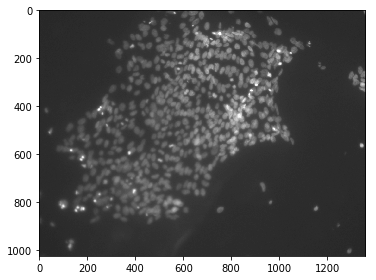

In [19]:
io.imshow(img)

In [21]:
len(img.shape)

2